# Benchmarking Field Transformations


### DONE - FT-HMC implemented for 8x8 2D QED (using SiLU as activation function).

- [x] Try to minimize size of the force in training. No significant improvements.
- [x]  Some test on ergodicity
- [x] (calculate the probablity of generating the configs obtained via conventional HMC).

### TODO

- [ ] Plot the force size distribution 
- [ ] Is the large force from the original action or Field-Transforma
tion the determinant?
- [ ] If from the determinant, then the fermion force won't cause problem for HMC
- [ ] Use the same Field-Transformation for larger system (say 16x16, 32x32, 64x64, etc)
- [ ] Study how the delta H depends on the system size ( perhaps delta H ~ sqrt(volume) )
- [ ] Study the auto-correlation for observables, topo, plaq, flowed plaq, etc.
- [ ] Improving the Field-Transformation to reduce force.

In [1]:
import os
import sys
import torch

from functools import reduce
from IPython.core.interactiveshell import InteractiveShell

%load_ext autoreload
%autoreload 2

%config InlineBackend.figure_format ='retina'

InteractiveShell.ast_node_interactivity = "all"


project_dir = os.path.abspath('../../../')
if project_dir not in sys.path:
    sys.path.append(project_dir)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
import fthmc.utils.io as io
logger = io.Logger()

#torch.set_num_threads(param.nth)
#torch.set_num_interop_threads(param.nth_interop)
#os.environ["OMP_NUM_THREADS"] = str(param.nth)
#os.environ["KMP_BLOCKTIME"] = "0"
#os.environ["KMP_SETTINGS"] = "1"
os.environ["KMP_AFFINITY"]= "granularity=fine,verbose,compact,1,0"

torch.manual_seed(9)
torch.set_default_tensor_type(torch.FloatTensor)
logger = io.Logger()

## Setup experiment

- Specify `Param` object for lattice and HMC info

- Specify `TrainConfig` object for training our model

- Note, we train the `pre_flow_model` using the Kullback-Leibler divergence:

$$
D_{\mathrm{KL}} = \left(P\|Q\right) = \sum_{x\in\mathcal{X}} P(x)\log\left(\frac{P(x)}{Q(x)}\right)
$$

In [6]:
import matplotlib as mpl

from fthmc.train import train
from fthmc.config import Param, TrainConfig, PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_u1_equiv_layers, set_weights
from fthmc.utils.plot_helpers import save_live_plots

import fthmc.utils.qed_helpers as qed

import datetime

from fthmc.config import LOGS_DIR

mpl.rcParams['text.usetex'] = False
%matplotlib inline
plt.style.use('/Users/saforem2/.matplotlib/stylelib/molokai.mplstyle')

[09:25:18]  Param:                                                                           
            ----------------                                                                 
            beta=5.0                                                                         
            L=8                                                                              
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=100                                                                        
            nrun=2                                                                           
            nprint=10                                                                        
            seed=1331                                                                        
            randinit=False                                                                   
            nth_interop=2                                                                    
            nth=2                                                                            
            lat=[8, 8]                                                                       
            nd=2                                                                             
            shape=[2, 8, 8]                                                                  
            volume=64                                                                        
            dt=0.05

            TrainConfig:                                                                     
            ----------------                                                                 
            n_era=10                                                                         
            n_epoch=100                                                                      
            batch_size=64                                                                    
            base_lr=0.001                                                                    
            n_s_nets=2                                                                       
            n_layers=24                                                                      
            kernel_size=3                                                                    
            with_force=False                                                                 
            print_freq=10                                                                    
            plot_freq=10                                                                     
            hidden_sizes=[8, 8]

[09:25:18]  Creating directory: ../../../logs/hmc/t8x8_b5.0_n100_t0.5_s10/2021-06-14-092518

[09:25:18]  Creating directory:                                                              
            ../../../logs/hmc/t8x8_b5.0_n100_t0.5_s10/2021-06-14-092518/plots

[09:25:18]  Param:                                                                           
            ----------------                                                                 
            beta=5.0                                                                         
            L=8                                                                              
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=100                                                                        
            nrun=2                                                                           
            nprint=10                                                                        
            seed=1331                                                                        
            randinit=False                                                                   
            nth_interop=2                                                                    
            nth=2                                                                            
            lat=[8, 8]                                                                       
            nd=2                                                                             
            shape=[2, 8, 8]                                                                  
            volume=64                                                                        
            dt=0.05

            --------------------------                                                       
            RUN: 0, last took: 0 m 0 s                                                       
            --------------------------

            plaq=1.000 q=0.000

            traj=2 dt=0.004 accept=True dH=-0.126 q=0 dqsq=0 plaq=1.000

            traj=12 dt=0.004 accept=True dH=0.000 q=0 dqsq=0 plaq=1.000

            traj=22 dt=0.004 accept=True dH=0.024 q=0 dqsq=0 plaq=1.000

[09:25:19]  traj=32 dt=0.004 accept=True dH=0.031 q=0 dqsq=0 plaq=1.000

            traj=42 dt=0.004 accept=True dH=-0.003 q=-1 dqsq=0 plaq=1.000

            traj=52 dt=0.004 accept=True dH=0.093 q=0 dqsq=1 plaq=1.000

            traj=62 dt=0.004 accept=True dH=-0.049 q=-1 dqsq=1 plaq=1.000

            traj=72 dt=0.005 accept=True dH=0.019 q=0 dqsq=1 plaq=1.000

            traj=82 dt=0.004 accept=True dH=0.024 q=-1 dqsq=1 plaq=1.000

            traj=92 dt=0.004 accept=True dH=0.059 q=-1 dqsq=0 plaq=1.000

[09:25:19]  Creating directory:                                                              
            ../../../logs/hmc/t8x8_b5.0_n100_t0.5_s10/2021-06-14-092518/plots/run0

[09:25:20]  --------------------------                                                       
            RUN: 1, last took: 0 m 0 s                                                       
            --------------------------

            plaq=1.000 q=0.000

            traj=102 dt=0.006 accept=True dH=-0.174 q=0 dqsq=0 plaq=1.000

            traj=112 dt=0.004 accept=True dH=-0.074 q=0 dqsq=0 plaq=1.000

            traj=122 dt=0.004 accept=True dH=0.098 q=0 dqsq=0 plaq=1.000

            traj=132 dt=0.004 accept=False dH=0.095 q=0 dqsq=0 plaq=1.000

            traj=142 dt=0.004 accept=True dH=-0.006 q=0 dqsq=0 plaq=1.000

            traj=152 dt=0.004 accept=True dH=-0.041 q=0 dqsq=0 plaq=1.000

[09:25:21]  traj=162 dt=0.005 accept=True dH=-0.010 q=-1 dqsq=0 plaq=1.000

            traj=172 dt=0.005 accept=True dH=-0.020 q=0 dqsq=1 plaq=1.000

            traj=182 dt=0.004 accept=True dH=-0.024 q=-1 dqsq=0 plaq=1.000

            traj=192 dt=0.004 accept=True dH=-0.044 q=-1 dqsq=0 plaq=1.000

[09:25:21]  Creating directory:                                                              
            ../../../logs/hmc/t8x8_b5.0_n100_t0.5_s10/2021-06-14-092518/plots/run1

[09:25:22]  Run times: ['0.5513', '0.6091']

            Per trajectory: ['0.0055', '0.0061']

[09:25:22]  Saving hmc_histories to                                                          
            ../../../logs/hmc/t8x8_b5.0_n100_t0.5_s10/2021-06-14-092518/hmc_histories.z.

[09:25:22]  Saving hmc_fields_arr to                                                         
            ../../../logs/hmc/t8x8_b5.0_n100_t0.5_s10/2021-06-14-092518/hmc_fields_arr.z.

[09:25:22]  Creating directory: ../../../logs/t8x8_b5.0_n100_t0.5_s10/nb64_nh24_ns2_ks3_hl88_
            lr0.001_era10_epoch100/training/2021-06-14-092522

[09:25:22]  Creating directory: ../../../logs/t8x8_b5.0_n100_t0.5_s10/nb64_nh24_ns2_ks3_hl88_
            lr0.001_era10_epoch100/training/2021-06-14-092522/plots

[09:25:22]  Creating directory: ../../../logs/t8x8_b5.0_n100_t0.5_s10/nb64_nh24_ns2_ks3_hl88_
            lr0.001_era10_epoch100/training/2021-06-14-092522/checkpoints

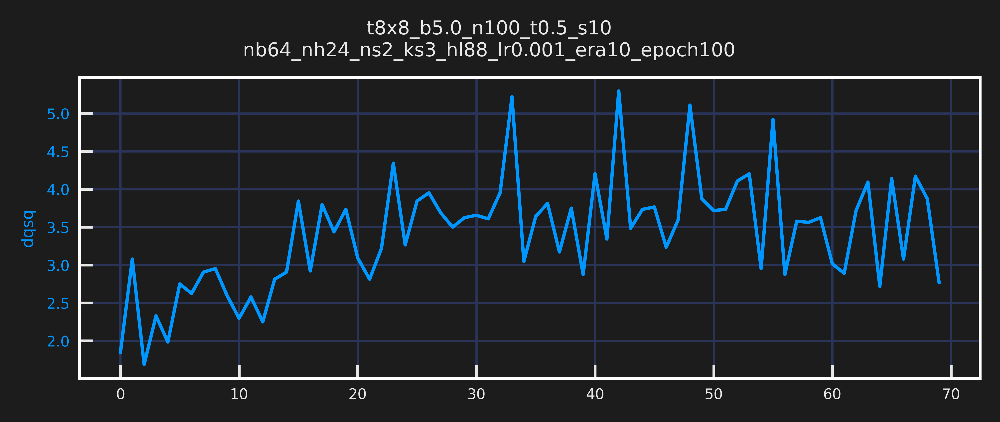

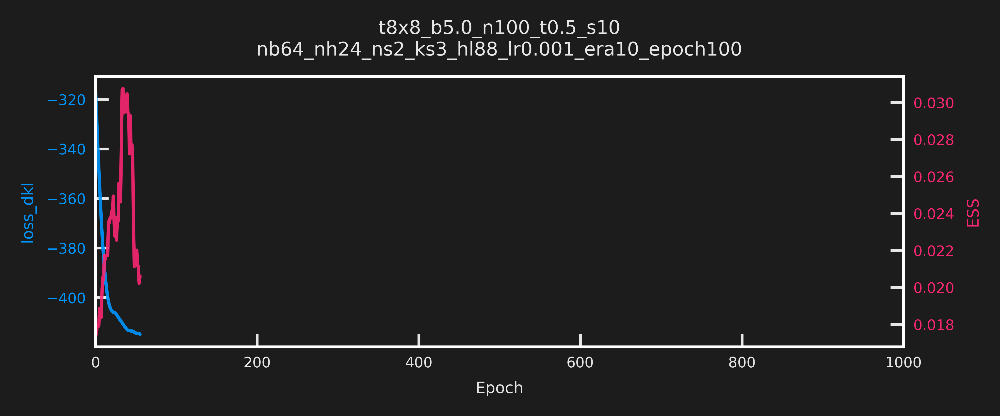

[09:25:23]  -----------------------------                                                    
            ERA=0, last took: 0 min 0 sec                                                    
            -----------------------------

[09:25:28]  epoch=10.000 dt=0.426 loss=-317.444 ess=0.017 logp=87.789 logq=-229.655          
            dqsq=2.766 plaq=0.274

[09:25:34]  epoch=20.000 dt=0.514 loss=-389.082 ess=0.020 logp=186.176 logq=-202.906         
            dqsq=3.547 plaq=0.582

[09:25:41]  epoch=30.000 dt=0.528 loss=-405.445 ess=0.023 logp=247.684 logq=-157.761         
            dqsq=3.722 plaq=0.774

[09:25:48]  epoch=40.000 dt=0.530 loss=-408.530 ess=0.021 logp=250.216 logq=-158.314         
            dqsq=3.450 plaq=0.782

[09:25:55]  epoch=50.000 dt=0.538 loss=-412.072 ess=0.039 logp=237.188 logq=-174.884         
            dqsq=3.916 plaq=0.741

[09:26:03]  epoch=60.000 dt=0.609 loss=-413.718 ess=0.023 logp=238.344 logq=-175.373         
            dqsq=3.712 plaq=0.745

[09:26:11]  epoch=70.000 dt=0.616 loss=-415.858 ess=0.019 logp=248.044 logq=-167.814         
            dqsq=3.606 plaq=0.775

In [ ]:
# -------------------------------------------
# Specify `param` and `train_config` objects
# -------------------------------------------
param = {
    'L': 8,
    'tau': 0.5,
    'nrun': 2,
    'beta': np.float32(5.),
    'nstep': 10,
    'ntraj': 100,
    'nprint': 10,
    'seed': 1331,
}

train_config = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 100,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 64,
    'print_freq': 10,
    'plot_freq': 10,
})

param = Param(**param)
logger.log(repr(param))
logger.log(repr(train_config))


# ------------------------------
# Run HMC using `param` above
# ------------------------------
from fthmc.hmc import run_hmc

hmc_fields, hmc_history = run_hmc(param)


# ---------------------------------------
# Train model using `train_config` above
# ---------------------------------------
from fthmc.train import train

%matplotlib inline
plt.style.use('default')
plt.style.use('/Users/saforem2/.matplotlib/stylelib/molokai.mplstyle')
sns.set_context('paper', font_scale=0.6)

train_outputs = train(param,
                      train_config,
                      model=None,
                      pre_model=None,
                      figsize=(5, 2))

pre_flow_plots = train_outputs['plots']
pre_flow_history = train_outputs['history']
flow_act = train_outputs['action']
pre_flow_model = train_outputs['model']
pre_flow_optimizer = train_outputs['optimizer']


# -----------------------------------------------------------
# Run inference on trained model and evaluate / plot metrics
# -----------------------------------------------------------
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history
from fthmc.utils.samplers import make_mcmc_ensemble

action_fn = qed.BatchAction(param.beta)
dirs = train_outputs['dirs']
logdir = dirs['logdir']

inf_dir = os.path.join(logdir, 'inference')
inf_pdir = os.path.join(inf_dir, 'plots')
history = make_mcmc_ensemble(model=train_outputs['model'], action_fn=action_fn,
                             batch_size=train_config.batch_size, num_samples=1000)
plot_history(history=history,
             param=param, config=train_config, skip=['epoch', 'x'],
             num_chains=4, therm_frac=0.0, xlabel='MC Step', outdir=inf_pdir)

In [9]:
%debug

> /Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py(133)plot_metric()
    131 
    132     if isinstance(metric, list) and isinstance(metric[0], torch.Tensor):
--> 133         metric = torch.Tensor(metric).detach().cpu().numpy().squeeze()
    134 
    135     if isinstance(metric, torch.Tensor):

ipdb> metric
[tensor([[0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.]]), tensor([[ 0.3027, -0.2712, -0.1670, -0.1557,  0.1020, -0.1489, -0.4584, -0.2105],
        [ 0.9669,  0.4355,  0.3411, -0.2255,  0.1024,  0.2050, -0.2023,  0.2202],
        [-0.2798, -0.0606,  0.2260, -0.1929, -0.0420, -0.1225, -0.2232, -0.0420],
        [-0.2055, -0.1916, -0.4962, -0.2532, -0.0259,  0.0295,  0.1100,  0.2174],
        [ 0.298

        [ 0.9050, -0.1484, -0.0372, -0.3672,  0.0485, -0.4695, -0.3987,  0.5879]])]
ipdb> len(metric)
101
ipdb> metric[0].shape
torch.Size([8, 8])
ipdb> metric[1].shape
torch.Size([8, 8])
ipdb> l
    128     if isinstance(metric, list):
    129         if isinstance(metric[0], tuple) and len(metric[0]) == 1:
    130             metric = [m[0] for m in metric]
    131 
    132     if isinstance(metric, list) and isinstance(metric[0], torch.Tensor):
--> 133         metric = torch.Tensor(metric).detach().cpu().numpy().squeeze()
    134 
    135     if isinstance(metric, torch.Tensor):
    136         metric = torch.Tensor(metric).detach().cpu().numpy().squeeze()
    137 
    138     metric = np.array(metric)

ipdb> up
> /Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py(203)plot_history()
    201             title = '\n'.join(tarr) if len(tarr) > 0 else None
    202 
--> 203         _ = plot_metric(val,
    204                         ylabel=key,
    205                         titl

        [ 0.9050, -0.1484, -0.0372, -0.3672,  0.0485, -0.4695, -0.3987,  0.5879]])]
ipdb> 
[tensor([[0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0.]]), tensor([[ 0.3027, -0.2712, -0.1670, -0.1557,  0.1020, -0.1489, -0.4584, -0.2105],
        [ 0.9669,  0.4355,  0.3411, -0.2255,  0.1024,  0.2050, -0.2023,  0.2202],
        [-0.2798, -0.0606,  0.2260, -0.1929, -0.0420, -0.1225, -0.2232, -0.0420],
        [-0.2055, -0.1916, -0.4962, -0.2532, -0.0259,  0.0295,  0.1100,  0.2174],
        [ 0.2983, -0.3611, -0.2010,  0.6322,  0.4490,  0.0022, -0.0658,  0.4165],
        [-0.0958,  0.3498,  0.2735,  0.3677,  0.0691, -0.6300, -0.1346, -0.3530],
        [-0.6737,  0.2487,  0.2191, -0.1029,  0.0098,  0.2372,  0.3095, -0.537

        [ 0.9050, -0.1484, -0.0372, -0.3672,  0.0485, -0.4695, -0.3987,  0.5879]])]
ipdb> q


## Transfer to `16x16` lattice:

[23:17:39]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b5.0_n100_t0.5_s10/2021-06-13-231739

[23:17:39]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b5.0_n100_t0.5_s
            10/2021-06-13-231739/plots

[23:17:39]  Param:                                                                           
            ----------------                                                                 
            beta=5.0                                                                         
            L=16                                                                             
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=100                                                                        
            nrun=2                                                                           
            nprint=10                                                                        
            seed=1331                                                                        
            randinit=False                                                                   
            nth_interop=2                                                                    
            nth=2                                                                            
            lat=[16, 16]                                                                     
            nd=2                                                                             
            shape=[2, 16, 16]                                                                
            volume=256                                                                       
            dt=0.05

            --------------------------                                                       
            RUN: 0, last took: 0 m 0 s                                                       
            --------------------------

            action=1.000 plaq=0.000 charge=0.000

            traj=2 dt=0.004 accept=True dH=-0.285 q=0 dqsq=0 plaq=0.921

            traj=12 dt=0.004 accept=True dH=0.130 q=0 dqsq=0 plaq=0.906

            traj=22 dt=0.003 accept=True dH=-0.172 q=0 dqsq=0 plaq=0.901

            traj=32 dt=0.003 accept=True dH=0.104 q=0 dqsq=0 plaq=0.894

            traj=42 dt=0.003 accept=True dH=-0.048 q=0 dqsq=0 plaq=0.897

            traj=52 dt=0.003 accept=True dH=-0.049 q=0 dqsq=0 plaq=0.897

[23:17:40]  traj=62 dt=0.003 accept=True dH=-0.022 q=0 dqsq=0 plaq=0.898

            traj=72 dt=0.003 accept=True dH=0.080 q=0 dqsq=0 plaq=0.892

            traj=82 dt=0.003 accept=True dH=0.194 q=0 dqsq=0 plaq=0.904

            traj=92 dt=0.003 accept=True dH=-0.077 q=0 dqsq=0 plaq=0.906

[23:17:40]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b5.0_n100_t0.5_s
            10/2021-06-13-231739/plots/run0

[23:17:41]  --------------------------                                                       
            RUN: 1, last took: 0 m 0 s                                                       
            --------------------------

            action=1.000 plaq=0.000 charge=0.000

            traj=102 dt=0.003 accept=True dH=-0.008 q=0 dqsq=0 plaq=0.935

            traj=112 dt=0.003 accept=True dH=0.018 q=0 dqsq=0 plaq=0.910

            traj=122 dt=0.003 accept=True dH=-0.012 q=0 dqsq=0 plaq=0.902

            traj=132 dt=0.004 accept=True dH=0.096 q=0 dqsq=0 plaq=0.908

            traj=142 dt=0.004 accept=False dH=0.163 q=0 dqsq=0 plaq=0.898

            traj=152 dt=0.004 accept=True dH=0.091 q=0 dqsq=0 plaq=0.909

            traj=162 dt=0.003 accept=True dH=-0.012 q=0 dqsq=0 plaq=0.888

            traj=172 dt=0.004 accept=True dH=-0.135 q=0 dqsq=0 plaq=0.888

            traj=182 dt=0.004 accept=True dH=-0.018 q=0 dqsq=0 plaq=0.884

            traj=192 dt=0.003 accept=True dH=0.119 q=0 dqsq=0 plaq=0.906

[23:17:41]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b5.0_n100_t0.5_s
            10/2021-06-13-231739/plots/run1

[23:17:42]  Run times: ['0.4508', '0.7142']

            Per trajectory: ['0.0045', '0.0071']

[23:17:42]  Saving hmc_histories to /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b5.0_n100_t0
            .5_s10/2021-06-13-231739/hmc_histories.z.

[23:17:43]  Saving hmc_fields_arr to /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b5.0_n100_t
            0.5_s10/2021-06-13-231739/hmc_fields_arr.z.

[23:17:43]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10/n
            b64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100

[23:17:43]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10/n
            b64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training

[23:17:43]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10/n
            b64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots

[23:17:43]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10/n
            b64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints

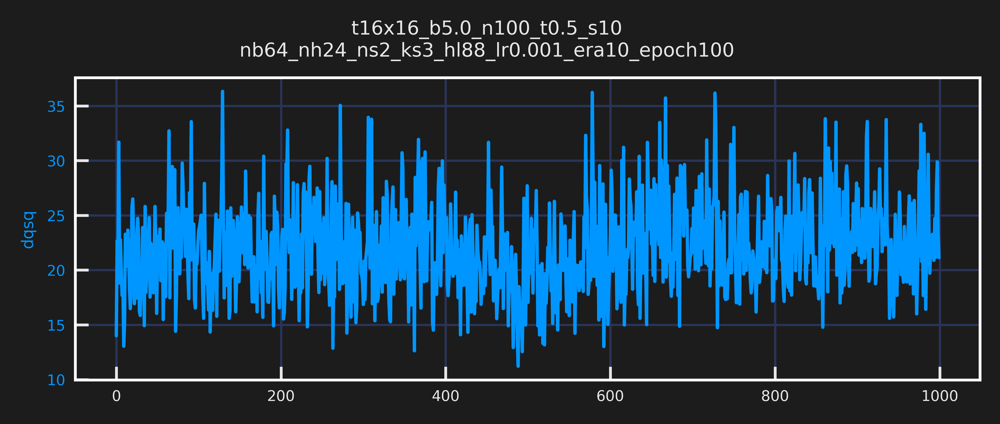

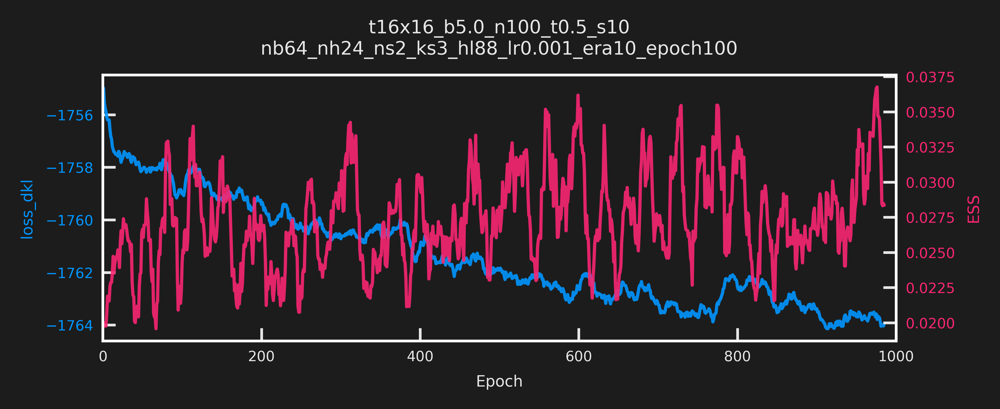

[23:17:43]  -----------------------------                                                    
            ERA=0, last took: 0 min 0 sec                                                    
            -----------------------------

[23:17:51]  epoch=10.000 dt=0.792 loss=-1754.737 ess=0.022 logp=1104.815 logq=-649.922       
            dqsq=18.531 plaq=0.863

[23:18:02]  epoch=20.000 dt=0.958 loss=-1757.370 ess=0.020 logp=1105.646 logq=-651.724       
            dqsq=20.091 plaq=0.864

[23:18:15]  epoch=30.000 dt=1.156 loss=-1757.995 ess=0.024 logp=1108.073 logq=-649.922       
            dqsq=20.669 plaq=0.866

[23:18:28]  epoch=40.000 dt=1.162 loss=-1757.653 ess=0.033 logp=1110.495 logq=-647.159       
            dqsq=21.366 plaq=0.868

[23:18:44]  epoch=50.000 dt=1.330 loss=-1757.797 ess=0.018 logp=1109.632 logq=-648.166       
            dqsq=20.691 plaq=0.867

[23:19:01]  epoch=60.000 dt=1.564 loss=-1758.182 ess=0.026 logp=1108.390 logq=-649.792       
            dqsq=20.944 plaq=0.866

[23:19:19]  epoch=70.000 dt=1.544 loss=-1757.774 ess=0.024 logp=1107.836 logq=-649.938       
            dqsq=24.456 plaq=0.865

[23:19:36]  epoch=80.000 dt=1.432 loss=-1758.212 ess=0.020 logp=1112.104 logq=-646.108       
            dqsq=22.666 plaq=0.869

[23:19:51]  epoch=90.000 dt=1.313 loss=-1757.918 ess=0.026 logp=1107.954 logq=-649.964       
            dqsq=22.456 plaq=0.866

[23:20:06]  epoch=100.000 dt=1.235 loss=-1758.894 ess=0.023 logp=1110.307 logq=-648.587      
            dqsq=19.528 plaq=0.867

[23:20:08]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era0-epo
            ch100.tar

[23:20:08]  ---------------------------------                                                
            ERA=1, last took: 2 min 24.32 sec                                                
            ---------------------------------

[23:20:19]  epoch=10.000 dt=1.140 loss=-1758.401 ess=0.018 logp=1108.925 logq=-649.477       
            dqsq=20.256 plaq=0.866

[23:20:33]  epoch=20.000 dt=1.105 loss=-1757.940 ess=0.027 logp=1109.011 logq=-648.929       
            dqsq=18.841 plaq=0.866

[23:20:46]  epoch=30.000 dt=1.114 loss=-1758.183 ess=0.027 logp=1109.945 logq=-648.238       
            dqsq=26.569 plaq=0.867

[23:20:59]  epoch=40.000 dt=1.125 loss=-1758.493 ess=0.032 logp=1110.468 logq=-648.026       
            dqsq=21.359 plaq=0.868

[23:21:12]  epoch=50.000 dt=1.272 loss=-1758.549 ess=0.023 logp=1112.253 logq=-646.296       
            dqsq=20.556 plaq=0.869

[23:21:25]  epoch=60.000 dt=1.149 loss=-1759.634 ess=0.025 logp=1111.445 logq=-648.188       
            dqsq=24.381 plaq=0.868

[23:21:39]  epoch=70.000 dt=1.112 loss=-1759.477 ess=0.027 logp=1110.912 logq=-648.564       
            dqsq=19.175 plaq=0.868

[23:21:52]  epoch=80.000 dt=1.122 loss=-1759.036 ess=0.017 logp=1111.183 logq=-647.853       
            dqsq=21.078 plaq=0.868

[23:22:06]  epoch=90.000 dt=1.145 loss=-1759.063 ess=0.030 logp=1110.825 logq=-648.239       
            dqsq=20.534 plaq=0.868

[23:22:19]  epoch=100.000 dt=1.166 loss=-1759.353 ess=0.025 logp=1110.194 logq=-649.158      
            dqsq=20.834 plaq=0.867

[23:22:21]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era1-epo
            ch100.tar

[23:22:21]  ---------------------------------                                                
            ERA=2, last took: 2 min 13.44 sec                                                
            ---------------------------------

[23:22:33]  epoch=10.000 dt=1.189 loss=-1758.618 ess=0.030 logp=1110.550 logq=-648.068       
            dqsq=26.719 plaq=0.868

[23:22:47]  epoch=20.000 dt=1.129 loss=-1760.077 ess=0.018 logp=1111.031 logq=-649.047       
            dqsq=21.109 plaq=0.868

[23:23:00]  epoch=30.000 dt=1.122 loss=-1760.510 ess=0.022 logp=1112.010 logq=-648.499       
            dqsq=24.491 plaq=0.869

[23:23:13]  epoch=40.000 dt=1.218 loss=-1759.386 ess=0.020 logp=1108.022 logq=-651.364       
            dqsq=23.750 plaq=0.866

[23:23:27]  epoch=50.000 dt=1.149 loss=-1760.821 ess=0.032 logp=1110.565 logq=-650.256       
            dqsq=21.562 plaq=0.868

[23:23:40]  epoch=60.000 dt=1.110 loss=-1760.199 ess=0.022 logp=1110.734 logq=-649.465       
            dqsq=21.153 plaq=0.868

[23:23:53]  epoch=70.000 dt=1.106 loss=-1760.162 ess=0.033 logp=1112.190 logq=-647.972       
            dqsq=23.597 plaq=0.869

[23:24:06]  epoch=80.000 dt=1.119 loss=-1759.771 ess=0.021 logp=1110.101 logq=-649.670       
            dqsq=21.391 plaq=0.867

[23:24:19]  epoch=90.000 dt=1.107 loss=-1759.900 ess=0.024 logp=1111.193 logq=-648.708       
            dqsq=20.609 plaq=0.868

[23:24:31]  epoch=100.000 dt=1.051 loss=-1760.831 ess=0.032 logp=1112.063 logq=-648.768      
            dqsq=20.913 plaq=0.869

[23:24:33]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era2-epo
            ch100.tar

[23:24:33]  ---------------------------------                                                
            ERA=3, last took: 2 min 11.73 sec                                                
            ---------------------------------

[23:24:44]  epoch=10.000 dt=1.094 loss=-1760.544 ess=0.026 logp=1110.709 logq=-649.834       
            dqsq=25.647 plaq=0.868

[23:24:57]  epoch=20.000 dt=1.062 loss=-1760.141 ess=0.034 logp=1110.702 logq=-649.439       
            dqsq=19.916 plaq=0.868

[23:25:09]  epoch=30.000 dt=1.062 loss=-1760.898 ess=0.029 logp=1112.665 logq=-648.233       
            dqsq=24.278 plaq=0.869

[23:25:22]  epoch=40.000 dt=1.125 loss=-1760.263 ess=0.018 logp=1111.447 logq=-648.816       
            dqsq=24.206 plaq=0.868

[23:25:36]  epoch=50.000 dt=1.118 loss=-1759.959 ess=0.025 logp=1110.023 logq=-649.936       
            dqsq=24.656 plaq=0.867

[23:25:49]  epoch=60.000 dt=1.110 loss=-1760.584 ess=0.027 logp=1109.149 logq=-651.435       
            dqsq=20.816 plaq=0.867

[23:26:02]  epoch=70.000 dt=1.131 loss=-1761.091 ess=0.026 logp=1112.967 logq=-648.124       
            dqsq=25.863 plaq=0.870

[23:26:15]  epoch=80.000 dt=1.109 loss=-1759.560 ess=0.030 logp=1113.809 logq=-645.751       
            dqsq=23.906 plaq=0.870

[23:26:28]  epoch=90.000 dt=1.082 loss=-1759.684 ess=0.026 logp=1112.347 logq=-647.337       
            dqsq=18.184 plaq=0.869

[23:26:41]  epoch=100.000 dt=1.098 loss=-1761.878 ess=0.020 logp=1114.818 logq=-647.060      
            dqsq=25.381 plaq=0.871

[23:26:43]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era3-epo
            ch100.tar

[23:26:43]  ---------------------------------                                                
            ERA=4, last took: 2 min 10.11 sec                                                
            ---------------------------------

[23:26:55]  epoch=10.000 dt=1.083 loss=-1761.219 ess=0.028 logp=1113.961 logq=-647.257       
            dqsq=21.681 plaq=0.870

[23:27:07]  epoch=20.000 dt=1.059 loss=-1761.161 ess=0.027 logp=1109.798 logq=-651.363       
            dqsq=19.475 plaq=0.867

[23:27:20]  epoch=30.000 dt=1.042 loss=-1761.637 ess=0.026 logp=1113.130 logq=-648.508       
            dqsq=19.559 plaq=0.870

[23:27:33]  epoch=40.000 dt=1.030 loss=-1761.351 ess=0.027 logp=1110.991 logq=-650.360       
            dqsq=19.519 plaq=0.868

[23:27:45]  epoch=50.000 dt=1.036 loss=-1761.652 ess=0.024 logp=1113.631 logq=-648.021       
            dqsq=20.069 plaq=0.870

[23:27:57]  epoch=60.000 dt=1.034 loss=-1762.023 ess=0.025 logp=1110.544 logq=-651.479       
            dqsq=22.091 plaq=0.868

[23:28:09]  epoch=70.000 dt=1.015 loss=-1761.300 ess=0.026 logp=1114.007 logq=-647.293       
            dqsq=22.944 plaq=0.870

[23:28:21]  epoch=80.000 dt=1.035 loss=-1760.845 ess=0.032 logp=1112.689 logq=-648.156       
            dqsq=18.775 plaq=0.869

[23:28:33]  epoch=90.000 dt=0.979 loss=-1761.521 ess=0.028 logp=1110.409 logq=-651.113       
            dqsq=16.625 plaq=0.868

[23:28:45]  epoch=100.000 dt=1.006 loss=-1762.148 ess=0.019 logp=1115.129 logq=-647.020      
            dqsq=22.891 plaq=0.871

[23:28:46]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era4-epo
            ch100.tar

[23:28:47]  --------------------------------                                                 
            ERA=5, last took: 2 min 3.08 sec                                                 
            --------------------------------

[23:28:57]  epoch=10.000 dt=0.979 loss=-1761.692 ess=0.024 logp=1112.587 logq=-649.105       
            dqsq=22.006 plaq=0.869

[23:29:08]  epoch=20.000 dt=0.984 loss=-1761.999 ess=0.037 logp=1111.489 logq=-650.510       
            dqsq=17.894 plaq=0.868

[23:29:21]  epoch=30.000 dt=1.076 loss=-1762.057 ess=0.027 logp=1112.709 logq=-649.348       
            dqsq=21.184 plaq=0.869

[23:29:34]  epoch=40.000 dt=1.033 loss=-1762.726 ess=0.040 logp=1115.310 logq=-647.416       
            dqsq=18.300 plaq=0.871

[23:29:46]  epoch=50.000 dt=1.024 loss=-1762.517 ess=0.030 logp=1112.566 logq=-649.951       
            dqsq=19.856 plaq=0.869

[23:29:59]  epoch=60.000 dt=1.035 loss=-1761.833 ess=0.022 logp=1113.563 logq=-648.270       
            dqsq=20.331 plaq=0.870

[23:30:11]  epoch=70.000 dt=1.042 loss=-1762.841 ess=0.030 logp=1114.643 logq=-648.198       
            dqsq=20.925 plaq=0.871

[23:30:23]  epoch=80.000 dt=1.042 loss=-1762.931 ess=0.020 logp=1118.083 logq=-644.848       
            dqsq=25.797 plaq=0.874

[23:30:36]  epoch=90.000 dt=1.021 loss=-1762.650 ess=0.026 logp=1115.619 logq=-647.032       
            dqsq=21.812 plaq=0.872

[23:30:48]  epoch=100.000 dt=1.063 loss=-1763.144 ess=0.029 logp=1113.919 logq=-649.225      
            dqsq=18.913 plaq=0.870

[23:30:50]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era5-epo
            ch100.tar

[23:30:50]  ---------------------------------                                                
            ERA=6, last took: 2 min 3.307 sec                                                
            ---------------------------------

[23:31:00]  epoch=10.000 dt=1.015 loss=-1762.273 ess=0.038 logp=1112.200 logq=-650.073       
            dqsq=20.562 plaq=0.869

[23:31:13]  epoch=20.000 dt=1.166 loss=-1761.341 ess=0.026 logp=1110.278 logq=-651.063       
            dqsq=20.084 plaq=0.867

[23:31:26]  epoch=30.000 dt=1.144 loss=-1763.014 ess=0.018 logp=1110.629 logq=-652.385       
            dqsq=22.953 plaq=0.868

[23:31:39]  epoch=40.000 dt=1.069 loss=-1762.414 ess=0.026 logp=1112.874 logq=-649.540       
            dqsq=23.234 plaq=0.869

[23:31:51]  epoch=50.000 dt=1.070 loss=-1763.082 ess=0.034 logp=1117.407 logq=-645.675       
            dqsq=26.991 plaq=0.873

[23:32:04]  epoch=60.000 dt=1.053 loss=-1762.584 ess=0.026 logp=1114.917 logq=-647.667       
            dqsq=24.650 plaq=0.871

[23:32:16]  epoch=70.000 dt=1.000 loss=-1762.000 ess=0.030 logp=1112.724 logq=-649.276       
            dqsq=25.541 plaq=0.869

[23:32:28]  epoch=80.000 dt=1.024 loss=-1763.194 ess=0.022 logp=1111.634 logq=-651.560       
            dqsq=21.975 plaq=0.868

[23:32:40]  epoch=90.000 dt=0.996 loss=-1762.310 ess=0.023 logp=1115.688 logq=-646.621       
            dqsq=27.413 plaq=0.872

[23:32:51]  epoch=100.000 dt=0.986 loss=-1762.912 ess=0.020 logp=1113.393 logq=-649.519      
            dqsq=21.219 plaq=0.870

[23:32:53]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era6-epo
            ch100.tar

[23:32:53]  ---------------------------------                                                
            ERA=7, last took: 2 min 3.219 sec                                                
            ---------------------------------

[23:33:03]  epoch=10.000 dt=0.967 loss=-1763.734 ess=0.025 logp=1114.128 logq=-649.607       
            dqsq=24.772 plaq=0.870

[23:33:15]  epoch=20.000 dt=1.076 loss=-1763.544 ess=0.031 logp=1115.099 logq=-648.445       
            dqsq=23.337 plaq=0.871

[23:33:27]  epoch=30.000 dt=0.994 loss=-1763.282 ess=0.035 logp=1113.366 logq=-649.916       
            dqsq=29.316 plaq=0.870

[23:33:39]  epoch=40.000 dt=0.960 loss=-1763.732 ess=0.031 logp=1112.366 logq=-651.366       
            dqsq=20.444 plaq=0.869

[23:33:50]  epoch=50.000 dt=0.973 loss=-1763.437 ess=0.020 logp=1112.279 logq=-651.158       
            dqsq=24.337 plaq=0.869

[23:34:02]  epoch=60.000 dt=1.009 loss=-1763.380 ess=0.030 logp=1116.221 logq=-647.158       
            dqsq=23.166 plaq=0.872

[23:34:14]  epoch=70.000 dt=1.018 loss=-1762.678 ess=0.027 logp=1111.145 logq=-651.533       
            dqsq=22.491 plaq=0.868

[23:34:26]  epoch=80.000 dt=1.022 loss=-1763.607 ess=0.038 logp=1115.592 logq=-648.015       
            dqsq=20.119 plaq=0.872

[23:34:39]  epoch=90.000 dt=1.055 loss=-1762.079 ess=0.027 logp=1111.297 logq=-650.782       
            dqsq=21.306 plaq=0.868

[23:34:52]  epoch=100.000 dt=1.085 loss=-1761.820 ess=0.027 logp=1111.682 logq=-650.138      
            dqsq=21.431 plaq=0.869

[23:34:54]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era7-epo
            ch100.tar

[23:34:54]  ----------------------------------                                               
            ERA=8, last took: 2 min 0.1972 sec                                               
            ----------------------------------

[23:35:05]  epoch=10.000 dt=1.107 loss=-1762.536 ess=0.039 logp=1116.571 logq=-645.966       
            dqsq=23.259 plaq=0.872

[23:35:21]  epoch=20.000 dt=1.515 loss=-1762.506 ess=0.027 logp=1115.881 logq=-646.625       
            dqsq=21.691 plaq=0.872

[23:35:36]  epoch=30.000 dt=1.230 loss=-1761.991 ess=0.023 logp=1117.091 logq=-644.900       
            dqsq=24.584 plaq=0.873

[23:35:51]  epoch=40.000 dt=1.275 loss=-1762.398 ess=0.026 logp=1116.181 logq=-646.217       
            dqsq=22.725 plaq=0.872

[23:36:07]  epoch=50.000 dt=1.316 loss=-1762.526 ess=0.024 logp=1114.888 logq=-647.638       
            dqsq=21.900 plaq=0.871

[23:36:22]  epoch=60.000 dt=1.266 loss=-1763.149 ess=0.029 logp=1114.001 logq=-649.148       
            dqsq=21.869 plaq=0.870

[23:36:38]  epoch=70.000 dt=1.375 loss=-1762.777 ess=0.025 logp=1114.717 logq=-648.060       
            dqsq=27.641 plaq=0.871

[23:36:53]  epoch=80.000 dt=1.297 loss=-1762.475 ess=0.023 logp=1113.964 logq=-648.511       
            dqsq=21.069 plaq=0.870

[23:37:08]  epoch=90.000 dt=1.275 loss=-1763.997 ess=0.027 logp=1118.427 logq=-645.570       
            dqsq=25.381 plaq=0.874

[23:37:24]  epoch=100.000 dt=1.296 loss=-1763.339 ess=0.026 logp=1115.107 logq=-648.232      
            dqsq=25.041 plaq=0.871

[23:37:27]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era8-epo
            ch100.tar

[23:37:27]  ---------------------------------                                                
            ERA=9, last took: 2 min 32.92 sec                                                
            ---------------------------------

[23:37:40]  epoch=10.000 dt=1.276 loss=-1763.447 ess=0.033 logp=1115.046 logq=-648.401       
            dqsq=22.978 plaq=0.871

[23:37:55]  epoch=20.000 dt=1.302 loss=-1764.344 ess=0.029 logp=1117.235 logq=-647.108       
            dqsq=22.938 plaq=0.873

[23:38:12]  epoch=30.000 dt=1.425 loss=-1763.915 ess=0.030 logp=1115.503 logq=-648.412       
            dqsq=26.119 plaq=0.871

[23:38:28]  epoch=40.000 dt=1.290 loss=-1763.834 ess=0.020 logp=1117.257 logq=-646.577       
            dqsq=23.722 plaq=0.873

[23:38:44]  epoch=50.000 dt=1.454 loss=-1763.243 ess=0.030 logp=1109.529 logq=-653.714       
            dqsq=21.041 plaq=0.867

[23:39:03]  epoch=60.000 dt=1.579 loss=-1763.431 ess=0.033 logp=1115.036 logq=-648.395       
            dqsq=21.316 plaq=0.871

[23:39:21]  epoch=70.000 dt=1.480 loss=-1763.889 ess=0.038 logp=1117.256 logq=-646.634       
            dqsq=23.044 plaq=0.873

[23:39:40]  epoch=80.000 dt=1.640 loss=-1763.858 ess=0.037 logp=1112.052 logq=-651.805       
            dqsq=25.816 plaq=0.869

[23:39:59]  epoch=90.000 dt=1.542 loss=-1763.585 ess=0.030 logp=1115.129 logq=-648.456       
            dqsq=23.309 plaq=0.871

[23:40:18]  epoch=100.000 dt=1.603 loss=-1763.531 ess=0.028 logp=1114.371 logq=-649.160      
            dqsq=24.603 plaq=0.871

[23:40:20]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era9-epo
            ch100.tar

[23:40:21]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era9-epo
            ch100.tar

[23:40:21]  Saving live plots to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots

[23:40:25]  Saving train_history to /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s
            10/nb64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/train_history.z.

[23:40:33]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b5.0_n100_t0.5_s10/n
            b64_nh24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots

In [31]:
from dataclasses import asdict
from fthmc.train import train, transfer_to_new_lattice
%matplotlib inline

plt.style.use('default')
plt.style.use('/Users/saforem2/.matplotlib/stylelib/molokai.mplstyle')
sns.set_context('paper', font_scale=0.6)

layers = train_outputs['model']['layers']


xfr = transfer_to_new_lattice(L=16,
                              layers=layers,
                              param_init=param)
param16 = xfr['param']
model16 = xfr['model']

# ----------------------------------------------
# Run HMC using new (transferred) `param` above
# ----------------------------------------------
from fthmc.hmc import run_hmc

hmc_fields16, hmc_history16 = run_hmc(param16,
                                      keep_fields=True)


cfg_dict16 = asdict(train_config)
cfg_dict16['base_lr'] = 0.001
train_config16 = TrainConfig(**cfg_dict16)

p16dict = asdict(param16)
p16dict['beta'] = 5.5
param16_b1 = Param(**p16dict)

train_outputs16 = train(param16,
                        train_config16,
                        model=model16,
                        pre_model=None,
                        figsize=(5, 2))

# ----------------------------------------------------------------
# Run inference on transferred model and evaluate / plot metrics
# ----------------------------------------------------------------
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history
from fthmc.utils.samplers import make_mcmc_ensemble

action_fn16 = qed.BatchAction(param16.beta)
dirs16 = train_outputs16['dirs']
logdir16 = dirs16['logdir']

inf_dir16 = os.path.join(logdir16, 'inference')
inf_pdir16 = os.path.join(inf_dir16, 'plots')
history16 = make_mcmc_ensemble(model=train_outputs16['model'],
                               action_fn=action_fn16,
                               batch_size=train_config16.batch_size,
                               num_samples=1000)
plot_history(history=history16,
             param=param16, config=train_config16, skip=['epoch', 'x'],
             num_chains=4, therm_frac=0.0, xlabel='MC Step', outdir=inf_pdir16)

## Try increasing beta on transferred model

[01:20:31]  Creating directory: ../../../logs/t16x16_b4.0_n100_t0.5_s10/nb64_nh24_ns2_ks3_hl8
            8_lr0.0001_era10_epoch100

[01:20:31]  Creating directory: ../../../logs/t16x16_b4.0_n100_t0.5_s10/nb64_nh24_ns2_ks3_hl8
            8_lr0.0001_era10_epoch100/training

[01:20:31]  Creating directory: ../../../logs/t16x16_b4.0_n100_t0.5_s10/nb64_nh24_ns2_ks3_hl8
            8_lr0.0001_era10_epoch100/training/plots

[01:20:31]  Creating directory: ../../../logs/t16x16_b4.0_n100_t0.5_s10/nb64_nh24_ns2_ks3_hl8
            8_lr0.0001_era10_epoch100/training/checkpoints

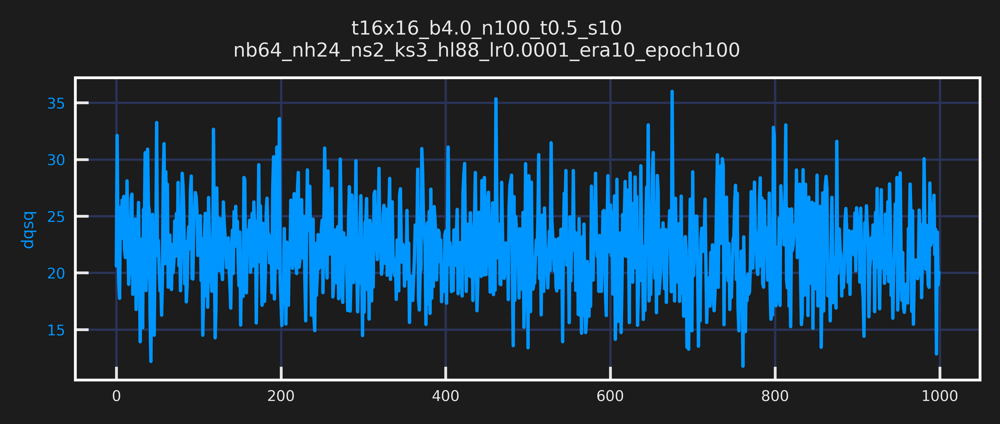

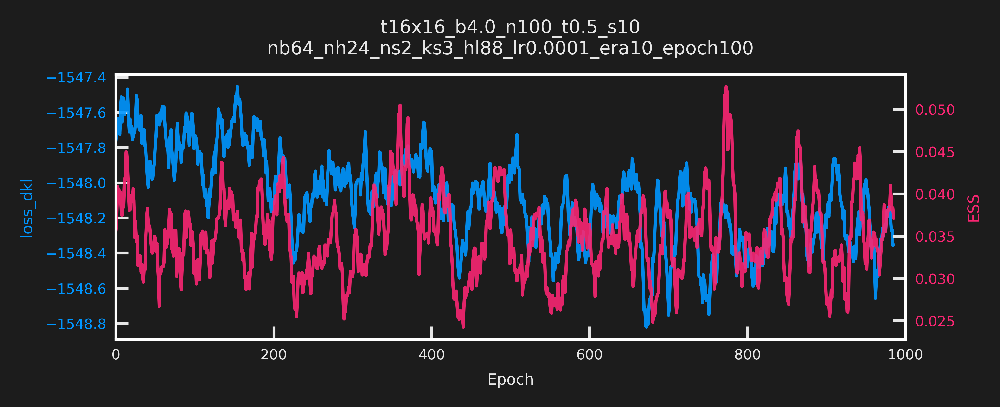

[01:20:32]  -----------------------------                                                    
            ERA=0, last took: 0 min 0 sec                                                    
            -----------------------------

[01:20:39]  epoch=10.000 dt=0.700 loss=-1548.125 ess=0.044 logp=864.985 logq=-683.140        
            dqsq=25.056 plaq=0.845

[01:20:50]  epoch=20.000 dt=0.952 loss=-1547.258 ess=0.044 logp=864.325 logq=-682.932        
            dqsq=22.625 plaq=0.844

[01:21:03]  epoch=30.000 dt=1.061 loss=-1547.640 ess=0.047 logp=862.812 logq=-684.828        
            dqsq=21.059 plaq=0.843

[01:21:17]  epoch=40.000 dt=1.292 loss=-1547.392 ess=0.030 logp=862.299 logq=-685.093        
            dqsq=25.306 plaq=0.842

[01:21:34]  epoch=50.000 dt=1.405 loss=-1547.880 ess=0.025 logp=864.740 logq=-683.141        
            dqsq=22.359 plaq=0.844

[01:21:52]  epoch=60.000 dt=1.577 loss=-1547.729 ess=0.020 logp=865.278 logq=-682.451        
            dqsq=23.288 plaq=0.845

[01:22:11]  epoch=70.000 dt=1.585 loss=-1547.922 ess=0.032 logp=864.283 logq=-683.639        
            dqsq=20.659 plaq=0.844

[01:22:30]  epoch=80.000 dt=1.606 loss=-1548.073 ess=0.037 logp=864.887 logq=-683.186        
            dqsq=22.594 plaq=0.845

[01:22:48]  epoch=90.000 dt=1.671 loss=-1548.116 ess=0.028 logp=864.996 logq=-683.120        
            dqsq=21.069 plaq=0.845

[01:23:06]  epoch=100.000 dt=1.477 loss=-1547.742 ess=0.041 logp=864.234 logq=-683.507       
            dqsq=25.103 plaq=0.844

[01:23:09]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/checkpoints/ckpt-era0-ep
            och100.tar

[01:23:09]  ---------------------------------                                                
            ERA=1, last took: 2 min 36.24 sec                                                
            ---------------------------------

[01:23:23]  epoch=10.000 dt=1.361 loss=-1547.718 ess=0.024 logp=864.169 logq=-683.550        
            dqsq=19.775 plaq=0.844

[01:23:39]  epoch=20.000 dt=1.368 loss=-1547.651 ess=0.034 logp=863.213 logq=-684.439        
            dqsq=22.572 plaq=0.843

[01:23:54]  epoch=30.000 dt=1.267 loss=-1548.480 ess=0.027 logp=863.791 logq=-684.689        
            dqsq=21.422 plaq=0.844

[01:24:10]  epoch=40.000 dt=1.292 loss=-1547.509 ess=0.048 logp=865.475 logq=-682.035        
            dqsq=20.300 plaq=0.845

[01:24:26]  epoch=50.000 dt=1.328 loss=-1547.673 ess=0.047 logp=864.427 logq=-683.246        
            dqsq=22.512 plaq=0.844

[01:24:42]  epoch=60.000 dt=1.401 loss=-1547.621 ess=0.038 logp=863.729 logq=-683.892        
            dqsq=23.622 plaq=0.843

[01:24:58]  epoch=70.000 dt=1.354 loss=-1547.524 ess=0.028 logp=863.411 logq=-684.113        
            dqsq=24.156 plaq=0.843

[01:25:14]  epoch=80.000 dt=1.324 loss=-1547.431 ess=0.027 logp=863.666 logq=-683.765        
            dqsq=22.509 plaq=0.843

[01:25:30]  epoch=90.000 dt=1.365 loss=-1547.743 ess=0.044 logp=864.311 logq=-683.432        
            dqsq=21.666 plaq=0.844

[01:25:47]  epoch=100.000 dt=1.405 loss=-1547.854 ess=0.033 logp=865.565 logq=-682.289       
            dqsq=25.691 plaq=0.845

[01:25:49]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/checkpoints/ckpt-era1-ep
            och100.tar

[01:25:49]  ---------------------------------                                                
            ERA=2, last took: 2 min 40.45 sec                                                
            ---------------------------------

[01:26:03]  epoch=10.000 dt=1.408 loss=-1547.949 ess=0.042 logp=864.420 logq=-683.529        
            dqsq=19.647 plaq=0.844

[01:26:21]  epoch=20.000 dt=1.400 loss=-1547.862 ess=0.036 logp=864.137 logq=-683.725        
            dqsq=23.344 plaq=0.844

[01:26:37]  epoch=30.000 dt=1.396 loss=-1548.297 ess=0.037 logp=864.766 logq=-683.531        
            dqsq=22.875 plaq=0.844

[01:26:54]  epoch=40.000 dt=1.433 loss=-1548.965 ess=0.030 logp=865.645 logq=-683.320        
            dqsq=22.028 plaq=0.845

[01:27:11]  epoch=50.000 dt=1.413 loss=-1547.845 ess=0.029 logp=864.392 logq=-683.454        
            dqsq=22.106 plaq=0.844

[01:27:29]  epoch=60.000 dt=1.527 loss=-1548.281 ess=0.033 logp=866.880 logq=-681.401        
            dqsq=23.494 plaq=0.847

[01:27:47]  epoch=70.000 dt=1.484 loss=-1548.446 ess=0.032 logp=865.171 logq=-683.275        
            dqsq=21.353 plaq=0.845

[01:28:05]  epoch=80.000 dt=1.468 loss=-1547.790 ess=0.036 logp=863.692 logq=-684.098        
            dqsq=21.762 plaq=0.843

[01:28:23]  epoch=90.000 dt=1.480 loss=-1548.095 ess=0.045 logp=864.008 logq=-684.087        
            dqsq=22.550 plaq=0.844

[01:28:39]  epoch=100.000 dt=1.361 loss=-1547.874 ess=0.024 logp=864.378 logq=-683.496       
            dqsq=21.194 plaq=0.844

[01:28:42]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/checkpoints/ckpt-era2-ep
            och100.tar

[01:28:42]  ---------------------------------                                                
            ERA=3, last took: 2 min 52.19 sec                                                
            ---------------------------------

[01:28:56]  epoch=10.000 dt=1.380 loss=-1547.780 ess=0.035 logp=863.410 logq=-684.370        
            dqsq=21.116 plaq=0.843

[01:29:12]  epoch=20.000 dt=1.415 loss=-1547.454 ess=0.042 logp=863.460 logq=-683.995        
            dqsq=23.913 plaq=0.843

[01:29:28]  epoch=30.000 dt=1.293 loss=-1547.983 ess=0.024 logp=864.293 logq=-683.690        
            dqsq=23.222 plaq=0.844

[01:29:43]  epoch=40.000 dt=1.304 loss=-1547.678 ess=0.044 logp=862.464 logq=-685.214        
            dqsq=21.822 plaq=0.842

[01:29:58]  epoch=50.000 dt=1.277 loss=-1548.130 ess=0.038 logp=865.370 logq=-682.760        
            dqsq=23.188 plaq=0.845

[01:30:14]  epoch=60.000 dt=1.437 loss=-1547.937 ess=0.032 logp=864.649 logq=-683.288        
            dqsq=19.019 plaq=0.844

[01:30:31]  epoch=70.000 dt=1.418 loss=-1547.781 ess=0.019 logp=865.646 logq=-682.135        
            dqsq=21.378 plaq=0.845

[01:30:49]  epoch=80.000 dt=1.554 loss=-1547.627 ess=0.033 logp=863.679 logq=-683.948        
            dqsq=19.909 plaq=0.843

[01:31:07]  epoch=90.000 dt=1.527 loss=-1548.369 ess=0.035 logp=865.125 logq=-683.245        
            dqsq=22.394 plaq=0.845

[01:31:25]  epoch=100.000 dt=1.547 loss=-1547.994 ess=0.030 logp=864.012 logq=-683.982       
            dqsq=19.962 plaq=0.844

[01:31:28]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/checkpoints/ckpt-era3-ep
            och100.tar

[01:31:28]  ---------------------------------                                                
            ERA=4, last took: 2 min 46.49 sec                                                
            ---------------------------------

[01:31:44]  epoch=10.000 dt=1.522 loss=-1548.376 ess=0.033 logp=865.165 logq=-683.211        
            dqsq=20.472 plaq=0.845

[01:32:02]  epoch=20.000 dt=1.496 loss=-1548.310 ess=0.038 logp=865.944 logq=-682.366        
            dqsq=20.472 plaq=0.846

[01:32:20]  epoch=30.000 dt=1.570 loss=-1547.894 ess=0.043 logp=863.965 logq=-683.930        
            dqsq=21.516 plaq=0.844

[01:32:38]  epoch=40.000 dt=1.502 loss=-1548.653 ess=0.030 logp=864.826 logq=-683.827        
            dqsq=22.194 plaq=0.845

[01:32:57]  epoch=50.000 dt=1.543 loss=-1548.642 ess=0.021 logp=864.149 logq=-684.493        
            dqsq=22.344 plaq=0.844

[01:33:14]  epoch=60.000 dt=1.529 loss=-1547.952 ess=0.038 logp=864.921 logq=-683.032        
            dqsq=22.056 plaq=0.845

[01:33:32]  epoch=70.000 dt=1.504 loss=-1547.748 ess=0.036 logp=864.809 logq=-682.940        
            dqsq=22.772 plaq=0.845

[01:33:49]  epoch=80.000 dt=1.395 loss=-1547.937 ess=0.031 logp=864.315 logq=-683.623        
            dqsq=24.325 plaq=0.844

[01:34:06]  epoch=90.000 dt=1.375 loss=-1547.901 ess=0.036 logp=864.523 logq=-683.379        
            dqsq=22.244 plaq=0.844

[01:34:22]  epoch=100.000 dt=1.398 loss=-1548.379 ess=0.041 logp=866.072 logq=-682.307       
            dqsq=22.306 plaq=0.846

[01:34:25]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/checkpoints/ckpt-era4-ep
            och100.tar

[01:34:25]  ---------------------------------                                                
            ERA=5, last took: 2 min 56.55 sec                                                
            ---------------------------------

[01:34:37]  epoch=10.000 dt=1.187 loss=-1548.156 ess=0.031 logp=864.632 logq=-683.525        
            dqsq=19.809 plaq=0.844

[01:34:54]  epoch=20.000 dt=1.510 loss=-1547.806 ess=0.024 logp=863.843 logq=-683.963        
            dqsq=21.356 plaq=0.844

[01:35:11]  epoch=30.000 dt=1.542 loss=-1548.330 ess=0.030 logp=864.963 logq=-683.368        
            dqsq=24.212 plaq=0.845

[01:35:28]  epoch=40.000 dt=1.413 loss=-1548.373 ess=0.036 logp=863.947 logq=-684.426        
            dqsq=20.137 plaq=0.844

[01:35:45]  epoch=50.000 dt=1.475 loss=-1548.189 ess=0.036 logp=864.732 logq=-683.456        
            dqsq=23.556 plaq=0.844

[01:36:02]  epoch=60.000 dt=1.383 loss=-1548.233 ess=0.024 logp=865.975 logq=-682.258        
            dqsq=22.613 plaq=0.846

[01:36:18]  epoch=70.000 dt=1.344 loss=-1548.285 ess=0.028 logp=864.865 logq=-683.419        
            dqsq=19.269 plaq=0.845

[01:36:34]  epoch=80.000 dt=1.381 loss=-1547.954 ess=0.023 logp=865.131 logq=-682.823        
            dqsq=21.509 plaq=0.845

[01:36:53]  epoch=90.000 dt=1.411 loss=-1548.933 ess=0.040 logp=866.910 logq=-682.023        
            dqsq=20.294 plaq=0.847

[01:37:09]  epoch=100.000 dt=1.401 loss=-1548.508 ess=0.030 logp=865.242 logq=-683.266       
            dqsq=22.716 plaq=0.845

[01:37:12]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/checkpoints/ckpt-era5-ep
            och100.tar

[01:37:12]  ---------------------------------                                                
            ERA=6, last took: 2 min 46.87 sec                                                
            ---------------------------------

[01:37:25]  epoch=10.000 dt=1.294 loss=-1548.157 ess=0.044 logp=865.732 logq=-682.425        
            dqsq=20.538 plaq=0.845

[01:37:40]  epoch=20.000 dt=1.269 loss=-1547.832 ess=0.022 logp=863.772 logq=-684.060        
            dqsq=24.278 plaq=0.844

[01:37:54]  epoch=30.000 dt=1.193 loss=-1548.351 ess=0.036 logp=864.900 logq=-683.451        
            dqsq=22.569 plaq=0.845

[01:38:09]  epoch=40.000 dt=1.198 loss=-1548.591 ess=0.033 logp=867.110 logq=-681.481        
            dqsq=23.288 plaq=0.847

[01:38:24]  epoch=50.000 dt=1.209 loss=-1548.038 ess=0.035 logp=865.514 logq=-682.524        
            dqsq=22.306 plaq=0.845

[01:38:39]  epoch=60.000 dt=1.291 loss=-1547.834 ess=0.025 logp=865.148 logq=-682.686        
            dqsq=22.747 plaq=0.845

[01:38:54]  epoch=70.000 dt=1.222 loss=-1547.980 ess=0.025 logp=865.712 logq=-682.268        
            dqsq=20.853 plaq=0.845

[01:39:08]  epoch=80.000 dt=1.204 loss=-1548.877 ess=0.046 logp=866.023 logq=-682.854        
            dqsq=25.866 plaq=0.846

[01:39:23]  epoch=90.000 dt=1.191 loss=-1548.293 ess=0.022 logp=864.157 logq=-684.136        
            dqsq=20.428 plaq=0.844

[01:39:37]  epoch=100.000 dt=1.182 loss=-1547.992 ess=0.035 logp=864.468 logq=-683.524       
            dqsq=19.756 plaq=0.844

[01:39:39]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/checkpoints/ckpt-era6-ep
            och100.tar

[01:39:39]  ---------------------------------                                                
            ERA=7, last took: 2 min 26.91 sec                                                
            ---------------------------------

[01:39:51]  epoch=10.000 dt=1.194 loss=-1548.444 ess=0.045 logp=865.820 logq=-682.624        
            dqsq=19.150 plaq=0.846

[01:40:06]  epoch=20.000 dt=1.179 loss=-1547.795 ess=0.023 logp=862.965 logq=-684.830        
            dqsq=20.003 plaq=0.843

[01:40:21]  epoch=30.000 dt=1.308 loss=-1548.274 ess=0.041 logp=864.936 logq=-683.338        
            dqsq=20.078 plaq=0.845

[01:40:36]  epoch=40.000 dt=1.378 loss=-1547.988 ess=0.052 logp=864.490 logq=-683.498        
            dqsq=24.084 plaq=0.844

[01:40:51]  epoch=50.000 dt=1.213 loss=-1548.199 ess=0.028 logp=863.959 logq=-684.240        
            dqsq=19.753 plaq=0.844

[01:41:05]  epoch=60.000 dt=1.207 loss=-1548.373 ess=0.043 logp=863.447 logq=-684.927        
            dqsq=18.488 plaq=0.843

[01:41:19]  epoch=70.000 dt=1.196 loss=-1548.494 ess=0.028 logp=865.502 logq=-682.991        
            dqsq=18.681 plaq=0.845

[01:41:34]  epoch=80.000 dt=1.187 loss=-1547.549 ess=0.030 logp=863.308 logq=-684.241        
            dqsq=23.059 plaq=0.843

[01:41:48]  epoch=90.000 dt=1.189 loss=-1548.762 ess=0.040 logp=865.336 logq=-683.426        
            dqsq=22.212 plaq=0.845

[01:42:01]  epoch=100.000 dt=1.120 loss=-1548.301 ess=0.028 logp=864.624 logq=-683.676       
            dqsq=22.728 plaq=0.844

[01:42:03]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/checkpoints/ckpt-era7-ep
            och100.tar

[01:42:04]  ---------------------------------                                                
            ERA=8, last took: 2 min 24.23 sec                                                
            ---------------------------------

[01:42:16]  epoch=10.000 dt=1.333 loss=-1548.364 ess=0.030 logp=864.300 logq=-684.064        
            dqsq=24.153 plaq=0.844

[01:42:29]  epoch=20.000 dt=1.142 loss=-1548.368 ess=0.027 logp=864.502 logq=-683.866        
            dqsq=19.172 plaq=0.844

[01:42:44]  epoch=30.000 dt=1.129 loss=-1548.512 ess=0.035 logp=866.576 logq=-681.936        
            dqsq=24.281 plaq=0.846

[01:42:57]  epoch=40.000 dt=1.138 loss=-1547.955 ess=0.025 logp=864.609 logq=-683.346        
            dqsq=22.550 plaq=0.844

[01:43:11]  epoch=50.000 dt=1.129 loss=-1547.925 ess=0.047 logp=865.389 logq=-682.536        
            dqsq=22.566 plaq=0.845

[01:43:24]  epoch=60.000 dt=1.101 loss=-1548.580 ess=0.029 logp=866.546 logq=-682.034        
            dqsq=20.262 plaq=0.846

[01:43:37]  epoch=70.000 dt=1.132 loss=-1548.240 ess=0.048 logp=865.459 logq=-682.782        
            dqsq=21.069 plaq=0.845

[01:43:50]  epoch=80.000 dt=1.126 loss=-1548.153 ess=0.044 logp=864.024 logq=-684.129        
            dqsq=24.163 plaq=0.844

[01:44:04]  epoch=90.000 dt=1.129 loss=-1548.498 ess=0.035 logp=865.056 logq=-683.442        
            dqsq=23.034 plaq=0.845

[01:44:17]  epoch=100.000 dt=1.121 loss=-1548.355 ess=0.045 logp=863.731 logq=-684.624       
            dqsq=22.900 plaq=0.843

[01:44:19]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/checkpoints/ckpt-era8-ep
            och100.tar

[01:44:20]  ---------------------------------                                                
            ERA=9, last took: 2 min 15.96 sec                                                
            ---------------------------------

[01:44:31]  epoch=10.000 dt=1.126 loss=-1548.511 ess=0.025 logp=866.109 logq=-682.402        
            dqsq=19.462 plaq=0.846

[01:44:46]  epoch=20.000 dt=1.159 loss=-1547.627 ess=0.025 logp=865.534 logq=-682.093        
            dqsq=22.050 plaq=0.845

[01:45:00]  epoch=30.000 dt=1.262 loss=-1548.152 ess=0.032 logp=866.130 logq=-682.022        
            dqsq=21.481 plaq=0.846

[01:45:14]  epoch=40.000 dt=1.134 loss=-1548.460 ess=0.029 logp=866.855 logq=-681.605        
            dqsq=23.069 plaq=0.847

[01:45:28]  epoch=50.000 dt=1.162 loss=-1548.610 ess=0.046 logp=865.075 logq=-683.534        
            dqsq=22.909 plaq=0.845

[01:45:41]  epoch=60.000 dt=1.081 loss=-1548.327 ess=0.031 logp=865.569 logq=-682.757        
            dqsq=18.381 plaq=0.845

[01:45:55]  epoch=70.000 dt=1.110 loss=-1548.553 ess=0.044 logp=865.070 logq=-683.484        
            dqsq=20.466 plaq=0.845

[01:46:08]  epoch=80.000 dt=1.065 loss=-1548.367 ess=0.022 logp=865.577 logq=-682.790        
            dqsq=22.531 plaq=0.845

[01:46:21]  epoch=90.000 dt=1.051 loss=-1548.537 ess=0.036 logp=863.883 logq=-684.654        
            dqsq=21.884 plaq=0.844

[01:46:35]  epoch=100.000 dt=1.156 loss=-1548.556 ess=0.046 logp=865.905 logq=-682.650       
            dqsq=19.847 plaq=0.846

[01:46:37]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/checkpoints/ckpt-era9-ep
            och100.tar

            Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/checkpoints/ckpt-era9-ep
            och100.tar

[01:46:37]  Saving live plots to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n100_t0.5_s10
            /nb64_nh24_ns2_ks3_hl88_lr0.0001_era10_epoch100/training/plots

[01:46:39]  Saving train_history to ../../../logs/t16x16_b4.0_n100_t0.5_s10/nb64_nh24_ns2_ks3
            _hl88_lr0.0001_era10_epoch100/training/train_history.z.

[01:46:45]  Creating directory: ../../../logs/t16x16_b4.0_n100_t0.5_s10/nb64_nh24_ns2_ks3_hl8
            8_lr0.0001_era10_epoch100/inference/plots

In [35]:
p16dict = asdict(param16)
p16dict['beta'] = 4.
param16_b1 = Param(**p16dict)

cfg_dict16 = asdict(train_config16)
cfg_dict16['base_lr'] = 0.0001
train_config16_b1 = TrainConfig(**cfg_dict16)

train_outputs16_b1 = train(param16_b1,
                           train_config16_b1,
                           model=train_outputs16_b1['model'],
                           pre_model=None,
                           figsize=(5, 2))

# ----------------------------------------------------------------
# Run inference on transferred model and evaluate / plot metrics
# ----------------------------------------------------------------
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history
from fthmc.utils.samplers import make_mcmc_ensemble

action_fn16_b1 = qed.BatchAction(param16_b1.beta)
dirs16_b1 = train_outputs16_b1['dirs']
logdir16_b1 = dirs16_b1['logdir']

inf_dir16_b1 = os.path.join(logdir16_b1, 'inference')
inf_pdir16_b1 = os.path.join(inf_dir16_b1, 'plots')
history16_b1 = make_mcmc_ensemble(model=train_outputs16_b1['model'],
                               action_fn=action_fn16_b1,
                               batch_size=train_config16_b1.batch_size,
                               num_samples=1000)
plot_history(history=history16_b1,
             param=param16_b1, config=train_config16_b1, skip=['epoch', 'x'],
             num_chains=4, therm_frac=0.0, xlabel='MC Step', outdir=inf_pdir16_b1)

## Specify directories for saving model, etc

[02:39:05]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/2021-06-13-023905

[02:39:05]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s1
            0/2021-06-13-023905/plots

[02:39:05]  Param:                                                                           
            ----------------                                                                 
            beta=3.5                                                                         
            L=4                                                                              
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=1000                                                                       
            nrun=2                                                                           
            nprint=100                                                                       
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[4, 4]                                                                       
            nd=2                                                                             
            shape=[2, 4, 4]                                                                  
            volume=16                                                                        
            dt=0.05

            action=1.000 plaq=0.000 charge=0.000

            dt=0.004 traj=2 accept=True dH=-0.033 expdH=1.034 dqsq=0.000 q=0 logp=50.867     
            plaq=0.908

            dt=0.004 traj=12 accept=True dH=-0.027 expdH=1.027 dqsq=0.000 q=0 logp=52.385    
            plaq=0.935

            dt=0.004 traj=22 accept=True dH=-0.003 expdH=1.003 dqsq=0.000 q=0 logp=47.907    
            plaq=0.855

            dt=0.004 traj=32 accept=True dH=-0.015 expdH=1.015 dqsq=0.000 q=0 logp=49.509    
            plaq=0.884

            dt=0.004 traj=42 accept=True dH=-0.011 expdH=1.011 dqsq=0.000 q=0 logp=52.584    
            plaq=0.939

            dt=0.004 traj=52 accept=True dH=-0.022 expdH=1.023 dqsq=0.000 q=0 logp=47.266    
            plaq=0.844

            dt=0.004 traj=62 accept=True dH=-0.037 expdH=1.038 dqsq=0.000 q=0 logp=51.016    
            plaq=0.911

            dt=0.004 traj=72 accept=True dH=0.036 expdH=0.965 dqsq=0.000 q=0 logp=46.096     
            plaq=0.823

            dt=0.004 traj=82 accept=True dH=0.002 expdH=0.998 dqsq=0.000 q=0 logp=49.579     
            plaq=0.885

            dt=0.004 traj=92 accept=True dH=-0.002 expdH=1.002 dqsq=0.000 q=0 logp=39.990    
            plaq=0.714

            dt=0.004 traj=102 accept=True dH=-0.007 expdH=1.007 dqsq=0.000 q=0 logp=46.736   
            plaq=0.835

            dt=0.004 traj=112 accept=True dH=-0.021 expdH=1.021 dqsq=0.000 q=0 logp=49.385   
            plaq=0.882

[02:39:06]  dt=0.004 traj=122 accept=True dH=-0.018 expdH=1.018 dqsq=0.000 q=0 logp=51.401   
            plaq=0.918

            dt=0.004 traj=132 accept=True dH=0.040 expdH=0.961 dqsq=0.000 q=0 logp=46.329    
            plaq=0.827

            dt=0.004 traj=142 accept=True dH=-0.011 expdH=1.011 dqsq=0.000 q=0 logp=46.294   
            plaq=0.827

            dt=0.004 traj=152 accept=True dH=-0.002 expdH=1.002 dqsq=0.000 q=0 logp=46.067   
            plaq=0.823

            dt=0.004 traj=162 accept=True dH=0.036 expdH=0.965 dqsq=0.000 q=0 logp=37.469    
            plaq=0.669

            dt=0.004 traj=172 accept=True dH=0.013 expdH=0.987 dqsq=0.000 q=0 logp=46.107    
            plaq=0.823

            dt=0.004 traj=182 accept=True dH=0.010 expdH=0.990 dqsq=0.000 q=0 logp=46.333    
            plaq=0.827

            dt=0.004 traj=192 accept=True dH=0.009 expdH=0.991 dqsq=0.000 q=0 logp=49.679    
            plaq=0.887

            dt=0.004 traj=202 accept=True dH=0.009 expdH=0.991 dqsq=0.000 q=0 logp=48.822    
            plaq=0.872

            dt=0.004 traj=212 accept=True dH=0.025 expdH=0.975 dqsq=0.000 q=0 logp=34.188    
            plaq=0.610

            dt=0.004 traj=222 accept=True dH=0.046 expdH=0.955 dqsq=0.000 q=0 logp=45.031    
            plaq=0.804

            dt=0.004 traj=232 accept=True dH=0.019 expdH=0.981 dqsq=0.000 q=0 logp=46.727    
            plaq=0.834

            dt=0.004 traj=242 accept=True dH=0.058 expdH=0.944 dqsq=0.000 q=0 logp=42.466    
            plaq=0.758

            dt=0.004 traj=252 accept=True dH=0.048 expdH=0.953 dqsq=0.000 q=0 logp=41.072    
            plaq=0.733

            dt=0.004 traj=262 accept=True dH=0.013 expdH=0.987 dqsq=0.000 q=0 logp=48.182    
            plaq=0.860

            dt=0.004 traj=272 accept=True dH=0.025 expdH=0.975 dqsq=0.000 q=0 logp=46.447    
            plaq=0.829

            dt=0.004 traj=282 accept=True dH=0.002 expdH=0.998 dqsq=0.000 q=0 logp=47.996    
            plaq=0.857

            dt=0.004 traj=292 accept=True dH=-0.006 expdH=1.006 dqsq=0.000 q=0 logp=51.840   
            plaq=0.926

            dt=0.004 traj=302 accept=True dH=0.017 expdH=0.983 dqsq=0.000 q=0 logp=49.602    
            plaq=0.886

            dt=0.004 traj=312 accept=True dH=-0.052 expdH=1.054 dqsq=0.000 q=0 logp=47.706   
            plaq=0.852

[02:39:07]  dt=0.005 traj=322 accept=True dH=-0.009 expdH=1.009 dqsq=0.000 q=-1 logp=45.143  
            plaq=0.806

            dt=0.006 traj=332 accept=True dH=0.016 expdH=0.984 dqsq=0.000 q=0 logp=41.243    
            plaq=0.736

            dt=0.004 traj=342 accept=True dH=-0.013 expdH=1.013 dqsq=0.000 q=-1 logp=48.184  
            plaq=0.860

            dt=0.004 traj=352 accept=True dH=-0.011 expdH=1.011 dqsq=0.000 q=-1 logp=43.376  
            plaq=0.775

            dt=0.004 traj=362 accept=True dH=0.007 expdH=0.994 dqsq=0.000 q=-1 logp=40.985   
            plaq=0.732

            dt=0.004 traj=372 accept=True dH=0.031 expdH=0.970 dqsq=0.000 q=0 logp=47.008    
            plaq=0.839

            dt=0.004 traj=382 accept=True dH=-0.033 expdH=1.034 dqsq=0.000 q=0 logp=49.330   
            plaq=0.881

            dt=0.004 traj=392 accept=True dH=0.031 expdH=0.969 dqsq=0.000 q=0 logp=43.602    
            plaq=0.779

            dt=0.004 traj=402 accept=True dH=0.000 expdH=1.000 dqsq=0.000 q=0 logp=47.032    
            plaq=0.840

            dt=0.004 traj=412 accept=True dH=0.037 expdH=0.964 dqsq=0.000 q=0 logp=46.452    
            plaq=0.830

            dt=0.004 traj=422 accept=True dH=0.011 expdH=0.989 dqsq=0.000 q=0 logp=46.378    
            plaq=0.828

            dt=0.004 traj=432 accept=True dH=-0.026 expdH=1.026 dqsq=0.000 q=0 logp=47.764   
            plaq=0.853

            dt=0.004 traj=442 accept=True dH=-0.022 expdH=1.022 dqsq=0.000 q=0 logp=47.377   
            plaq=0.846

            dt=0.004 traj=452 accept=True dH=0.036 expdH=0.965 dqsq=0.000 q=0 logp=47.806    
            plaq=0.854

            dt=0.004 traj=462 accept=True dH=0.028 expdH=0.972 dqsq=0.000 q=0 logp=47.604    
            plaq=0.850

            dt=0.004 traj=472 accept=True dH=-0.003 expdH=1.003 dqsq=0.000 q=0 logp=49.021   
            plaq=0.875

            dt=0.004 traj=482 accept=True dH=-0.010 expdH=1.011 dqsq=0.000 q=0 logp=53.418   
            plaq=0.954

            dt=0.004 traj=492 accept=True dH=0.017 expdH=0.983 dqsq=0.000 q=0 logp=46.301    
            plaq=0.827

            dt=0.004 traj=502 accept=True dH=-0.031 expdH=1.031 dqsq=0.000 q=0 logp=48.182   
            plaq=0.860

[02:39:08]  dt=0.004 traj=512 accept=True dH=0.017 expdH=0.983 dqsq=0.000 q=0 logp=49.039    
            plaq=0.876

            dt=0.004 traj=522 accept=True dH=0.005 expdH=0.995 dqsq=0.000 q=0 logp=46.729    
            plaq=0.834

            dt=0.004 traj=532 accept=True dH=0.047 expdH=0.954 dqsq=0.000 q=0 logp=46.750    
            plaq=0.835

            dt=0.004 traj=542 accept=True dH=0.012 expdH=0.988 dqsq=0.000 q=0 logp=50.332    
            plaq=0.899

            dt=0.004 traj=552 accept=False dH=0.014 expdH=0.986 dqsq=0.000 q=0 logp=39.409   
            plaq=0.704

            dt=0.004 traj=562 accept=True dH=-0.041 expdH=1.042 dqsq=0.000 q=0 logp=46.459   
            plaq=0.830

            dt=0.004 traj=572 accept=True dH=0.022 expdH=0.978 dqsq=0.000 q=0 logp=47.464    
            plaq=0.848

            dt=0.004 traj=582 accept=True dH=0.009 expdH=0.991 dqsq=0.000 q=0 logp=43.426    
            plaq=0.775

            dt=0.004 traj=592 accept=True dH=0.025 expdH=0.976 dqsq=0.000 q=0 logp=49.957    
            plaq=0.892

            dt=0.004 traj=602 accept=True dH=-0.002 expdH=1.002 dqsq=0.000 q=0 logp=49.716   
            plaq=0.888

            dt=0.004 traj=612 accept=True dH=0.016 expdH=0.984 dqsq=0.000 q=0 logp=46.758    
            plaq=0.835

            dt=0.004 traj=622 accept=True dH=0.001 expdH=0.999 dqsq=0.000 q=0 logp=51.659    
            plaq=0.922

            dt=0.004 traj=632 accept=True dH=0.015 expdH=0.985 dqsq=0.000 q=0 logp=42.417    
            plaq=0.757

            dt=0.004 traj=642 accept=True dH=0.042 expdH=0.959 dqsq=0.000 q=0 logp=48.538    
            plaq=0.867

            dt=0.004 traj=652 accept=True dH=0.040 expdH=0.961 dqsq=0.000 q=0 logp=45.408    
            plaq=0.811

            dt=0.004 traj=662 accept=True dH=-0.017 expdH=1.017 dqsq=0.000 q=0 logp=49.645   
            plaq=0.887

            dt=0.004 traj=672 accept=True dH=-0.010 expdH=1.010 dqsq=0.000 q=0 logp=46.501   
            plaq=0.830

            dt=0.004 traj=682 accept=True dH=-0.001 expdH=1.001 dqsq=0.000 q=0 logp=47.945   
            plaq=0.856

            dt=0.004 traj=692 accept=True dH=0.040 expdH=0.961 dqsq=0.000 q=0 logp=44.623    
            plaq=0.797

[02:39:09]  dt=0.004 traj=702 accept=True dH=-0.007 expdH=1.007 dqsq=0.000 q=0 logp=47.014   
            plaq=0.840

            dt=0.004 traj=712 accept=True dH=0.016 expdH=0.984 dqsq=0.000 q=0 logp=50.712    
            plaq=0.906

            dt=0.004 traj=722 accept=True dH=-0.001 expdH=1.001 dqsq=0.000 q=0 logp=48.877   
            plaq=0.873

            dt=0.004 traj=732 accept=True dH=-0.005 expdH=1.005 dqsq=0.000 q=0 logp=49.108   
            plaq=0.877

            dt=0.004 traj=742 accept=True dH=-0.027 expdH=1.027 dqsq=1.000 q=0 logp=33.585   
            plaq=0.600

            dt=0.004 traj=752 accept=True dH=0.025 expdH=0.976 dqsq=0.000 q=0 logp=46.036    
            plaq=0.822

            dt=0.004 traj=762 accept=True dH=-0.007 expdH=1.007 dqsq=0.000 q=0 logp=51.100   
            plaq=0.913

            dt=0.004 traj=772 accept=True dH=0.005 expdH=0.995 dqsq=0.000 q=0 logp=47.347    
            plaq=0.845

            dt=0.005 traj=782 accept=True dH=0.019 expdH=0.981 dqsq=0.000 q=0 logp=50.340    
            plaq=0.899

            dt=0.004 traj=792 accept=True dH=0.002 expdH=0.998 dqsq=0.000 q=0 logp=51.896    
            plaq=0.927

            dt=0.004 traj=802 accept=True dH=-0.006 expdH=1.006 dqsq=0.000 q=0 logp=50.830   
            plaq=0.908

            dt=0.004 traj=812 accept=True dH=-0.001 expdH=1.001 dqsq=0.000 q=0 logp=49.886   
            plaq=0.891

            dt=0.004 traj=822 accept=True dH=-0.012 expdH=1.013 dqsq=0.000 q=0 logp=46.855   
            plaq=0.837

            dt=0.004 traj=832 accept=True dH=0.012 expdH=0.988 dqsq=0.000 q=0 logp=42.870    
            plaq=0.766

            dt=0.004 traj=842 accept=True dH=0.009 expdH=0.991 dqsq=0.000 q=0 logp=48.236    
            plaq=0.861

            dt=0.004 traj=852 accept=True dH=0.008 expdH=0.992 dqsq=0.000 q=0 logp=47.577    
            plaq=0.850

            dt=0.004 traj=862 accept=True dH=0.001 expdH=0.999 dqsq=0.000 q=0 logp=52.368    
            plaq=0.935

            dt=0.004 traj=872 accept=True dH=0.013 expdH=0.987 dqsq=0.000 q=0 logp=48.799    
            plaq=0.871

            dt=0.004 traj=882 accept=True dH=-0.006 expdH=1.006 dqsq=0.000 q=0 logp=48.649   
            plaq=0.869

[02:39:10]  dt=0.004 traj=892 accept=True dH=0.013 expdH=0.987 dqsq=0.000 q=0 logp=44.562    
            plaq=0.796

            dt=0.004 traj=902 accept=True dH=0.037 expdH=0.963 dqsq=0.000 q=0 logp=46.409    
            plaq=0.829

            dt=0.004 traj=912 accept=True dH=-0.063 expdH=1.065 dqsq=0.000 q=0 logp=46.711   
            plaq=0.834

            dt=0.004 traj=922 accept=True dH=0.036 expdH=0.964 dqsq=0.000 q=0 logp=43.596    
            plaq=0.778

            dt=0.004 traj=932 accept=True dH=0.014 expdH=0.986 dqsq=0.000 q=0 logp=42.831    
            plaq=0.765

            dt=0.004 traj=942 accept=True dH=0.053 expdH=0.949 dqsq=0.000 q=0 logp=42.061    
            plaq=0.751

            dt=0.004 traj=952 accept=True dH=0.017 expdH=0.983 dqsq=0.000 q=0 logp=47.318    
            plaq=0.845

            dt=0.004 traj=962 accept=True dH=-0.020 expdH=1.020 dqsq=0.000 q=0 logp=47.929   
            plaq=0.856

            dt=0.004 traj=972 accept=True dH=0.008 expdH=0.992 dqsq=0.000 q=0 logp=48.113    
            plaq=0.859

            dt=0.004 traj=982 accept=True dH=-0.011 expdH=1.011 dqsq=0.000 q=0 logp=49.361   
            plaq=0.881

            dt=0.004 traj=992 accept=True dH=-0.005 expdH=1.005 dqsq=0.000 q=0 logp=44.729   
            plaq=0.799

[02:39:10]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s1
            0/2021-06-13-023905/plots/run0

[02:39:10]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run0/dt.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run0/traj.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run0/accept.pdf

[02:39:11]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run0/dH.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run0/expdH.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:114: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  metric = np.array(metric)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:114: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run0/dqsq.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run0/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run0/logp.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run0/plaq.pdf

[02:39:12]  dt=0.004 traj=1002 accept=True dH=0.020 expdH=0.980 dqsq=0.000 q=0 logp=42.522   
            plaq=0.759

            dt=0.004 traj=1012 accept=True dH=0.014 expdH=0.986 dqsq=0.000 q=0 logp=41.802   
            plaq=0.746

            dt=0.004 traj=1022 accept=True dH=0.005 expdH=0.995 dqsq=0.000 q=0 logp=38.765   
            plaq=0.692

            dt=0.004 traj=1032 accept=True dH=0.012 expdH=0.988 dqsq=0.000 q=0 logp=48.821   
            plaq=0.872

            dt=0.004 traj=1042 accept=True dH=0.021 expdH=0.979 dqsq=0.000 q=0 logp=46.826   
            plaq=0.836

            dt=0.004 traj=1052 accept=True dH=0.021 expdH=0.980 dqsq=0.000 q=0 logp=44.375   
            plaq=0.792

            dt=0.004 traj=1062 accept=True dH=-0.043 expdH=1.043 dqsq=0.000 q=0 logp=53.081  
            plaq=0.948

            dt=0.004 traj=1072 accept=True dH=-0.001 expdH=1.001 dqsq=0.000 q=0 logp=47.305  
            plaq=0.845

            dt=0.004 traj=1082 accept=True dH=-0.005 expdH=1.005 dqsq=0.000 q=0 logp=50.015  
            plaq=0.893

            dt=0.004 traj=1092 accept=True dH=0.002 expdH=0.998 dqsq=0.000 q=0 logp=47.876   
            plaq=0.855

            dt=0.004 traj=1102 accept=True dH=-0.000 expdH=1.000 dqsq=0.000 q=0 logp=49.316  
            plaq=0.881

            dt=0.004 traj=1112 accept=True dH=-0.024 expdH=1.025 dqsq=0.000 q=0 logp=49.898  
            plaq=0.891

            dt=0.004 traj=1122 accept=True dH=0.004 expdH=0.996 dqsq=0.000 q=0 logp=47.161   
            plaq=0.842

            dt=0.004 traj=1132 accept=True dH=0.056 expdH=0.946 dqsq=0.000 q=0 logp=39.863   
            plaq=0.712

            dt=0.004 traj=1142 accept=True dH=-0.031 expdH=1.032 dqsq=0.000 q=0 logp=47.205  
            plaq=0.843

            dt=0.004 traj=1152 accept=True dH=0.022 expdH=0.978 dqsq=0.000 q=0 logp=45.249   
            plaq=0.808

            dt=0.004 traj=1162 accept=True dH=-0.002 expdH=1.002 dqsq=0.000 q=0 logp=43.704  
            plaq=0.780

[02:39:13]  dt=0.004 traj=1172 accept=True dH=0.001 expdH=0.999 dqsq=0.000 q=0 logp=44.635   
            plaq=0.797

            dt=0.004 traj=1182 accept=True dH=-0.051 expdH=1.052 dqsq=0.000 q=0 logp=48.025  
            plaq=0.858

            dt=0.004 traj=1192 accept=True dH=-0.002 expdH=1.002 dqsq=0.000 q=0 logp=50.037  
            plaq=0.894

            dt=0.004 traj=1202 accept=False dH=0.049 expdH=0.953 dqsq=0.000 q=0 logp=41.707  
            plaq=0.745

            dt=0.004 traj=1212 accept=True dH=-0.035 expdH=1.035 dqsq=0.000 q=0 logp=47.004  
            plaq=0.839

            dt=0.004 traj=1222 accept=True dH=0.006 expdH=0.995 dqsq=0.000 q=0 logp=50.257   
            plaq=0.897

            dt=0.004 traj=1232 accept=True dH=0.009 expdH=0.991 dqsq=0.000 q=0 logp=48.833   
            plaq=0.872

            dt=0.005 traj=1242 accept=True dH=0.029 expdH=0.972 dqsq=0.000 q=0 logp=43.532   
            plaq=0.777

            dt=0.004 traj=1252 accept=True dH=-0.014 expdH=1.014 dqsq=0.000 q=0 logp=52.801  
            plaq=0.943

            dt=0.004 traj=1262 accept=True dH=-0.001 expdH=1.001 dqsq=0.000 q=0 logp=46.854  
            plaq=0.837

            dt=0.004 traj=1272 accept=True dH=-0.002 expdH=1.002 dqsq=0.000 q=0 logp=47.370  
            plaq=0.846

            dt=0.004 traj=1282 accept=True dH=-0.004 expdH=1.004 dqsq=0.000 q=0 logp=42.873  
            plaq=0.766

            dt=0.004 traj=1292 accept=True dH=-0.000 expdH=1.000 dqsq=0.000 q=0 logp=51.606  
            plaq=0.922

            dt=0.004 traj=1302 accept=True dH=-0.031 expdH=1.032 dqsq=0.000 q=0 logp=52.771  
            plaq=0.942

            dt=0.004 traj=1312 accept=True dH=-0.026 expdH=1.026 dqsq=0.000 q=0 logp=50.223  
            plaq=0.897

            dt=0.004 traj=1322 accept=True dH=-0.027 expdH=1.027 dqsq=0.000 q=0 logp=49.684  
            plaq=0.887

            dt=0.004 traj=1332 accept=True dH=0.037 expdH=0.964 dqsq=0.000 q=0 logp=47.307   
            plaq=0.845

            dt=0.004 traj=1342 accept=True dH=-0.001 expdH=1.001 dqsq=0.000 q=0 logp=50.666  
            plaq=0.905

[02:39:14]  dt=0.004 traj=1352 accept=True dH=-0.050 expdH=1.051 dqsq=0.000 q=0 logp=47.978  
            plaq=0.857

            dt=0.004 traj=1362 accept=True dH=0.015 expdH=0.985 dqsq=0.000 q=0 logp=43.684   
            plaq=0.780

            dt=0.004 traj=1372 accept=True dH=-0.024 expdH=1.025 dqsq=0.000 q=0 logp=51.303  
            plaq=0.916

            dt=0.004 traj=1382 accept=True dH=-0.008 expdH=1.008 dqsq=0.000 q=0 logp=44.143  
            plaq=0.788

            dt=0.004 traj=1392 accept=True dH=0.008 expdH=0.992 dqsq=0.000 q=0 logp=49.696   
            plaq=0.887

            dt=0.004 traj=1402 accept=True dH=0.026 expdH=0.974 dqsq=0.000 q=0 logp=48.740   
            plaq=0.870

            dt=0.004 traj=1412 accept=True dH=0.004 expdH=0.996 dqsq=0.000 q=0 logp=52.139   
            plaq=0.931

            dt=0.004 traj=1422 accept=True dH=-0.013 expdH=1.013 dqsq=0.000 q=0 logp=43.817  
            plaq=0.782

            dt=0.004 traj=1432 accept=True dH=0.027 expdH=0.974 dqsq=0.000 q=0 logp=42.200   
            plaq=0.754

            dt=0.004 traj=1442 accept=True dH=0.019 expdH=0.981 dqsq=0.000 q=0 logp=49.530   
            plaq=0.884

            dt=0.004 traj=1452 accept=True dH=0.012 expdH=0.988 dqsq=0.000 q=0 logp=45.211   
            plaq=0.807

            dt=0.004 traj=1462 accept=True dH=-0.004 expdH=1.004 dqsq=0.000 q=0 logp=49.188  
            plaq=0.878

            dt=0.004 traj=1472 accept=True dH=0.034 expdH=0.967 dqsq=0.000 q=0 logp=42.863   
            plaq=0.765

            dt=0.004 traj=1482 accept=True dH=0.009 expdH=0.991 dqsq=0.000 q=0 logp=47.943   
            plaq=0.856

            dt=0.004 traj=1492 accept=True dH=-0.019 expdH=1.019 dqsq=0.000 q=0 logp=49.483  
            plaq=0.884

            dt=0.004 traj=1502 accept=True dH=-0.010 expdH=1.010 dqsq=0.000 q=0 logp=48.894  
            plaq=0.873

            dt=0.004 traj=1512 accept=True dH=-0.021 expdH=1.021 dqsq=0.000 q=0 logp=49.908  
            plaq=0.891

            dt=0.004 traj=1522 accept=True dH=-0.002 expdH=1.002 dqsq=0.000 q=0 logp=47.911  
            plaq=0.856

[02:39:15]  dt=0.004 traj=1532 accept=True dH=-0.013 expdH=1.013 dqsq=0.000 q=0 logp=50.123  
            plaq=0.895

            dt=0.004 traj=1542 accept=True dH=0.004 expdH=0.996 dqsq=0.000 q=0 logp=47.681   
            plaq=0.851

            dt=0.005 traj=1552 accept=True dH=0.038 expdH=0.963 dqsq=0.000 q=0 logp=41.362   
            plaq=0.739

            dt=0.004 traj=1562 accept=True dH=0.000 expdH=1.000 dqsq=0.000 q=0 logp=50.805   
            plaq=0.907

            dt=0.004 traj=1572 accept=True dH=-0.029 expdH=1.029 dqsq=0.000 q=0 logp=50.459  
            plaq=0.901

            dt=0.004 traj=1582 accept=True dH=-0.015 expdH=1.015 dqsq=0.000 q=0 logp=51.254  
            plaq=0.915

            dt=0.004 traj=1592 accept=True dH=-0.016 expdH=1.016 dqsq=0.000 q=0 logp=45.370  
            plaq=0.810

            dt=0.004 traj=1602 accept=True dH=0.018 expdH=0.982 dqsq=0.000 q=0 logp=45.142   
            plaq=0.806

            dt=0.004 traj=1612 accept=True dH=-0.009 expdH=1.010 dqsq=0.000 q=0 logp=47.197  
            plaq=0.843

            dt=0.004 traj=1622 accept=True dH=0.015 expdH=0.985 dqsq=0.000 q=0 logp=41.676   
            plaq=0.744

            dt=0.004 traj=1632 accept=True dH=-0.000 expdH=1.000 dqsq=0.000 q=0 logp=49.034  
            plaq=0.876

            dt=0.004 traj=1642 accept=True dH=0.022 expdH=0.978 dqsq=0.000 q=0 logp=42.609   
            plaq=0.761

            dt=0.004 traj=1652 accept=True dH=-0.008 expdH=1.008 dqsq=0.000 q=0 logp=52.149  
            plaq=0.931

            dt=0.004 traj=1662 accept=True dH=-0.033 expdH=1.033 dqsq=0.000 q=0 logp=48.246  
            plaq=0.862

            dt=0.004 traj=1672 accept=True dH=-0.008 expdH=1.008 dqsq=0.000 q=0 logp=50.088  
            plaq=0.894

            dt=0.004 traj=1682 accept=True dH=-0.002 expdH=1.002 dqsq=0.000 q=0 logp=49.253  
            plaq=0.880

            dt=0.004 traj=1692 accept=True dH=-0.015 expdH=1.015 dqsq=0.000 q=0 logp=51.232  
            plaq=0.915

            dt=0.004 traj=1702 accept=True dH=0.013 expdH=0.987 dqsq=0.000 q=0 logp=46.221   
            plaq=0.825

[02:39:16]  dt=0.004 traj=1712 accept=True dH=-0.015 expdH=1.015 dqsq=0.000 q=0 logp=46.997  
            plaq=0.839

            dt=0.004 traj=1722 accept=True dH=0.004 expdH=0.996 dqsq=0.000 q=0 logp=49.651   
            plaq=0.887

            dt=0.004 traj=1732 accept=True dH=-0.005 expdH=1.005 dqsq=0.000 q=0 logp=47.877  
            plaq=0.855

            dt=0.004 traj=1742 accept=True dH=0.021 expdH=0.980 dqsq=0.000 q=0 logp=48.041   
            plaq=0.858

            dt=0.004 traj=1752 accept=True dH=0.007 expdH=0.993 dqsq=0.000 q=0 logp=49.848   
            plaq=0.890

            dt=0.004 traj=1762 accept=True dH=0.019 expdH=0.981 dqsq=0.000 q=0 logp=47.095   
            plaq=0.841

            dt=0.004 traj=1772 accept=True dH=-0.010 expdH=1.010 dqsq=0.000 q=0 logp=46.017  
            plaq=0.822

            dt=0.004 traj=1782 accept=True dH=-0.000 expdH=1.000 dqsq=0.000 q=0 logp=46.224  
            plaq=0.825

            dt=0.004 traj=1792 accept=True dH=-0.019 expdH=1.019 dqsq=0.000 q=0 logp=52.902  
            plaq=0.945

            dt=0.004 traj=1802 accept=True dH=-0.017 expdH=1.017 dqsq=0.000 q=0 logp=50.921  
            plaq=0.909

            dt=0.004 traj=1812 accept=True dH=0.041 expdH=0.959 dqsq=0.000 q=0 logp=44.762   
            plaq=0.799

            dt=0.004 traj=1822 accept=True dH=0.028 expdH=0.972 dqsq=0.000 q=0 logp=50.268   
            plaq=0.898

            dt=0.004 traj=1832 accept=True dH=-0.041 expdH=1.042 dqsq=0.000 q=0 logp=52.451  
            plaq=0.937

            dt=0.004 traj=1842 accept=True dH=-0.022 expdH=1.023 dqsq=0.000 q=0 logp=50.813  
            plaq=0.907

            dt=0.004 traj=1852 accept=True dH=-0.036 expdH=1.037 dqsq=0.000 q=0 logp=52.696  
            plaq=0.941

            dt=0.004 traj=1862 accept=True dH=-0.003 expdH=1.003 dqsq=0.000 q=0 logp=51.318  
            plaq=0.916

            dt=0.004 traj=1872 accept=True dH=-0.002 expdH=1.002 dqsq=0.000 q=0 logp=43.129  
            plaq=0.770

            dt=0.004 traj=1882 accept=True dH=0.001 expdH=0.999 dqsq=0.000 q=0 logp=48.811   
            plaq=0.872

            dt=0.004 traj=1892 accept=True dH=0.012 expdH=0.988 dqsq=0.000 q=0 logp=47.758   
            plaq=0.853

[02:39:17]  dt=0.004 traj=1902 accept=True dH=-0.030 expdH=1.030 dqsq=0.000 q=0 logp=49.079  
            plaq=0.876

            dt=0.004 traj=1912 accept=True dH=-0.000 expdH=1.000 dqsq=0.000 q=0 logp=53.387  
            plaq=0.953

            dt=0.004 traj=1922 accept=True dH=0.025 expdH=0.975 dqsq=0.000 q=0 logp=47.210   
            plaq=0.843

            dt=0.004 traj=1932 accept=True dH=-0.021 expdH=1.021 dqsq=0.000 q=0 logp=49.405  
            plaq=0.882

            dt=0.004 traj=1942 accept=True dH=0.061 expdH=0.941 dqsq=0.000 q=0 logp=44.636   
            plaq=0.797

            dt=0.004 traj=1952 accept=True dH=0.006 expdH=0.994 dqsq=0.000 q=0 logp=43.423   
            plaq=0.775

            dt=0.004 traj=1962 accept=True dH=0.004 expdH=0.996 dqsq=0.000 q=0 logp=45.022   
            plaq=0.804

            dt=0.004 traj=1972 accept=True dH=0.031 expdH=0.969 dqsq=0.000 q=0 logp=46.729   
            plaq=0.834

            dt=0.004 traj=1982 accept=True dH=0.002 expdH=0.998 dqsq=0.000 q=0 logp=46.105   
            plaq=0.823

            dt=0.004 traj=1992 accept=True dH=0.049 expdH=0.952 dqsq=0.000 q=0 logp=43.974   
            plaq=0.785

[02:39:17]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s1
            0/2021-06-13-023905/plots/run1

[02:39:17]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run1/dt.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run1/traj.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run1/accept.pdf

[02:39:18]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run1/dH.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run1/expdH.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:114: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  metric = np.array(metric)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:114: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run1/dqsq.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run1/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run1/logp.pdf

[02:39:19]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-023905/plots/run1/plaq.pdf

[02:39:19]  Run times: [array([0.005125, 0.003715, 0.004699, 0.003766, 0.00377 , 0.00403 ,   
                   0.003977, 0.003772, 0.003868, 0.004008, 0.003749, 0.00371 ,               
                   0.004889, 0.00413 , 0.004015, 0.004421, 0.004031, 0.003784,               
                   0.003974, 0.003945, 0.003889, 0.00385 , 0.004678, 0.003737,               
                   0.003934, 0.003818, 0.003746, 0.00377 , 0.003898, 0.003753,               
                   0.003704, 0.003902, 0.004567, 0.004528, 0.005916, 0.005305,               
                   0.005521, 0.004455, 0.005839, 0.004902, 0.003752, 0.003764,               
                   0.004543, 0.003841, 0.004382, 0.003773, 0.003652, 0.003683,               
                   0.003742, 0.003666, 0.00387 , 0.003797, 0.004497, 0.003775,               
                   0.003782, 0.004041, 0.003792, 0.00386 , 0.003738, 0.003952,               
                   0.003721, 0.003765, 0.004741, 0.00379 , 0.004043, 0.003876,               
                   0.003803, 0.003805, 0.00383 , 0.003776, 0.003765, 0.003913,               
                   0.004611, 0.004337, 0.004265, 0.004452, 0.004462, 0.003894,               
                   0.003906, 0.003899, 0.003743, 0.003718, 0.004386, 0.003712,               
                   0.003695, 0.003759, 0.003666, 0.00397 , 0.003715, 0.003693,               
                   0.00368 , 0.003719, 0.004717, 0.003933, 0.003928, 0.003939,               
                   0.004034, 0.003768, 0.003917, 0.003815, 0.003748, 0.004144,               
                   0.004257, 0.003751, 0.003661, 0.0042  , 0.00391 , 0.003934,               
                   0.003841, 0.003863, 0.003798, 0.004032, 0.004434, 0.003731,               
                   0.003745, 0.003714, 0.003827, 0.003714, 0.003688, 0.003664,               
                   0.003681, 0.003642, 0.004404, 0.003662, 0.003685, 0.003676,               
                   0.003652, 0.00385 , 0.003667, 0.003635, 0.003636, 0.003647,               
                   0.004832, 0.003777, 0.003734, 0.003671, 0.003668, 0.003686,               
                   0.003688, 0.003687, 0.003659, 0.003664, 0.004599, 0.003822,               
                   0.003784, 0.003928, 0.00428 , 0.004044, 0.004325, 0.00383 ,               
                   0.003835, 0.003812, 0.004449, 0.003719, 0.003674, 0.003678,               
                   0.003671, 0.003949, 0.003833, 0.003798, 0.003758, 0.003773,               
                   0.004568, 0.00365 , 0.003625, 0.003633, 0.003624, 0.003683,               
                   0.003645, 0.003632, 0.003656, 0.003655, 0.004532, 0.003772,               
                   0.003803, 0.003766, 0.003787, 0.003837, 0.003767, 0.003866,               
                   0.003797, 0.0038  , 0.004455, 0.003788, 0.003874, 0.003872,               
                   0.003817, 0.003869, 0.003797, 0.003751, 0.003746, 0.003909,               
                   0.004509, 0.003866, 0.003786, 0.004291, 0.003972, 0.003754,               
                   0.00371 , 0.003719, 0.003706, 0.003687, 0.004629, 0.004244,               
                   0.00388 , 0.004239, 0.004076, 0.004054, 0.004205, 0.003814,               
                   0.003834, 0.003854, 0.004604, 0.003831, 0.003921, 0.003829,               
                   0.003816, 0.003676, 0.003695, 0.003667, 0.00366 , 0.003639,               
                   0.004565, 0.003758, 0.003842, 0.00373 , 0.003734, 0.003738,               
                   0.003668, 0.003715, 0.003987, 0.00384 , 0.004472, 0.003831,               
                   0.004078, 0.003784, 0.003774, 0.003767, 0.003716, 0.003715,               
                   0.003707, 0.003697, 0.004452, 0.003669, 0.003671, 0.003642,               
                   0.003677, 0.004005, 0.00373 , 0.003878, 0.003702, 0.003706,               
                   0.004519, 0.003702, 0.003806, 0.0

            Per trajectory: [array([5.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,  
            4.e-06,                                                                          
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   5.e-06, 5.e-06, 6.e-06, 5.e-06, 6.e-06, 4.e-06, 6.e-06, 5.e-06,           
                   4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   5.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   5.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   5.e-06, 4.e-06, 4.e-06, 4.e-06, 6.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 5.e-06, 6.e-06, 5.e-06, 5.e-06, 5.e-06, 5.e-06, 5.e-06,           
                   6.e-06, 6.e-06, 6.e-06, 6.e-06, 7

[02:39:19]  Saving hmc_history to /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_
            s10/2021-06-13-023905/hmc_history.z.

[02:39:20]  Saving hmc_fields_arr to /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0
            .5_s10/2021-06-13-023905/hmc_fields_arr.z.

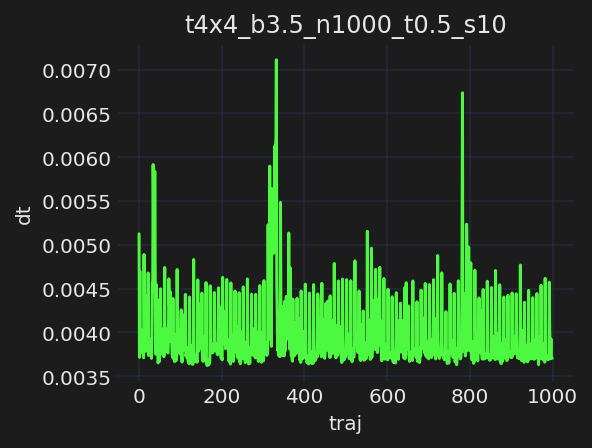

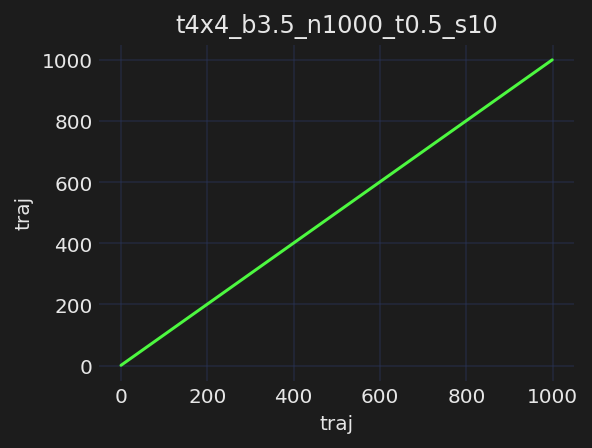

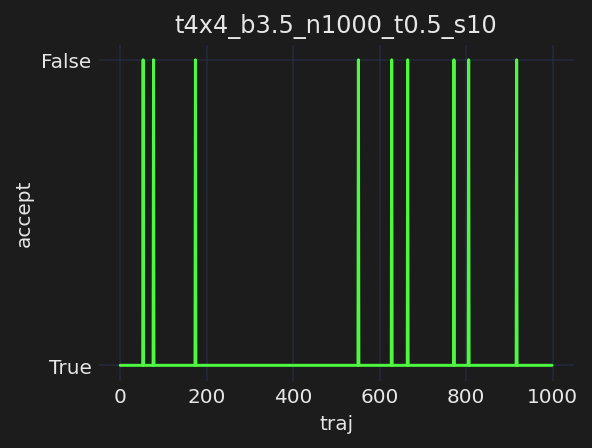

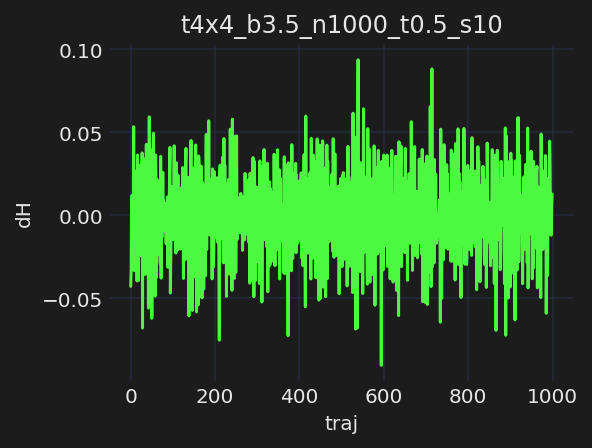

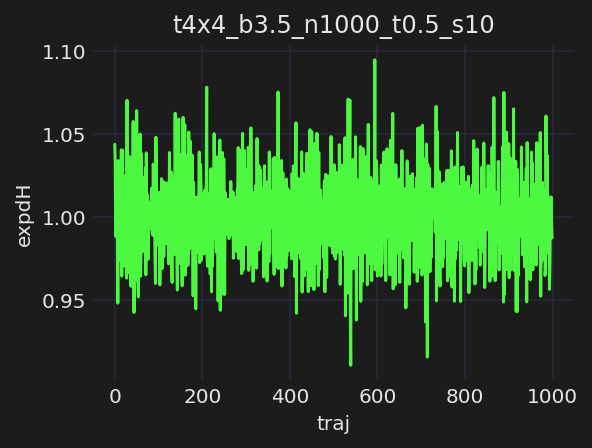

...

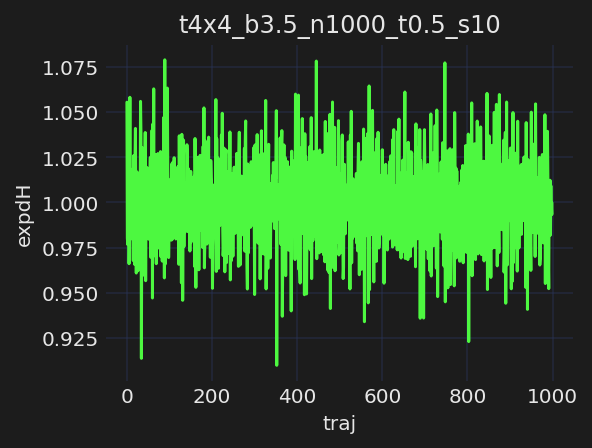

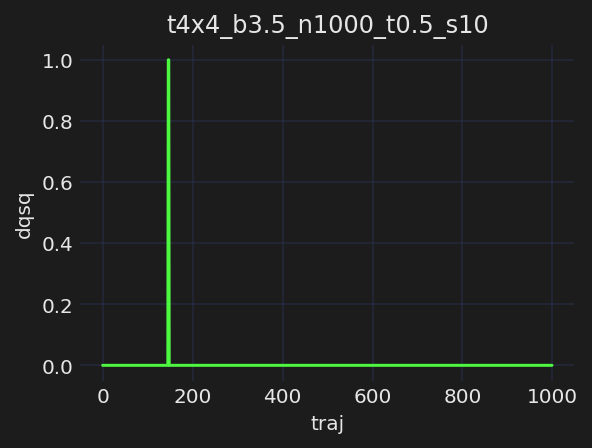

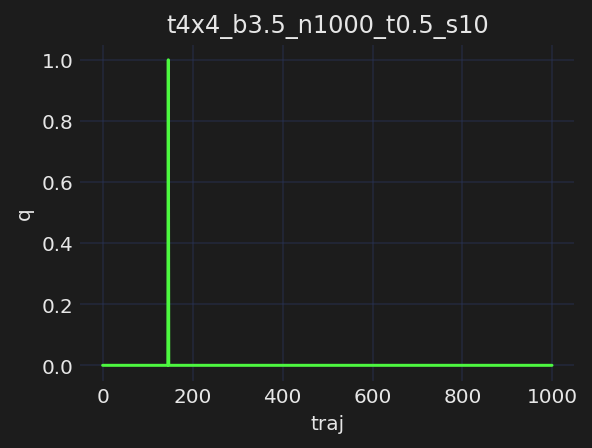

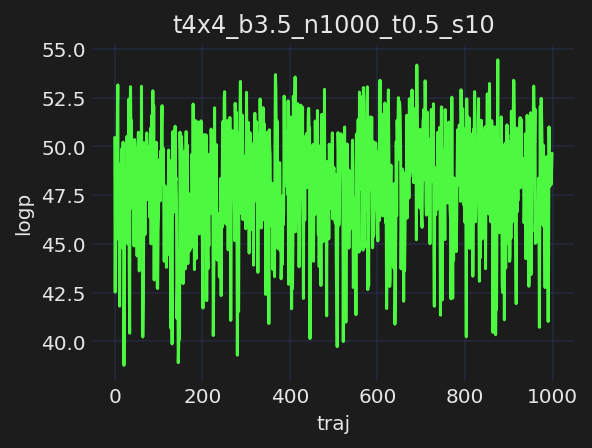

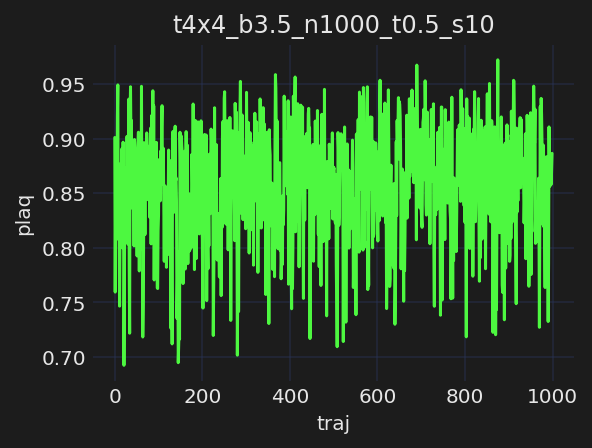

In [6]:
from fthmc.hmc import run_hmc

#hmc_mdir = io.tstamp_dir(os.path.join(logdir, 'hmc'))
#hmc_mdir = io.tstamp_dir(os.path.join(dirs, 'hmc'))

hmc_fields, hmc_history = run_hmc(param,
                                  keep_fields=True,
                                  save_history=True)

## Define `TrainConfig` and build model as
```python
model = {
    'prior': MultivariateUniform(...),
    'model': make_u1_equiv_layers(...),
}
```

### Train `model_init`:

[02:39:33]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933

[02:39:33]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots

[02:39:33]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoint
            s

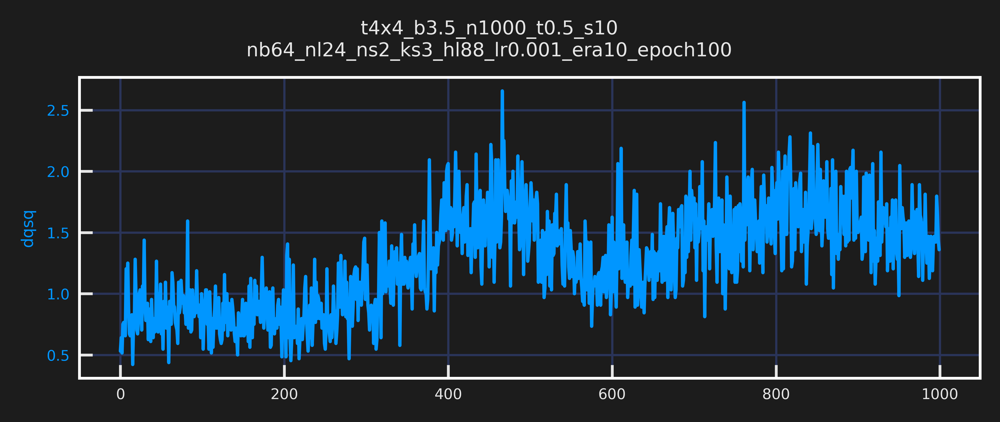

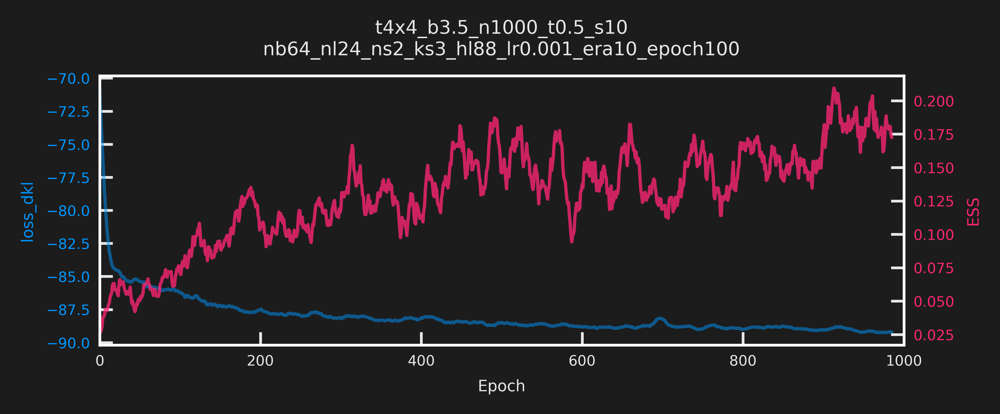

[02:39:34]  -----------------------------                                                    
            ERA=0, last took: 0 min 0 sec                                                    
            -----------------------------

[02:39:39]  epoch=19.000 step=19.000 dt=0.241 loss=-83.053 dqsq=0.841 ess=0.054 plaq=0.566   
            loss_dkl=-83.053 logp=31.684 logq=-51.369

[02:39:46]  epoch=39.000 step=39.000 dt=0.248 loss=-85.237 dqsq=0.769 ess=0.069 plaq=0.714   
            loss_dkl=-85.237 logp=39.982 logq=-45.255

[02:39:52]  epoch=59.000 step=59.000 dt=0.239 loss=-84.938 dqsq=0.794 ess=0.045 plaq=0.662   
            loss_dkl=-84.938 logp=37.078 logq=-47.860

[02:39:59]  epoch=79.000 step=79.000 dt=0.241 loss=-85.733 dqsq=0.922 ess=0.040 plaq=0.700   
            loss_dkl=-85.733 logp=39.175 logq=-46.558

[02:40:06]  epoch=99.000 step=99.000 dt=0.259 loss=-85.728 dqsq=0.853 ess=0.076 plaq=0.695   
            loss_dkl=-85.728 logp=38.917 logq=-46.811

[02:40:08]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoi
            nts/ckpt-era0-epoch100.tar

[02:40:08]  ---------------------------------                                                
            ERA=1, last took: 0 min 33.37 sec                                                
            ---------------------------------

[02:40:13]  epoch=19.000 step=119.000 dt=0.256 loss=-86.897 dqsq=0.828 ess=0.070 plaq=0.721  
            loss_dkl=-86.897 logp=40.396 logq=-46.501

[02:40:20]  epoch=39.000 step=139.000 dt=0.257 loss=-87.301 dqsq=0.803 ess=0.097 plaq=0.737  
            loss_dkl=-87.301 logp=41.271 logq=-46.030

[02:40:27]  epoch=59.000 step=159.000 dt=0.253 loss=-87.040 dqsq=0.841 ess=0.105 plaq=0.730  
            loss_dkl=-87.040 logp=40.891 logq=-46.149

[02:40:34]  epoch=79.000 step=179.000 dt=0.252 loss=-87.364 dqsq=0.894 ess=0.123 plaq=0.736  
            loss_dkl=-87.364 logp=41.193 logq=-46.171

[02:40:41]  epoch=99.000 step=199.000 dt=0.255 loss=-87.805 dqsq=0.806 ess=0.143 plaq=0.749  
            loss_dkl=-87.805 logp=41.961 logq=-45.844

[02:40:43]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoi
            nts/ckpt-era1-epoch100.tar

[02:40:43]  ---------------------------------                                                
            ERA=2, last took: 0 min 34.98 sec                                                
            ---------------------------------

[02:40:48]  epoch=19.000 step=219.000 dt=0.254 loss=-88.146 dqsq=0.659 ess=0.103 plaq=0.762  
            loss_dkl=-88.146 logp=42.689 logq=-45.457

[02:40:55]  epoch=39.000 step=239.000 dt=0.240 loss=-87.794 dqsq=0.938 ess=0.131 plaq=0.737  
            loss_dkl=-87.794 logp=41.281 logq=-46.513

[02:41:02]  epoch=59.000 step=259.000 dt=0.241 loss=-87.926 dqsq=0.706 ess=0.109 plaq=0.753  
            loss_dkl=-87.926 logp=42.158 logq=-45.768

[02:41:09]  epoch=79.000 step=279.000 dt=0.241 loss=-87.543 dqsq=0.800 ess=0.129 plaq=0.747  
            loss_dkl=-87.543 logp=41.836 logq=-45.707

[02:41:15]  epoch=99.000 step=299.000 dt=0.230 loss=-88.098 dqsq=1.219 ess=0.116 plaq=0.755  
            loss_dkl=-88.098 logp=42.274 logq=-45.824

[02:41:17]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoi
            nts/ckpt-era2-epoch100.tar

[02:41:17]  ---------------------------------                                                
            ERA=3, last took: 0 min 33.64 sec                                                
            ---------------------------------

[02:41:21]  epoch=19.000 step=319.000 dt=0.229 loss=-87.823 dqsq=1.169 ess=0.166 plaq=0.752  
            loss_dkl=-87.823 logp=42.091 logq=-45.732

[02:41:28]  epoch=39.000 step=339.000 dt=0.219 loss=-88.011 dqsq=1.253 ess=0.124 plaq=0.765  
            loss_dkl=-88.011 logp=42.861 logq=-45.151

[02:41:34]  epoch=59.000 step=359.000 dt=0.228 loss=-88.400 dqsq=1.247 ess=0.140 plaq=0.762  
            loss_dkl=-88.400 logp=42.666 logq=-45.734

[02:41:40]  epoch=79.000 step=379.000 dt=0.218 loss=-88.374 dqsq=1.428 ess=0.104 plaq=0.768  
            loss_dkl=-88.374 logp=43.011 logq=-45.363

[02:41:47]  epoch=99.000 step=399.000 dt=0.221 loss=-88.398 dqsq=1.819 ess=0.164 plaq=0.772  
            loss_dkl=-88.398 logp=43.228 logq=-45.170

[02:41:48]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoi
            nts/ckpt-era3-epoch100.tar

[02:41:48]  --------------------------------                                                 
            ERA=4, last took: 0 min 31.4 sec                                                 
            --------------------------------

[02:41:53]  epoch=19.000 step=419.000 dt=0.234 loss=-88.059 dqsq=1.556 ess=0.153 plaq=0.757  
            loss_dkl=-88.059 logp=42.379 logq=-45.680

[02:42:00]  epoch=39.000 step=439.000 dt=0.237 loss=-88.487 dqsq=1.697 ess=0.141 plaq=0.774  
            loss_dkl=-88.487 logp=43.368 logq=-45.118

[02:42:06]  epoch=59.000 step=459.000 dt=0.252 loss=-88.254 dqsq=1.553 ess=0.150 plaq=0.758  
            loss_dkl=-88.254 logp=42.423 logq=-45.831

[02:42:13]  epoch=79.000 step=479.000 dt=0.252 loss=-88.288 dqsq=1.656 ess=0.162 plaq=0.764  
            loss_dkl=-88.288 logp=42.809 logq=-45.479

[02:42:21]  epoch=99.000 step=499.000 dt=0.256 loss=-88.699 dqsq=1.522 ess=0.223 plaq=0.776  
            loss_dkl=-88.699 logp=43.447 logq=-45.252

[02:42:23]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoi
            nts/ckpt-era4-epoch100.tar

[02:42:23]  ---------------------------------                                                
            ERA=5, last took: 0 min 34.25 sec                                                
            ---------------------------------

[02:42:28]  epoch=19.000 step=519.000 dt=0.283 loss=-88.633 dqsq=1.275 ess=0.135 plaq=0.774  
            loss_dkl=-88.633 logp=43.332 logq=-45.301

[02:42:36]  epoch=39.000 step=539.000 dt=0.268 loss=-88.710 dqsq=1.431 ess=0.162 plaq=0.774  
            loss_dkl=-88.710 logp=43.333 logq=-45.377

[02:42:43]  epoch=59.000 step=559.000 dt=0.267 loss=-88.519 dqsq=1.178 ess=0.138 plaq=0.771  
            loss_dkl=-88.519 logp=43.184 logq=-45.334

[02:42:51]  epoch=79.000 step=579.000 dt=0.269 loss=-88.708 dqsq=1.000 ess=0.200 plaq=0.779  
            loss_dkl=-88.708 logp=43.651 logq=-45.056

[02:42:58]  epoch=99.000 step=599.000 dt=0.269 loss=-88.906 dqsq=1.203 ess=0.067 plaq=0.783  
            loss_dkl=-88.906 logp=43.831 logq=-45.076

[02:43:00]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoi
            nts/ckpt-era5-epoch100.tar

[02:43:00]  ---------------------------------                                                
            ERA=6, last took: 0 min 37.27 sec                                                
            ---------------------------------

[02:43:05]  epoch=19.000 step=619.000 dt=0.254 loss=-88.667 dqsq=1.147 ess=0.185 plaq=0.778  
            loss_dkl=-88.667 logp=43.544 logq=-45.123

[02:43:12]  epoch=39.000 step=639.000 dt=0.241 loss=-88.794 dqsq=0.956 ess=0.152 plaq=0.791  
            loss_dkl=-88.794 logp=44.269 logq=-44.525

[02:43:19]  epoch=59.000 step=659.000 dt=0.242 loss=-88.808 dqsq=1.328 ess=0.130 plaq=0.786  
            loss_dkl=-88.808 logp=44.005 logq=-44.804

[02:43:25]  epoch=79.000 step=679.000 dt=0.231 loss=-88.938 dqsq=1.203 ess=0.139 plaq=0.791  
            loss_dkl=-88.938 logp=44.308 logq=-44.630

[02:43:32]  epoch=99.000 step=699.000 dt=0.222 loss=-88.533 dqsq=1.750 ess=0.156 plaq=0.776  
            loss_dkl=-88.533 logp=43.464 logq=-45.069

[02:43:33]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoi
            nts/ckpt-era6-epoch100.tar

[02:43:33]  ---------------------------------                                                
            ERA=7, last took: 0 min 33.05 sec                                                
            ---------------------------------

[02:43:38]  epoch=19.000 step=719.000 dt=0.220 loss=-88.887 dqsq=1.481 ess=0.104 plaq=0.788  
            loss_dkl=-88.887 logp=44.104 logq=-44.782

[02:43:44]  epoch=39.000 step=739.000 dt=0.218 loss=-88.621 dqsq=1.241 ess=0.142 plaq=0.775  
            loss_dkl=-88.621 logp=43.414 logq=-45.208

[02:43:50]  epoch=59.000 step=759.000 dt=0.210 loss=-89.059 dqsq=1.484 ess=0.116 plaq=0.793  
            loss_dkl=-89.059 logp=44.412 logq=-44.647

[02:43:56]  epoch=79.000 step=779.000 dt=0.201 loss=-88.740 dqsq=1.516 ess=0.114 plaq=0.781  
            loss_dkl=-88.740 logp=43.708 logq=-45.032

[02:44:01]  epoch=99.000 step=799.000 dt=0.201 loss=-88.640 dqsq=1.703 ess=0.111 plaq=0.786  
            loss_dkl=-88.640 logp=44.037 logq=-44.603

[02:44:03]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoi
            nts/ckpt-era7-epoch100.tar

[02:44:03]  ---------------------------------                                                
            ERA=8, last took: 0 min 29.47 sec                                                
            ---------------------------------

[02:44:07]  epoch=19.000 step=819.000 dt=0.201 loss=-88.911 dqsq=1.897 ess=0.152 plaq=0.796  
            loss_dkl=-88.911 logp=44.600 logq=-44.311

[02:44:13]  epoch=39.000 step=839.000 dt=0.201 loss=-88.943 dqsq=1.456 ess=0.144 plaq=0.795  
            loss_dkl=-88.943 logp=44.521 logq=-44.422

[02:44:18]  epoch=59.000 step=859.000 dt=0.202 loss=-88.794 dqsq=1.653 ess=0.138 plaq=0.780  
            loss_dkl=-88.794 logp=43.705 logq=-45.088

[02:44:24]  epoch=79.000 step=879.000 dt=0.201 loss=-89.037 dqsq=1.488 ess=0.171 plaq=0.790  
            loss_dkl=-89.037 logp=44.233 logq=-44.804

[02:44:29]  epoch=99.000 step=899.000 dt=0.203 loss=-89.078 dqsq=1.591 ess=0.119 plaq=0.794  
            loss_dkl=-89.078 logp=44.450 logq=-44.628

[02:44:31]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoi
            nts/ckpt-era8-epoch100.tar

[02:44:31]  ---------------------------------                                                
            ERA=9, last took: 0 min 27.87 sec                                                
            ---------------------------------

[02:44:35]  epoch=19.000 step=919.000 dt=0.193 loss=-89.006 dqsq=1.634 ess=0.197 plaq=0.793  
            loss_dkl=-89.006 logp=44.398 logq=-44.608

[02:44:40]  epoch=39.000 step=939.000 dt=0.195 loss=-88.971 dqsq=1.431 ess=0.142 plaq=0.786  
            loss_dkl=-88.971 logp=44.008 logq=-44.962

[02:44:46]  epoch=59.000 step=959.000 dt=0.193 loss=-89.233 dqsq=1.494 ess=0.170 plaq=0.798  
            loss_dkl=-89.233 logp=44.681 logq=-44.553

[02:44:51]  epoch=79.000 step=979.000 dt=0.194 loss=-89.286 dqsq=1.550 ess=0.119 plaq=0.791  
            loss_dkl=-89.286 logp=44.296 logq=-44.989

[02:44:56]  epoch=99.000 step=999.000 dt=0.193 loss=-89.099 dqsq=1.531 ess=0.154 plaq=0.785  
            loss_dkl=-89.099 logp=43.977 logq=-45.121

[02:44:58]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoi
            nts/ckpt-era9-epoch100.tar

            Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/checkpoi
            nts/ckpt-era9-epoch100.tar

[02:44:58]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots/dqsq_l
            ive.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots/dkl_li
            ve.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots/dt.pdf

[02:44:59]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots/loss.p
            df

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots/dqsq.p
            df

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots/ess.pd
            f

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots/plaq.p
            df

[02:45:00]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots/loss_d
            kl.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots/logp.p
            df

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/plots/logq.p
            df

[02:45:00]  Saving train_history to /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/2021-06-13-023933/train_
            history.z.

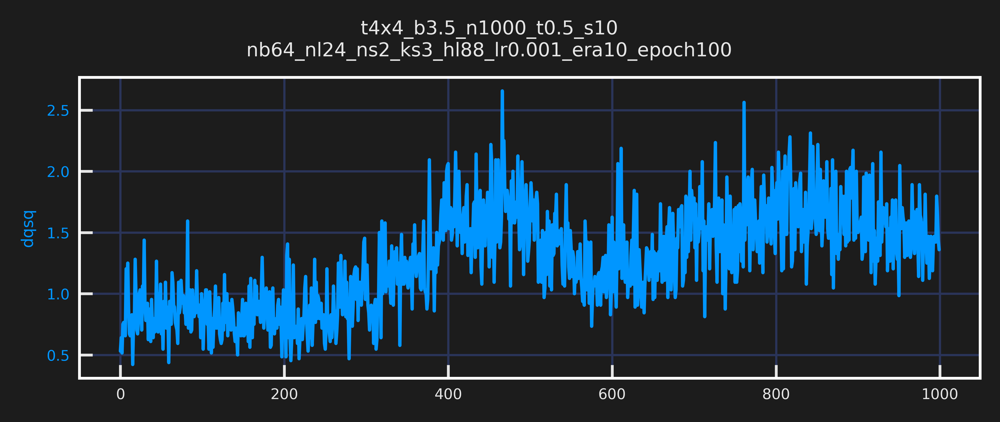

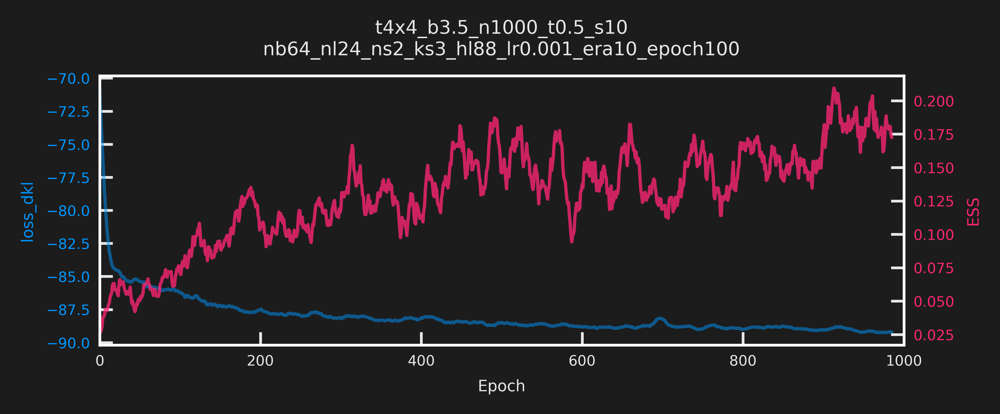

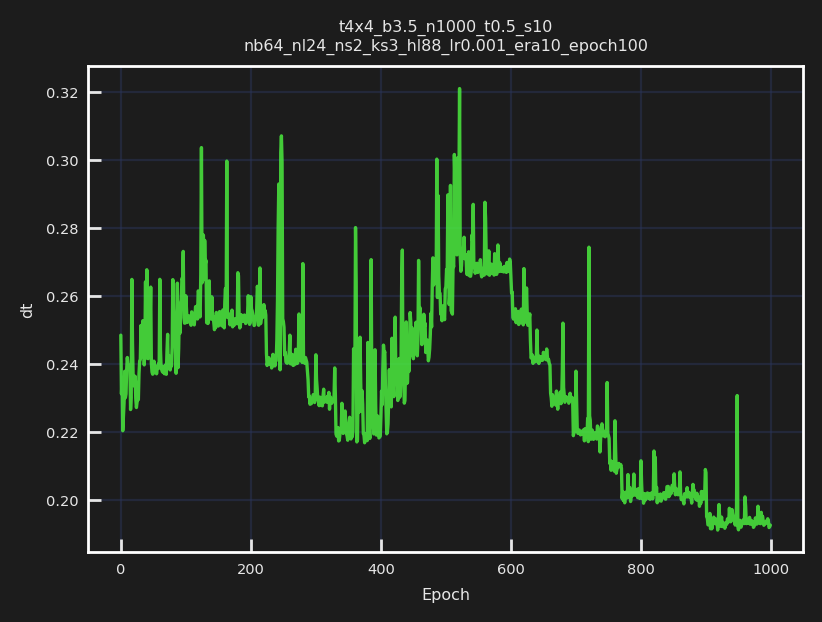

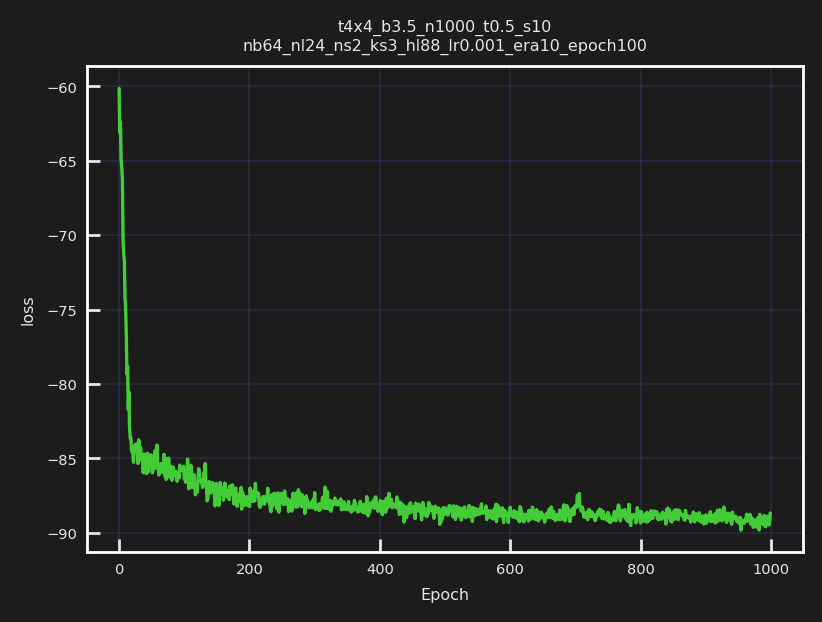

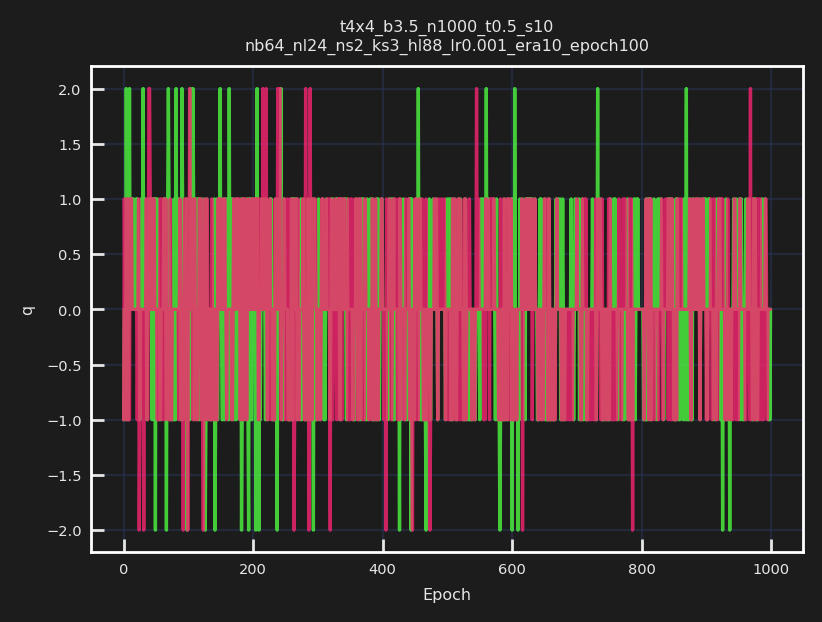

...

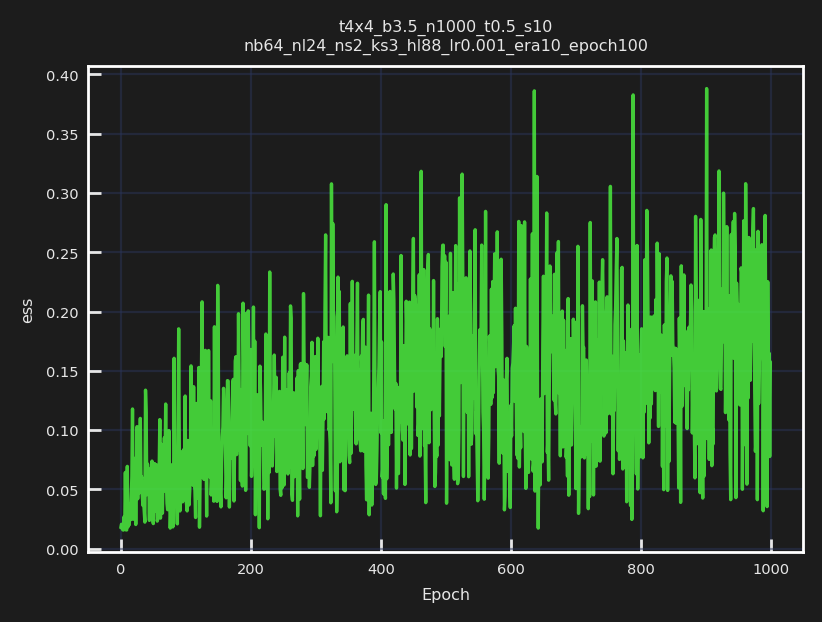

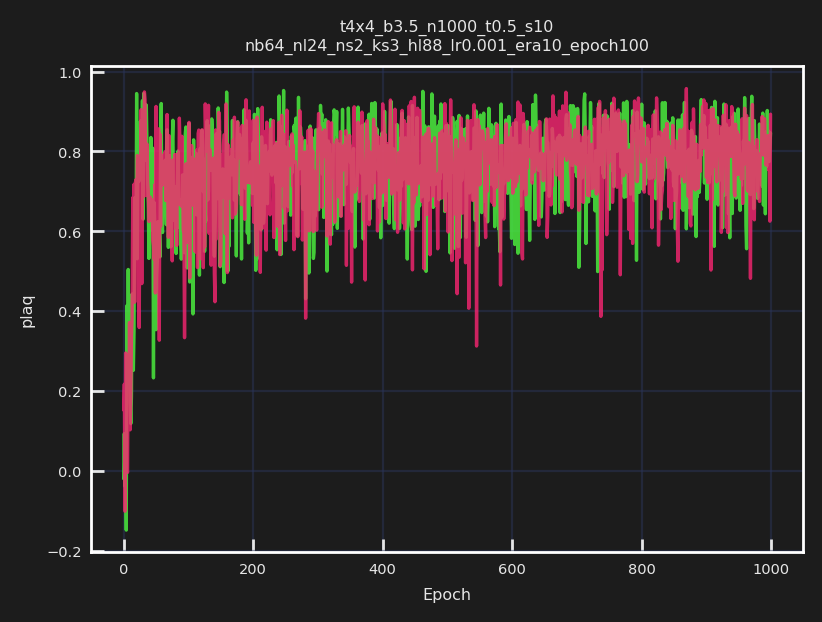

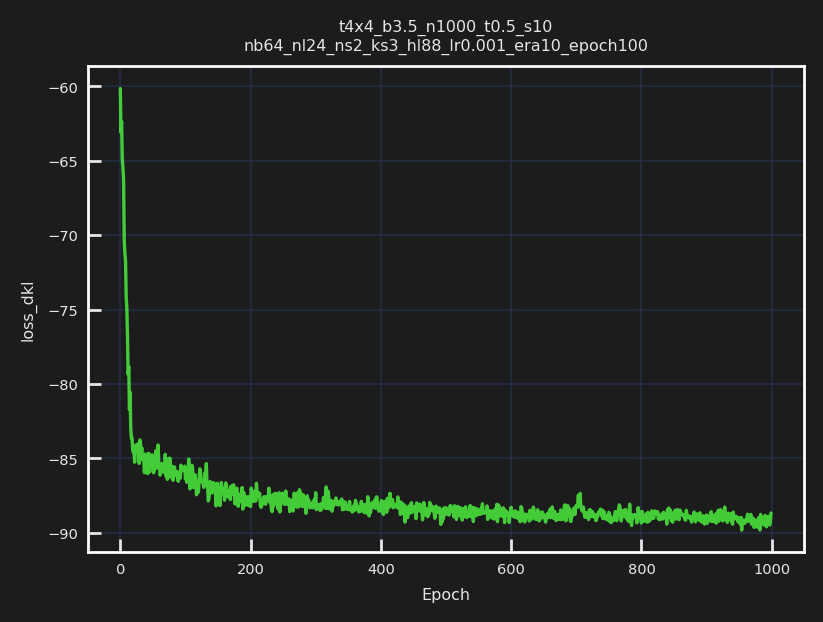

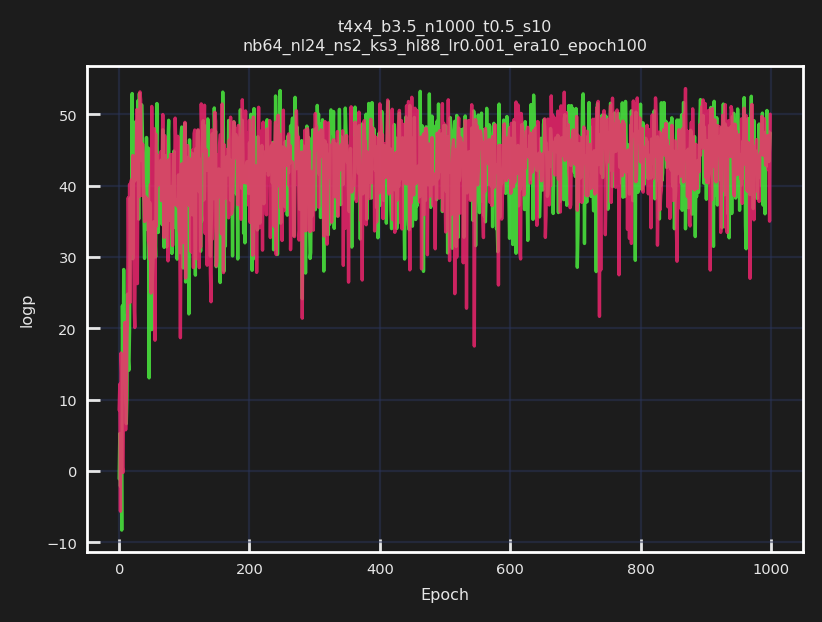

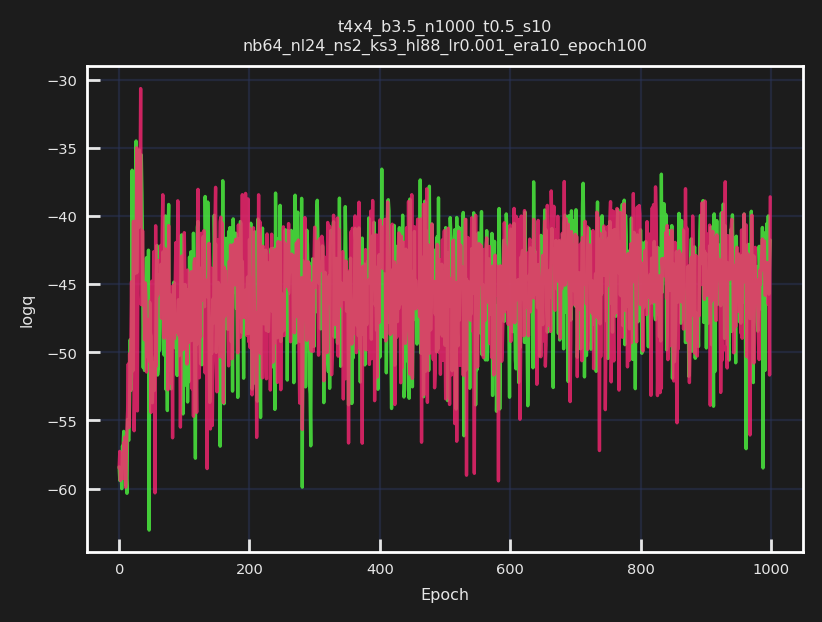

In [7]:
from fthmc.train import train

%matplotlib inline
plt.style.use('default')
plt.style.use('/Users/saforem2/.matplotlib/stylelib/molokai.mplstyle')
sns.set_context('paper', font_scale=0.6)

train_outputs = train(param,
                      train_config,
                      pre_model=None,
                      figsize=(5, 2))

pre_flow_plots = train_outputs['plots']
pre_flow_history = train_outputs['history']
flow_act = train_outputs['action']
pre_flow_model = train_outputs['model']
pre_flow_optimizer = train_outputs['optimizer']

## Run inference on trained model and plot history

/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:138: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.array(val)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.array(val)


[03:11:47]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots

[03:11:47]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/ess.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/dqsq.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/dkl.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/logq.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/logp.pdf

[03:11:48]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t4x4_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/accepted.pdf

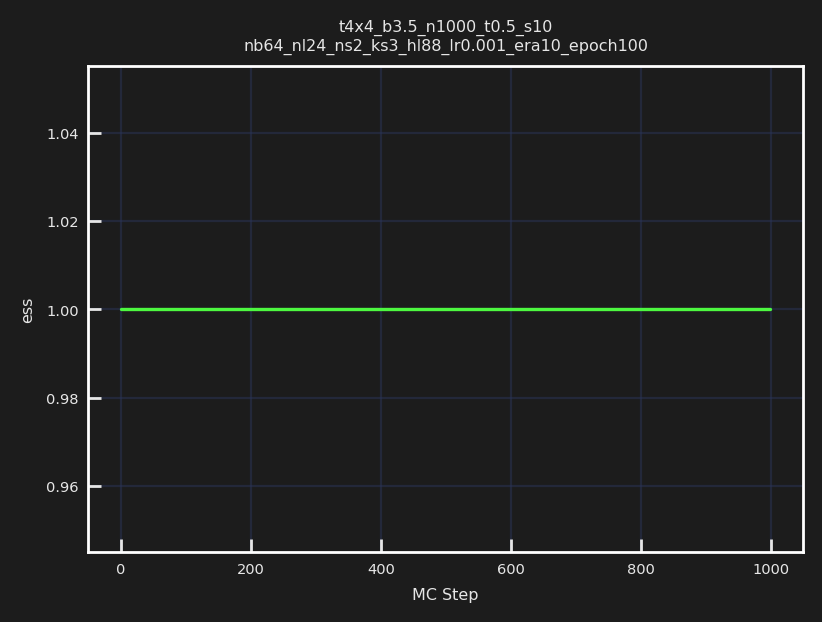

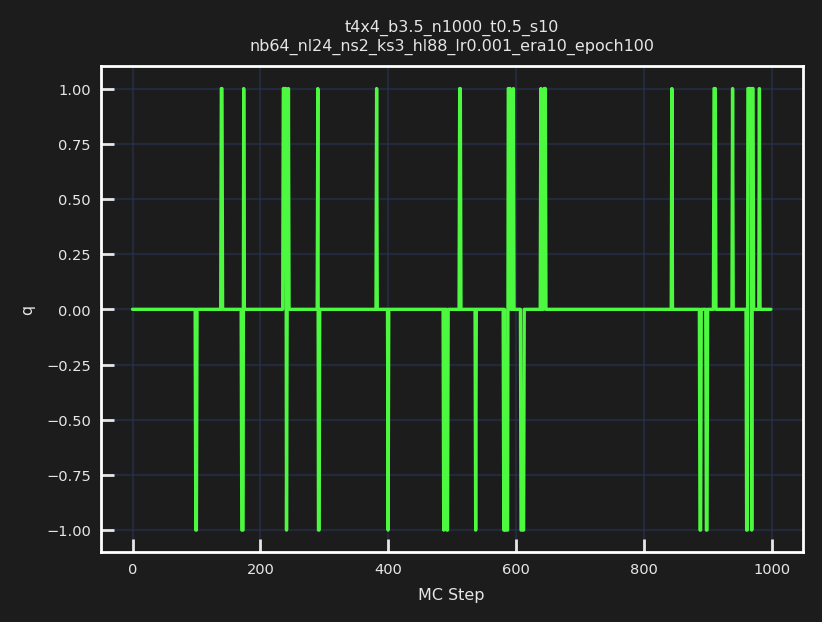

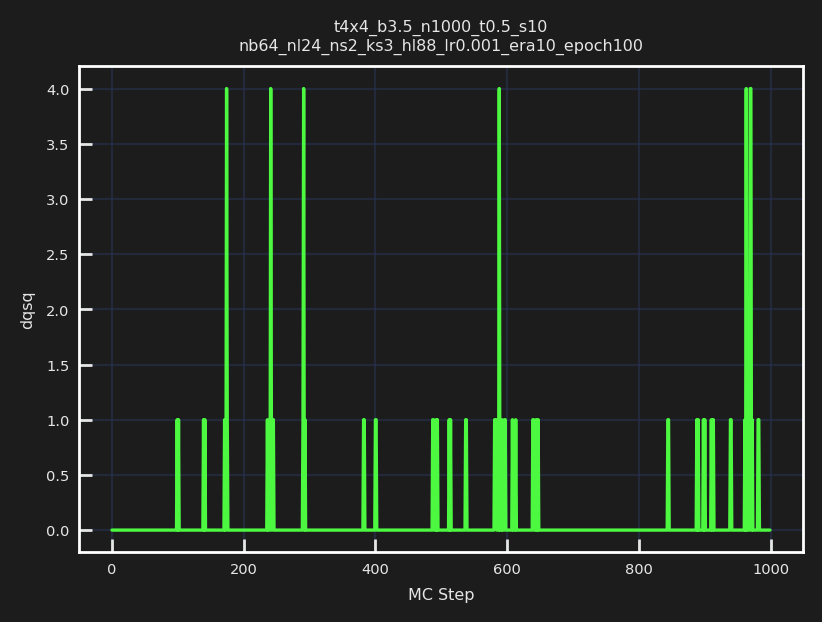

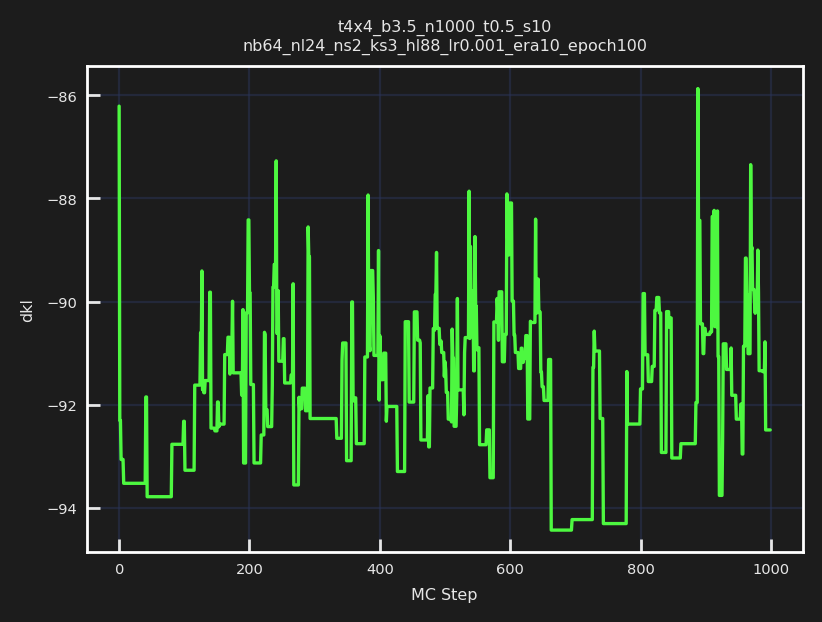

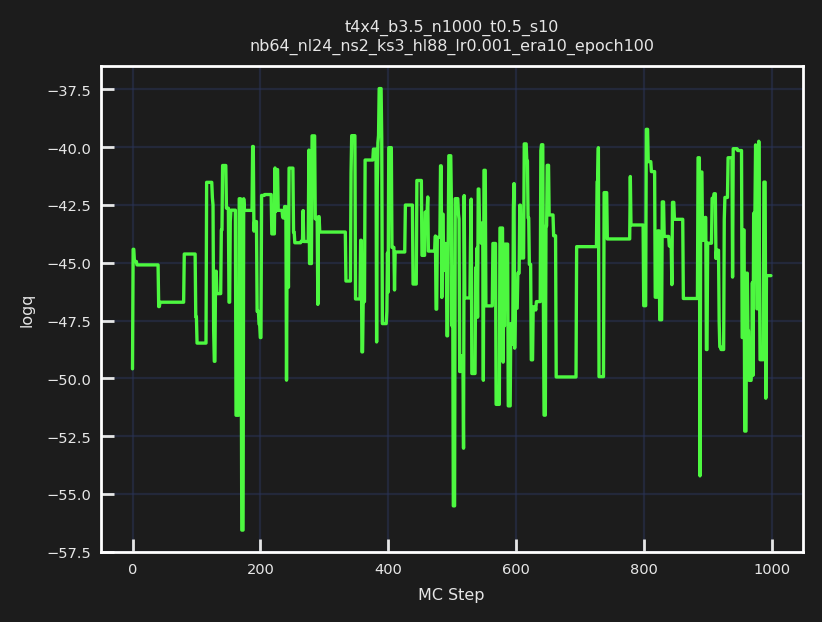

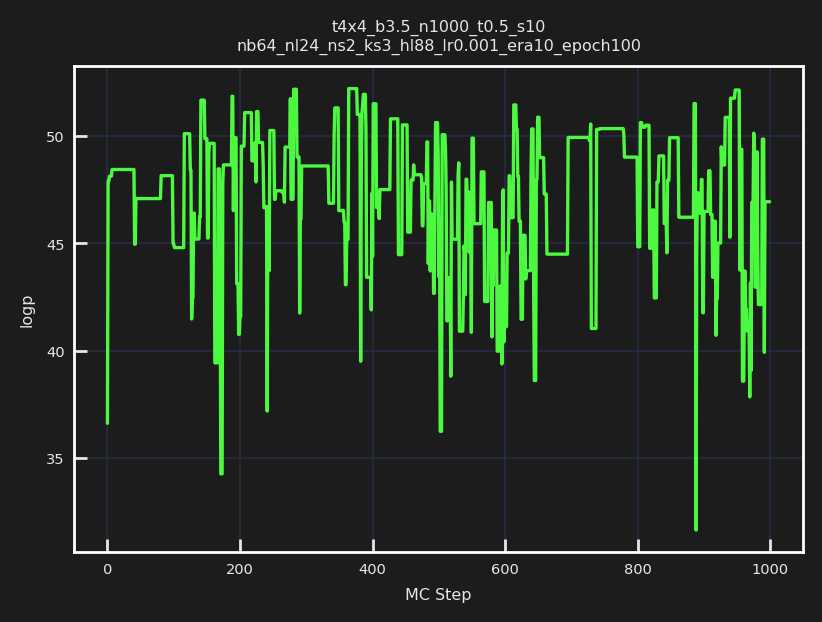

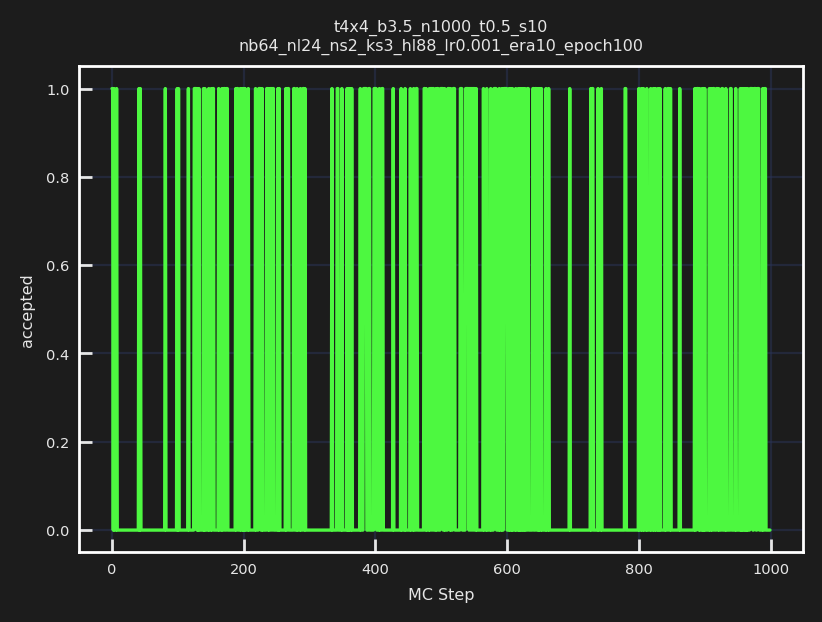

In [8]:
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history
from fthmc.utils.samplers import make_mcmc_ensemble

action_fn = qed.BatchAction(param.beta)
dirs = train_outputs['dirs']
logdir = dirs['logdir']

inf_dir = os.path.join(logdir, 'inference')
inf_pdir = os.path.join(inf_dir, 'plots')
history = make_mcmc_ensemble(model=train_outputs['model'], action_fn=action_fn,
                             batch_size=train_config.batch_size, num_samples=1000)
plot_history(history=history,
             param=param, config=train_config, skip=['epoch', 'x'],
             num_chains=4, therm_frac=0.0, xlabel='MC Step', outdir=inf_pdir)

[03:13:12]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/2021-06-13-031312

[03:13:12]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s1
            0/2021-06-13-031312/plots

[03:13:12]  Param:                                                                           
            ----------------                                                                 
            beta=3.5                                                                         
            L=4                                                                              
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=1000                                                                       
            nrun=2                                                                           
            nprint=100                                                                       
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[4, 4]                                                                       
            nd=2                                                                             
            shape=[2, 4, 4]                                                                  
            volume=16                                                                        
            dt=0.05

            action=1.000 plaq=0.000 charge=0.000

            dt=0.003 traj=2 accept=True dH=0.013 expdH=0.987 q=0 dqsq=0 logp=51.153          
            plaq=0.913

            dt=0.004 traj=12 accept=True dH=0.048 expdH=0.954 q=0 dqsq=0 logp=46.530         
            plaq=0.831

            dt=0.004 traj=22 accept=True dH=-0.011 expdH=1.011 q=0 dqsq=0 logp=47.603        
            plaq=0.850

            dt=0.003 traj=32 accept=True dH=0.017 expdH=0.983 q=0 dqsq=0 logp=50.877         
            plaq=0.909

            dt=0.003 traj=42 accept=True dH=-0.008 expdH=1.008 q=0 dqsq=0 logp=46.565        
            plaq=0.832

            dt=0.003 traj=52 accept=True dH=-0.021 expdH=1.021 q=0 dqsq=0 logp=47.165        
            plaq=0.842

            dt=0.004 traj=62 accept=False dH=0.032 expdH=0.969 q=0 dqsq=0 logp=43.646        
            plaq=0.779

            dt=0.003 traj=72 accept=True dH=0.018 expdH=0.982 q=0 dqsq=0 logp=49.509         
            plaq=0.884

            dt=0.003 traj=82 accept=True dH=0.037 expdH=0.964 q=0 dqsq=0 logp=52.565         
            plaq=0.939

[03:13:13]  dt=0.003 traj=92 accept=True dH=0.030 expdH=0.971 q=0 dqsq=0 logp=49.999         
            plaq=0.893

            dt=0.003 traj=102 accept=True dH=0.014 expdH=0.986 q=0 dqsq=0 logp=48.986        
            plaq=0.875

            dt=0.004 traj=112 accept=True dH=0.022 expdH=0.978 q=0 dqsq=0 logp=48.213        
            plaq=0.861

            dt=0.003 traj=122 accept=True dH=-0.005 expdH=1.005 q=1 dqsq=1 logp=40.981       
            plaq=0.732

            dt=0.003 traj=132 accept=True dH=0.009 expdH=0.991 q=1 dqsq=0 logp=40.260        
            plaq=0.719

            dt=0.004 traj=142 accept=True dH=-0.025 expdH=1.025 q=1 dqsq=1 logp=42.113       
            plaq=0.752

            dt=0.003 traj=152 accept=True dH=0.022 expdH=0.979 q=1 dqsq=0 logp=44.049        
            plaq=0.787

            dt=0.003 traj=162 accept=True dH=-0.028 expdH=1.028 q=0 dqsq=1 logp=42.969       
            plaq=0.767

            dt=0.003 traj=172 accept=True dH=-0.004 expdH=1.004 q=1 dqsq=1 logp=44.388       
            plaq=0.793

            dt=0.003 traj=182 accept=True dH=0.006 expdH=0.994 q=1 dqsq=1 logp=47.675        
            plaq=0.851

            dt=0.003 traj=192 accept=True dH=0.015 expdH=0.985 q=0 dqsq=0 logp=51.059        
            plaq=0.912

            dt=0.003 traj=202 accept=True dH=-0.000 expdH=1.000 q=0 dqsq=0 logp=49.619       
            plaq=0.886

            dt=0.003 traj=212 accept=True dH=0.018 expdH=0.982 q=0 dqsq=0 logp=48.159        
            plaq=0.860

            dt=0.003 traj=222 accept=True dH=-0.002 expdH=1.002 q=0 dqsq=0 logp=47.166       
            plaq=0.842

            dt=0.003 traj=232 accept=True dH=0.001 expdH=0.999 q=0 dqsq=0 logp=47.611        
            plaq=0.850

            dt=0.003 traj=242 accept=True dH=-0.024 expdH=1.025 q=0 dqsq=0 logp=40.852       
            plaq=0.730

            dt=0.004 traj=252 accept=True dH=0.025 expdH=0.975 q=0 dqsq=0 logp=52.834        
            plaq=0.943

            dt=0.004 traj=262 accept=True dH=-0.001 expdH=1.001 q=0 dqsq=0 logp=49.128       
            plaq=0.877

            dt=0.003 traj=272 accept=True dH=-0.008 expdH=1.008 q=0 dqsq=0 logp=48.756       
            plaq=0.871

            dt=0.003 traj=282 accept=True dH=-0.002 expdH=1.002 q=0 dqsq=0 logp=50.555       
            plaq=0.903

            dt=0.004 traj=292 accept=True dH=0.010 expdH=0.990 q=0 dqsq=0 logp=51.854        
            plaq=0.926

[03:13:14]  dt=0.003 traj=302 accept=True dH=-0.026 expdH=1.027 q=0 dqsq=0 logp=45.005       
            plaq=0.804

            dt=0.004 traj=312 accept=True dH=0.029 expdH=0.971 q=0 dqsq=0 logp=50.493        
            plaq=0.902

            dt=0.004 traj=322 accept=True dH=-0.002 expdH=1.002 q=0 dqsq=0 logp=48.561       
            plaq=0.867

            dt=0.003 traj=332 accept=True dH=0.032 expdH=0.969 q=0 dqsq=0 logp=51.387        
            plaq=0.918

            dt=0.004 traj=342 accept=True dH=0.007 expdH=0.993 q=0 dqsq=0 logp=48.346        
            plaq=0.863

            dt=0.003 traj=352 accept=True dH=-0.014 expdH=1.014 q=0 dqsq=0 logp=48.198       
            plaq=0.861

            dt=0.004 traj=362 accept=True dH=-0.031 expdH=1.031 q=0 dqsq=0 logp=47.313       
            plaq=0.845

            dt=0.003 traj=372 accept=True dH=-0.031 expdH=1.031 q=0 dqsq=0 logp=44.418       
            plaq=0.793

            dt=0.004 traj=382 accept=True dH=0.040 expdH=0.961 q=0 dqsq=0 logp=50.261        
            plaq=0.898

            dt=0.003 traj=392 accept=True dH=-0.009 expdH=1.009 q=0 dqsq=0 logp=45.158       
            plaq=0.806

            dt=0.004 traj=402 accept=True dH=-0.003 expdH=1.003 q=0 dqsq=0 logp=46.539       
            plaq=0.831

            dt=0.004 traj=412 accept=True dH=-0.009 expdH=1.009 q=0 dqsq=0 logp=46.176       
            plaq=0.825

            dt=0.004 traj=422 accept=True dH=0.017 expdH=0.983 q=0 dqsq=0 logp=48.254        
            plaq=0.862

            dt=0.004 traj=432 accept=True dH=-0.003 expdH=1.003 q=0 dqsq=0 logp=48.652       
            plaq=0.869

            dt=0.004 traj=442 accept=True dH=-0.019 expdH=1.019 q=0 dqsq=0 logp=47.604       
            plaq=0.850

            dt=0.003 traj=452 accept=True dH=-0.016 expdH=1.016 q=0 dqsq=0 logp=48.940       
            plaq=0.874

            dt=0.003 traj=462 accept=False dH=0.078 expdH=0.925 q=0 dqsq=0 logp=45.689       
            plaq=0.816

            dt=0.003 traj=472 accept=True dH=-0.023 expdH=1.023 q=0 dqsq=0 logp=49.898       
            plaq=0.891

            dt=0.004 traj=482 accept=True dH=0.037 expdH=0.964 q=0 dqsq=0 logp=49.283        
            plaq=0.880

            dt=0.004 traj=492 accept=True dH=-0.011 expdH=1.011 q=0 dqsq=0 logp=40.695       
            plaq=0.727

            dt=0.003 traj=502 accept=True dH=-0.004 expdH=1.004 q=0 dqsq=0 logp=47.751       
            plaq=0.853

[03:13:15]  dt=0.004 traj=512 accept=True dH=0.027 expdH=0.973 q=0 dqsq=0 logp=45.561        
            plaq=0.814

            dt=0.004 traj=522 accept=True dH=0.008 expdH=0.992 q=0 dqsq=0 logp=47.696        
            plaq=0.852

            dt=0.004 traj=532 accept=True dH=0.009 expdH=0.991 q=-1 dqsq=1 logp=45.811       
            plaq=0.818

            dt=0.004 traj=542 accept=True dH=-0.003 expdH=1.003 q=-1 dqsq=0 logp=42.565      
            plaq=0.760

            dt=0.004 traj=552 accept=True dH=0.023 expdH=0.977 q=-1 dqsq=1 logp=47.484       
            plaq=0.848

            dt=0.004 traj=562 accept=True dH=0.029 expdH=0.972 q=0 dqsq=0 logp=52.124        
            plaq=0.931

            dt=0.004 traj=572 accept=True dH=0.007 expdH=0.993 q=0 dqsq=0 logp=41.911        
            plaq=0.748

            dt=0.004 traj=582 accept=True dH=-0.003 expdH=1.003 q=0 dqsq=0 logp=44.438       
            plaq=0.794

            dt=0.004 traj=592 accept=True dH=0.000 expdH=1.000 q=0 dqsq=0 logp=50.164        
            plaq=0.896

            dt=0.004 traj=602 accept=True dH=-0.001 expdH=1.001 q=0 dqsq=0 logp=46.066       
            plaq=0.823

            dt=0.004 traj=612 accept=True dH=0.041 expdH=0.959 q=0 dqsq=0 logp=47.782        
            plaq=0.853

            dt=0.003 traj=622 accept=True dH=0.001 expdH=0.999 q=0 dqsq=0 logp=46.247        
            plaq=0.826

            dt=0.003 traj=632 accept=True dH=0.013 expdH=0.987 q=0 dqsq=0 logp=47.104        
            plaq=0.841

            dt=0.004 traj=642 accept=True dH=0.047 expdH=0.954 q=0 dqsq=0 logp=50.662        
            plaq=0.905

            dt=0.003 traj=652 accept=True dH=0.012 expdH=0.988 q=0 dqsq=0 logp=48.885        
            plaq=0.873

            dt=0.004 traj=662 accept=True dH=-0.009 expdH=1.009 q=0 dqsq=0 logp=48.639       
            plaq=0.869

            dt=0.004 traj=672 accept=True dH=-0.020 expdH=1.021 q=0 dqsq=0 logp=48.782       
            plaq=0.871

            dt=0.004 traj=682 accept=True dH=0.062 expdH=0.940 q=0 dqsq=0 logp=50.812        
            plaq=0.907

            dt=0.003 traj=692 accept=True dH=0.017 expdH=0.983 q=0 dqsq=0 logp=53.238        
            plaq=0.951

[03:13:16]  dt=0.004 traj=702 accept=True dH=0.049 expdH=0.952 q=0 dqsq=0 logp=50.673        
            plaq=0.905

            dt=0.003 traj=712 accept=True dH=0.007 expdH=0.993 q=0 dqsq=0 logp=51.198        
            plaq=0.914

            dt=0.004 traj=722 accept=True dH=0.014 expdH=0.986 q=0 dqsq=0 logp=50.161        
            plaq=0.896

            dt=0.003 traj=732 accept=True dH=-0.019 expdH=1.019 q=0 dqsq=0 logp=47.910       
            plaq=0.856

            dt=0.003 traj=742 accept=True dH=0.010 expdH=0.990 q=0 dqsq=0 logp=49.899        
            plaq=0.891

            dt=0.004 traj=752 accept=True dH=0.029 expdH=0.972 q=0 dqsq=0 logp=51.889        
            plaq=0.927

            dt=0.004 traj=762 accept=True dH=-0.001 expdH=1.001 q=0 dqsq=0 logp=40.535       
            plaq=0.724

            dt=0.004 traj=772 accept=True dH=0.016 expdH=0.984 q=0 dqsq=0 logp=42.339        
            plaq=0.756

            dt=0.004 traj=782 accept=True dH=0.005 expdH=0.995 q=0 dqsq=0 logp=50.050        
            plaq=0.894

            dt=0.004 traj=792 accept=True dH=-0.002 expdH=1.002 q=0 dqsq=0 logp=46.909       
            plaq=0.838

            dt=0.004 traj=802 accept=True dH=0.012 expdH=0.988 q=0 dqsq=0 logp=51.172        
            plaq=0.914

            dt=0.004 traj=812 accept=True dH=0.012 expdH=0.988 q=0 dqsq=0 logp=44.992        
            plaq=0.803

            dt=0.003 traj=822 accept=True dH=-0.024 expdH=1.025 q=0 dqsq=0 logp=47.429       
            plaq=0.847

            dt=0.004 traj=832 accept=True dH=0.020 expdH=0.981 q=0 dqsq=0 logp=48.816        
            plaq=0.872

            dt=0.004 traj=842 accept=True dH=0.036 expdH=0.965 q=0 dqsq=0 logp=52.979        
            plaq=0.946

            dt=0.004 traj=852 accept=True dH=0.026 expdH=0.974 q=0 dqsq=0 logp=48.840        
            plaq=0.872

            dt=0.004 traj=862 accept=True dH=0.020 expdH=0.980 q=0 dqsq=0 logp=49.714        
            plaq=0.888

            dt=0.004 traj=872 accept=True dH=-0.013 expdH=1.013 q=0 dqsq=0 logp=49.882       
            plaq=0.891

            dt=0.004 traj=882 accept=True dH=0.007 expdH=0.993 q=0 dqsq=0 logp=47.812        
            plaq=0.854

            dt=0.003 traj=892 accept=True dH=0.000 expdH=1.000 q=0 dqsq=0 logp=51.480        
            plaq=0.919

            dt=0.004 traj=902 accept=True dH=0.014 expdH=0.986 q=0 dqsq=0 logp=49.948        
            plaq=0.892

[03:13:17]  dt=0.003 traj=912 accept=True dH=-0.038 expdH=1.039 q=0 dqsq=0 logp=48.628       
            plaq=0.868

            dt=0.004 traj=922 accept=True dH=0.026 expdH=0.974 q=-1 dqsq=1 logp=43.312       
            plaq=0.773

            dt=0.004 traj=932 accept=True dH=-0.018 expdH=1.019 q=-1 dqsq=1 logp=40.186      
            plaq=0.718

            dt=0.003 traj=942 accept=True dH=-0.023 expdH=1.023 q=-1 dqsq=0 logp=45.707      
            plaq=0.816

            dt=0.004 traj=952 accept=True dH=0.012 expdH=0.988 q=-1 dqsq=1 logp=43.065       
            plaq=0.769

            dt=0.004 traj=962 accept=True dH=-0.019 expdH=1.019 q=0 dqsq=1 logp=38.924       
            plaq=0.695

            dt=0.004 traj=972 accept=True dH=0.014 expdH=0.986 q=0 dqsq=0 logp=45.355        
            plaq=0.810

            dt=0.003 traj=982 accept=True dH=0.020 expdH=0.980 q=0 dqsq=0 logp=49.841        
            plaq=0.890

            dt=0.003 traj=992 accept=True dH=0.013 expdH=0.987 q=0 dqsq=0 logp=46.978        
            plaq=0.839

[03:13:17]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s1
            0/2021-06-13-031312/plots/run0

[03:13:17]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run0/dt.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run0/traj.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run0/accept.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run0/dH.pdf

[03:13:18]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run0/expdH.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run0/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run0/dqsq.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run0/logp.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run0/plaq.pdf

[03:13:18]  dt=0.004 traj=1002 accept=True dH=-0.022 expdH=1.022 q=0 dqsq=0 logp=47.749      
            plaq=0.853

[03:13:19]  dt=0.004 traj=1012 accept=True dH=-0.004 expdH=1.004 q=0 dqsq=0 logp=48.321      
            plaq=0.863

            dt=0.004 traj=1022 accept=True dH=-0.038 expdH=1.038 q=0 dqsq=0 logp=43.852      
            plaq=0.783

            dt=0.004 traj=1032 accept=True dH=0.019 expdH=0.981 q=0 dqsq=0 logp=49.155       
            plaq=0.878

            dt=0.004 traj=1042 accept=True dH=0.007 expdH=0.993 q=0 dqsq=0 logp=46.251       
            plaq=0.826

            dt=0.004 traj=1052 accept=True dH=-0.019 expdH=1.019 q=0 dqsq=0 logp=47.579      
            plaq=0.850

            dt=0.004 traj=1062 accept=True dH=0.006 expdH=0.994 q=0 dqsq=0 logp=50.887       
            plaq=0.909

            dt=0.004 traj=1072 accept=True dH=-0.000 expdH=1.000 q=0 dqsq=0 logp=48.314      
            plaq=0.863

            dt=0.004 traj=1082 accept=True dH=0.021 expdH=0.979 q=0 dqsq=0 logp=50.001       
            plaq=0.893

            dt=0.004 traj=1092 accept=True dH=-0.008 expdH=1.008 q=0 dqsq=0 logp=48.851      
            plaq=0.872

            dt=0.004 traj=1102 accept=True dH=-0.026 expdH=1.026 q=0 dqsq=0 logp=47.552      
            plaq=0.849

            dt=0.004 traj=1112 accept=True dH=0.014 expdH=0.986 q=0 dqsq=0 logp=50.480       
            plaq=0.901

            dt=0.004 traj=1122 accept=False dH=0.016 expdH=0.984 q=0 dqsq=0 logp=51.336      
            plaq=0.917

            dt=0.004 traj=1132 accept=True dH=0.039 expdH=0.962 q=0 dqsq=0 logp=51.248       
            plaq=0.915

            dt=0.004 traj=1142 accept=True dH=0.007 expdH=0.993 q=0 dqsq=0 logp=52.073       
            plaq=0.930

            dt=0.004 traj=1152 accept=True dH=-0.008 expdH=1.008 q=0 dqsq=0 logp=51.344      
            plaq=0.917

            dt=0.004 traj=1162 accept=True dH=-0.048 expdH=1.049 q=0 dqsq=0 logp=41.945      
            plaq=0.749

            dt=0.004 traj=1172 accept=True dH=0.012 expdH=0.988 q=0 dqsq=0 logp=50.583       
            plaq=0.903

            dt=0.004 traj=1182 accept=True dH=0.023 expdH=0.978 q=0 dqsq=0 logp=51.426       
            plaq=0.918

            dt=0.004 traj=1192 accept=True dH=-0.011 expdH=1.011 q=0 dqsq=0 logp=49.725      
            plaq=0.888

            dt=0.004 traj=1202 accept=True dH=0.012 expdH=0.988 q=0 dqsq=0 logp=49.204       
            plaq=0.879

[03:13:20]  dt=0.004 traj=1212 accept=True dH=0.018 expdH=0.982 q=0 dqsq=0 logp=53.303       
            plaq=0.952

            dt=0.004 traj=1222 accept=True dH=0.035 expdH=0.965 q=0 dqsq=0 logp=49.467       
            plaq=0.883

            dt=0.004 traj=1232 accept=True dH=-0.012 expdH=1.012 q=0 dqsq=0 logp=48.605      
            plaq=0.868

            dt=0.004 traj=1242 accept=True dH=-0.033 expdH=1.034 q=0 dqsq=0 logp=47.195      
            plaq=0.843

            dt=0.004 traj=1252 accept=True dH=0.021 expdH=0.979 q=0 dqsq=0 logp=51.111       
            plaq=0.913

            dt=0.004 traj=1262 accept=True dH=-0.045 expdH=1.046 q=0 dqsq=0 logp=44.583      
            plaq=0.796

            dt=0.004 traj=1272 accept=True dH=0.031 expdH=0.969 q=0 dqsq=0 logp=51.443       
            plaq=0.919

            dt=0.004 traj=1282 accept=True dH=0.029 expdH=0.971 q=0 dqsq=0 logp=51.841       
            plaq=0.926

            dt=0.004 traj=1292 accept=True dH=0.030 expdH=0.971 q=0 dqsq=0 logp=50.831       
            plaq=0.908

            dt=0.004 traj=1302 accept=True dH=0.017 expdH=0.983 q=0 dqsq=0 logp=46.523       
            plaq=0.831

            dt=0.004 traj=1312 accept=True dH=-0.034 expdH=1.034 q=0 dqsq=0 logp=48.535      
            plaq=0.867

            dt=0.004 traj=1322 accept=True dH=0.027 expdH=0.974 q=0 dqsq=0 logp=51.108       
            plaq=0.913

            dt=0.004 traj=1332 accept=True dH=-0.007 expdH=1.007 q=0 dqsq=0 logp=47.687      
            plaq=0.852

            dt=0.004 traj=1342 accept=True dH=0.007 expdH=0.993 q=0 dqsq=0 logp=42.835       
            plaq=0.765

            dt=0.004 traj=1352 accept=True dH=0.012 expdH=0.988 q=0 dqsq=0 logp=50.041       
            plaq=0.894

            dt=0.004 traj=1362 accept=True dH=-0.040 expdH=1.041 q=0 dqsq=0 logp=41.890      
            plaq=0.748

            dt=0.004 traj=1372 accept=True dH=0.011 expdH=0.989 q=0 dqsq=0 logp=48.009       
            plaq=0.857

            dt=0.004 traj=1382 accept=True dH=0.010 expdH=0.990 q=0 dqsq=0 logp=51.132       
            plaq=0.913

            dt=0.004 traj=1392 accept=True dH=0.037 expdH=0.963 q=0 dqsq=0 logp=51.588       
            plaq=0.921

            dt=0.004 traj=1402 accept=False dH=0.066 expdH=0.936 q=0 dqsq=0 logp=39.917      
            plaq=0.713

[03:13:21]  dt=0.004 traj=1412 accept=True dH=-0.005 expdH=1.005 q=0 dqsq=0 logp=49.512      
            plaq=0.884

            dt=0.004 traj=1422 accept=True dH=0.020 expdH=0.980 q=0 dqsq=0 logp=50.101       
            plaq=0.895

            dt=0.004 traj=1432 accept=True dH=-0.027 expdH=1.027 q=0 dqsq=0 logp=50.248      
            plaq=0.897

            dt=0.004 traj=1442 accept=True dH=0.031 expdH=0.969 q=0 dqsq=0 logp=50.724       
            plaq=0.906

            dt=0.004 traj=1452 accept=True dH=-0.028 expdH=1.029 q=0 dqsq=0 logp=39.510      
            plaq=0.706

            dt=0.004 traj=1462 accept=True dH=0.023 expdH=0.978 q=0 dqsq=0 logp=50.436       
            plaq=0.901

            dt=0.004 traj=1472 accept=True dH=0.003 expdH=0.997 q=0 dqsq=0 logp=52.495       
            plaq=0.937

            dt=0.004 traj=1482 accept=True dH=0.045 expdH=0.956 q=0 dqsq=0 logp=49.756       
            plaq=0.888

            dt=0.004 traj=1492 accept=True dH=-0.019 expdH=1.019 q=0 dqsq=0 logp=46.827      
            plaq=0.836

            dt=0.004 traj=1502 accept=False dH=0.045 expdH=0.956 q=0 dqsq=0 logp=39.419      
            plaq=0.704

            dt=0.004 traj=1512 accept=True dH=0.037 expdH=0.963 q=0 dqsq=0 logp=49.157       
            plaq=0.878

            dt=0.004 traj=1522 accept=True dH=0.024 expdH=0.976 q=0 dqsq=0 logp=51.027       
            plaq=0.911

            dt=0.004 traj=1532 accept=True dH=-0.031 expdH=1.032 q=0 dqsq=0 logp=47.297      
            plaq=0.845

            dt=0.004 traj=1542 accept=True dH=0.016 expdH=0.984 q=0 dqsq=0 logp=50.991       
            plaq=0.911

            dt=0.004 traj=1552 accept=True dH=0.018 expdH=0.982 q=0 dqsq=0 logp=50.592       
            plaq=0.903

            dt=0.004 traj=1562 accept=True dH=0.024 expdH=0.976 q=0 dqsq=0 logp=49.202       
            plaq=0.879

            dt=0.004 traj=1572 accept=True dH=0.023 expdH=0.977 q=0 dqsq=0 logp=47.840       
            plaq=0.854

            dt=0.004 traj=1582 accept=True dH=-0.024 expdH=1.024 q=0 dqsq=0 logp=48.325      
            plaq=0.863

            dt=0.004 traj=1592 accept=True dH=0.029 expdH=0.971 q=0 dqsq=0 logp=49.135       
            plaq=0.877

            dt=0.004 traj=1602 accept=True dH=0.012 expdH=0.988 q=0 dqsq=0 logp=49.906       
            plaq=0.891

[03:13:22]  dt=0.004 traj=1612 accept=True dH=0.008 expdH=0.992 q=0 dqsq=0 logp=47.014       
            plaq=0.840

            dt=0.004 traj=1622 accept=True dH=0.003 expdH=0.997 q=0 dqsq=0 logp=49.712       
            plaq=0.888

            dt=0.004 traj=1632 accept=True dH=0.014 expdH=0.986 q=0 dqsq=0 logp=38.108       
            plaq=0.680

            dt=0.004 traj=1642 accept=True dH=0.027 expdH=0.973 q=0 dqsq=0 logp=51.675       
            plaq=0.923

            dt=0.004 traj=1652 accept=True dH=-0.008 expdH=1.008 q=0 dqsq=0 logp=48.268      
            plaq=0.862

            dt=0.004 traj=1662 accept=True dH=0.001 expdH=0.999 q=0 dqsq=0 logp=50.646       
            plaq=0.904

            dt=0.004 traj=1672 accept=True dH=0.022 expdH=0.978 q=0 dqsq=0 logp=53.235       
            plaq=0.951

            dt=0.004 traj=1682 accept=True dH=0.019 expdH=0.981 q=0 dqsq=0 logp=48.762       
            plaq=0.871

            dt=0.004 traj=1692 accept=True dH=-0.002 expdH=1.002 q=0 dqsq=0 logp=46.204      
            plaq=0.825

            dt=0.004 traj=1702 accept=True dH=0.013 expdH=0.987 q=0 dqsq=0 logp=48.875       
            plaq=0.873

            dt=0.004 traj=1712 accept=True dH=-0.002 expdH=1.002 q=0 dqsq=0 logp=50.484      
            plaq=0.902

            dt=0.004 traj=1722 accept=True dH=-0.004 expdH=1.004 q=0 dqsq=0 logp=47.802      
            plaq=0.854

            dt=0.004 traj=1732 accept=True dH=0.023 expdH=0.978 q=0 dqsq=0 logp=49.913       
            plaq=0.891

            dt=0.004 traj=1742 accept=True dH=0.007 expdH=0.993 q=0 dqsq=0 logp=50.629       
            plaq=0.904

            dt=0.004 traj=1752 accept=True dH=0.027 expdH=0.973 q=0 dqsq=0 logp=48.029       
            plaq=0.858

            dt=0.004 traj=1762 accept=True dH=0.023 expdH=0.977 q=0 dqsq=0 logp=44.623       
            plaq=0.797

            dt=0.004 traj=1772 accept=True dH=0.009 expdH=0.992 q=0 dqsq=0 logp=50.122       
            plaq=0.895

            dt=0.004 traj=1782 accept=True dH=-0.010 expdH=1.010 q=0 dqsq=0 logp=46.719      
            plaq=0.834

            dt=0.004 traj=1792 accept=True dH=0.001 expdH=0.999 q=0 dqsq=0 logp=50.309       
            plaq=0.898

[03:13:23]  dt=0.004 traj=1802 accept=True dH=-0.037 expdH=1.037 q=0 dqsq=0 logp=47.942      
            plaq=0.856

            dt=0.004 traj=1812 accept=True dH=0.027 expdH=0.974 q=0 dqsq=0 logp=51.292       
            plaq=0.916

            dt=0.004 traj=1822 accept=True dH=-0.011 expdH=1.011 q=0 dqsq=0 logp=50.065      
            plaq=0.894

            dt=0.004 traj=1832 accept=True dH=-0.016 expdH=1.016 q=0 dqsq=0 logp=46.626      
            plaq=0.833

            dt=0.004 traj=1842 accept=True dH=-0.040 expdH=1.040 q=0 dqsq=0 logp=46.168      
            plaq=0.824

            dt=0.004 traj=1852 accept=True dH=0.004 expdH=0.996 q=0 dqsq=0 logp=46.982       
            plaq=0.839

            dt=0.004 traj=1862 accept=True dH=0.002 expdH=0.998 q=0 dqsq=0 logp=44.299       
            plaq=0.791

            dt=0.004 traj=1872 accept=True dH=-0.019 expdH=1.020 q=0 dqsq=0 logp=39.467      
            plaq=0.705

            dt=0.004 traj=1882 accept=True dH=-0.020 expdH=1.020 q=0 dqsq=0 logp=43.051      
            plaq=0.769

            dt=0.004 traj=1892 accept=True dH=-0.010 expdH=1.010 q=0 dqsq=0 logp=48.667      
            plaq=0.869

            dt=0.004 traj=1902 accept=True dH=0.058 expdH=0.943 q=0 dqsq=0 logp=48.256       
            plaq=0.862

            dt=0.004 traj=1912 accept=True dH=-0.047 expdH=1.048 q=0 dqsq=0 logp=46.804      
            plaq=0.836

            dt=0.004 traj=1922 accept=True dH=-0.012 expdH=1.012 q=0 dqsq=0 logp=44.671      
            plaq=0.798

            dt=0.004 traj=1932 accept=True dH=0.022 expdH=0.978 q=0 dqsq=0 logp=53.556       
            plaq=0.956

            dt=0.005 traj=1942 accept=True dH=-0.028 expdH=1.029 q=0 dqsq=0 logp=45.597      
            plaq=0.814

            dt=0.004 traj=1952 accept=True dH=-0.016 expdH=1.016 q=0 dqsq=0 logp=48.439      
            plaq=0.865

            dt=0.004 traj=1962 accept=True dH=0.030 expdH=0.971 q=0 dqsq=0 logp=46.286       
            plaq=0.827

            dt=0.004 traj=1972 accept=True dH=-0.009 expdH=1.009 q=0 dqsq=0 logp=50.264      
            plaq=0.898

            dt=0.004 traj=1982 accept=True dH=0.018 expdH=0.983 q=0 dqsq=0 logp=51.586       
            plaq=0.921

            dt=0.004 traj=1992 accept=True dH=-0.051 expdH=1.052 q=0 dqsq=0 logp=44.546      
            plaq=0.795

[03:13:24]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s1
            0/2021-06-13-031312/plots/run1

[03:13:24]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run1/dt.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run1/traj.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run1/accept.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run1/dH.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run1/expdH.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run1/q.pdf

[03:13:25]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run1/dqsq.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run1/logp.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_s10/
            2021-06-13-031312/plots/run1/plaq.pdf

[03:13:25]  Run times: ), 6.354308, array([0.      , 0.004002, 0.003897, ..., 0.003658,      
            0.003837, 0.003675]), 6.632294]

            Per trajectory: ), 0.006354, array([0.e+00, 4.e-06, 4.e-06, ..., 4.e-06, 4.e-06, 
            4.e-06]), 0.006632]

[03:13:25]  Saving hmc_history to /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0.5_
            s10/2021-06-13-031312/hmc_history.z.

[03:13:26]  Saving hmc_fields_arr to /Users/saforem2/nftqcd/fthmc/logs/hmc/t4x4_b3.5_n1000_t0
            .5_s10/2021-06-13-031312/hmc_fields_arr.z.

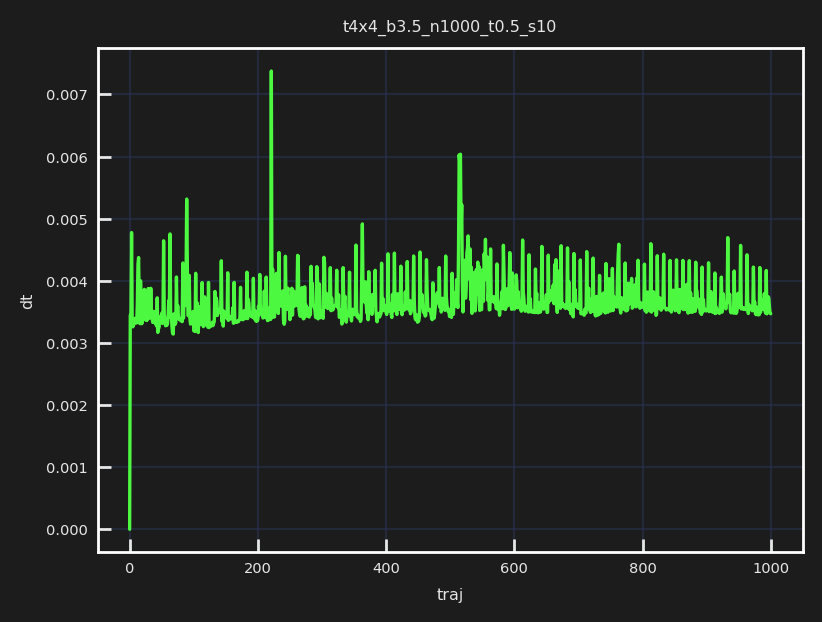

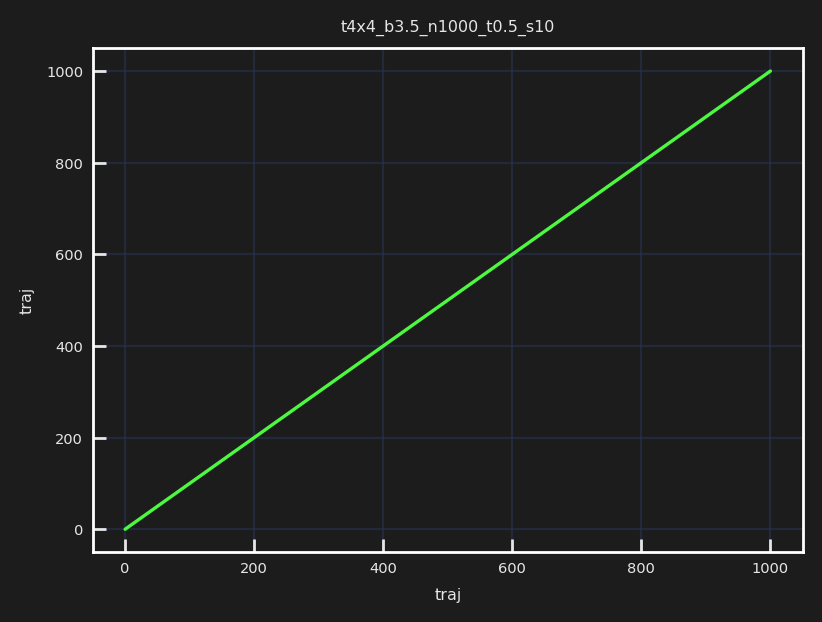

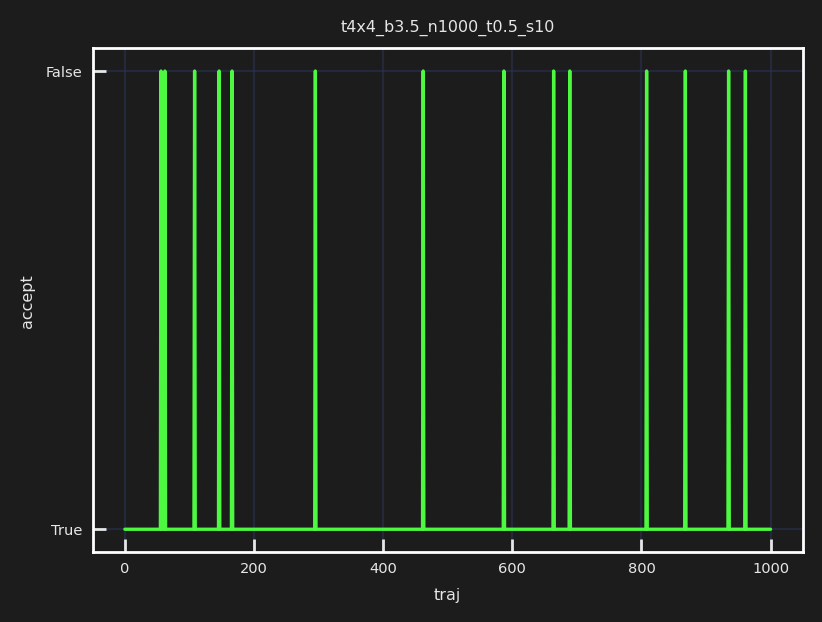

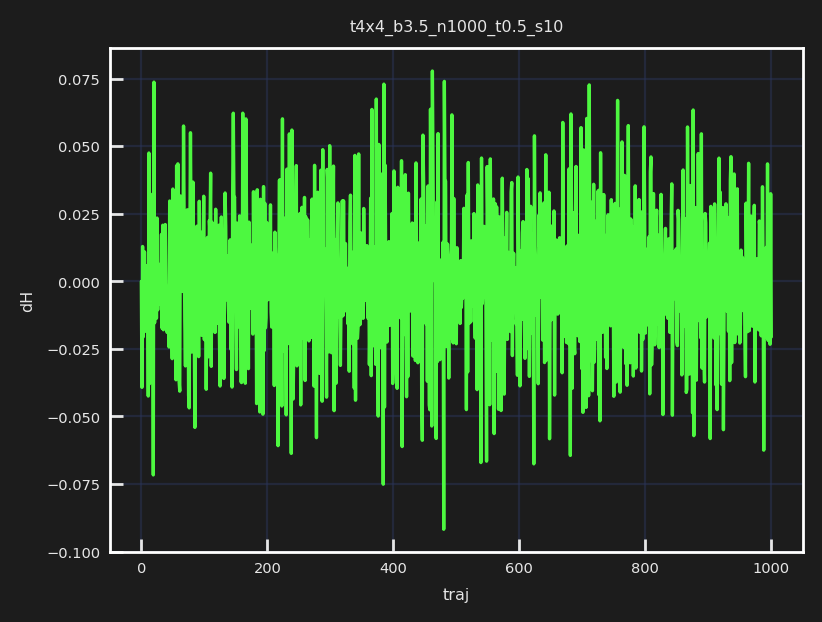

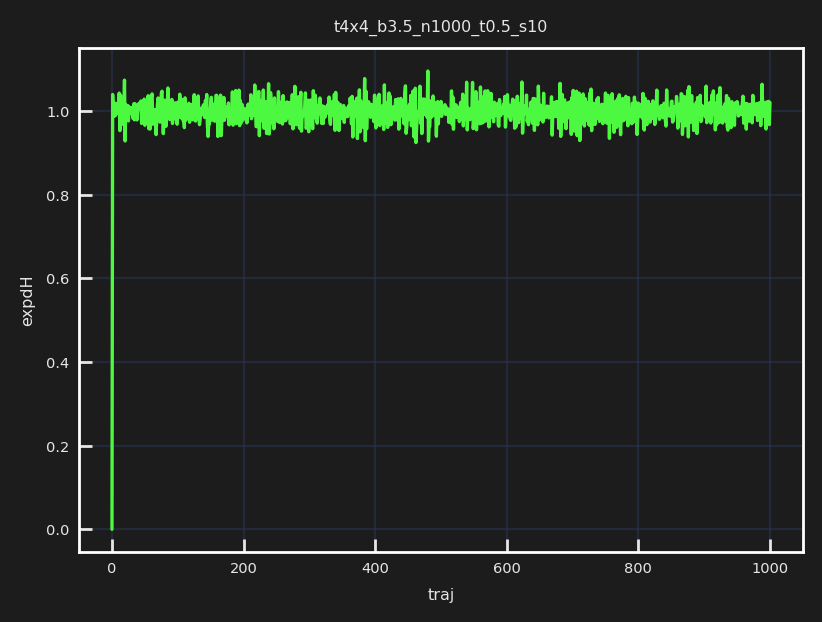

...

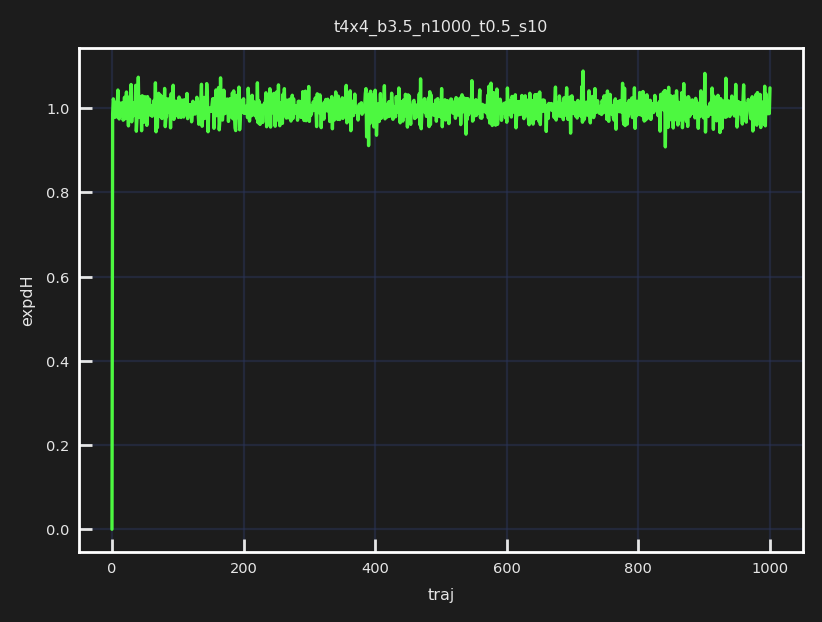

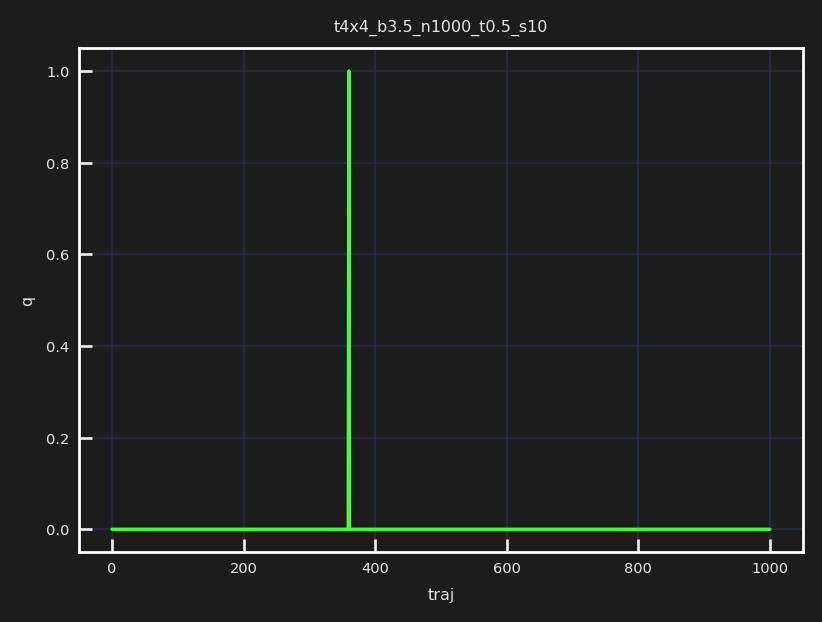

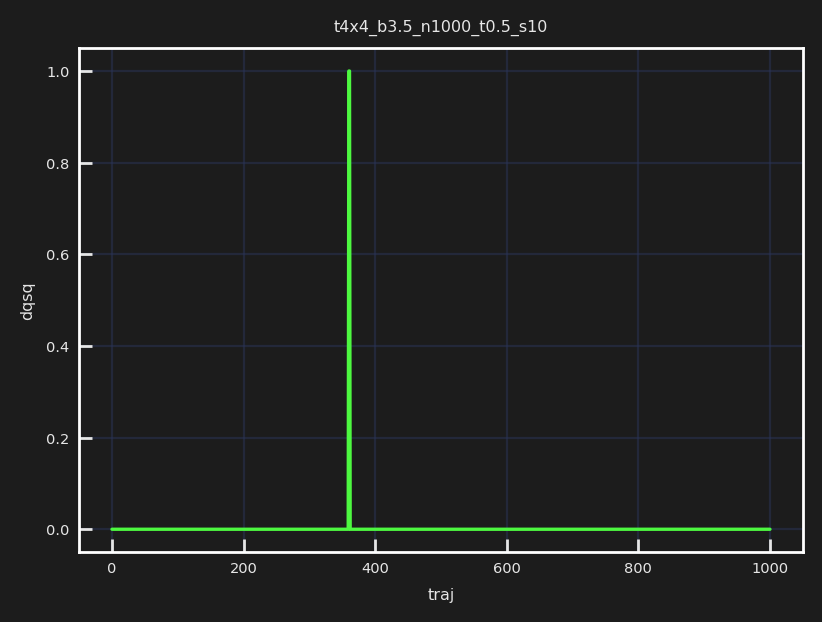

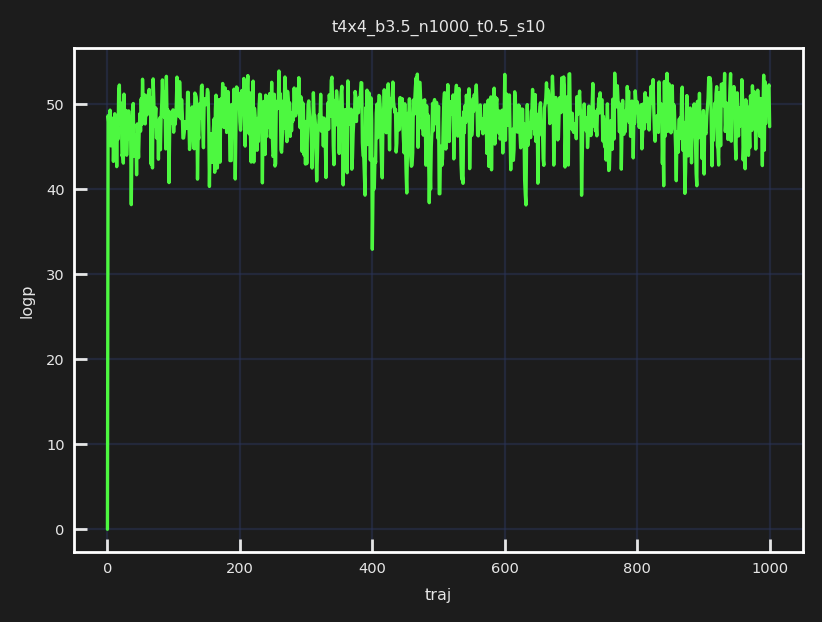

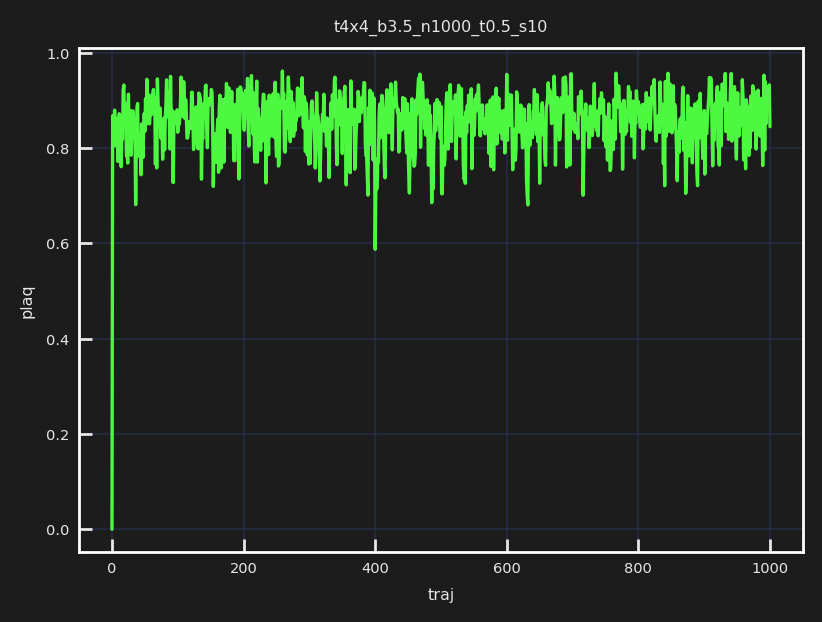

In [11]:
from fthmc.hmc import run_hmc

hmc_fields, hmc_history = run_hmc(param,
                                  keep_fields=True,
                                  save_history=True)

## Transfer to new lattice

[03:14:20]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100

[03:14:20]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training

[03:14:20]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots

[03:14:20]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints

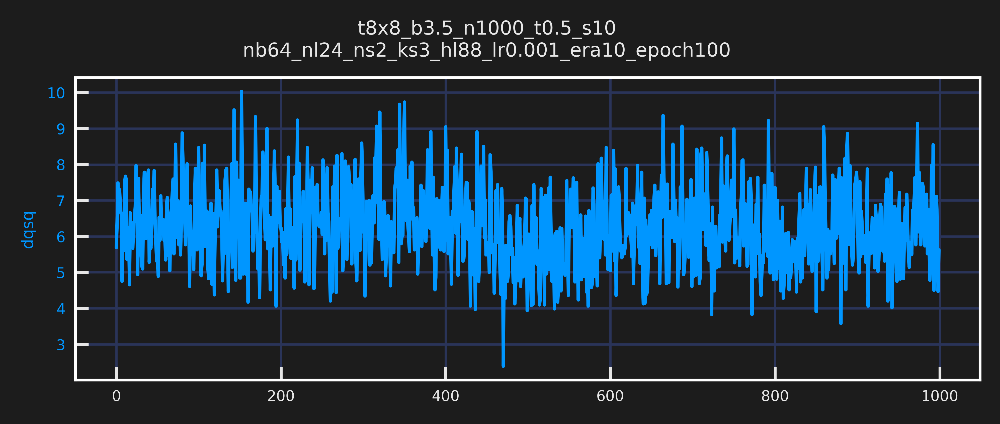

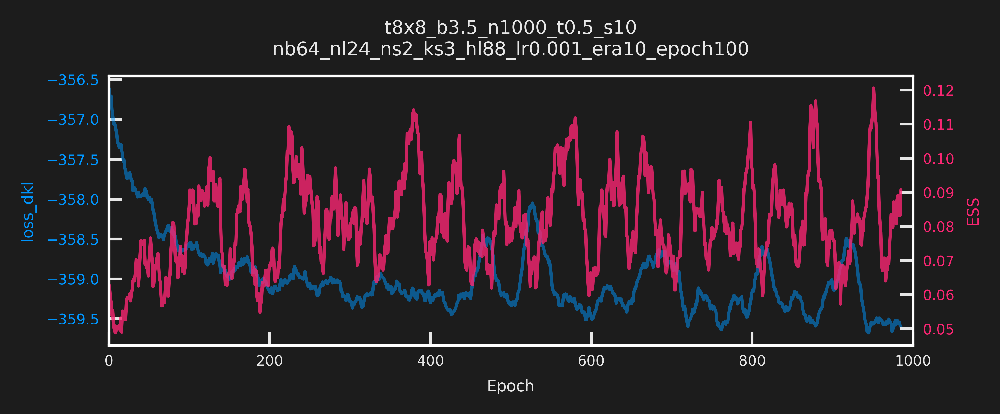

[03:14:21]  -----------------------------                                                    
            ERA=0, last took: 0 min 0 sec                                                    
            -----------------------------

[03:14:28]  epoch=19.000 step=19.000 dt=0.346 loss=-356.974 dqsq=5.816 ess=0.061 plaq=0.788  
            loss_dkl=-356.974 logp=176.589 logq=-180.385

[03:14:36]  epoch=39.000 step=39.000 dt=0.366 loss=-357.831 dqsq=6.891 ess=0.063 plaq=0.805  
            loss_dkl=-357.831 logp=180.301 logq=-177.530

[03:14:45]  epoch=59.000 step=59.000 dt=0.377 loss=-357.694 dqsq=6.169 ess=0.047 plaq=0.804  
            loss_dkl=-357.694 logp=180.176 logq=-177.519

[03:14:54]  epoch=79.000 step=79.000 dt=0.381 loss=-358.503 dqsq=6.200 ess=0.041 plaq=0.806  
            loss_dkl=-358.503 logp=180.494 logq=-178.009

[03:15:04]  epoch=99.000 step=99.000 dt=0.415 loss=-358.690 dqsq=6.678 ess=0.033 plaq=0.807  
            loss_dkl=-358.690 logp=180.729 logq=-177.962

[03:15:05]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era0-epoc
            h100.tar

[03:15:05]  ---------------------------------                                                
            ERA=1, last took: 0 min 44.26 sec                                                
            ---------------------------------

[03:15:14]  epoch=19.000 step=119.000 dt=0.449 loss=-358.745 dqsq=5.653 ess=0.095 plaq=0.809 
            loss_dkl=-358.745 logp=181.256 logq=-177.489

[03:15:24]  epoch=39.000 step=139.000 dt=0.418 loss=-358.577 dqsq=5.766 ess=0.113 plaq=0.807 
            loss_dkl=-358.577 logp=180.780 logq=-177.797

[03:15:35]  epoch=59.000 step=159.000 dt=0.462 loss=-358.921 dqsq=5.956 ess=0.054 plaq=0.809 
            loss_dkl=-358.921 logp=181.278 logq=-177.644

[03:15:46]  epoch=79.000 step=179.000 dt=0.515 loss=-358.662 dqsq=7.306 ess=0.093 plaq=0.809 
            loss_dkl=-358.662 logp=181.127 logq=-177.535

[03:15:58]  epoch=99.000 step=199.000 dt=0.526 loss=-358.900 dqsq=6.791 ess=0.070 plaq=0.808 
            loss_dkl=-358.900 logp=180.882 logq=-178.018

[03:16:00]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era1-epoc
            h100.tar

[03:16:00]  ---------------------------------                                                
            ERA=2, last took: 0 min 54.66 sec                                                
            ---------------------------------

[03:16:11]  epoch=19.000 step=219.000 dt=0.537 loss=-359.041 dqsq=6.094 ess=0.059 plaq=0.816 
            loss_dkl=-359.041 logp=182.716 logq=-176.326

[03:16:24]  epoch=39.000 step=239.000 dt=0.584 loss=-358.835 dqsq=7.138 ess=0.096 plaq=0.813 
            loss_dkl=-358.835 logp=182.105 logq=-176.730

[03:16:37]  epoch=59.000 step=259.000 dt=0.549 loss=-358.796 dqsq=6.400 ess=0.047 plaq=0.808 
            loss_dkl=-358.796 logp=180.903 logq=-177.893

[03:16:50]  epoch=79.000 step=279.000 dt=0.523 loss=-359.001 dqsq=6.294 ess=0.062 plaq=0.810 
            loss_dkl=-359.001 logp=181.385 logq=-177.616

[03:17:02]  epoch=99.000 step=299.000 dt=0.547 loss=-359.093 dqsq=7.147 ess=0.082 plaq=0.815 
            loss_dkl=-359.093 logp=182.526 logq=-176.566

[03:17:04]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era2-epoc
            h100.tar

[03:17:04]  ---------------------------------                                                
            ERA=3, last took: 1 min 4.324 sec                                                
            ---------------------------------

[03:17:15]  epoch=19.000 step=319.000 dt=0.529 loss=-359.540 dqsq=7.278 ess=0.105 plaq=0.812 
            loss_dkl=-359.540 logp=181.797 logq=-177.743

[03:17:28]  epoch=39.000 step=339.000 dt=0.612 loss=-358.934 dqsq=6.519 ess=0.082 plaq=0.812 
            loss_dkl=-358.934 logp=181.913 logq=-177.021

[03:17:40]  epoch=59.000 step=359.000 dt=0.537 loss=-359.355 dqsq=6.812 ess=0.066 plaq=0.812 
            loss_dkl=-359.355 logp=181.999 logq=-177.356

[03:17:52]  epoch=79.000 step=379.000 dt=0.507 loss=-359.269 dqsq=6.734 ess=0.103 plaq=0.809 
            loss_dkl=-359.269 logp=181.300 logq=-177.970

[03:18:05]  epoch=99.000 step=399.000 dt=0.536 loss=-359.021 dqsq=6.463 ess=0.097 plaq=0.809 
            loss_dkl=-359.021 logp=181.139 logq=-177.882

[03:18:07]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era3-epoc
            h100.tar

[03:18:07]  ---------------------------------                                                
            ERA=4, last took: 1 min 2.499 sec                                                
            ---------------------------------

[03:18:18]  epoch=19.000 step=419.000 dt=0.574 loss=-359.060 dqsq=6.650 ess=0.084 plaq=0.813 
            loss_dkl=-359.060 logp=182.211 logq=-176.848

[03:18:30]  epoch=39.000 step=439.000 dt=0.543 loss=-359.338 dqsq=6.056 ess=0.104 plaq=0.807 
            loss_dkl=-359.338 logp=180.785 logq=-178.553

[03:18:43]  epoch=59.000 step=459.000 dt=0.507 loss=-359.252 dqsq=5.850 ess=0.051 plaq=0.812 
            loss_dkl=-359.252 logp=181.791 logq=-177.461

[03:18:55]  epoch=79.000 step=479.000 dt=0.501 loss=-358.156 dqsq=5.791 ess=0.091 plaq=0.812 
            loss_dkl=-358.156 logp=181.781 logq=-176.375

[03:19:07]  epoch=99.000 step=499.000 dt=0.505 loss=-359.057 dqsq=5.941 ess=0.073 plaq=0.807 
            loss_dkl=-359.057 logp=180.820 logq=-178.237

[03:19:09]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era4-epoc
            h100.tar

[03:19:09]  ---------------------------------                                                
            ERA=5, last took: 1 min 2.138 sec                                                
            ---------------------------------

[03:19:19]  epoch=19.000 step=519.000 dt=0.467 loss=-359.126 dqsq=6.222 ess=0.094 plaq=0.805 
            loss_dkl=-359.126 logp=180.397 logq=-178.729

[03:19:30]  epoch=39.000 step=539.000 dt=0.464 loss=-357.987 dqsq=5.206 ess=0.067 plaq=0.810 
            loss_dkl=-357.987 logp=181.390 logq=-176.597

[03:19:41]  epoch=59.000 step=559.000 dt=0.433 loss=-358.882 dqsq=6.447 ess=0.087 plaq=0.808 
            loss_dkl=-358.882 logp=180.936 logq=-177.946

[03:19:51]  epoch=79.000 step=579.000 dt=0.428 loss=-359.164 dqsq=5.622 ess=0.090 plaq=0.809 
            loss_dkl=-359.164 logp=181.217 logq=-177.947

[03:20:01]  epoch=99.000 step=599.000 dt=0.456 loss=-359.260 dqsq=6.175 ess=0.075 plaq=0.812 
            loss_dkl=-359.260 logp=181.989 logq=-177.271

[03:20:03]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era5-epoc
            h100.tar

[03:20:03]  ---------------------------------                                                
            ERA=6, last took: 0 min 54.05 sec                                                
            ---------------------------------

[03:20:12]  epoch=19.000 step=619.000 dt=0.447 loss=-359.368 dqsq=6.084 ess=0.083 plaq=0.819 
            loss_dkl=-359.368 logp=183.438 logq=-175.929

[03:20:23]  epoch=39.000 step=639.000 dt=0.448 loss=-359.162 dqsq=6.328 ess=0.083 plaq=0.813 
            loss_dkl=-359.162 logp=182.157 logq=-177.005

[03:20:33]  epoch=59.000 step=659.000 dt=0.434 loss=-359.429 dqsq=6.316 ess=0.038 plaq=0.820 
            loss_dkl=-359.429 logp=183.772 logq=-175.657

[03:20:44]  epoch=79.000 step=679.000 dt=0.488 loss=-358.666 dqsq=6.906 ess=0.118 plaq=0.824 
            loss_dkl=-358.666 logp=184.664 logq=-174.001

[03:20:55]  epoch=99.000 step=699.000 dt=0.495 loss=-358.566 dqsq=6.188 ess=0.073 plaq=0.818 
            loss_dkl=-358.566 logp=183.200 logq=-175.365

[03:20:57]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era6-epoc
            h100.tar

[03:20:57]  ---------------------------------                                                
            ERA=7, last took: 0 min 53.66 sec                                                
            ---------------------------------

[03:21:06]  epoch=19.000 step=719.000 dt=0.472 loss=-359.086 dqsq=6.884 ess=0.070 plaq=0.816 
            loss_dkl=-359.086 logp=182.773 logq=-176.313

[03:21:18]  epoch=39.000 step=739.000 dt=0.464 loss=-359.038 dqsq=6.978 ess=0.092 plaq=0.806 
            loss_dkl=-359.038 logp=180.543 logq=-178.495

[03:21:28]  epoch=59.000 step=759.000 dt=0.480 loss=-359.240 dqsq=6.128 ess=0.057 plaq=0.808 
            loss_dkl=-359.240 logp=181.030 logq=-178.210

[03:21:40]  epoch=79.000 step=779.000 dt=0.517 loss=-359.230 dqsq=6.416 ess=0.072 plaq=0.812 
            loss_dkl=-359.230 logp=181.928 logq=-177.302

[03:21:52]  epoch=99.000 step=799.000 dt=0.508 loss=-359.520 dqsq=6.106 ess=0.073 plaq=0.817 
            loss_dkl=-359.520 logp=183.032 logq=-176.488

[03:21:53]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era7-epoc
            h100.tar

[03:21:53]  ---------------------------------                                                
            ERA=8, last took: 0 min 56.44 sec                                                
            ---------------------------------

[03:22:04]  epoch=19.000 step=819.000 dt=0.535 loss=-358.935 dqsq=5.078 ess=0.057 plaq=0.813 
            loss_dkl=-358.935 logp=182.183 logq=-176.752

[03:22:16]  epoch=39.000 step=839.000 dt=0.523 loss=-359.378 dqsq=6.566 ess=0.131 plaq=0.816 
            loss_dkl=-359.378 logp=182.782 logq=-176.596

[03:22:28]  epoch=59.000 step=859.000 dt=0.543 loss=-359.264 dqsq=6.491 ess=0.047 plaq=0.815 
            loss_dkl=-359.264 logp=182.506 logq=-176.757

[03:22:41]  epoch=79.000 step=879.000 dt=0.514 loss=-359.452 dqsq=7.147 ess=0.080 plaq=0.809 
            loss_dkl=-359.452 logp=181.306 logq=-178.146

[03:22:53]  epoch=99.000 step=899.000 dt=0.536 loss=-359.022 dqsq=6.987 ess=0.080 plaq=0.808 
            loss_dkl=-359.022 logp=181.033 logq=-177.989

[03:22:55]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era8-epoc
            h100.tar

[03:22:55]  ---------------------------------                                                
            ERA=9, last took: 1 min 1.174 sec                                                
            ---------------------------------

[03:23:06]  epoch=19.000 step=919.000 dt=0.536 loss=-358.960 dqsq=6.116 ess=0.046 plaq=0.813 
            loss_dkl=-358.960 logp=182.207 logq=-176.753

[03:23:18]  epoch=39.000 step=939.000 dt=0.510 loss=-358.501 dqsq=6.553 ess=0.090 plaq=0.812 
            loss_dkl=-358.501 logp=181.832 logq=-176.669

[03:23:30]  epoch=59.000 step=959.000 dt=0.510 loss=-359.556 dqsq=5.991 ess=0.127 plaq=0.815 
            loss_dkl=-359.556 logp=182.569 logq=-176.986

[03:23:42]  epoch=79.000 step=979.000 dt=0.516 loss=-359.633 dqsq=6.897 ess=0.074 plaq=0.812 
            loss_dkl=-359.633 logp=181.934 logq=-177.699

[03:23:55]  epoch=99.000 step=999.000 dt=0.524 loss=-359.524 dqsq=6.022 ess=0.091 plaq=0.822 
            loss_dkl=-359.524 logp=184.167 logq=-175.356

[03:23:57]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era9-epoc
            h100.tar

            Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era9-epoc
            h100.tar

[03:23:57]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/dqsq_live.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/dkl_live.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/dt.pdf

[03:23:58]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/loss.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/dqsq.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/ess.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/plaq.pdf

[03:23:59]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/loss_dkl.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/logp.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/logq.pdf

[03:23:59]  Saving train_history to /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/train_history.z.

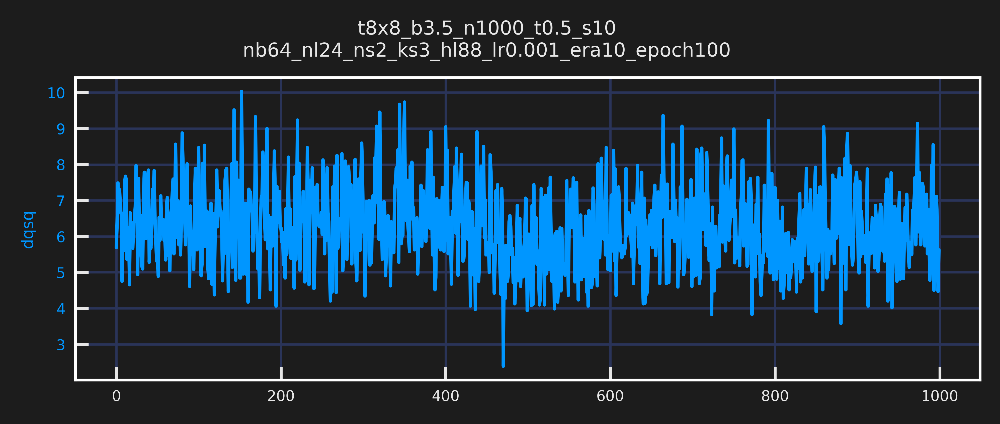

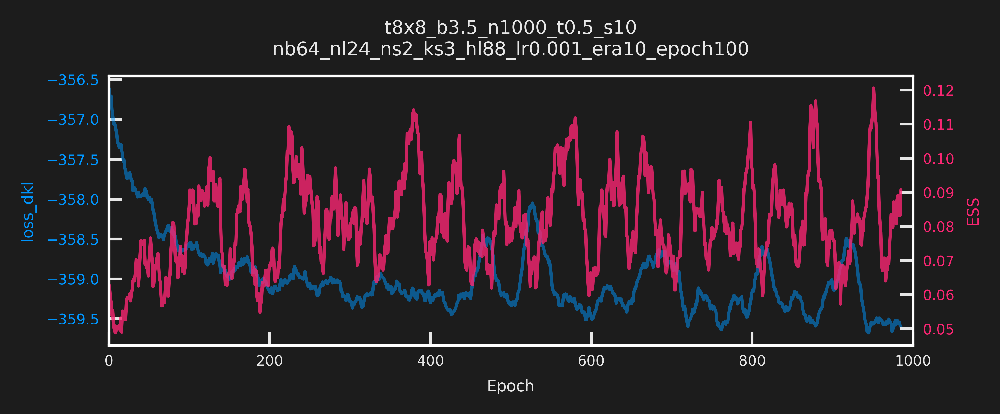

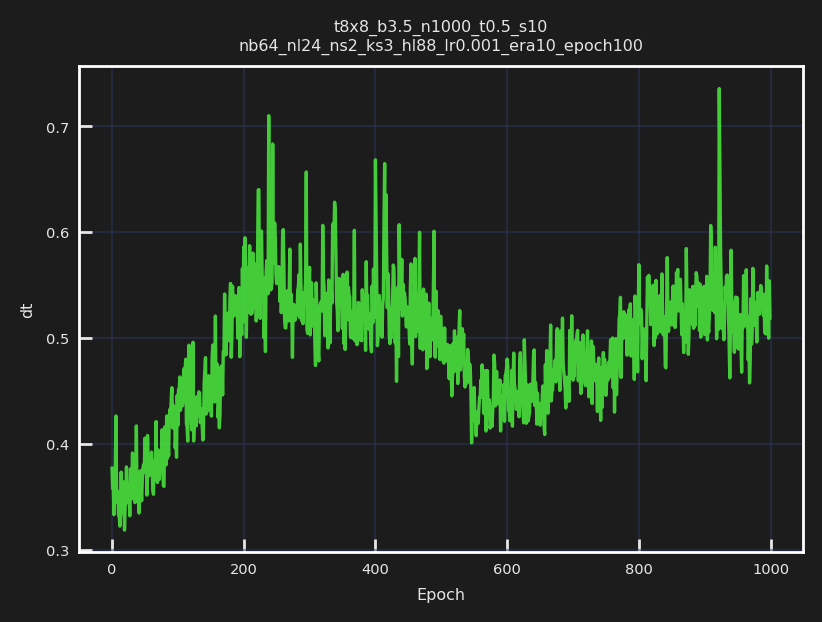

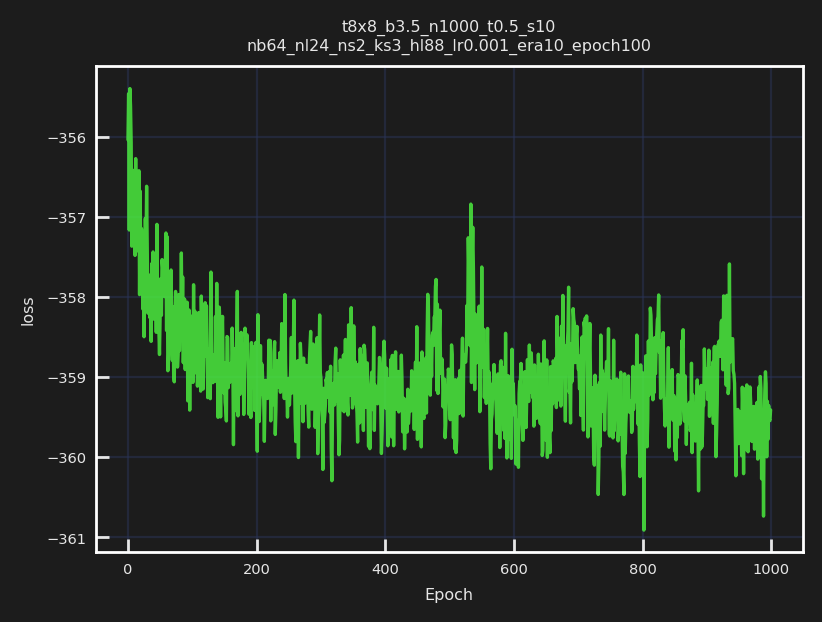

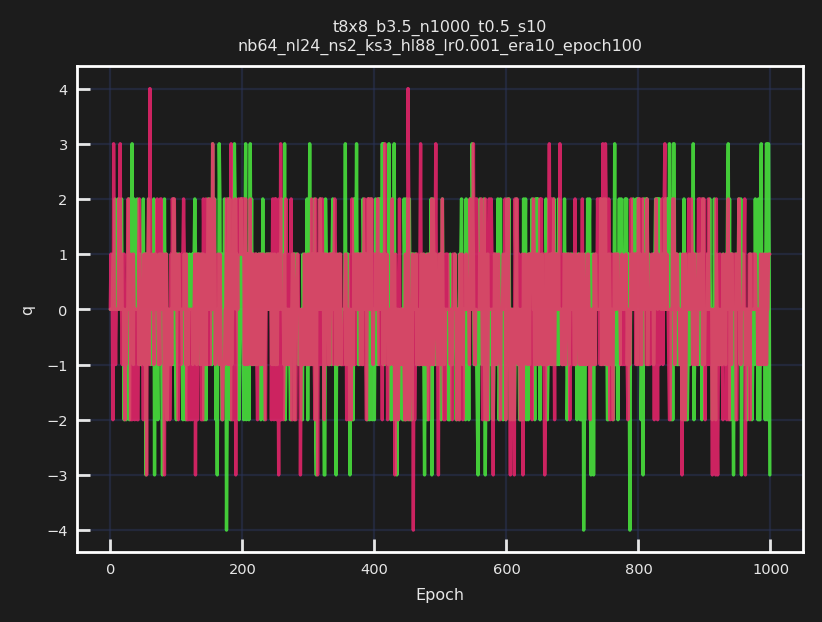

...

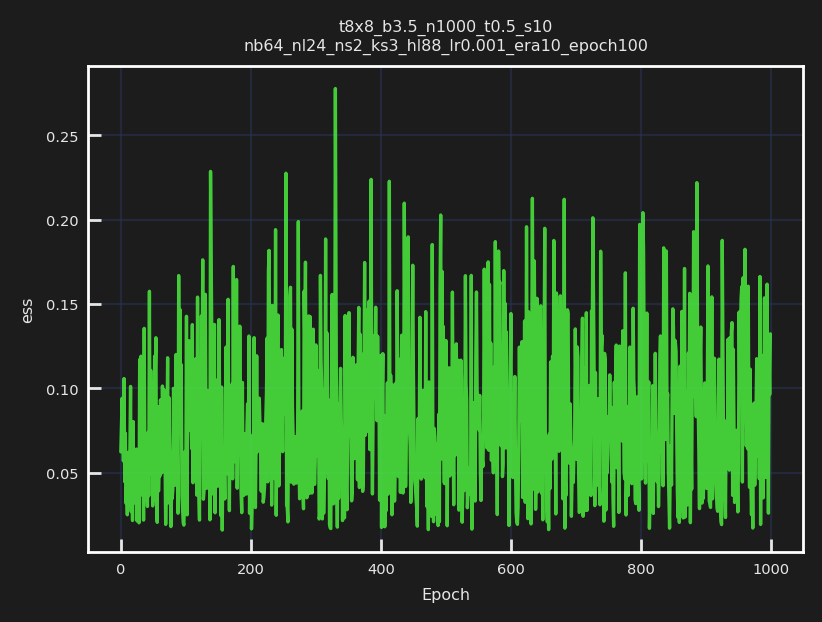

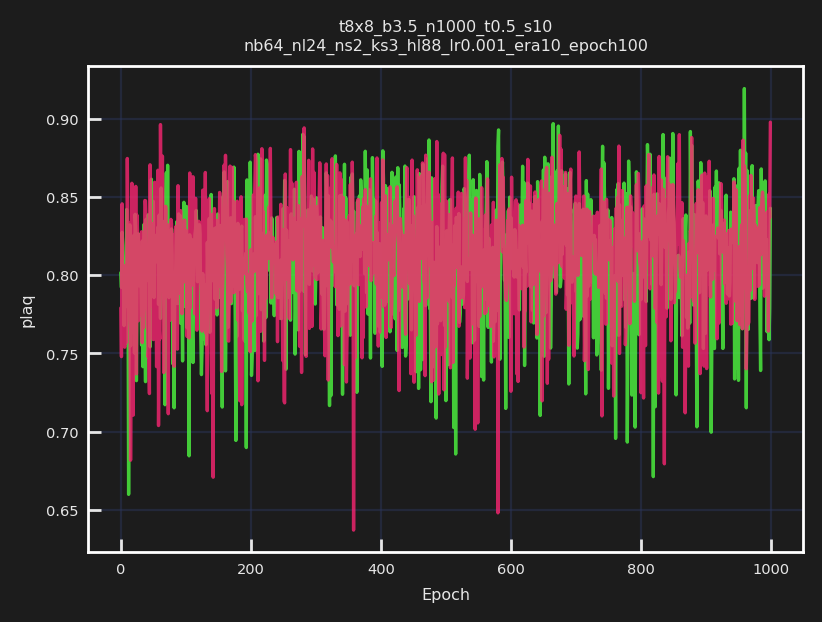

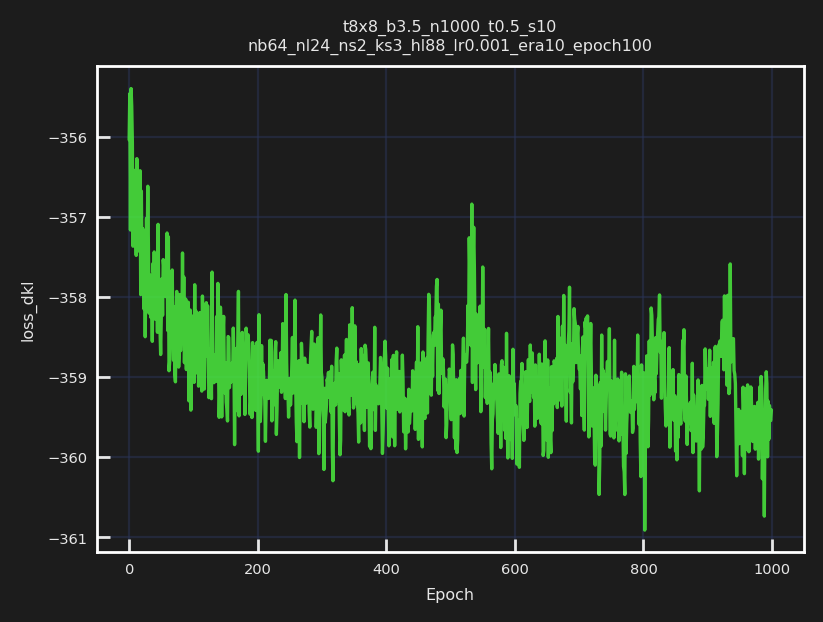

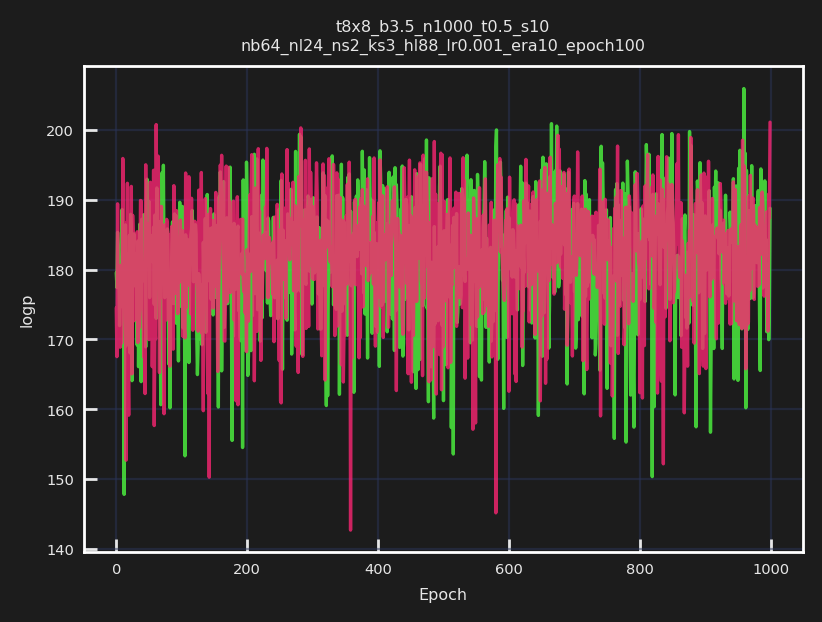

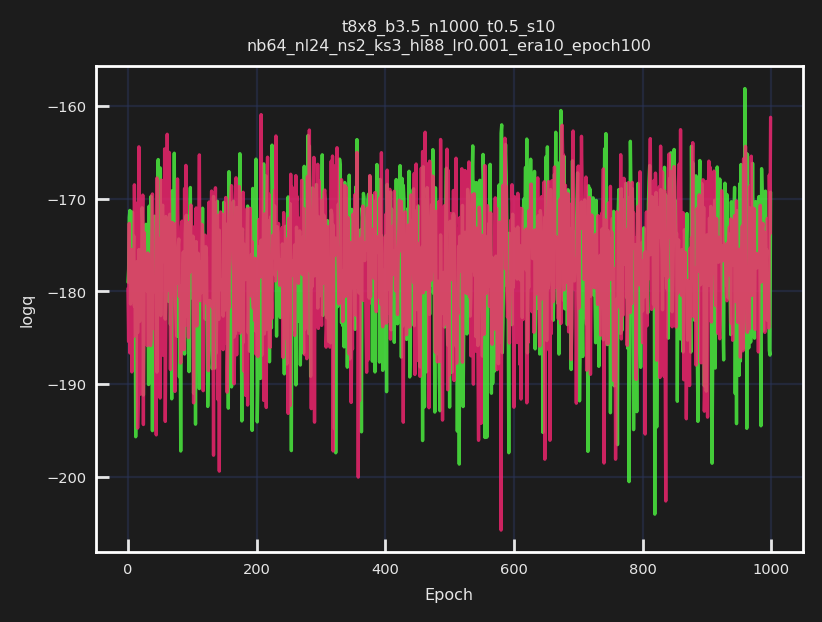

In [12]:
from dataclasses import asdict
from fthmc.train import train, transfer_to_new_lattice
%matplotlib inline

plt.style.use('default')
plt.style.use('/Users/saforem2/.matplotlib/stylelib/molokai.mplstyle')
sns.set_context('paper', font_scale=0.6)

layers = train_outputs['model']['layers']


xfr = transfer_to_new_lattice(L=8,
                              layers=layers,
                              param_init=param)
param8 = xfr['param']
model8 = xfr['model']

cfg_dict = asdict(train_config)
cfg_dict['base_lr'] = 0.001
train_config8 = TrainConfig(**cfg_dict)

train_outputs8 = train(param8,
                       train_config8,
                       model=model8,
                       pre_model=None,
                       figsize=(5, 2))

### Run inference on transferred model

/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:138: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.array(val)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.array(val)


[07:35:42]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots

[07:35:42]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/ess.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/dqsq.pdf

[07:35:43]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/dkl.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/logq.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/logp.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t8x8_b3.5_n1000_t0.5_s10/nb64
            _nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/accepted.pdf

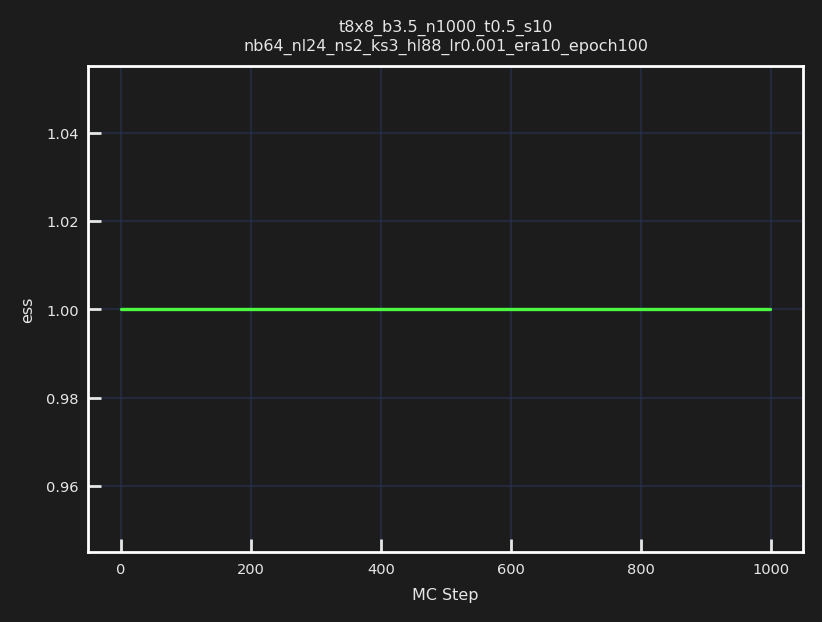

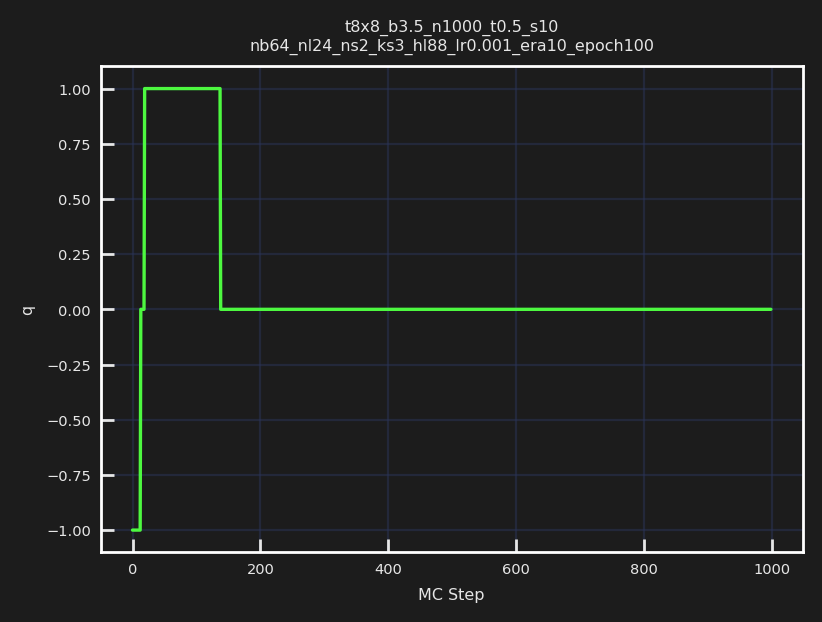

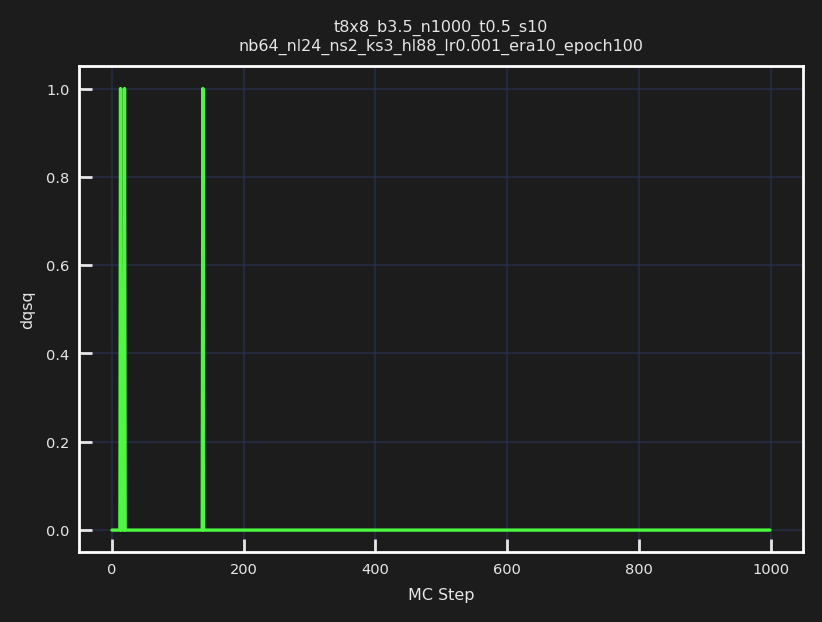

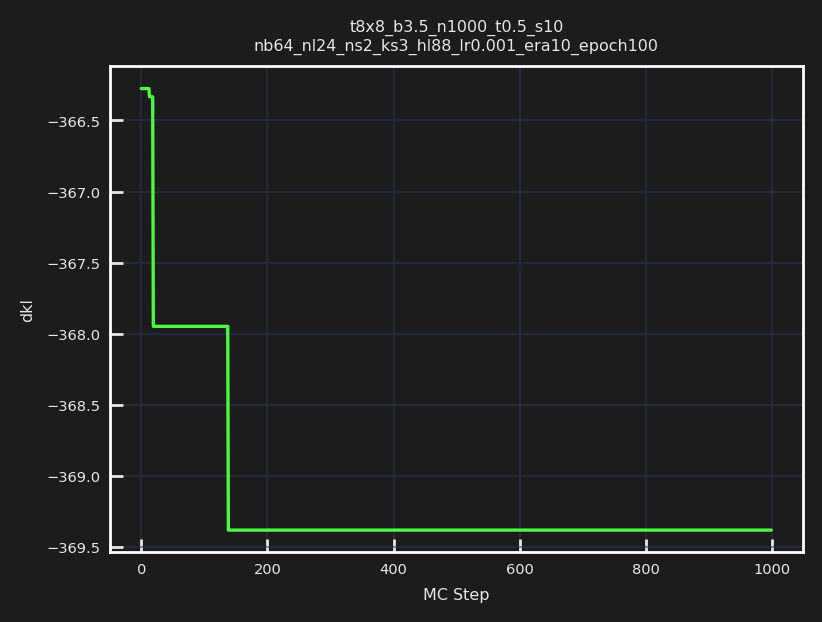

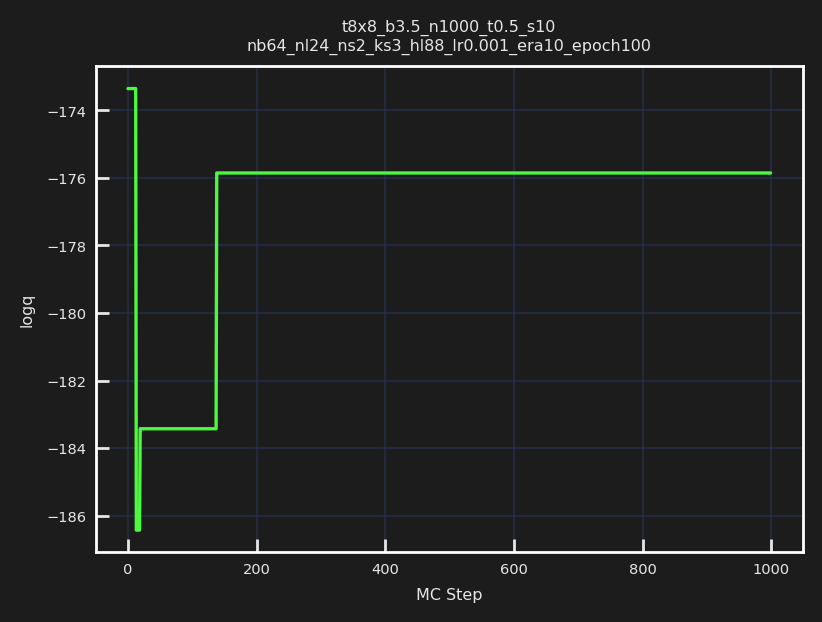

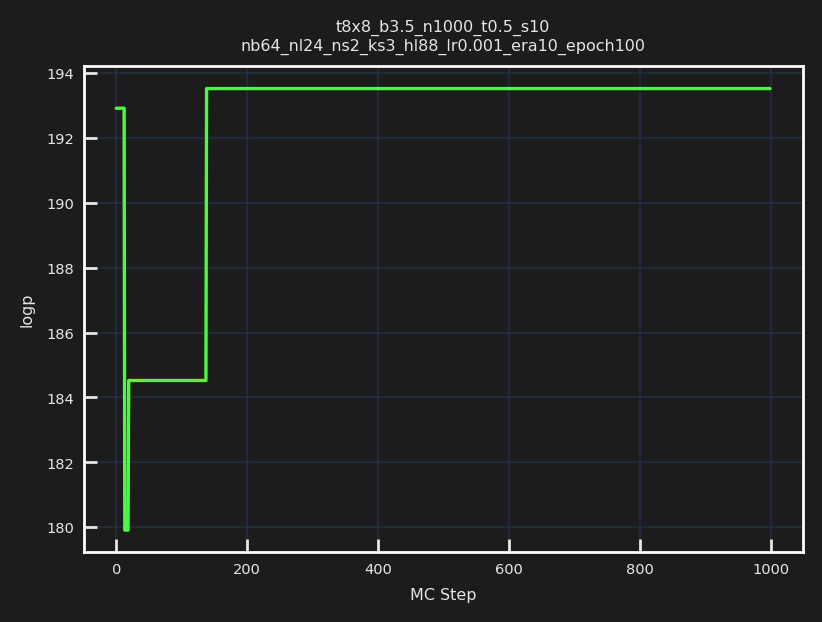

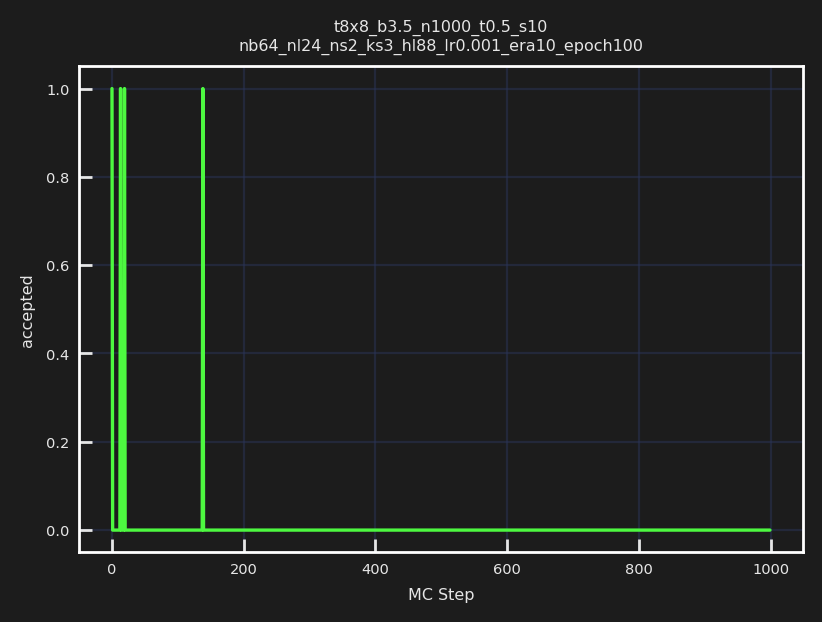

In [13]:

import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history
from fthmc.utils.samplers import make_mcmc_ensemble

action_fn8 = qed.BatchAction(param8.beta)
dirs8 = train_outputs8['dirs']
logdir8 = dirs8['logdir']

inf_dir8 = os.path.join(logdir8, 'inference')
inf_pdir8 = os.path.join(inf_dir8, 'plots')

history8 = make_mcmc_ensemble(model=train_outputs8['model'],
                              action_fn=action_fn8,
                              batch_size=train_config8.batch_size,
                              num_samples=1000)

plot_history(history=history8,
             param=param8,
             config=train_config8,
             skip=['epoch', 'x'],
             num_chains=4,
             therm_frac=0.0,
             xlabel='MC Step',
             outdir=inf_pdir8)

[07:36:11]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/plots

[07:36:12]  Param:                                                                           
            ----------------                                                                 
            beta=3.5                                                                         
            L=8                                                                              
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=1000                                                                       
            nrun=2                                                                           
            nprint=100                                                                       
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[8, 8]                                                                       
            nd=2                                                                             
            shape=[2, 8, 8]                                                                  
            volume=64                                                                        
            dt=0.05

            action=1.000 plaq=0.000 charge=0.000

            dt=0.003 traj=2 accept=True dH=-0.054 expdH=1.056 q=0 dqsq=0 logp=193.235        
            plaq=0.863

            dt=0.003 traj=12 accept=True dH=-0.114 expdH=1.121 q=0 dqsq=0 logp=181.262       
            plaq=0.809

            dt=0.003 traj=22 accept=True dH=0.017 expdH=0.983 q=0 dqsq=0 logp=194.608        
            plaq=0.869

            dt=0.003 traj=32 accept=True dH=0.047 expdH=0.954 q=0 dqsq=1 logp=192.839        
            plaq=0.861

            dt=0.004 traj=42 accept=True dH=0.064 expdH=0.938 q=0 dqsq=0 logp=183.589        
            plaq=0.820

            dt=0.003 traj=52 accept=True dH=0.088 expdH=0.916 q=0 dqsq=0 logp=188.957        
            plaq=0.844

            dt=0.003 traj=62 accept=True dH=0.078 expdH=0.925 q=0 dqsq=0 logp=188.727        
            plaq=0.843

            dt=0.003 traj=72 accept=True dH=-0.097 expdH=1.102 q=0 dqsq=0 logp=187.274       
            plaq=0.836

            dt=0.003 traj=82 accept=True dH=-0.059 expdH=1.061 q=0 dqsq=0 logp=180.512       
            plaq=0.806

            dt=0.003 traj=92 accept=True dH=0.027 expdH=0.973 q=0 dqsq=0 logp=197.321        
            plaq=0.881

            dt=0.003 traj=102 accept=True dH=-0.024 expdH=1.024 q=0 dqsq=0 logp=190.813      
            plaq=0.852

            dt=0.003 traj=112 accept=True dH=-0.069 expdH=1.071 q=0 dqsq=0 logp=182.367      
            plaq=0.814

            dt=0.004 traj=122 accept=True dH=0.001 expdH=0.999 q=0 dqsq=0 logp=187.935       
            plaq=0.839

            dt=0.003 traj=132 accept=True dH=0.003 expdH=0.997 q=0 dqsq=0 logp=185.165       
            plaq=0.827

            dt=0.003 traj=142 accept=True dH=-0.032 expdH=1.032 q=0 dqsq=0 logp=193.563      
            plaq=0.864

            dt=0.004 traj=152 accept=True dH=0.003 expdH=0.997 q=0 dqsq=0 logp=189.684       
            plaq=0.847

            dt=0.004 traj=162 accept=True dH=-0.046 expdH=1.047 q=0 dqsq=0 logp=177.841      
            plaq=0.794

            dt=0.003 traj=172 accept=True dH=-0.084 expdH=1.087 q=0 dqsq=0 logp=179.940      
            plaq=0.803

            dt=0.003 traj=182 accept=True dH=-0.138 expdH=1.148 q=0 dqsq=0 logp=181.729      
            plaq=0.811

            dt=0.003 traj=192 accept=True dH=0.002 expdH=0.998 q=0 dqsq=0 logp=187.362       
            plaq=0.836

            dt=0.004 traj=202 accept=True dH=0.088 expdH=0.915 q=0 dqsq=0 logp=188.768       
            plaq=0.843

[07:36:13]  dt=0.004 traj=212 accept=True dH=-0.068 expdH=1.071 q=1 dqsq=0 logp=186.652      
            plaq=0.833

            dt=0.003 traj=222 accept=True dH=-0.022 expdH=1.022 q=0 dqsq=1 logp=186.979      
            plaq=0.835

            dt=0.003 traj=232 accept=True dH=-0.103 expdH=1.108 q=0 dqsq=0 logp=181.583      
            plaq=0.811

            dt=0.004 traj=242 accept=True dH=0.011 expdH=0.989 q=0 dqsq=1 logp=192.363       
            plaq=0.859

            dt=0.003 traj=252 accept=True dH=-0.054 expdH=1.055 q=1 dqsq=1 logp=185.858      
            plaq=0.830

            dt=0.003 traj=262 accept=True dH=-0.057 expdH=1.059 q=0 dqsq=1 logp=188.578      
            plaq=0.842

            dt=0.003 traj=272 accept=True dH=0.060 expdH=0.942 q=1 dqsq=0 logp=179.459       
            plaq=0.801

            dt=0.003 traj=282 accept=True dH=0.025 expdH=0.975 q=0 dqsq=0 logp=187.426       
            plaq=0.837

            dt=0.004 traj=292 accept=True dH=-0.002 expdH=1.002 q=0 dqsq=0 logp=177.902      
            plaq=0.794

            dt=0.003 traj=302 accept=True dH=0.008 expdH=0.992 q=-1 dqsq=1 logp=185.872      
            plaq=0.830

            dt=0.003 traj=312 accept=True dH=0.022 expdH=0.978 q=0 dqsq=0 logp=193.147       
            plaq=0.862

            dt=0.003 traj=322 accept=True dH=-0.026 expdH=1.026 q=-1 dqsq=0 logp=187.262     
            plaq=0.836

            dt=0.004 traj=332 accept=True dH=0.066 expdH=0.936 q=-1 dqsq=1 logp=183.317      
            plaq=0.818

            dt=0.003 traj=342 accept=True dH=0.031 expdH=0.969 q=-1 dqsq=0 logp=190.158      
            plaq=0.849

            dt=0.003 traj=352 accept=False dH=0.059 expdH=0.942 q=0 dqsq=0 logp=187.221      
            plaq=0.836

            dt=0.003 traj=362 accept=True dH=-0.001 expdH=1.001 q=0 dqsq=1 logp=191.592      
            plaq=0.855

            dt=0.003 traj=372 accept=True dH=0.029 expdH=0.971 q=0 dqsq=0 logp=182.594       
            plaq=0.815

            dt=0.003 traj=382 accept=True dH=0.004 expdH=0.997 q=0 dqsq=0 logp=194.986       
            plaq=0.870

            dt=0.003 traj=392 accept=True dH=-0.028 expdH=1.028 q=0 dqsq=0 logp=187.078      
            plaq=0.835

            dt=0.003 traj=402 accept=True dH=0.032 expdH=0.968 q=0 dqsq=0 logp=191.236       
            plaq=0.854

            dt=0.003 traj=412 accept=True dH=0.030 expdH=0.970 q=0 dqsq=0 logp=194.119       
            plaq=0.867

            dt=0.003 traj=422 accept=True dH=0.032 expdH=0.968 q=0 dqsq=0 logp=185.941       
            plaq=0.830

[07:36:14]  dt=0.003 traj=432 accept=True dH=-0.053 expdH=1.055 q=0 dqsq=0 logp=193.770      
            plaq=0.865

            dt=0.003 traj=442 accept=True dH=0.041 expdH=0.960 q=0 dqsq=0 logp=193.387       
            plaq=0.863

            dt=0.003 traj=452 accept=True dH=0.078 expdH=0.925 q=0 dqsq=0 logp=203.089       
            plaq=0.907

            dt=0.003 traj=462 accept=True dH=-0.101 expdH=1.106 q=0 dqsq=0 logp=174.915      
            plaq=0.781

            dt=0.003 traj=472 accept=True dH=-0.018 expdH=1.018 q=0 dqsq=0 logp=183.417      
            plaq=0.819

            dt=0.003 traj=482 accept=True dH=0.047 expdH=0.954 q=0 dqsq=0 logp=191.003       
            plaq=0.853

            dt=0.003 traj=492 accept=True dH=0.017 expdH=0.983 q=-1 dqsq=0 logp=186.370      
            plaq=0.832

            dt=0.003 traj=502 accept=True dH=-0.014 expdH=1.014 q=-1 dqsq=0 logp=196.775     
            plaq=0.878

            dt=0.003 traj=512 accept=True dH=0.015 expdH=0.985 q=-1 dqsq=1 logp=190.391      
            plaq=0.850

            dt=0.003 traj=522 accept=True dH=-0.102 expdH=1.107 q=-1 dqsq=1 logp=182.401     
            plaq=0.814

            dt=0.002 traj=532 accept=True dH=0.102 expdH=0.903 q=0 dqsq=0 logp=183.463       
            plaq=0.819

            dt=0.003 traj=542 accept=True dH=-0.029 expdH=1.030 q=0 dqsq=0 logp=193.980      
            plaq=0.866

            dt=0.003 traj=552 accept=True dH=-0.045 expdH=1.046 q=0 dqsq=0 logp=180.525      
            plaq=0.806

            dt=0.003 traj=562 accept=True dH=-0.040 expdH=1.041 q=0 dqsq=0 logp=195.814      
            plaq=0.874

            dt=0.003 traj=572 accept=True dH=0.021 expdH=0.979 q=0 dqsq=0 logp=196.686       
            plaq=0.878

            dt=0.003 traj=582 accept=True dH=0.007 expdH=0.993 q=0 dqsq=0 logp=186.609       
            plaq=0.833

            dt=0.003 traj=592 accept=True dH=0.006 expdH=0.994 q=0 dqsq=0 logp=193.752       
            plaq=0.865

            dt=0.003 traj=602 accept=True dH=0.015 expdH=0.985 q=0 dqsq=0 logp=183.792       
            plaq=0.820

            dt=0.003 traj=612 accept=True dH=0.024 expdH=0.976 q=-1 dqsq=0 logp=184.333      
            plaq=0.823

            dt=0.003 traj=622 accept=True dH=0.088 expdH=0.916 q=0 dqsq=0 logp=189.398       
            plaq=0.846

            dt=0.003 traj=632 accept=True dH=0.017 expdH=0.983 q=0 dqsq=0 logp=196.613       
            plaq=0.878

            dt=0.003 traj=642 accept=True dH=0.028 expdH=0.972 q=0 dqsq=0 logp=179.214       
            plaq=0.800

            dt=0.003 traj=652 accept=True dH=-0.027 expdH=1.028 q=0 dqsq=0 logp=186.468      
            plaq=0.832

            dt=0.003 traj=662 accept=True dH=0.037 expdH=0.963 q=0 dqsq=1 logp=196.555       
            plaq=0.877

[07:36:15]  dt=0.003 traj=672 accept=True dH=-0.024 expdH=1.024 q=1 dqsq=0 logp=185.617      
            plaq=0.829

            dt=0.003 traj=682 accept=True dH=-0.031 expdH=1.032 q=0 dqsq=0 logp=183.425      
            plaq=0.819

            dt=0.003 traj=692 accept=True dH=0.014 expdH=0.986 q=1 dqsq=0 logp=195.552       
            plaq=0.873

            dt=0.003 traj=702 accept=True dH=0.012 expdH=0.988 q=0 dqsq=0 logp=188.644       
            plaq=0.842

            dt=0.003 traj=712 accept=True dH=-0.043 expdH=1.044 q=2 dqsq=0 logp=183.328      
            plaq=0.818

            dt=0.003 traj=722 accept=True dH=-0.070 expdH=1.073 q=2 dqsq=0 logp=181.617      
            plaq=0.811

            dt=0.003 traj=732 accept=True dH=-0.045 expdH=1.046 q=2 dqsq=0 logp=178.456      
            plaq=0.797

            dt=0.003 traj=742 accept=True dH=-0.024 expdH=1.024 q=2 dqsq=0 logp=182.353      
            plaq=0.814

            dt=0.003 traj=752 accept=True dH=-0.021 expdH=1.021 q=1 dqsq=0 logp=189.220      
            plaq=0.845

            dt=0.004 traj=762 accept=True dH=-0.013 expdH=1.014 q=1 dqsq=1 logp=192.255      
            plaq=0.858

            dt=0.004 traj=772 accept=True dH=-0.002 expdH=1.002 q=0 dqsq=0 logp=188.825      
            plaq=0.843

            dt=0.003 traj=782 accept=True dH=-0.032 expdH=1.032 q=0 dqsq=0 logp=186.301      
            plaq=0.832

            dt=0.003 traj=792 accept=True dH=0.003 expdH=0.997 q=-1 dqsq=1 logp=188.803      
            plaq=0.843

            dt=0.003 traj=802 accept=True dH=-0.048 expdH=1.049 q=0 dqsq=0 logp=192.573      
            plaq=0.860

            dt=0.003 traj=812 accept=True dH=0.017 expdH=0.984 q=0 dqsq=0 logp=188.840       
            plaq=0.843

            dt=0.003 traj=822 accept=True dH=-0.018 expdH=1.018 q=1 dqsq=0 logp=184.859      
            plaq=0.825

            dt=0.003 traj=832 accept=True dH=0.034 expdH=0.967 q=1 dqsq=0 logp=188.250       
            plaq=0.840

            dt=0.003 traj=842 accept=True dH=-0.072 expdH=1.075 q=1 dqsq=0 logp=181.151      
            plaq=0.809

            dt=0.003 traj=852 accept=True dH=-0.041 expdH=1.042 q=1 dqsq=0 logp=174.527      
            plaq=0.779

            dt=0.003 traj=862 accept=True dH=0.071 expdH=0.932 q=1 dqsq=1 logp=199.864       
            plaq=0.892

            dt=0.003 traj=872 accept=True dH=-0.030 expdH=1.030 q=1 dqsq=0 logp=191.908      
            plaq=0.857

            dt=0.005 traj=882 accept=True dH=0.033 expdH=0.968 q=0 dqsq=0 logp=190.052       
            plaq=0.848

            dt=0.003 traj=892 accept=True dH=0.018 expdH=0.982 q=0 dqsq=0 logp=188.279       
            plaq=0.841

            dt=0.003 traj=902 accept=True dH=-0.114 expdH=1.121 q=0 dqsq=0 logp=173.292      
            plaq=0.774

[07:36:16]  dt=0.003 traj=912 accept=True dH=-0.015 expdH=1.015 q=0 dqsq=0 logp=183.608      
            plaq=0.820

            dt=0.003 traj=922 accept=True dH=-0.013 expdH=1.013 q=0 dqsq=0 logp=187.920      
            plaq=0.839

            dt=0.003 traj=932 accept=True dH=0.051 expdH=0.950 q=0 dqsq=0 logp=195.109       
            plaq=0.871

            dt=0.003 traj=942 accept=True dH=0.038 expdH=0.963 q=0 dqsq=0 logp=195.781       
            plaq=0.874

            dt=0.003 traj=952 accept=True dH=-0.101 expdH=1.106 q=0 dqsq=0 logp=179.871      
            plaq=0.803

            dt=0.003 traj=962 accept=True dH=-0.055 expdH=1.057 q=0 dqsq=0 logp=194.307      
            plaq=0.867

            dt=0.003 traj=972 accept=True dH=0.007 expdH=0.993 q=0 dqsq=0 logp=191.740       
            plaq=0.856

            dt=0.003 traj=982 accept=True dH=-0.044 expdH=1.045 q=0 dqsq=0 logp=189.973      
            plaq=0.848

            dt=0.003 traj=992 accept=True dH=0.046 expdH=0.955 q=0 dqsq=0 logp=197.397       
            plaq=0.881

[07:36:16]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/plots/run0

[07:36:16]  Saving figure to:                                                                
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/plots/run0/dt.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run0/traj.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run0/accept.pdf

            Saving figure to:                                                                
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/plots/run0/dH.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run0/expdH.pdf

[07:36:17]  Saving figure to:                                                                
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/plots/run0/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run0/dqsq.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run0/logp.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run0/plaq.pdf

[07:36:17]  dt=0.003 traj=1002 accept=True dH=-0.027 expdH=1.027 q=0 dqsq=0 logp=180.194     
            plaq=0.804

            dt=0.003 traj=1012 accept=True dH=-0.016 expdH=1.016 q=0 dqsq=0 logp=185.877     
            plaq=0.830

            dt=0.003 traj=1022 accept=True dH=-0.040 expdH=1.040 q=0 dqsq=0 logp=191.951     
            plaq=0.857

            dt=0.004 traj=1032 accept=True dH=-0.029 expdH=1.030 q=0 dqsq=0 logp=192.416     
            plaq=0.859

            dt=0.003 traj=1042 accept=True dH=0.027 expdH=0.973 q=0 dqsq=0 logp=188.447      
            plaq=0.841

            dt=0.003 traj=1052 accept=True dH=0.026 expdH=0.975 q=0 dqsq=0 logp=206.278      
            plaq=0.921

            dt=0.003 traj=1062 accept=True dH=0.018 expdH=0.982 q=0 dqsq=0 logp=185.165      
            plaq=0.827

            dt=0.004 traj=1072 accept=True dH=-0.043 expdH=1.044 q=0 dqsq=0 logp=190.908     
            plaq=0.852

            dt=0.003 traj=1082 accept=True dH=-0.028 expdH=1.029 q=0 dqsq=0 logp=181.178     
            plaq=0.809

[07:36:18]  dt=0.003 traj=1092 accept=True dH=-0.051 expdH=1.052 q=0 dqsq=1 logp=184.881     
            plaq=0.825

            dt=0.003 traj=1102 accept=True dH=-0.000 expdH=1.000 q=1 dqsq=0 logp=194.805     
            plaq=0.870

            dt=0.003 traj=1112 accept=True dH=-0.083 expdH=1.086 q=1 dqsq=0 logp=181.435     
            plaq=0.810

            dt=0.003 traj=1122 accept=True dH=-0.043 expdH=1.044 q=1 dqsq=1 logp=177.877     
            plaq=0.794

            dt=0.003 traj=1132 accept=True dH=0.061 expdH=0.941 q=1 dqsq=1 logp=191.295      
            plaq=0.854

            dt=0.003 traj=1142 accept=True dH=0.055 expdH=0.946 q=0 dqsq=0 logp=194.399      
            plaq=0.868

            dt=0.003 traj=1152 accept=True dH=0.061 expdH=0.940 q=0 dqsq=0 logp=189.199      
            plaq=0.845

            dt=0.003 traj=1162 accept=True dH=0.022 expdH=0.978 q=0 dqsq=0 logp=193.450      
            plaq=0.864

            dt=0.003 traj=1172 accept=True dH=-0.075 expdH=1.078 q=0 dqsq=0 logp=185.569     
            plaq=0.828

            dt=0.004 traj=1182 accept=True dH=-0.004 expdH=1.004 q=-1 dqsq=0 logp=180.158    
            plaq=0.804

            dt=0.004 traj=1192 accept=True dH=-0.045 expdH=1.046 q=-1 dqsq=1 logp=182.958    
            plaq=0.817

            dt=0.003 traj=1202 accept=True dH=0.056 expdH=0.946 q=0 dqsq=1 logp=183.534      
            plaq=0.819

            dt=0.003 traj=1212 accept=True dH=0.067 expdH=0.936 q=0 dqsq=0 logp=186.620      
            plaq=0.833

            dt=0.003 traj=1222 accept=False dH=0.033 expdH=0.968 q=0 dqsq=0 logp=187.872     
            plaq=0.839

            dt=0.003 traj=1232 accept=True dH=-0.040 expdH=1.041 q=0 dqsq=0 logp=190.737     
            plaq=0.852

            dt=0.003 traj=1242 accept=True dH=0.003 expdH=0.997 q=0 dqsq=0 logp=188.807      
            plaq=0.843

            dt=0.003 traj=1252 accept=True dH=-0.036 expdH=1.036 q=0 dqsq=0 logp=183.885     
            plaq=0.821

            dt=0.003 traj=1262 accept=True dH=-0.089 expdH=1.093 q=0 dqsq=0 logp=177.197     
            plaq=0.791

            dt=0.003 traj=1272 accept=True dH=0.010 expdH=0.990 q=0 dqsq=1 logp=190.836      
            plaq=0.852

            dt=0.003 traj=1282 accept=True dH=-0.059 expdH=1.061 q=-1 dqsq=0 logp=188.535    
            plaq=0.842

            dt=0.003 traj=1292 accept=True dH=0.002 expdH=0.998 q=-1 dqsq=1 logp=191.113     
            plaq=0.853

            dt=0.003 traj=1302 accept=True dH=0.019 expdH=0.982 q=0 dqsq=1 logp=188.850      
            plaq=0.843

[07:36:19]  dt=0.004 traj=1312 accept=True dH=0.020 expdH=0.980 q=-1 dqsq=0 logp=189.648     
            plaq=0.847

            dt=0.003 traj=1322 accept=True dH=-0.025 expdH=1.025 q=-1 dqsq=1 logp=180.962    
            plaq=0.808

            dt=0.003 traj=1332 accept=True dH=-0.059 expdH=1.061 q=0 dqsq=0 logp=189.003     
            plaq=0.844

            dt=0.003 traj=1342 accept=True dH=0.020 expdH=0.980 q=0 dqsq=0 logp=198.261      
            plaq=0.885

            dt=0.003 traj=1352 accept=True dH=0.033 expdH=0.967 q=0 dqsq=0 logp=189.938      
            plaq=0.848

            dt=0.003 traj=1362 accept=True dH=0.013 expdH=0.988 q=0 dqsq=0 logp=186.430      
            plaq=0.832

            dt=0.003 traj=1372 accept=True dH=-0.041 expdH=1.041 q=0 dqsq=0 logp=188.059     
            plaq=0.840

            dt=0.003 traj=1382 accept=True dH=0.004 expdH=0.996 q=0 dqsq=0 logp=194.684      
            plaq=0.869

            dt=0.003 traj=1392 accept=True dH=0.019 expdH=0.981 q=0 dqsq=0 logp=187.595      
            plaq=0.837

            dt=0.004 traj=1402 accept=True dH=0.091 expdH=0.913 q=0 dqsq=0 logp=191.253      
            plaq=0.854

            dt=0.003 traj=1412 accept=True dH=-0.068 expdH=1.070 q=0 dqsq=0 logp=181.499     
            plaq=0.810

            dt=0.003 traj=1422 accept=True dH=0.019 expdH=0.981 q=0 dqsq=0 logp=187.475      
            plaq=0.837

            dt=0.003 traj=1432 accept=True dH=-0.003 expdH=1.003 q=0 dqsq=0 logp=191.465     
            plaq=0.855

            dt=0.003 traj=1442 accept=True dH=-0.015 expdH=1.016 q=0 dqsq=0 logp=188.965     
            plaq=0.844

            dt=0.003 traj=1452 accept=True dH=0.027 expdH=0.974 q=1 dqsq=1 logp=188.807      
            plaq=0.843

            dt=0.003 traj=1462 accept=True dH=-0.066 expdH=1.069 q=0 dqsq=0 logp=188.915     
            plaq=0.843

            dt=0.003 traj=1472 accept=True dH=-0.036 expdH=1.037 q=0 dqsq=0 logp=188.649     
            plaq=0.842

            dt=0.003 traj=1482 accept=True dH=0.008 expdH=0.992 q=0 dqsq=1 logp=188.026      
            plaq=0.839

            dt=0.003 traj=1492 accept=True dH=-0.085 expdH=1.089 q=0 dqsq=0 logp=187.648     
            plaq=0.838

            dt=0.003 traj=1502 accept=False dH=0.129 expdH=0.879 q=0 dqsq=0 logp=177.148     
            plaq=0.791

            dt=0.003 traj=1512 accept=True dH=0.057 expdH=0.945 q=0 dqsq=0 logp=198.500      
            plaq=0.886

            dt=0.003 traj=1522 accept=True dH=-0.016 expdH=1.016 q=0 dqsq=0 logp=191.135     
            plaq=0.853

            dt=0.003 traj=1532 accept=True dH=0.072 expdH=0.930 q=0 dqsq=0 logp=206.196      
            plaq=0.921

[07:36:20]  dt=0.003 traj=1542 accept=True dH=0.048 expdH=0.953 q=1 dqsq=0 logp=190.922      
            plaq=0.852

            dt=0.003 traj=1552 accept=True dH=-0.014 expdH=1.014 q=0 dqsq=0 logp=193.703     
            plaq=0.865

            dt=0.003 traj=1562 accept=True dH=-0.084 expdH=1.088 q=1 dqsq=1 logp=185.406     
            plaq=0.828

            dt=0.003 traj=1572 accept=False dH=0.131 expdH=0.878 q=2 dqsq=0 logp=172.532     
            plaq=0.770

            dt=0.003 traj=1582 accept=True dH=-0.078 expdH=1.081 q=1 dqsq=0 logp=180.473     
            plaq=0.806

            dt=0.003 traj=1592 accept=True dH=0.062 expdH=0.940 q=1 dqsq=1 logp=186.405      
            plaq=0.832

            dt=0.004 traj=1602 accept=True dH=0.004 expdH=0.996 q=2 dqsq=1 logp=187.494      
            plaq=0.837

            dt=0.004 traj=1612 accept=True dH=0.020 expdH=0.981 q=1 dqsq=1 logp=191.643      
            plaq=0.856

            dt=0.003 traj=1622 accept=True dH=0.013 expdH=0.987 q=1 dqsq=0 logp=188.596      
            plaq=0.842

            dt=0.003 traj=1632 accept=True dH=0.033 expdH=0.968 q=1 dqsq=1 logp=191.328      
            plaq=0.854

            dt=0.003 traj=1642 accept=False dH=0.001 expdH=0.999 q=0 dqsq=0 logp=191.416     
            plaq=0.855

            dt=0.003 traj=1652 accept=True dH=-0.011 expdH=1.011 q=0 dqsq=0 logp=185.639     
            plaq=0.829

            dt=0.003 traj=1662 accept=True dH=0.003 expdH=0.997 q=0 dqsq=0 logp=184.905      
            plaq=0.825

            dt=0.003 traj=1672 accept=True dH=-0.009 expdH=1.009 q=1 dqsq=0 logp=190.373     
            plaq=0.850

            dt=0.003 traj=1682 accept=True dH=-0.006 expdH=1.006 q=0 dqsq=0 logp=195.754     
            plaq=0.874

            dt=0.003 traj=1692 accept=True dH=-0.015 expdH=1.015 q=0 dqsq=0 logp=191.433     
            plaq=0.855

            dt=0.003 traj=1702 accept=True dH=-0.043 expdH=1.044 q=0 dqsq=0 logp=181.259     
            plaq=0.809

            dt=0.003 traj=1712 accept=True dH=0.027 expdH=0.973 q=0 dqsq=0 logp=187.403      
            plaq=0.837

            dt=0.003 traj=1722 accept=True dH=0.006 expdH=0.994 q=0 dqsq=0 logp=180.275      
            plaq=0.805

            dt=0.003 traj=1732 accept=True dH=-0.028 expdH=1.029 q=0 dqsq=0 logp=190.219     
            plaq=0.849

            dt=0.003 traj=1742 accept=True dH=0.003 expdH=0.997 q=0 dqsq=0 logp=192.751      
            plaq=0.860

            dt=0.003 traj=1752 accept=True dH=0.073 expdH=0.929 q=0 dqsq=0 logp=202.439      
            plaq=0.904

            dt=0.003 traj=1762 accept=True dH=0.017 expdH=0.983 q=0 dqsq=0 logp=197.907      
            plaq=0.884

            dt=0.003 traj=1772 accept=True dH=-0.053 expdH=1.054 q=0 dqsq=0 logp=180.797     
            plaq=0.807

[07:36:21]  dt=0.003 traj=1782 accept=True dH=0.011 expdH=0.989 q=0 dqsq=0 logp=182.851      
            plaq=0.816

            dt=0.003 traj=1792 accept=True dH=0.105 expdH=0.900 q=0 dqsq=0 logp=196.244      
            plaq=0.876

            dt=0.003 traj=1802 accept=True dH=-0.033 expdH=1.033 q=0 dqsq=0 logp=188.884     
            plaq=0.843

            dt=0.003 traj=1812 accept=True dH=-0.009 expdH=1.009 q=0 dqsq=0 logp=190.616     
            plaq=0.851

            dt=0.003 traj=1822 accept=True dH=-0.069 expdH=1.072 q=0 dqsq=0 logp=183.349     
            plaq=0.819

            dt=0.003 traj=1832 accept=True dH=0.085 expdH=0.919 q=0 dqsq=0 logp=182.069      
            plaq=0.813

            dt=0.003 traj=1842 accept=True dH=0.036 expdH=0.965 q=0 dqsq=0 logp=195.120      
            plaq=0.871

            dt=0.003 traj=1852 accept=True dH=0.022 expdH=0.978 q=0 dqsq=0 logp=184.760      
            plaq=0.825

            dt=0.003 traj=1862 accept=True dH=-0.041 expdH=1.042 q=0 dqsq=0 logp=181.209     
            plaq=0.809

            dt=0.003 traj=1872 accept=True dH=0.091 expdH=0.913 q=0 dqsq=0 logp=179.012      
            plaq=0.799

            dt=0.003 traj=1882 accept=True dH=0.094 expdH=0.910 q=0 dqsq=0 logp=197.450      
            plaq=0.881

            dt=0.003 traj=1892 accept=True dH=-0.030 expdH=1.031 q=-1 dqsq=1 logp=182.730    
            plaq=0.816

            dt=0.003 traj=1902 accept=True dH=0.002 expdH=0.998 q=0 dqsq=0 logp=183.455      
            plaq=0.819

            dt=0.003 traj=1912 accept=True dH=0.016 expdH=0.984 q=0 dqsq=0 logp=192.638      
            plaq=0.860

            dt=0.003 traj=1922 accept=True dH=-0.089 expdH=1.093 q=0 dqsq=0 logp=184.501     
            plaq=0.824

            dt=0.003 traj=1932 accept=True dH=-0.016 expdH=1.016 q=0 dqsq=0 logp=176.794     
            plaq=0.789

            dt=0.003 traj=1942 accept=True dH=-0.049 expdH=1.051 q=0 dqsq=0 logp=191.695     
            plaq=0.856

            dt=0.003 traj=1952 accept=True dH=0.002 expdH=0.998 q=0 dqsq=0 logp=192.544      
            plaq=0.860

            dt=0.003 traj=1962 accept=True dH=-0.055 expdH=1.056 q=0 dqsq=0 logp=184.830     
            plaq=0.825

            dt=0.003 traj=1972 accept=True dH=0.107 expdH=0.898 q=0 dqsq=0 logp=199.236      
            plaq=0.889

            dt=0.003 traj=1982 accept=True dH=0.019 expdH=0.981 q=0 dqsq=0 logp=192.594      
            plaq=0.860

            dt=0.003 traj=1992 accept=True dH=0.058 expdH=0.944 q=0 dqsq=0 logp=182.653      
            plaq=0.815

[07:36:21]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/plots/run1

[07:36:22]  Saving figure to:                                                                
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/plots/run1/dt.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run1/traj.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run1/accept.pdf

            Saving figure to:                                                                
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/plots/run1/dH.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run1/expdH.pdf

            Saving figure to:                                                                
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/plots/run1/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run1/dqsq.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


[07:36:23]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run1/logp.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/
            plots/run1/plaq.pdf

[07:36:23]  Run times: ), 5.582499, array([0.      , 0.003079, 0.002905, ..., 0.00336 ,      
            0.003236, 0.003033]), 5.720808]

            Per trajectory: ), 0.005582, array([0.e+00, 3.e-06, 3.e-06, ..., 3.e-06, 3.e-06, 
            3.e-06]), 0.005721]

[07:36:23]  Saving hmc_history to                                                            
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/hmc_history.z.

[07:36:23]  Saving hmc_fields_arr to                                                         
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t8x8_b3.5_n1000_t0.5_s10/hmc_fields_arr.z.

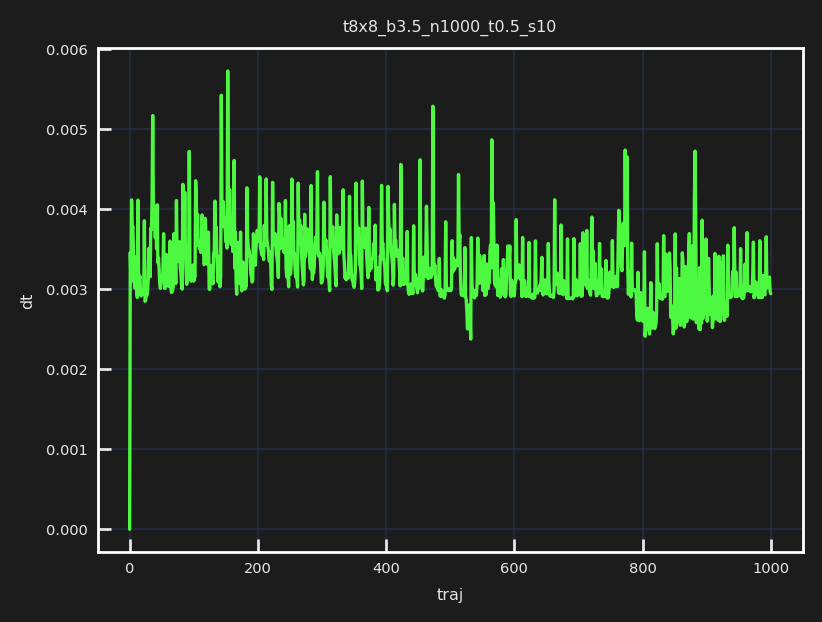

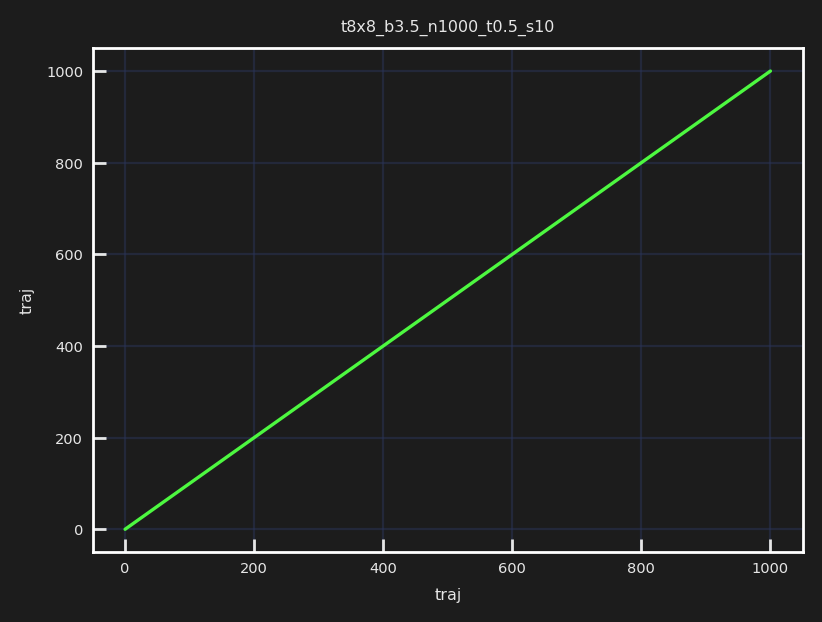

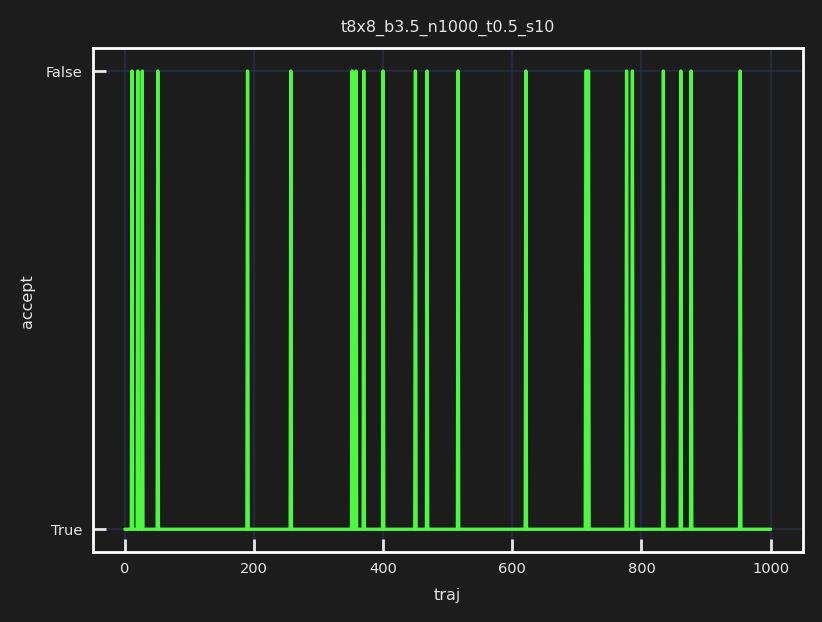

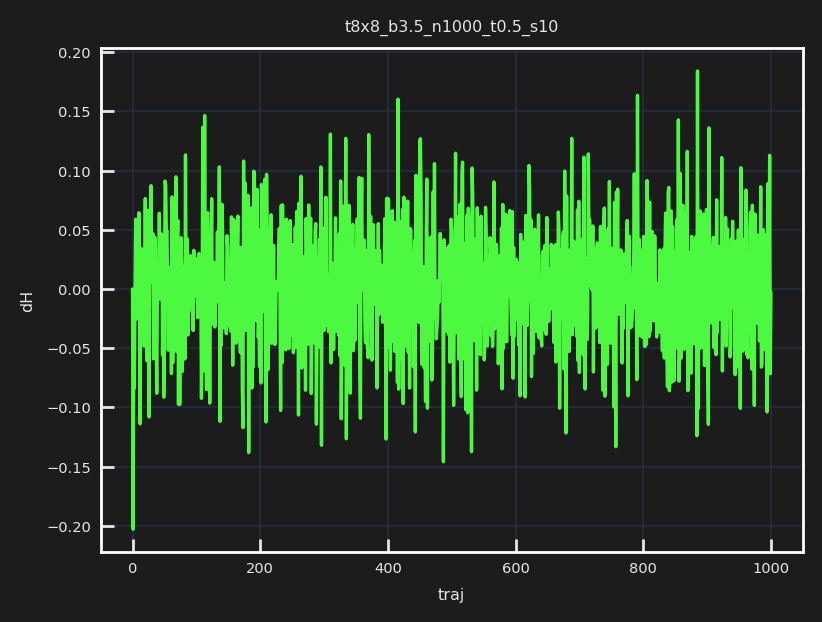

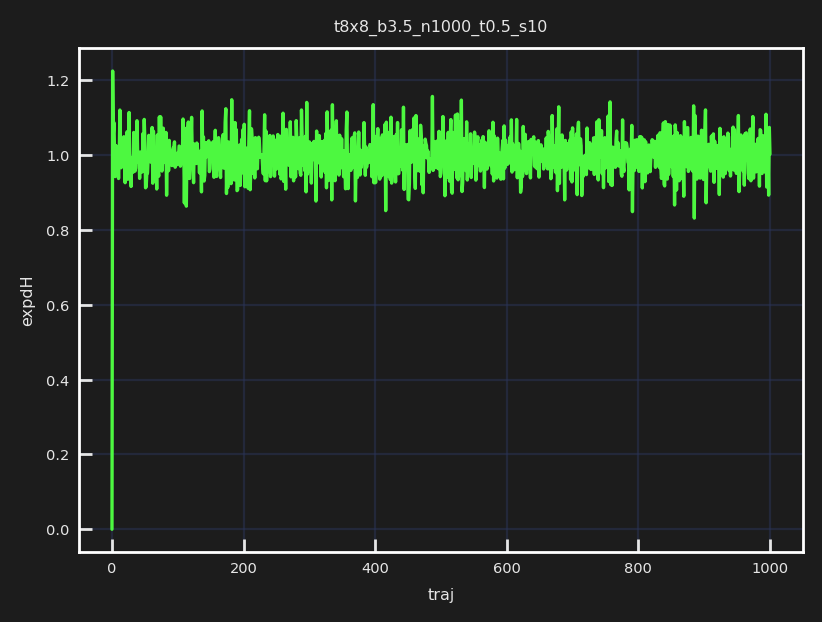

...

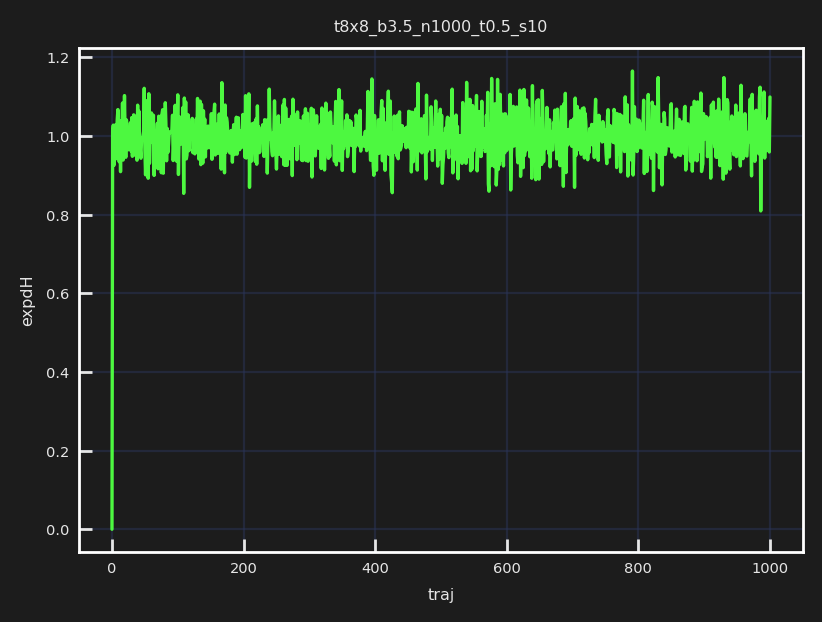

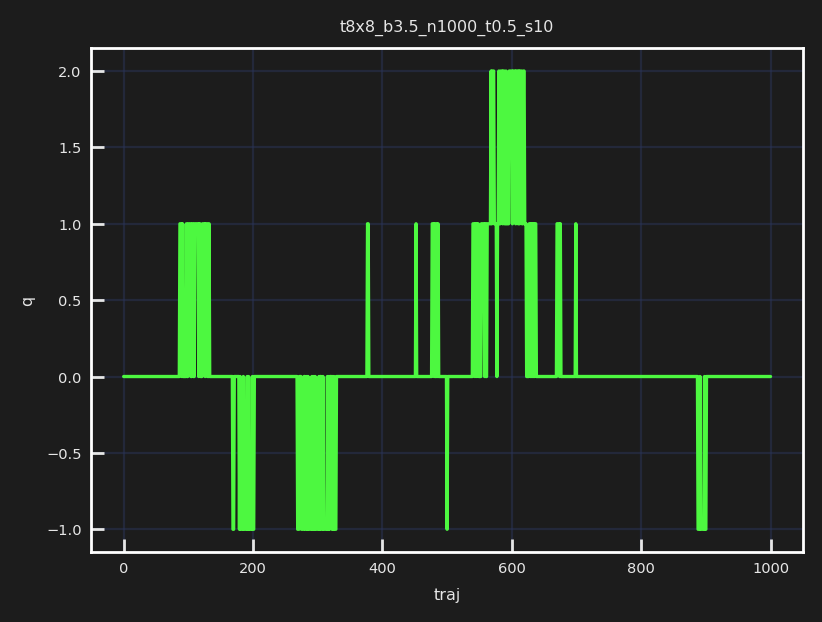

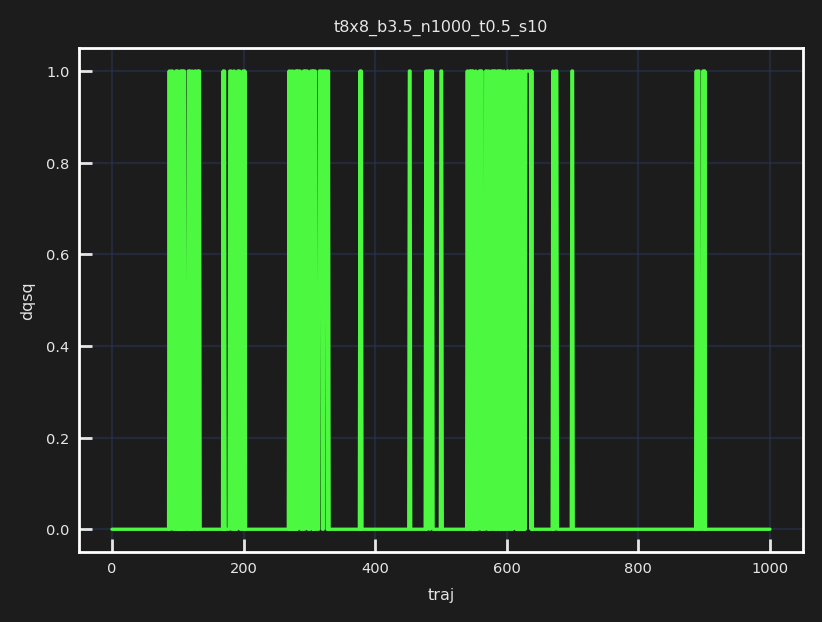

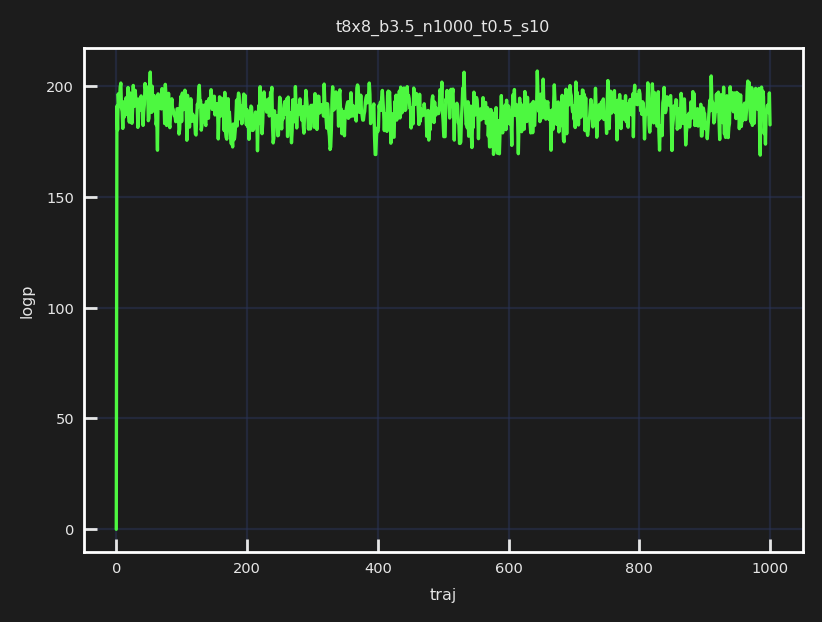

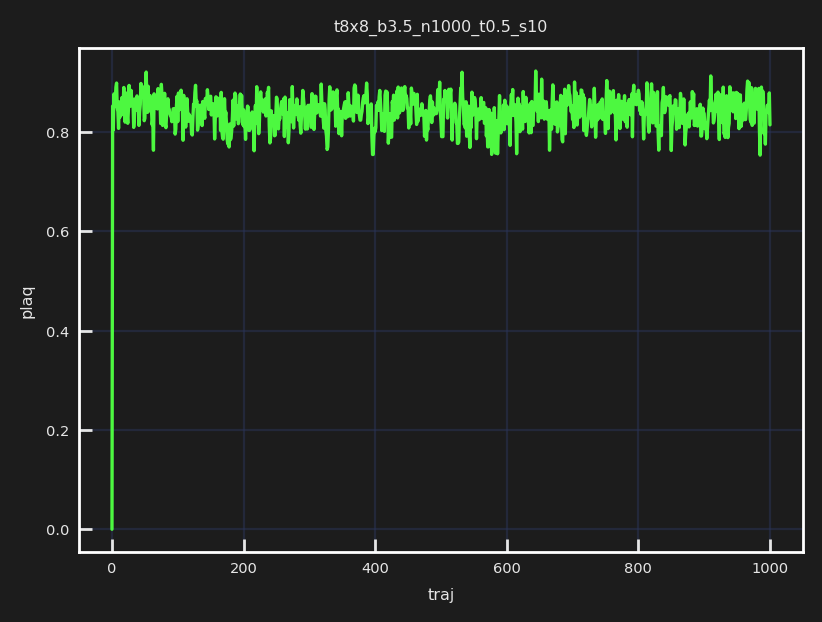

In [14]:
from fthmc.hmc import run_hmc

hmc_fields8, hmc_history8 = run_hmc(param8,
                                    keep_fields=True,
                                    save_history=True)

## Transfer again

[07:37:53]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100

[07:37:53]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training

[07:37:53]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots

[07:37:53]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints

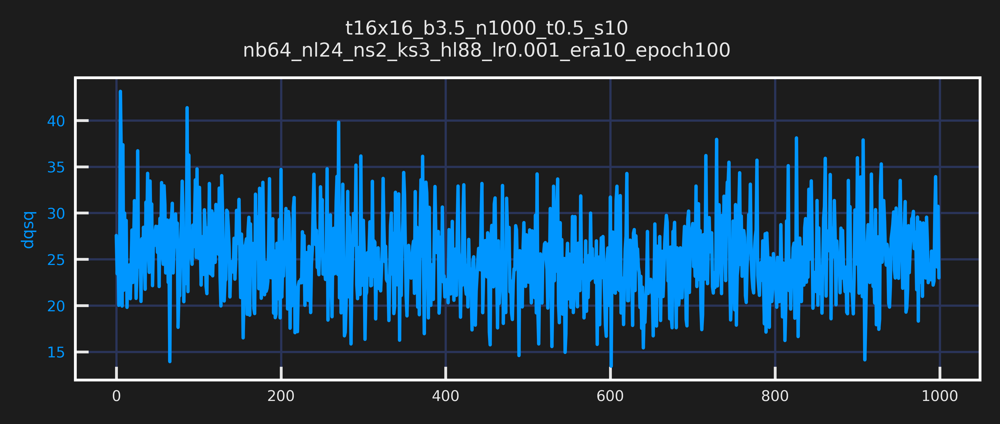

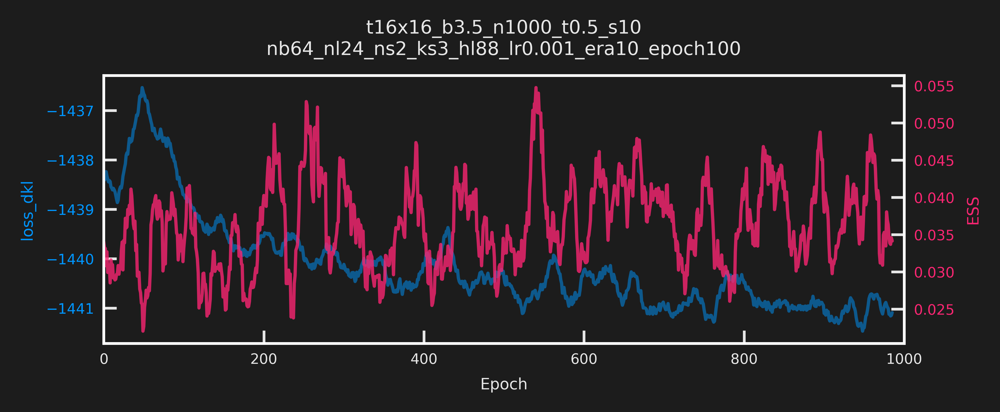

[07:37:54]  -----------------------------                                                    
            ERA=0, last took: 0 min 0 sec                                                    
            -----------------------------

[07:38:06]  epoch=19.000 step=19.000 dt=0.602 loss=-1438.242 dqsq=24.234 ess=0.024 plaq=0.817
            loss_dkl=-1438.242 logp=731.912 logq=-706.330

[07:38:19]  epoch=39.000 step=39.000 dt=0.604 loss=-1438.140 dqsq=28.069 ess=0.045 plaq=0.815
            loss_dkl=-1438.140 logp=730.281 logq=-707.859

[07:38:32]  epoch=59.000 step=59.000 dt=0.607 loss=-1436.214 dqsq=29.416 ess=0.025 plaq=0.819
            loss_dkl=-1436.214 logp=733.954 logq=-702.260

[07:38:46]  epoch=79.000 step=79.000 dt=0.603 loss=-1437.566 dqsq=23.094 ess=0.030 plaq=0.819
            loss_dkl=-1437.566 logp=734.072 logq=-703.494

[07:38:59]  epoch=99.000 step=99.000 dt=0.666 loss=-1438.280 dqsq=30.050 ess=0.044 plaq=0.817
            loss_dkl=-1438.280 logp=731.665 logq=-706.615

[07:39:00]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era0-ep
            och100.tar

[07:39:00]  ---------------------------------                                                
            ERA=1, last took: 1 min 6.736 sec                                                
            ---------------------------------

[07:39:13]  epoch=19.000 step=119.000 dt=0.643 loss=-1438.893 dqsq=26.622 ess=0.043          
            plaq=0.815 loss_dkl=-1438.893 logp=730.007 logq=-708.886

[07:39:28]  epoch=39.000 step=139.000 dt=0.717 loss=-1439.575 dqsq=25.991 ess=0.030          
            plaq=0.813 loss_dkl=-1439.575 logp=728.769 logq=-710.806

[07:39:45]  epoch=59.000 step=159.000 dt=0.771 loss=-1439.147 dqsq=23.991 ess=0.022          
            plaq=0.815 loss_dkl=-1439.147 logp=729.888 logq=-709.258

[07:40:02]  epoch=79.000 step=179.000 dt=0.771 loss=-1439.950 dqsq=26.325 ess=0.031          
            plaq=0.818 loss_dkl=-1439.950 logp=733.116 logq=-706.834

[07:40:21]  epoch=99.000 step=199.000 dt=0.777 loss=-1439.704 dqsq=23.619 ess=0.033          
            plaq=0.812 loss_dkl=-1439.704 logp=727.217 logq=-712.488

[07:40:22]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era1-ep
            och100.tar

[07:40:22]  ---------------------------------                                                
            ERA=2, last took: 1 min 21.85 sec                                                
            ---------------------------------

[07:40:38]  epoch=19.000 step=219.000 dt=0.790 loss=-1439.403 dqsq=24.094 ess=0.044          
            plaq=0.814 loss_dkl=-1439.403 logp=729.544 logq=-709.859

[07:40:56]  epoch=39.000 step=239.000 dt=0.772 loss=-1439.601 dqsq=24.616 ess=0.030          
            plaq=0.814 loss_dkl=-1439.601 logp=729.209 logq=-710.392

[07:41:13]  epoch=59.000 step=259.000 dt=0.769 loss=-1440.171 dqsq=26.606 ess=0.051          
            plaq=0.816 loss_dkl=-1440.171 logp=730.704 logq=-709.467

[07:41:29]  epoch=79.000 step=279.000 dt=0.749 loss=-1439.709 dqsq=22.534 ess=0.048          
            plaq=0.819 loss_dkl=-1439.709 logp=733.856 logq=-705.853

[07:41:47]  epoch=99.000 step=299.000 dt=0.782 loss=-1439.909 dqsq=25.891 ess=0.043          
            plaq=0.818 loss_dkl=-1439.909 logp=732.930 logq=-706.979

[07:41:48]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era2-ep
            och100.tar

[07:41:48]  ---------------------------------                                                
            ERA=3, last took: 1 min 25.49 sec                                                
            ---------------------------------

[07:42:04]  epoch=19.000 step=319.000 dt=0.786 loss=-1440.349 dqsq=22.956 ess=0.030          
            plaq=0.818 loss_dkl=-1440.349 logp=733.083 logq=-707.266

[07:42:21]  epoch=39.000 step=339.000 dt=0.787 loss=-1439.785 dqsq=24.488 ess=0.036          
            plaq=0.820 loss_dkl=-1439.785 logp=734.870 logq=-704.916

[07:42:38]  epoch=59.000 step=359.000 dt=0.803 loss=-1440.234 dqsq=24.591 ess=0.021          
            plaq=0.816 loss_dkl=-1440.234 logp=730.703 logq=-709.531

[07:42:57]  epoch=79.000 step=379.000 dt=0.829 loss=-1440.611 dqsq=27.444 ess=0.044          
            plaq=0.820 loss_dkl=-1440.611 logp=734.723 logq=-705.888

[07:43:16]  epoch=99.000 step=399.000 dt=0.891 loss=-1440.387 dqsq=23.991 ess=0.034          
            plaq=0.817 loss_dkl=-1440.387 logp=732.018 logq=-708.369

[07:43:18]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era3-ep
            och100.tar

[07:43:18]  ---------------------------------                                                
            ERA=4, last took: 1 min 29.83 sec                                                
            ---------------------------------

[07:43:36]  epoch=19.000 step=419.000 dt=0.893 loss=-1439.968 dqsq=25.275 ess=0.026          
            plaq=0.817 loss_dkl=-1439.968 logp=731.663 logq=-708.305

[07:43:56]  epoch=39.000 step=439.000 dt=0.853 loss=-1439.193 dqsq=21.750 ess=0.026          
            plaq=0.818 loss_dkl=-1439.193 logp=733.168 logq=-706.025

[07:44:15]  epoch=59.000 step=459.000 dt=0.880 loss=-1440.388 dqsq=27.422 ess=0.027          
            plaq=0.816 loss_dkl=-1440.388 logp=731.087 logq=-709.302

[07:44:33]  epoch=79.000 step=479.000 dt=0.860 loss=-1440.602 dqsq=25.294 ess=0.044          
            plaq=0.817 loss_dkl=-1440.602 logp=732.134 logq=-708.468

[07:44:52]  epoch=99.000 step=499.000 dt=0.857 loss=-1440.503 dqsq=24.906 ess=0.026          
            plaq=0.818 loss_dkl=-1440.503 logp=732.892 logq=-707.612

[07:44:53]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era4-ep
            och100.tar

[07:44:53]  ---------------------------------                                                
            ERA=5, last took: 1 min 35.47 sec                                                
            ---------------------------------

[07:45:12]  epoch=19.000 step=519.000 dt=0.870 loss=-1440.696 dqsq=24.197 ess=0.030          
            plaq=0.818 loss_dkl=-1440.696 logp=733.343 logq=-707.353

[07:45:31]  epoch=39.000 step=539.000 dt=0.906 loss=-1441.005 dqsq=26.312 ess=0.040          
            plaq=0.814 loss_dkl=-1441.005 logp=729.276 logq=-711.729

[07:45:51]  epoch=59.000 step=559.000 dt=0.880 loss=-1440.191 dqsq=23.059 ess=0.029          
            plaq=0.817 loss_dkl=-1440.191 logp=732.293 logq=-707.899

[07:46:09]  epoch=79.000 step=579.000 dt=0.819 loss=-1440.291 dqsq=24.953 ess=0.036          
            plaq=0.819 loss_dkl=-1440.291 logp=734.188 logq=-706.103

[07:46:28]  epoch=99.000 step=599.000 dt=0.832 loss=-1441.037 dqsq=21.775 ess=0.035          
            plaq=0.819 loss_dkl=-1441.037 logp=734.006 logq=-707.030

[07:46:29]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era5-ep
            och100.tar

[07:46:29]  ---------------------------------                                                
            ERA=6, last took: 1 min 35.53 sec                                                
            ---------------------------------

[07:46:46]  epoch=19.000 step=619.000 dt=0.815 loss=-1440.548 dqsq=23.419 ess=0.039          
            plaq=0.818 loss_dkl=-1440.548 logp=733.133 logq=-707.415

[07:47:04]  epoch=39.000 step=639.000 dt=0.858 loss=-1440.524 dqsq=21.203 ess=0.045          
            plaq=0.820 loss_dkl=-1440.524 logp=734.353 logq=-706.170

[07:47:23]  epoch=59.000 step=659.000 dt=0.878 loss=-1440.974 dqsq=22.363 ess=0.038          
            plaq=0.818 loss_dkl=-1440.974 logp=733.359 logq=-707.615

[07:47:44]  epoch=79.000 step=679.000 dt=0.925 loss=-1440.777 dqsq=25.019 ess=0.046          
            plaq=0.820 loss_dkl=-1440.777 logp=734.833 logq=-705.944

[07:48:04]  epoch=99.000 step=699.000 dt=0.889 loss=-1441.004 dqsq=26.556 ess=0.049          
            plaq=0.817 loss_dkl=-1441.004 logp=731.618 logq=-709.386

[07:48:06]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era6-ep
            och100.tar

[07:48:06]  ---------------------------------                                                
            ERA=7, last took: 1 min 36.73 sec                                                
            ---------------------------------

[07:48:24]  epoch=19.000 step=719.000 dt=0.885 loss=-1441.237 dqsq=26.972 ess=0.032          
            plaq=0.817 loss_dkl=-1441.237 logp=731.895 logq=-709.342

[07:48:44]  epoch=39.000 step=739.000 dt=0.966 loss=-1441.217 dqsq=26.844 ess=0.027          
            plaq=0.819 loss_dkl=-1441.217 logp=734.202 logq=-707.015

[07:49:04]  epoch=59.000 step=759.000 dt=0.876 loss=-1441.030 dqsq=28.631 ess=0.048          
            plaq=0.816 loss_dkl=-1441.030 logp=731.496 logq=-709.534

[07:49:24]  epoch=79.000 step=779.000 dt=0.984 loss=-1440.737 dqsq=28.128 ess=0.027          
            plaq=0.813 loss_dkl=-1440.737 logp=728.522 logq=-712.215

[07:49:45]  epoch=99.000 step=799.000 dt=0.971 loss=-1440.184 dqsq=23.072 ess=0.026          
            plaq=0.815 loss_dkl=-1440.184 logp=730.678 logq=-709.506

[07:49:47]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era7-ep
            och100.tar

[07:49:47]  ---------------------------------                                                
            ERA=8, last took: 1 min 40.67 sec                                                
            ---------------------------------

[07:50:07]  epoch=19.000 step=819.000 dt=1.120 loss=-1440.865 dqsq=25.009 ess=0.038          
            plaq=0.818 loss_dkl=-1440.865 logp=732.519 logq=-708.346

[07:50:28]  epoch=39.000 step=839.000 dt=0.949 loss=-1441.046 dqsq=25.788 ess=0.052          
            plaq=0.815 loss_dkl=-1441.046 logp=730.534 logq=-710.511

[07:50:50]  epoch=59.000 step=859.000 dt=1.000 loss=-1440.947 dqsq=23.769 ess=0.037          
            plaq=0.820 loss_dkl=-1440.947 logp=734.644 logq=-706.303

[07:51:13]  epoch=79.000 step=879.000 dt=1.145 loss=-1441.173 dqsq=24.416 ess=0.038          
            plaq=0.820 loss_dkl=-1441.173 logp=734.905 logq=-706.268

[07:51:34]  epoch=99.000 step=899.000 dt=0.951 loss=-1440.561 dqsq=24.753 ess=0.052          
            plaq=0.821 loss_dkl=-1440.561 logp=735.296 logq=-705.265

[07:51:36]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era8-ep
            och100.tar

[07:51:36]  ---------------------------------                                                
            ERA=9, last took: 1 min 49.28 sec                                                
            ---------------------------------

[07:51:56]  epoch=19.000 step=919.000 dt=1.024 loss=-1441.135 dqsq=26.188 ess=0.033          
            plaq=0.817 loss_dkl=-1441.135 logp=732.046 logq=-709.089

[07:52:18]  epoch=39.000 step=939.000 dt=0.972 loss=-1440.756 dqsq=23.391 ess=0.036          
            plaq=0.820 loss_dkl=-1440.756 logp=734.323 logq=-706.434

[07:52:38]  epoch=59.000 step=959.000 dt=0.917 loss=-1441.409 dqsq=25.025 ess=0.032          
            plaq=0.821 loss_dkl=-1441.409 logp=735.718 logq=-705.691

[07:52:58]  epoch=79.000 step=979.000 dt=0.871 loss=-1441.050 dqsq=25.688 ess=0.030          
            plaq=0.822 loss_dkl=-1441.050 logp=736.492 logq=-704.559

[07:53:17]  epoch=99.000 step=999.000 dt=0.918 loss=-1441.257 dqsq=27.353 ess=0.024          
            plaq=0.826 loss_dkl=-1441.257 logp=740.458 logq=-700.799

[07:53:19]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era9-ep
            och100.tar

            Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/checkpoints/ckpt-era9-ep
            och100.tar

[07:53:19]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/dqsq_live.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/dkl_live.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/dt.pdf

[07:53:20]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/loss.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/dqsq.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/ess.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/plaq.pdf

[07:53:21]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/loss_dkl.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/logp.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/plots/logq.pdf

[07:53:21]  Saving train_history to /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_
            s10/nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/training/train_history.z.

/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:138: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.array(val)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.array(val)


[07:53:26]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots

[07:53:26]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/ess.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/dqsq.pdf

[07:53:27]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/dkl.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/logq.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/logp.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b3.5_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.001_era10_epoch100/inference/plots/accepted.pdf

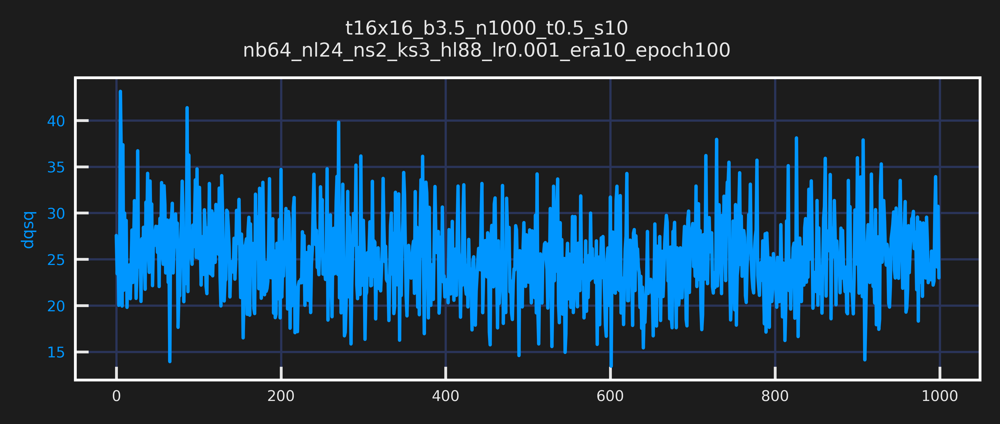

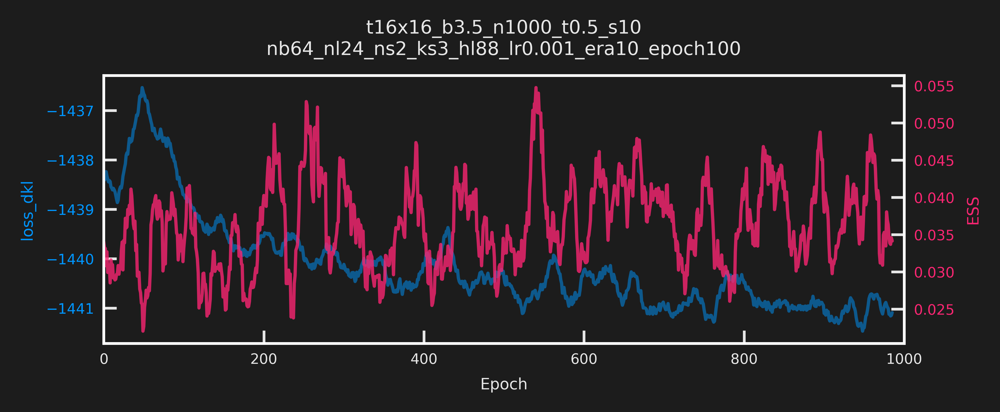

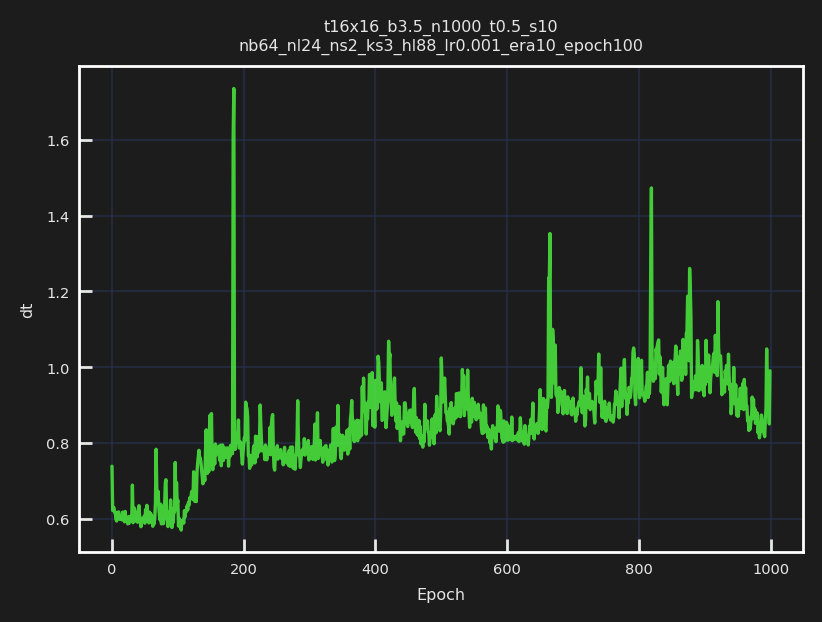

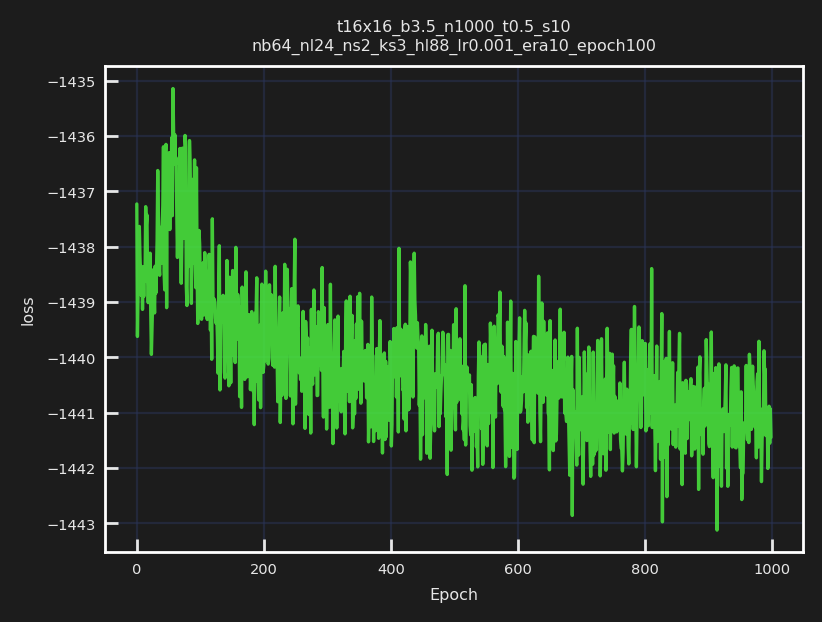

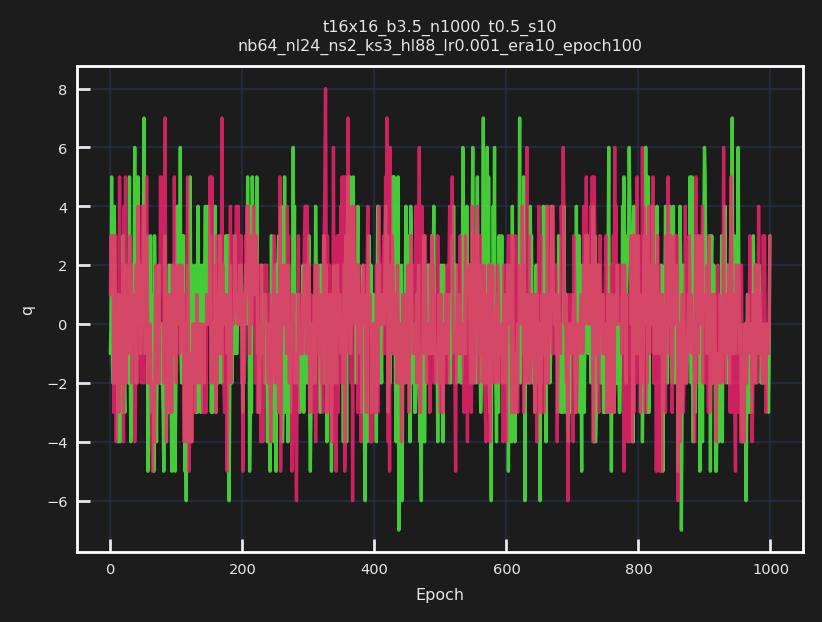

...

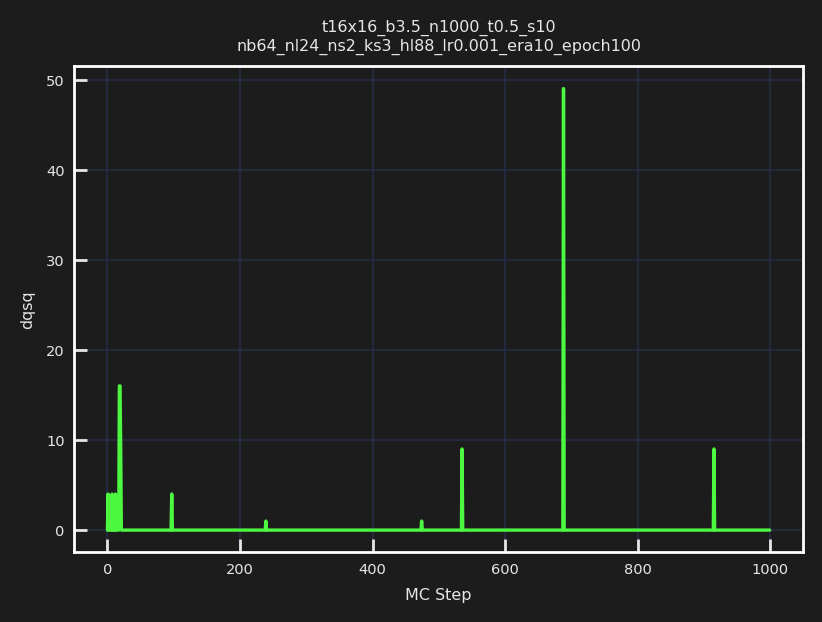

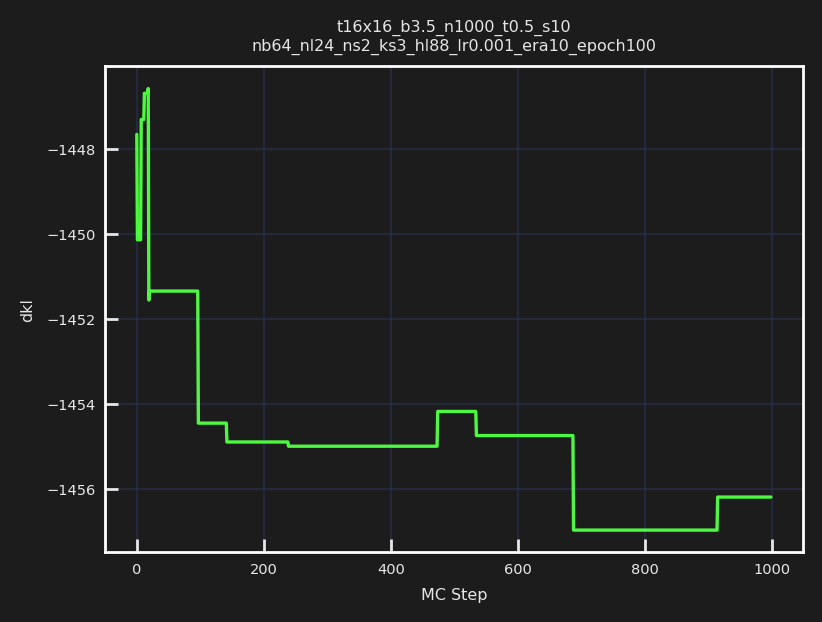

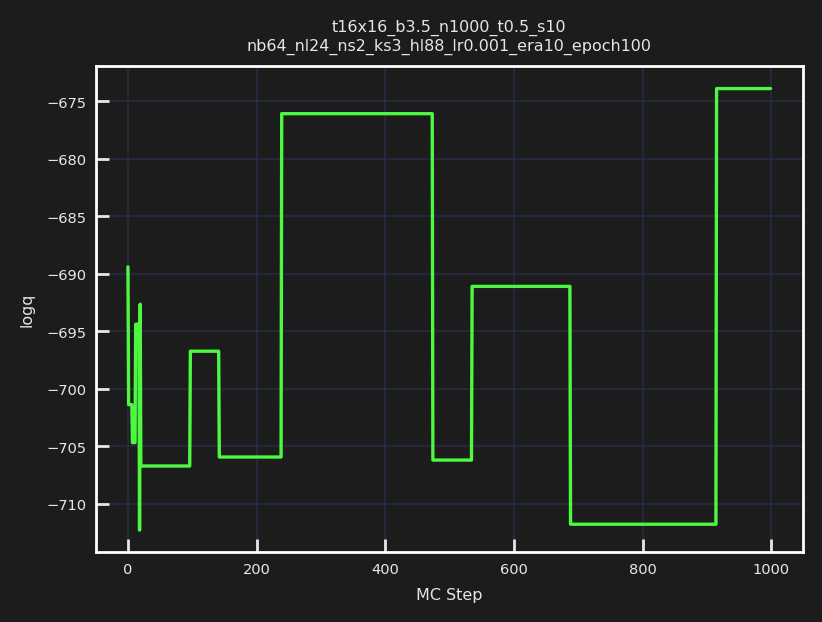

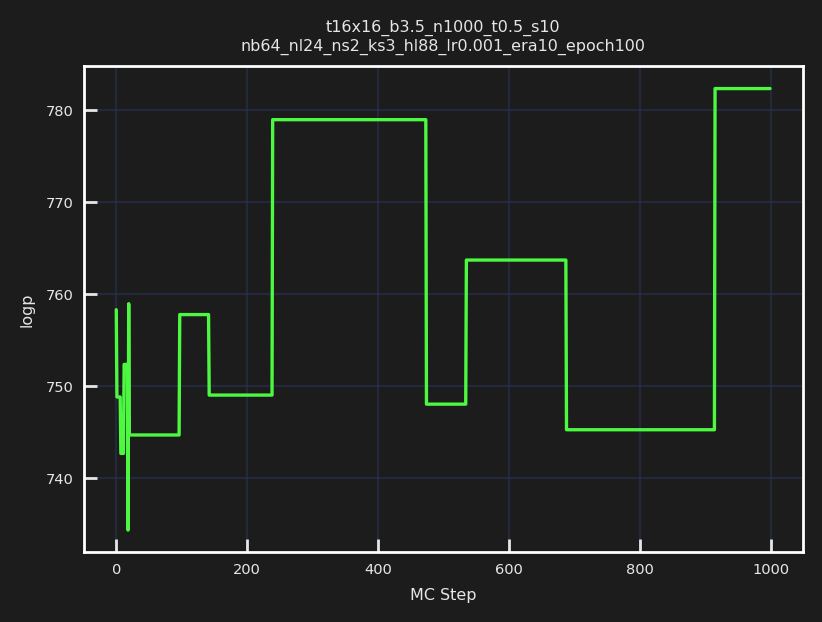

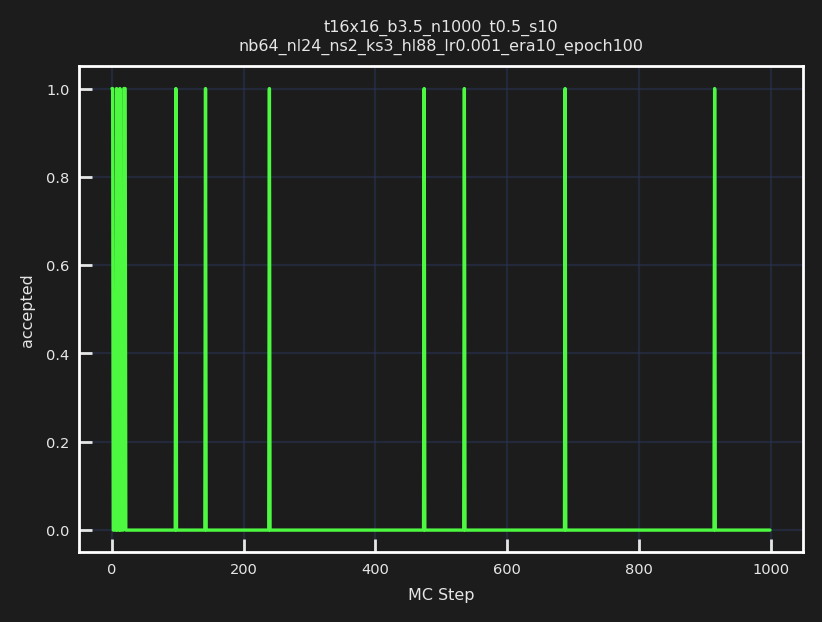

In [15]:

from dataclasses import asdict
from fthmc.train import train, transfer_to_new_lattice
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history
from fthmc.utils.samplers import make_mcmc_ensemble

layers8 = train_outputs8['model']['layers']



xfr = transfer_to_new_lattice(L=16,
                              layers=layers8,
                              param_init=param8)
param16 = xfr['param']
model16 = xfr['model']

cfg_dict = asdict(train_config)
cfg_dict['base_lr'] = 0.001
train_config16 = TrainConfig(**cfg_dict)

train_outputs16 = train(param16,
                        train_config16,
                        model=model16,
                        pre_model=None,
                        figsize=(5, 2))


action_fn16 = qed.BatchAction(param16.beta)
dirs16 = train_outputs16['dirs']
logdir16 = dirs16['logdir']

inf_dir16 = os.path.join(logdir16, 'inference')
inf_pdir16 = os.path.join(inf_dir16, 'plots')

history16 = make_mcmc_ensemble(model=train_outputs16['model'],
                              action_fn=action_fn16,
                              batch_size=train_config16.batch_size,
                              num_samples=1000)

plot_history(history=history16,
             param=param16,
             config=train_config16,
             skip=['epoch', 'x'],
             num_chains=4,
             therm_frac=0.0,
             xlabel='MC Step',
             outdir=inf_pdir16)

[07:53:59]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s10/plots

[07:53:59]  Param:                                                                           
            ----------------                                                                 
            beta=3.5                                                                         
            L=16                                                                             
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=1000                                                                       
            nrun=2                                                                           
            nprint=100                                                                       
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[16, 16]                                                                     
            nd=2                                                                             
            shape=[2, 16, 16]                                                                
            volume=256                                                                       
            dt=0.05

            action=1.000 plaq=0.000 charge=0.000

            dt=0.004 traj=2 accept=True dH=-0.195 expdH=1.215 q=0 dqsq=0 logp=774.669        
            plaq=0.865

            dt=0.004 traj=12 accept=False dH=0.122 expdH=0.886 q=1 dqsq=0 logp=735.517       
            plaq=0.821

            dt=0.004 traj=22 accept=False dH=0.073 expdH=0.929 q=0 dqsq=0 logp=745.413       
            plaq=0.832

            dt=0.004 traj=32 accept=True dH=-0.177 expdH=1.193 q=1 dqsq=1 logp=754.142       
            plaq=0.842

[07:54:00]  dt=0.005 traj=42 accept=True dH=-0.137 expdH=1.146 q=1 dqsq=0 logp=742.616       
            plaq=0.829

            dt=0.004 traj=52 accept=True dH=-0.042 expdH=1.043 q=2 dqsq=4 logp=762.409       
            plaq=0.851

            dt=0.004 traj=62 accept=True dH=0.149 expdH=0.861 q=1 dqsq=0 logp=758.855        
            plaq=0.847

            dt=0.006 traj=72 accept=True dH=0.074 expdH=0.929 q=0 dqsq=0 logp=762.596        
            plaq=0.851

            dt=0.004 traj=82 accept=True dH=-0.153 expdH=1.165 q=0 dqsq=0 logp=755.466       
            plaq=0.843

            dt=0.004 traj=92 accept=True dH=-0.085 expdH=1.089 q=0 dqsq=0 logp=769.923       
            plaq=0.859

            dt=0.005 traj=102 accept=True dH=0.044 expdH=0.957 q=0 dqsq=1 logp=767.279       
            plaq=0.856

            dt=0.004 traj=112 accept=True dH=0.187 expdH=0.829 q=0 dqsq=0 logp=765.801       
            plaq=0.855

            dt=0.004 traj=122 accept=True dH=0.046 expdH=0.955 q=-1 dqsq=0 logp=764.942      
            plaq=0.854

            dt=0.004 traj=132 accept=True dH=0.130 expdH=0.878 q=-1 dqsq=1 logp=789.257      
            plaq=0.881

            dt=0.005 traj=142 accept=True dH=-0.010 expdH=1.010 q=0 dqsq=1 logp=751.687      
            plaq=0.839

            dt=0.004 traj=152 accept=True dH=0.058 expdH=0.944 q=0 dqsq=0 logp=758.355       
            plaq=0.846

            dt=0.004 traj=162 accept=True dH=0.077 expdH=0.926 q=0 dqsq=0 logp=767.000       
            plaq=0.856

            dt=0.004 traj=172 accept=True dH=-0.134 expdH=1.143 q=0 dqsq=0 logp=736.114      
            plaq=0.822

            dt=0.004 traj=182 accept=True dH=-0.104 expdH=1.109 q=0 dqsq=0 logp=755.020      
            plaq=0.843

            dt=0.004 traj=192 accept=True dH=-0.082 expdH=1.086 q=0 dqsq=0 logp=740.912      
            plaq=0.827

            dt=0.004 traj=202 accept=True dH=0.207 expdH=0.813 q=0 dqsq=0 logp=770.862       
            plaq=0.860

[07:54:01]  dt=0.004 traj=212 accept=True dH=-0.003 expdH=1.003 q=0 dqsq=0 logp=746.068      
            plaq=0.833

            dt=0.004 traj=222 accept=True dH=0.111 expdH=0.895 q=1 dqsq=0 logp=761.230       
            plaq=0.850

            dt=0.004 traj=232 accept=True dH=-0.066 expdH=1.069 q=1 dqsq=0 logp=747.126      
            plaq=0.834

            dt=0.004 traj=242 accept=True dH=-0.179 expdH=1.197 q=0 dqsq=0 logp=740.152      
            plaq=0.826

            dt=0.004 traj=252 accept=True dH=-0.024 expdH=1.025 q=0 dqsq=0 logp=754.935      
            plaq=0.843

            dt=0.004 traj=262 accept=True dH=-0.094 expdH=1.098 q=0 dqsq=1 logp=747.257      
            plaq=0.834

            dt=0.004 traj=272 accept=True dH=-0.139 expdH=1.149 q=0 dqsq=1 logp=749.724      
            plaq=0.837

            dt=0.004 traj=282 accept=True dH=0.049 expdH=0.952 q=2 dqsq=0 logp=742.283       
            plaq=0.828

            dt=0.004 traj=292 accept=True dH=0.072 expdH=0.931 q=2 dqsq=0 logp=754.468       
            plaq=0.842

            dt=0.004 traj=302 accept=True dH=0.017 expdH=0.983 q=2 dqsq=0 logp=744.146       
            plaq=0.831

            dt=0.004 traj=312 accept=True dH=-0.068 expdH=1.071 q=1 dqsq=0 logp=743.367      
            plaq=0.830

            dt=0.004 traj=322 accept=True dH=-0.249 expdH=1.283 q=1 dqsq=1 logp=757.503      
            plaq=0.845

            dt=0.004 traj=332 accept=True dH=0.095 expdH=0.910 q=0 dqsq=1 logp=755.079       
            plaq=0.843

            dt=0.004 traj=342 accept=True dH=0.003 expdH=0.997 q=0 dqsq=0 logp=754.339       
            plaq=0.842

            dt=0.004 traj=352 accept=True dH=-0.086 expdH=1.090 q=1 dqsq=0 logp=761.021      
            plaq=0.849

            dt=0.004 traj=362 accept=True dH=0.151 expdH=0.860 q=0 dqsq=0 logp=753.637       
            plaq=0.841

            dt=0.005 traj=372 accept=True dH=-0.074 expdH=1.076 q=0 dqsq=0 logp=765.672      
            plaq=0.855

[07:54:02]  dt=0.005 traj=382 accept=True dH=-0.049 expdH=1.050 q=1 dqsq=0 logp=776.839      
            plaq=0.867

            dt=0.005 traj=392 accept=True dH=-0.030 expdH=1.030 q=0 dqsq=0 logp=744.525      
            plaq=0.831

            dt=0.004 traj=402 accept=True dH=0.037 expdH=0.964 q=3 dqsq=1 logp=767.908       
            plaq=0.857

            dt=0.004 traj=412 accept=True dH=0.130 expdH=0.878 q=5 dqsq=4 logp=758.826       
            plaq=0.847

            dt=0.004 traj=422 accept=True dH=0.093 expdH=0.911 q=4 dqsq=1 logp=747.021       
            plaq=0.834

            dt=0.005 traj=432 accept=True dH=0.094 expdH=0.911 q=3 dqsq=1 logp=737.988       
            plaq=0.824

            dt=0.004 traj=442 accept=True dH=0.040 expdH=0.961 q=2 dqsq=0 logp=770.839       
            plaq=0.860

            dt=0.004 traj=452 accept=True dH=0.196 expdH=0.822 q=2 dqsq=0 logp=770.380       
            plaq=0.860

            dt=0.004 traj=462 accept=True dH=-0.094 expdH=1.099 q=1 dqsq=1 logp=757.850      
            plaq=0.846

            dt=0.004 traj=472 accept=True dH=0.099 expdH=0.906 q=1 dqsq=1 logp=761.792       
            plaq=0.850

            dt=0.004 traj=482 accept=True dH=-0.129 expdH=1.138 q=2 dqsq=0 logp=765.168      
            plaq=0.854

            dt=0.004 traj=492 accept=True dH=0.026 expdH=0.974 q=0 dqsq=4 logp=752.168       
            plaq=0.839

            dt=0.004 traj=502 accept=True dH=0.079 expdH=0.924 q=0 dqsq=0 logp=765.416       
            plaq=0.854

            dt=0.004 traj=512 accept=True dH=-0.024 expdH=1.025 q=1 dqsq=1 logp=760.607      
            plaq=0.849

            dt=0.004 traj=522 accept=True dH=-0.033 expdH=1.033 q=1 dqsq=0 logp=774.295      
            plaq=0.864

            dt=0.004 traj=532 accept=True dH=0.005 expdH=0.995 q=0 dqsq=1 logp=741.663       
            plaq=0.828

            dt=0.004 traj=542 accept=True dH=-0.100 expdH=1.105 q=0 dqsq=0 logp=753.292      
            plaq=0.841

[07:54:03]  dt=0.004 traj=552 accept=True dH=-0.038 expdH=1.039 q=0 dqsq=0 logp=754.472      
            plaq=0.842

            dt=0.004 traj=562 accept=True dH=-0.021 expdH=1.021 q=-1 dqsq=1 logp=752.731     
            plaq=0.840

            dt=0.004 traj=572 accept=True dH=-0.009 expdH=1.009 q=0 dqsq=0 logp=749.338      
            plaq=0.836

            dt=0.004 traj=582 accept=True dH=-0.094 expdH=1.099 q=0 dqsq=0 logp=768.775      
            plaq=0.858

            dt=0.004 traj=592 accept=True dH=-0.069 expdH=1.071 q=1 dqsq=1 logp=749.055      
            plaq=0.836

            dt=0.004 traj=602 accept=True dH=0.180 expdH=0.835 q=0 dqsq=0 logp=762.668       
            plaq=0.851

            dt=0.004 traj=612 accept=True dH=0.131 expdH=0.878 q=0 dqsq=0 logp=752.184       
            plaq=0.839

            dt=0.004 traj=622 accept=True dH=-0.017 expdH=1.017 q=0 dqsq=1 logp=765.232      
            plaq=0.854

            dt=0.004 traj=632 accept=True dH=-0.010 expdH=1.010 q=-1 dqsq=0 logp=745.364     
            plaq=0.832

            dt=0.004 traj=642 accept=True dH=0.008 expdH=0.992 q=-1 dqsq=1 logp=736.413      
            plaq=0.822

            dt=0.004 traj=652 accept=True dH=0.056 expdH=0.946 q=-1 dqsq=0 logp=778.666      
            plaq=0.869

            dt=0.004 traj=662 accept=True dH=0.051 expdH=0.951 q=0 dqsq=1 logp=743.173       
            plaq=0.829

            dt=0.004 traj=672 accept=True dH=0.121 expdH=0.886 q=0 dqsq=0 logp=757.946       
            plaq=0.846

            dt=0.004 traj=682 accept=True dH=-0.008 expdH=1.008 q=0 dqsq=0 logp=749.211      
            plaq=0.836

            dt=0.004 traj=692 accept=True dH=0.118 expdH=0.889 q=0 dqsq=0 logp=771.067       
            plaq=0.861

            dt=0.004 traj=702 accept=True dH=0.091 expdH=0.913 q=0 dqsq=0 logp=770.629       
            plaq=0.860

            dt=0.004 traj=712 accept=True dH=0.227 expdH=0.797 q=0 dqsq=0 logp=761.567       
            plaq=0.850

[07:54:04]  dt=0.004 traj=722 accept=True dH=-0.115 expdH=1.121 q=0 dqsq=0 logp=750.043      
            plaq=0.837

            dt=0.004 traj=732 accept=True dH=-0.092 expdH=1.097 q=-1 dqsq=0 logp=741.230     
            plaq=0.827

            dt=0.004 traj=742 accept=True dH=-0.024 expdH=1.024 q=0 dqsq=0 logp=761.117      
            plaq=0.849

            dt=0.004 traj=752 accept=True dH=-0.038 expdH=1.039 q=0 dqsq=0 logp=747.763      
            plaq=0.835

            dt=0.004 traj=762 accept=True dH=0.194 expdH=0.824 q=0 dqsq=0 logp=753.997       
            plaq=0.842

            dt=0.004 traj=772 accept=True dH=-0.138 expdH=1.148 q=0 dqsq=0 logp=737.943      
            plaq=0.824

            dt=0.004 traj=782 accept=False dH=0.079 expdH=0.924 q=0 dqsq=0 logp=755.863      
            plaq=0.844

            dt=0.004 traj=792 accept=True dH=0.013 expdH=0.988 q=1 dqsq=1 logp=742.330       
            plaq=0.828

            dt=0.004 traj=802 accept=True dH=0.016 expdH=0.984 q=2 dqsq=0 logp=745.643       
            plaq=0.832

            dt=0.004 traj=812 accept=True dH=0.010 expdH=0.990 q=0 dqsq=0 logp=749.927       
            plaq=0.837

            dt=0.004 traj=822 accept=True dH=0.083 expdH=0.921 q=0 dqsq=0 logp=760.100       
            plaq=0.848

            dt=0.005 traj=832 accept=True dH=0.036 expdH=0.965 q=0 dqsq=0 logp=764.231       
            plaq=0.853

            dt=0.004 traj=842 accept=True dH=0.027 expdH=0.973 q=0 dqsq=1 logp=763.144       
            plaq=0.852

            dt=0.004 traj=852 accept=True dH=0.135 expdH=0.874 q=0 dqsq=1 logp=762.036       
            plaq=0.850

            dt=0.004 traj=862 accept=True dH=-0.202 expdH=1.223 q=1 dqsq=0 logp=737.959      
            plaq=0.824

            dt=0.004 traj=872 accept=True dH=0.066 expdH=0.936 q=0 dqsq=0 logp=766.950       
            plaq=0.856

            dt=0.004 traj=882 accept=True dH=-0.096 expdH=1.101 q=1 dqsq=0 logp=740.502      
            plaq=0.826

[07:54:05]  dt=0.004 traj=892 accept=False dH=0.332 expdH=0.718 q=1 dqsq=0 logp=729.754      
            plaq=0.814

            dt=0.004 traj=902 accept=True dH=0.069 expdH=0.933 q=1 dqsq=0 logp=747.507       
            plaq=0.834

            dt=0.004 traj=912 accept=True dH=0.020 expdH=0.980 q=0 dqsq=0 logp=762.025       
            plaq=0.850

            dt=0.004 traj=922 accept=True dH=-0.062 expdH=1.063 q=1 dqsq=1 logp=750.932      
            plaq=0.838

            dt=0.004 traj=932 accept=True dH=-0.122 expdH=1.130 q=0 dqsq=0 logp=749.617      
            plaq=0.837

            dt=0.004 traj=942 accept=True dH=-0.033 expdH=1.034 q=-1 dqsq=1 logp=752.664     
            plaq=0.840

            dt=0.004 traj=952 accept=True dH=-0.004 expdH=1.004 q=0 dqsq=1 logp=766.356      
            plaq=0.855

            dt=0.004 traj=962 accept=True dH=-0.011 expdH=1.012 q=-2 dqsq=0 logp=742.991     
            plaq=0.829

            dt=0.004 traj=972 accept=True dH=-0.163 expdH=1.177 q=-2 dqsq=1 logp=735.266     
            plaq=0.821

            dt=0.004 traj=982 accept=True dH=0.042 expdH=0.959 q=0 dqsq=0 logp=768.134       
            plaq=0.857

            dt=0.004 traj=992 accept=True dH=-0.131 expdH=1.140 q=-1 dqsq=0 logp=747.713     
            plaq=0.835

[07:54:05]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s10/plots/run0

[07:54:05]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run0/dt.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run0/traj.pdf

[07:54:06]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run0/accept.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run0/dH.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run0/expdH.pdf

            Saving figure to:                                                                
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s10/plots/run0/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run0/dqsq.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run0/logp.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


[07:54:07]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run0/plaq.pdf

[07:54:07]  dt=0.004 traj=1002 accept=True dH=0.241 expdH=0.786 q=-1 dqsq=1 logp=774.456     
            plaq=0.864

            dt=0.004 traj=1012 accept=True dH=0.092 expdH=0.912 q=-1 dqsq=0 logp=764.500     
            plaq=0.853

            dt=0.004 traj=1022 accept=True dH=0.161 expdH=0.851 q=-1 dqsq=0 logp=775.486     
            plaq=0.865

            dt=0.004 traj=1032 accept=True dH=-0.009 expdH=1.009 q=-1 dqsq=1 logp=750.923    
            plaq=0.838

            dt=0.004 traj=1042 accept=True dH=-0.035 expdH=1.035 q=-1 dqsq=1 logp=752.690    
            plaq=0.840

            dt=0.004 traj=1052 accept=True dH=-0.031 expdH=1.032 q=0 dqsq=0 logp=750.515     
            plaq=0.838

            dt=0.004 traj=1062 accept=True dH=-0.113 expdH=1.119 q=0 dqsq=0 logp=726.109     
            plaq=0.810

            dt=0.004 traj=1072 accept=True dH=-0.043 expdH=1.044 q=0 dqsq=0 logp=760.365     
            plaq=0.849

            dt=0.004 traj=1082 accept=True dH=0.030 expdH=0.970 q=0 dqsq=0 logp=745.865      
            plaq=0.832

            dt=0.004 traj=1092 accept=True dH=-0.088 expdH=1.092 q=0 dqsq=1 logp=743.698     
            plaq=0.830

            dt=0.004 traj=1102 accept=True dH=-0.062 expdH=1.064 q=0 dqsq=0 logp=744.649     
            plaq=0.831

            dt=0.004 traj=1112 accept=True dH=-0.160 expdH=1.174 q=-2 dqsq=1 logp=744.015    
            plaq=0.830

            dt=0.004 traj=1122 accept=True dH=-0.014 expdH=1.014 q=-2 dqsq=0 logp=743.245    
            plaq=0.830

            dt=0.004 traj=1132 accept=True dH=-0.129 expdH=1.137 q=-1 dqsq=0 logp=752.155    
            plaq=0.839

[07:54:08]  dt=0.004 traj=1142 accept=True dH=-0.040 expdH=1.041 q=-1 dqsq=0 logp=755.525    
            plaq=0.843

            dt=0.005 traj=1152 accept=True dH=0.112 expdH=0.894 q=0 dqsq=4 logp=750.136      
            plaq=0.837

            dt=0.004 traj=1162 accept=True dH=0.015 expdH=0.985 q=0 dqsq=0 logp=760.970      
            plaq=0.849

            dt=0.004 traj=1172 accept=True dH=-0.054 expdH=1.056 q=0 dqsq=0 logp=743.767     
            plaq=0.830

            dt=0.004 traj=1182 accept=True dH=0.054 expdH=0.947 q=0 dqsq=0 logp=754.901      
            plaq=0.843

            dt=0.004 traj=1192 accept=True dH=-0.024 expdH=1.024 q=0 dqsq=0 logp=765.980     
            plaq=0.855

            dt=0.004 traj=1202 accept=True dH=0.018 expdH=0.982 q=0 dqsq=1 logp=750.426      
            plaq=0.838

            dt=0.004 traj=1212 accept=True dH=0.185 expdH=0.831 q=0 dqsq=1 logp=769.136      
            plaq=0.858

            dt=0.004 traj=1222 accept=True dH=-0.011 expdH=1.011 q=0 dqsq=0 logp=749.966     
            plaq=0.837

            dt=0.004 traj=1232 accept=True dH=-0.013 expdH=1.014 q=0 dqsq=0 logp=746.380     
            plaq=0.833

            dt=0.004 traj=1242 accept=True dH=-0.146 expdH=1.157 q=0 dqsq=0 logp=743.709     
            plaq=0.830

            dt=0.004 traj=1252 accept=True dH=-0.056 expdH=1.058 q=0 dqsq=0 logp=737.174     
            plaq=0.823

            dt=0.004 traj=1262 accept=True dH=-0.170 expdH=1.185 q=0 dqsq=0 logp=747.978     
            plaq=0.835

            dt=0.004 traj=1272 accept=True dH=0.179 expdH=0.836 q=0 dqsq=0 logp=768.922      
            plaq=0.858

            dt=0.004 traj=1282 accept=True dH=0.153 expdH=0.858 q=1 dqsq=1 logp=750.821      
            plaq=0.838

            dt=0.004 traj=1292 accept=True dH=0.055 expdH=0.946 q=0 dqsq=1 logp=765.511      
            plaq=0.854

            dt=0.004 traj=1302 accept=True dH=0.005 expdH=0.995 q=1 dqsq=1 logp=761.714      
            plaq=0.850

            dt=0.004 traj=1312 accept=True dH=-0.051 expdH=1.052 q=1 dqsq=0 logp=735.830     
            plaq=0.821

[07:54:09]  dt=0.004 traj=1322 accept=True dH=0.202 expdH=0.817 q=1 dqsq=1 logp=764.450      
            plaq=0.853

            dt=0.004 traj=1332 accept=True dH=0.056 expdH=0.946 q=1 dqsq=0 logp=762.015      
            plaq=0.850

            dt=0.004 traj=1342 accept=True dH=-0.259 expdH=1.296 q=1 dqsq=1 logp=752.587     
            plaq=0.840

            dt=0.004 traj=1352 accept=True dH=0.074 expdH=0.928 q=2 dqsq=0 logp=769.096      
            plaq=0.858

            dt=0.004 traj=1362 accept=True dH=-0.006 expdH=1.006 q=2 dqsq=0 logp=753.673     
            plaq=0.841

            dt=0.004 traj=1372 accept=True dH=-0.094 expdH=1.099 q=0 dqsq=0 logp=730.477     
            plaq=0.815

            dt=0.004 traj=1382 accept=True dH=0.072 expdH=0.930 q=0 dqsq=0 logp=771.973      
            plaq=0.862

            dt=0.004 traj=1392 accept=True dH=-0.091 expdH=1.096 q=1 dqsq=1 logp=735.943     
            plaq=0.821

            dt=0.004 traj=1402 accept=True dH=0.114 expdH=0.892 q=0 dqsq=0 logp=770.935      
            plaq=0.860

            dt=0.004 traj=1412 accept=True dH=0.011 expdH=0.989 q=0 dqsq=0 logp=758.633      
            plaq=0.847

            dt=0.004 traj=1422 accept=True dH=0.012 expdH=0.988 q=0 dqsq=0 logp=761.934      
            plaq=0.850

            dt=0.004 traj=1432 accept=True dH=-0.008 expdH=1.008 q=-1 dqsq=1 logp=733.733    
            plaq=0.819

            dt=0.004 traj=1442 accept=True dH=0.046 expdH=0.955 q=-1 dqsq=0 logp=759.360     
            plaq=0.847

            dt=0.004 traj=1452 accept=True dH=0.079 expdH=0.924 q=-1 dqsq=0 logp=757.091     
            plaq=0.845

            dt=0.004 traj=1462 accept=True dH=-0.076 expdH=1.079 q=-2 dqsq=0 logp=754.952    
            plaq=0.843

            dt=0.004 traj=1472 accept=True dH=0.107 expdH=0.898 q=-1 dqsq=1 logp=765.348     
            plaq=0.854

            dt=0.004 traj=1482 accept=True dH=0.042 expdH=0.958 q=-1 dqsq=1 logp=737.297     
            plaq=0.823

            dt=0.004 traj=1492 accept=True dH=-0.016 expdH=1.016 q=0 dqsq=0 logp=746.092     
            plaq=0.833

[07:54:10]  dt=0.004 traj=1502 accept=True dH=0.017 expdH=0.983 q=0 dqsq=0 logp=767.929      
            plaq=0.857

            dt=0.004 traj=1512 accept=True dH=-0.186 expdH=1.204 q=0 dqsq=0 logp=749.443     
            plaq=0.836

            dt=0.004 traj=1522 accept=True dH=-0.151 expdH=1.163 q=0 dqsq=1 logp=738.910     
            plaq=0.825

            dt=0.004 traj=1532 accept=True dH=0.210 expdH=0.811 q=0 dqsq=0 logp=770.143      
            plaq=0.860

            dt=0.004 traj=1542 accept=True dH=-0.083 expdH=1.087 q=1 dqsq=1 logp=742.651     
            plaq=0.829

            dt=0.004 traj=1552 accept=True dH=-0.056 expdH=1.057 q=0 dqsq=1 logp=736.378     
            plaq=0.822

            dt=0.004 traj=1562 accept=True dH=0.022 expdH=0.978 q=-2 dqsq=0 logp=750.351     
            plaq=0.837

            dt=0.004 traj=1572 accept=True dH=-0.123 expdH=1.131 q=-2 dqsq=1 logp=745.542    
            plaq=0.832

            dt=0.004 traj=1582 accept=True dH=0.002 expdH=0.998 q=-2 dqsq=0 logp=751.184     
            plaq=0.838

            dt=0.004 traj=1592 accept=True dH=-0.032 expdH=1.033 q=0 dqsq=0 logp=742.776     
            plaq=0.829

            dt=0.004 traj=1602 accept=True dH=-0.045 expdH=1.046 q=-1 dqsq=0 logp=754.994    
            plaq=0.843

            dt=0.004 traj=1612 accept=True dH=-0.039 expdH=1.040 q=-2 dqsq=1 logp=755.561    
            plaq=0.843

            dt=0.004 traj=1622 accept=True dH=0.005 expdH=0.995 q=-1 dqsq=1 logp=742.599     
            plaq=0.829

            dt=0.004 traj=1632 accept=True dH=0.070 expdH=0.933 q=0 dqsq=1 logp=743.620      
            plaq=0.830

            dt=0.004 traj=1642 accept=True dH=0.095 expdH=0.909 q=0 dqsq=0 logp=759.364      
            plaq=0.848

            dt=0.004 traj=1652 accept=True dH=0.019 expdH=0.981 q=0 dqsq=0 logp=744.402      
            plaq=0.831

            dt=0.004 traj=1662 accept=True dH=-0.009 expdH=1.009 q=1 dqsq=0 logp=754.312     
            plaq=0.842

            dt=0.004 traj=1672 accept=True dH=-0.072 expdH=1.075 q=1 dqsq=0 logp=747.233     
            plaq=0.834

[07:54:11]  dt=0.004 traj=1682 accept=True dH=-0.065 expdH=1.067 q=1 dqsq=1 logp=739.165     
            plaq=0.825

            dt=0.004 traj=1692 accept=True dH=0.003 expdH=0.997 q=0 dqsq=1 logp=756.498      
            plaq=0.844

            dt=0.004 traj=1702 accept=True dH=-0.276 expdH=1.318 q=1 dqsq=0 logp=726.993     
            plaq=0.811

            dt=0.004 traj=1712 accept=True dH=0.112 expdH=0.894 q=1 dqsq=0 logp=754.809      
            plaq=0.842

            dt=0.004 traj=1722 accept=True dH=-0.009 expdH=1.009 q=1 dqsq=1 logp=767.427     
            plaq=0.857

            dt=0.004 traj=1732 accept=True dH=-0.060 expdH=1.062 q=0 dqsq=1 logp=744.716     
            plaq=0.831

            dt=0.004 traj=1742 accept=True dH=-0.123 expdH=1.131 q=1 dqsq=0 logp=748.392     
            plaq=0.835

            dt=0.004 traj=1752 accept=True dH=-0.065 expdH=1.068 q=0 dqsq=0 logp=736.525     
            plaq=0.822

            dt=0.004 traj=1762 accept=True dH=-0.118 expdH=1.125 q=0 dqsq=0 logp=739.582     
            plaq=0.825

            dt=0.004 traj=1772 accept=True dH=0.063 expdH=0.939 q=-1 dqsq=1 logp=748.209     
            plaq=0.835

            dt=0.004 traj=1782 accept=True dH=-0.016 expdH=1.016 q=-1 dqsq=0 logp=749.905    
            plaq=0.837

            dt=0.004 traj=1792 accept=True dH=-0.078 expdH=1.081 q=0 dqsq=0 logp=760.572     
            plaq=0.849

            dt=0.004 traj=1802 accept=True dH=-0.048 expdH=1.049 q=0 dqsq=0 logp=761.477     
            plaq=0.850

            dt=0.004 traj=1812 accept=True dH=0.131 expdH=0.877 q=0 dqsq=1 logp=773.487      
            plaq=0.863

            dt=0.004 traj=1822 accept=True dH=0.054 expdH=0.948 q=1 dqsq=0 logp=756.387      
            plaq=0.844

            dt=0.004 traj=1832 accept=True dH=0.023 expdH=0.977 q=0 dqsq=1 logp=740.584      
            plaq=0.827

            dt=0.004 traj=1842 accept=True dH=0.222 expdH=0.801 q=0 dqsq=1 logp=769.851      
            plaq=0.859

            dt=0.004 traj=1852 accept=True dH=-0.084 expdH=1.088 q=0 dqsq=0 logp=765.276     
            plaq=0.854

            dt=0.004 traj=1862 accept=True dH=-0.151 expdH=1.163 q=0 dqsq=1 logp=743.513     
            plaq=0.830

[07:54:12]  dt=0.005 traj=1872 accept=True dH=0.193 expdH=0.825 q=0 dqsq=0 logp=756.204      
            plaq=0.844

            dt=0.004 traj=1882 accept=True dH=0.102 expdH=0.903 q=1 dqsq=0 logp=777.056      
            plaq=0.867

            dt=0.004 traj=1892 accept=True dH=0.030 expdH=0.971 q=0 dqsq=0 logp=756.857      
            plaq=0.845

            dt=0.004 traj=1902 accept=True dH=-0.225 expdH=1.252 q=1 dqsq=0 logp=731.450     
            plaq=0.816

            dt=0.004 traj=1912 accept=True dH=0.053 expdH=0.948 q=-1 dqsq=1 logp=775.005     
            plaq=0.865

            dt=0.004 traj=1922 accept=True dH=0.118 expdH=0.889 q=0 dqsq=0 logp=767.915      
            plaq=0.857

            dt=0.004 traj=1932 accept=True dH=-0.058 expdH=1.060 q=0 dqsq=0 logp=741.260     
            plaq=0.827

            dt=0.004 traj=1942 accept=True dH=0.047 expdH=0.954 q=0 dqsq=0 logp=762.085      
            plaq=0.851

            dt=0.004 traj=1952 accept=True dH=-0.006 expdH=1.006 q=0 dqsq=0 logp=749.042     
            plaq=0.836

            dt=0.004 traj=1962 accept=True dH=-0.009 expdH=1.009 q=2 dqsq=0 logp=746.674     
            plaq=0.833

            dt=0.004 traj=1972 accept=True dH=0.079 expdH=0.924 q=1 dqsq=0 logp=750.015      
            plaq=0.837

            dt=0.004 traj=1982 accept=True dH=0.155 expdH=0.856 q=0 dqsq=0 logp=768.077      
            plaq=0.857

            dt=0.004 traj=1992 accept=True dH=0.083 expdH=0.920 q=0 dqsq=0 logp=726.741      
            plaq=0.811

[07:54:12]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s10/plots/run1

[07:54:12]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run1/dt.pdf

[07:54:13]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run1/traj.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run1/accept.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run1/dH.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run1/expdH.pdf

            Saving figure to:                                                                
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s10/plots/run1/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run1/dqsq.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


[07:54:14]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run1/logp.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:124: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s1
            0/plots/run1/plaq.pdf

[07:54:14]  Run times: ), 7.50987, array([0.      , 0.004467, 0.004397, ..., 0.003944,       
            0.003963, 0.003993]), 7.236425]

            Per trajectory: ), 0.00751, array([0.e+00, 4.e-06, 4.e-06, ..., 4.e-06, 4.e-06,  
            4.e-06]), 0.007236]

[07:54:14]  Saving hmc_history to                                                            
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_t0.5_s10/hmc_history.z.

[07:54:15]  Saving hmc_fields_arr to /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b3.5_n1000_
            t0.5_s10/hmc_fields_arr.z.

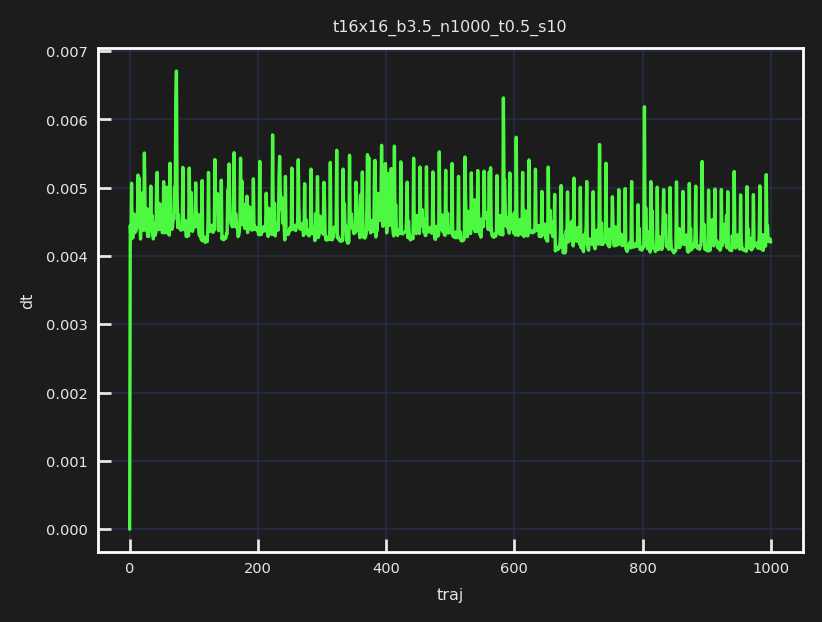

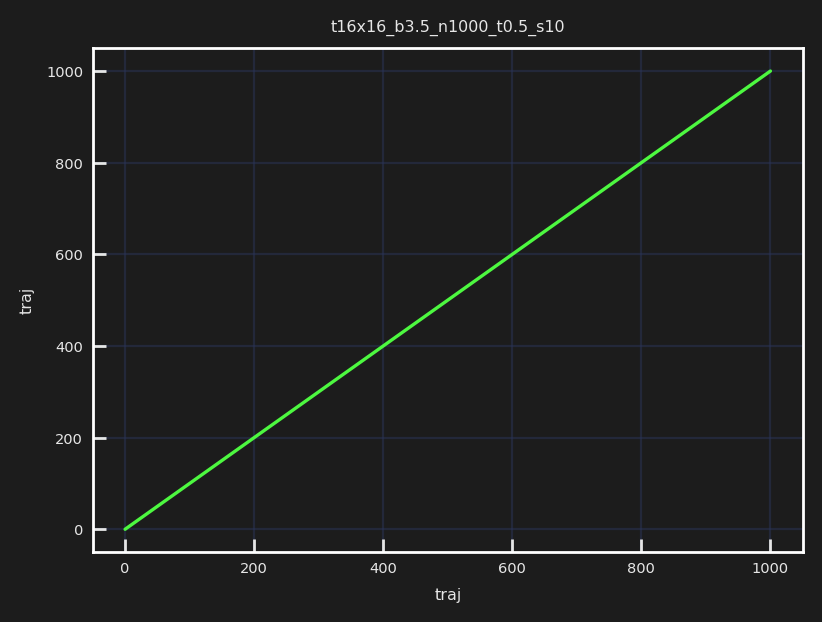

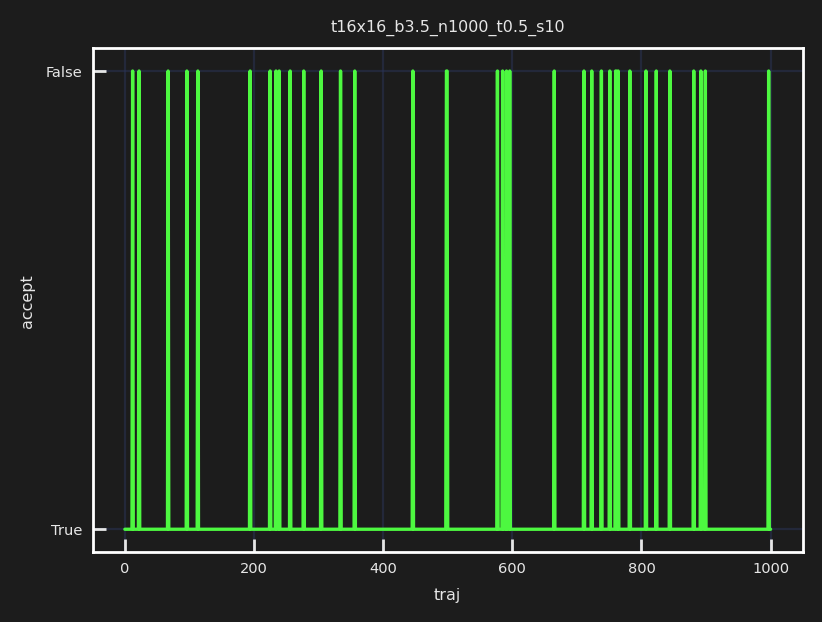

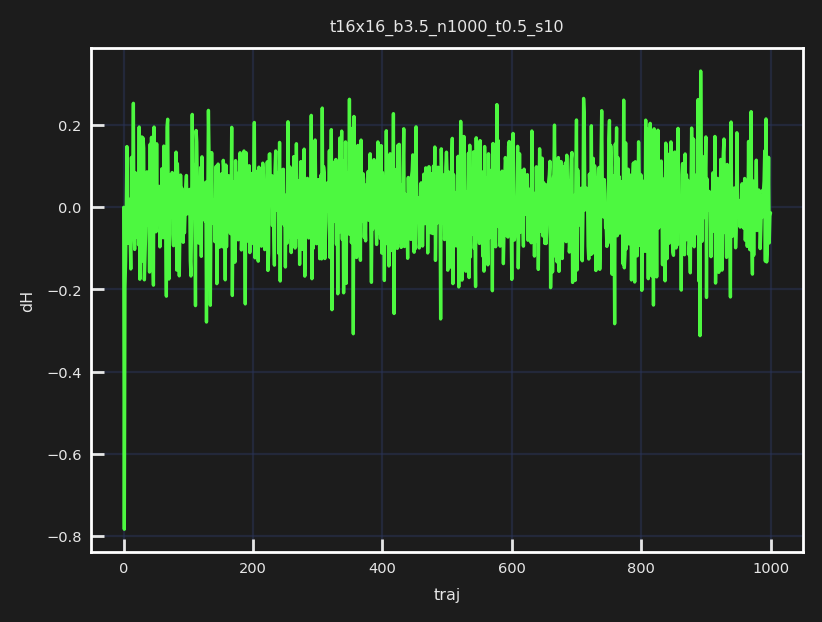

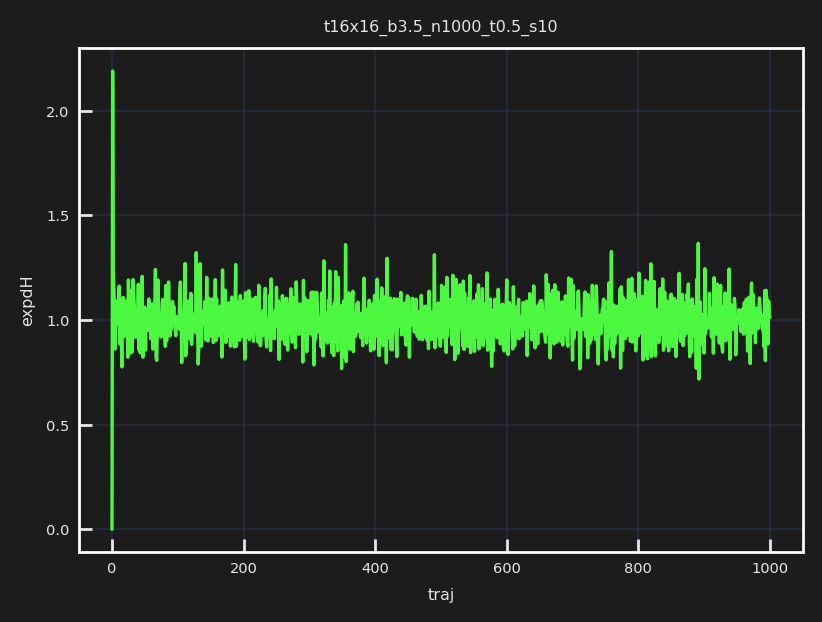

...

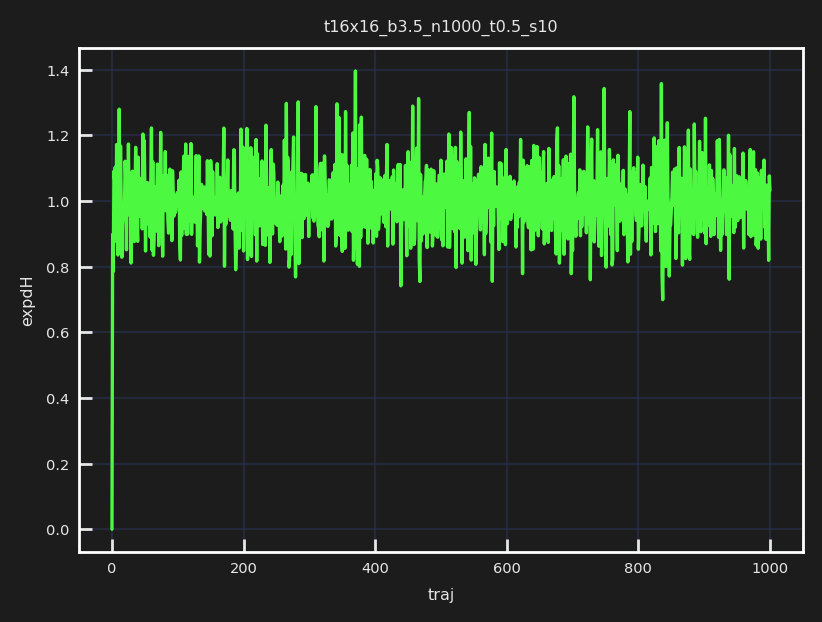

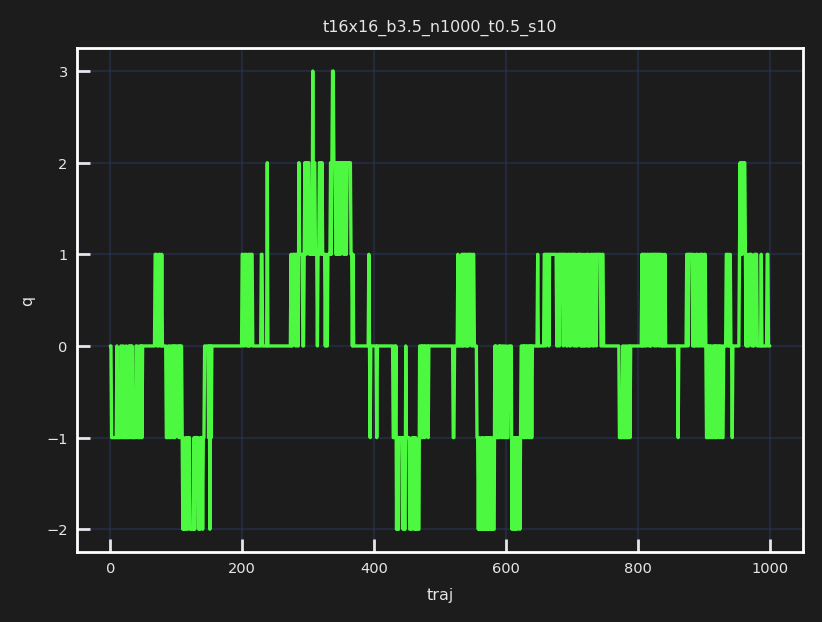

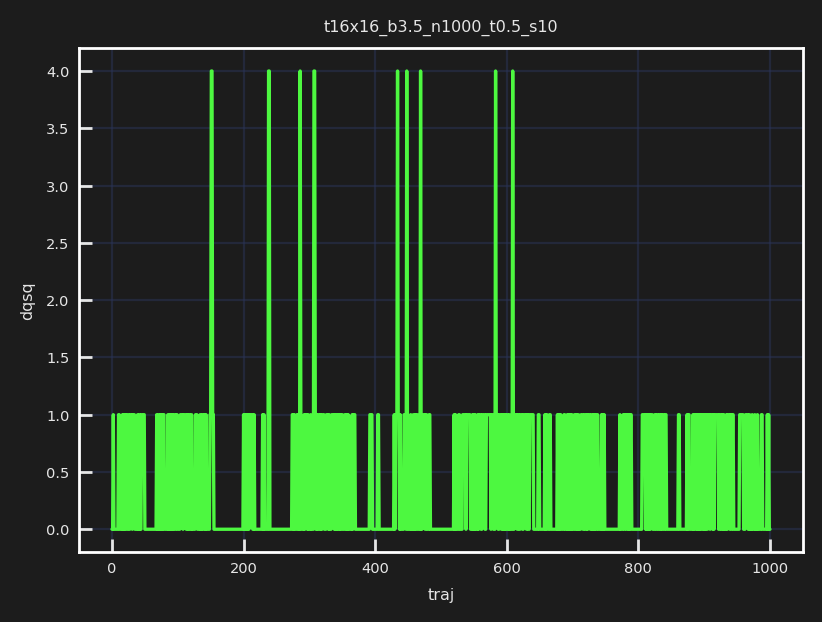

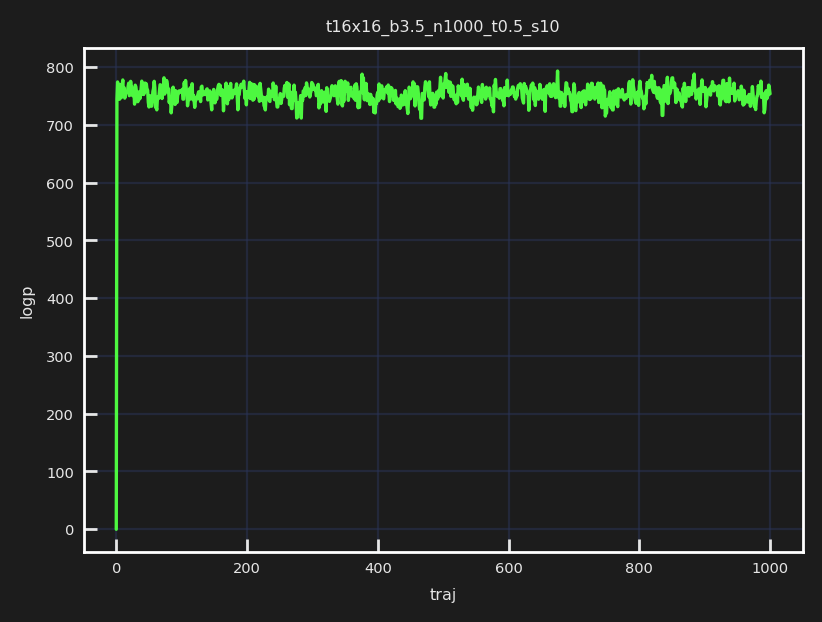

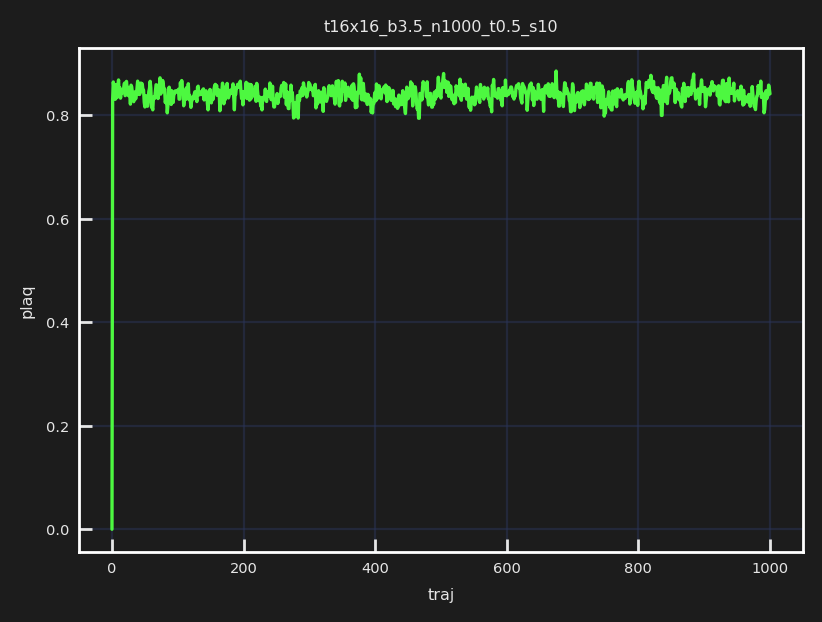

In [16]:
from fthmc.hmc import run_hmc

hmc_fields16, hmc_history16 = run_hmc(param16,
                                      keep_fields=True,
                                      save_history=True)

[00:12:08]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100

[00:12:08]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training

[00:12:08]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots

[00:12:08]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints

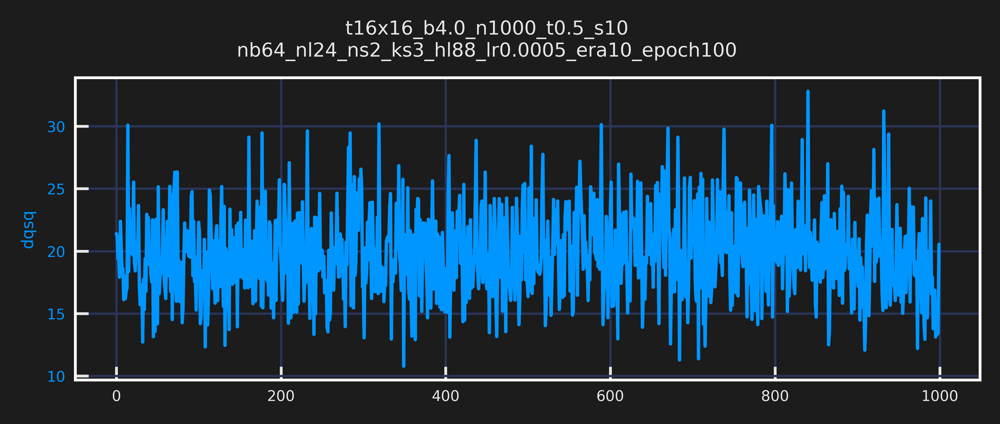

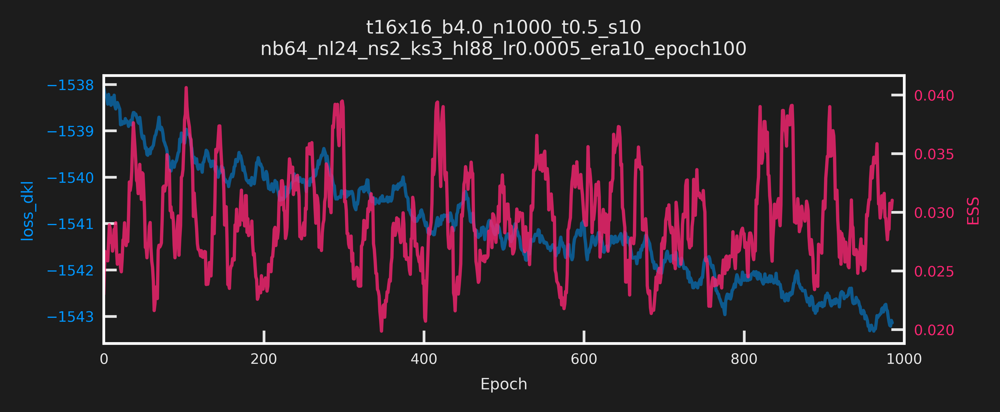

[00:12:09]  -----------------------------                                                    
            ERA=0, last took: 0 min 0 sec                                                    
            -----------------------------

[00:12:23]  epoch=19.000 step=19.000 dt=0.749 loss=-1538.371 dqsq=20.928 ess=0.031 plaq=0.828
            loss_dkl=-1538.371 logp=848.252 logq=-690.119

[00:12:41]  epoch=39.000 step=39.000 dt=0.897 loss=-1539.043 dqsq=20.866 ess=0.033 plaq=0.830
            loss_dkl=-1539.043 logp=849.590 logq=-689.453

[00:13:05]  epoch=59.000 step=59.000 dt=1.137 loss=-1539.272 dqsq=19.300 ess=0.026 plaq=0.830
            loss_dkl=-1539.272 logp=849.769 logq=-689.503

[00:13:33]  epoch=79.000 step=79.000 dt=1.248 loss=-1538.811 dqsq=18.397 ess=0.027 plaq=0.830
            loss_dkl=-1538.811 logp=849.924 logq=-688.887

[00:14:02]  epoch=99.000 step=99.000 dt=1.304 loss=-1539.577 dqsq=17.759 ess=0.021 plaq=0.831
            loss_dkl=-1539.577 logp=851.198 logq=-688.379

[00:14:04]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints/ckpt-era0-e
            poch100.tar

[00:14:05]  ---------------------------------                                                
            ERA=1, last took: 1 min 55.56 sec                                                
            ---------------------------------

[00:14:29]  epoch=19.000 step=119.000 dt=1.196 loss=-1539.266 dqsq=19.387 ess=0.038          
            plaq=0.831 loss_dkl=-1539.266 logp=850.684 logq=-688.581

[00:14:55]  epoch=39.000 step=139.000 dt=1.200 loss=-1539.270 dqsq=17.887 ess=0.022          
            plaq=0.831 loss_dkl=-1539.270 logp=850.958 logq=-688.312

[00:15:22]  epoch=59.000 step=159.000 dt=1.204 loss=-1539.914 dqsq=20.056 ess=0.027          
            plaq=0.832 loss_dkl=-1539.914 logp=852.295 logq=-687.619

[00:15:49]  epoch=79.000 step=179.000 dt=1.177 loss=-1539.461 dqsq=20.928 ess=0.030          
            plaq=0.831 loss_dkl=-1539.461 logp=851.265 logq=-688.197

[00:16:17]  epoch=99.000 step=199.000 dt=1.349 loss=-1539.598 dqsq=22.172 ess=0.024          
            plaq=0.828 loss_dkl=-1539.598 logp=848.194 logq=-691.404

[00:16:19]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints/ckpt-era1-e
            poch100.tar

[00:16:19]  ---------------------------------                                                
            ERA=2, last took: 2 min 14.57 sec                                                
            ---------------------------------

[00:16:45]  epoch=19.000 step=219.000 dt=1.154 loss=-1539.746 dqsq=18.603 ess=0.020          
            plaq=0.831 loss_dkl=-1539.746 logp=850.499 logq=-689.247

[00:17:09]  epoch=39.000 step=239.000 dt=1.124 loss=-1540.050 dqsq=17.953 ess=0.027          
            plaq=0.832 loss_dkl=-1540.050 logp=852.464 logq=-687.586

[00:17:34]  epoch=59.000 step=259.000 dt=1.047 loss=-1540.046 dqsq=15.912 ess=0.023          
            plaq=0.832 loss_dkl=-1540.046 logp=852.237 logq=-687.810

[00:17:58]  epoch=79.000 step=279.000 dt=1.072 loss=-1539.797 dqsq=17.566 ess=0.021          
            plaq=0.831 loss_dkl=-1539.797 logp=850.674 logq=-689.123

[00:18:21]  epoch=99.000 step=299.000 dt=1.091 loss=-1540.105 dqsq=23.491 ess=0.037          
            plaq=0.831 loss_dkl=-1540.105 logp=850.752 logq=-689.353

[00:18:23]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints/ckpt-era2-e
            poch100.tar

[00:18:23]  ---------------------------------                                                
            ERA=3, last took: 2 min 4.005 sec                                                
            ---------------------------------

[00:18:48]  epoch=19.000 step=319.000 dt=1.305 loss=-1540.505 dqsq=21.316 ess=0.024          
            plaq=0.831 loss_dkl=-1540.505 logp=850.922 logq=-689.583

[00:19:15]  epoch=39.000 step=339.000 dt=1.250 loss=-1540.704 dqsq=18.666 ess=0.038          
            plaq=0.832 loss_dkl=-1540.704 logp=851.502 logq=-689.202

[00:19:43]  epoch=59.000 step=359.000 dt=1.412 loss=-1540.358 dqsq=16.822 ess=0.018          
            plaq=0.832 loss_dkl=-1540.358 logp=851.787 logq=-688.571

[00:20:10]  epoch=79.000 step=379.000 dt=1.137 loss=-1539.891 dqsq=19.303 ess=0.033          
            plaq=0.830 loss_dkl=-1539.891 logp=850.254 logq=-689.637

[00:20:35]  epoch=99.000 step=399.000 dt=1.155 loss=-1541.540 dqsq=17.831 ess=0.029          
            plaq=0.835 loss_dkl=-1541.540 logp=854.585 logq=-686.956

[00:20:37]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints/ckpt-era3-e
            poch100.tar

[00:20:37]  --------------------------------                                                 
            ERA=4, last took: 2 min 13.7 sec                                                 
            --------------------------------

[00:21:01]  epoch=19.000 step=419.000 dt=1.239 loss=-1541.153 dqsq=21.972 ess=0.036          
            plaq=0.834 loss_dkl=-1541.153 logp=854.314 logq=-686.838

[00:21:26]  epoch=39.000 step=439.000 dt=1.197 loss=-1540.437 dqsq=22.047 ess=0.041          
            plaq=0.832 loss_dkl=-1540.437 logp=852.298 logq=-688.139

[00:21:52]  epoch=59.000 step=459.000 dt=1.244 loss=-1540.204 dqsq=19.288 ess=0.025          
            plaq=0.832 loss_dkl=-1540.204 logp=851.878 logq=-688.326

[00:22:17]  epoch=79.000 step=479.000 dt=1.123 loss=-1541.131 dqsq=18.038 ess=0.024          
            plaq=0.832 loss_dkl=-1541.131 logp=851.595 logq=-689.535

[00:22:40]  epoch=99.000 step=499.000 dt=1.120 loss=-1541.169 dqsq=20.031 ess=0.029          
            plaq=0.832 loss_dkl=-1541.169 logp=852.381 logq=-688.788

[00:22:42]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints/ckpt-era4-e
            poch100.tar

[00:22:42]  ---------------------------------                                                
            ERA=5, last took: 2 min 4.721 sec                                                
            ---------------------------------

[00:23:04]  epoch=19.000 step=519.000 dt=1.104 loss=-1540.570 dqsq=21.994 ess=0.024          
            plaq=0.835 loss_dkl=-1540.570 logp=854.887 logq=-685.683

[00:23:30]  epoch=39.000 step=539.000 dt=1.396 loss=-1541.982 dqsq=19.275 ess=0.020          
            plaq=0.832 loss_dkl=-1541.982 logp=852.338 logq=-689.645

[00:23:58]  epoch=59.000 step=559.000 dt=1.432 loss=-1541.721 dqsq=21.347 ess=0.035          
            plaq=0.834 loss_dkl=-1541.721 logp=854.158 logq=-687.563

[00:24:26]  epoch=79.000 step=579.000 dt=1.347 loss=-1541.558 dqsq=22.059 ess=0.021          
            plaq=0.834 loss_dkl=-1541.558 logp=854.287 logq=-687.270

[00:24:55]  epoch=99.000 step=599.000 dt=1.283 loss=-1541.927 dqsq=19.253 ess=0.032          
            plaq=0.836 loss_dkl=-1541.927 logp=856.151 logq=-685.776

[00:24:57]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints/ckpt-era5-e
            poch100.tar

[00:24:57]  ---------------------------------                                                
            ERA=6, last took: 2 min 15.12 sec                                                
            ---------------------------------

[00:25:18]  epoch=19.000 step=619.000 dt=0.978 loss=-1542.225 dqsq=21.294 ess=0.044          
            plaq=0.835 loss_dkl=-1542.225 logp=854.588 logq=-687.636

[00:25:39]  epoch=39.000 step=639.000 dt=0.887 loss=-1541.138 dqsq=19.741 ess=0.029          
            plaq=0.833 loss_dkl=-1541.138 logp=852.568 logq=-688.569

[00:25:58]  epoch=59.000 step=659.000 dt=0.847 loss=-1541.121 dqsq=21.675 ess=0.028          
            plaq=0.835 loss_dkl=-1541.121 logp=855.372 logq=-685.748

[00:26:17]  epoch=79.000 step=679.000 dt=0.846 loss=-1541.669 dqsq=19.866 ess=0.041          
            plaq=0.834 loss_dkl=-1541.669 logp=854.291 logq=-687.379

[00:26:37]  epoch=99.000 step=699.000 dt=0.863 loss=-1542.258 dqsq=22.019 ess=0.022          
            plaq=0.834 loss_dkl=-1542.258 logp=854.233 logq=-688.025

[00:26:38]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints/ckpt-era6-e
            poch100.tar

[00:26:39]  ---------------------------------                                                
            ERA=7, last took: 1 min 41.17 sec                                                
            ---------------------------------

[00:26:56]  epoch=19.000 step=719.000 dt=0.863 loss=-1541.639 dqsq=17.706 ess=0.034          
            plaq=0.835 loss_dkl=-1541.639 logp=854.938 logq=-686.700

[00:27:16]  epoch=39.000 step=739.000 dt=0.886 loss=-1542.108 dqsq=23.334 ess=0.031          
            plaq=0.835 loss_dkl=-1542.108 logp=855.010 logq=-687.098

[00:27:35]  epoch=59.000 step=759.000 dt=0.889 loss=-1541.640 dqsq=21.172 ess=0.031          
            plaq=0.835 loss_dkl=-1541.640 logp=855.400 logq=-686.240

[00:27:54]  epoch=79.000 step=779.000 dt=0.857 loss=-1543.086 dqsq=17.938 ess=0.022          
            plaq=0.835 loss_dkl=-1543.086 logp=854.553 logq=-688.533

[00:28:14]  epoch=99.000 step=799.000 dt=0.887 loss=-1542.111 dqsq=22.859 ess=0.023          
            plaq=0.835 loss_dkl=-1542.111 logp=855.005 logq=-687.106

[00:28:15]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints/ckpt-era7-e
            poch100.tar

[00:28:15]  ---------------------------------                                                
            ERA=8, last took: 1 min 36.77 sec                                                
            ---------------------------------

[00:28:32]  epoch=19.000 step=819.000 dt=0.854 loss=-1542.175 dqsq=19.169 ess=0.024          
            plaq=0.835 loss_dkl=-1542.175 logp=854.923 logq=-687.252

[00:28:52]  epoch=39.000 step=839.000 dt=0.852 loss=-1542.408 dqsq=20.678 ess=0.028          
            plaq=0.834 loss_dkl=-1542.408 logp=854.157 logq=-688.251

[00:29:11]  epoch=59.000 step=859.000 dt=0.895 loss=-1542.752 dqsq=20.100 ess=0.021          
            plaq=0.834 loss_dkl=-1542.752 logp=854.280 logq=-688.472

[00:29:31]  epoch=79.000 step=879.000 dt=0.900 loss=-1541.839 dqsq=19.828 ess=0.022          
            plaq=0.834 loss_dkl=-1541.839 logp=854.495 logq=-687.344

[00:29:52]  epoch=99.000 step=899.000 dt=0.987 loss=-1542.891 dqsq=18.203 ess=0.029          
            plaq=0.836 loss_dkl=-1542.891 logp=855.662 logq=-687.229

[00:29:54]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints/ckpt-era8-e
            poch100.tar

[00:29:54]  ---------------------------------                                                
            ERA=9, last took: 1 min 38.67 sec                                                
            ---------------------------------

[00:30:14]  epoch=19.000 step=919.000 dt=0.977 loss=-1542.600 dqsq=21.413 ess=0.034          
            plaq=0.836 loss_dkl=-1542.600 logp=856.439 logq=-686.162

[00:30:39]  epoch=39.000 step=939.000 dt=1.177 loss=-1542.622 dqsq=20.038 ess=0.030          
            plaq=0.835 loss_dkl=-1542.622 logp=855.510 logq=-687.113

[00:31:04]  epoch=59.000 step=959.000 dt=1.152 loss=-1543.152 dqsq=17.866 ess=0.023          
            plaq=0.835 loss_dkl=-1543.152 logp=855.122 logq=-688.030

[00:31:31]  epoch=79.000 step=979.000 dt=1.228 loss=-1542.664 dqsq=18.894 ess=0.034          
            plaq=0.835 loss_dkl=-1542.664 logp=855.320 logq=-687.344

[00:31:56]  epoch=99.000 step=999.000 dt=1.122 loss=-1543.307 dqsq=14.897 ess=0.032          
            plaq=0.837 loss_dkl=-1543.307 logp=857.113 logq=-686.194

[00:31:58]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints/ckpt-era9-e
            poch100.tar

            Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s1
            0/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/checkpoints/ckpt-era9-e
            poch100.tar

[00:31:59]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots/dqsq_live.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots/dkl_live.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots/dt.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots/loss.pdf

[00:32:00]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots/dqsq.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots/ess.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots/plaq.pdf

[00:32:01]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots/loss_dkl.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots/logp.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/plots/logq.pdf

[00:32:02]  Saving train_history to /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_
            s10/nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/training/train_history.z.

/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:133: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.array(val)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:133: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.array(val)


[00:32:07]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/
            nb64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/inference/plots

[00:32:07]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/inference/plots/ess.pdf

[00:32:08]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/inference/plots/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/inference/plots/dqsq.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/inference/plots/dkl.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/inference/plots/logq.pdf

[00:32:09]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/inference/plots/logp.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/t16x16_b4.0_n1000_t0.5_s10/nb
            64_nl24_ns2_ks3_hl88_lr0.0005_era10_epoch100/inference/plots/accepted.pdf

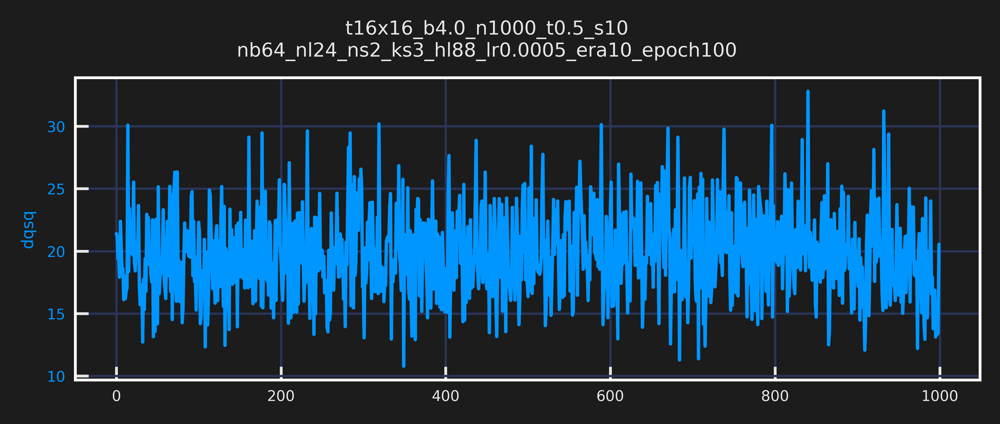

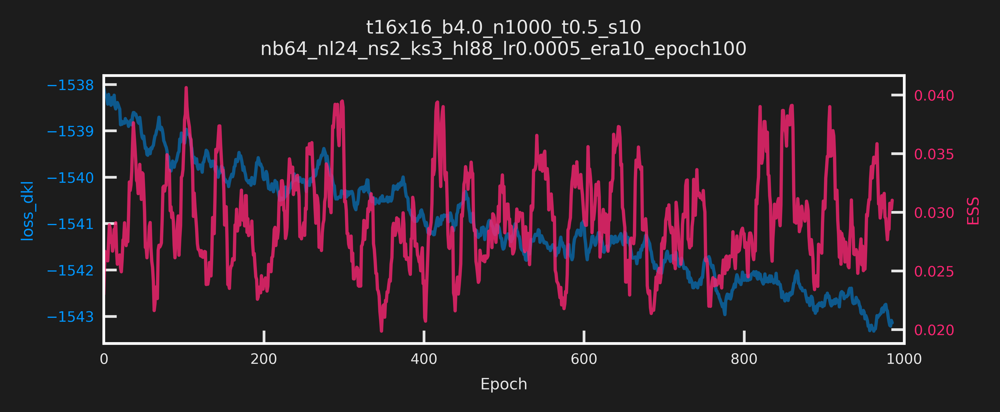

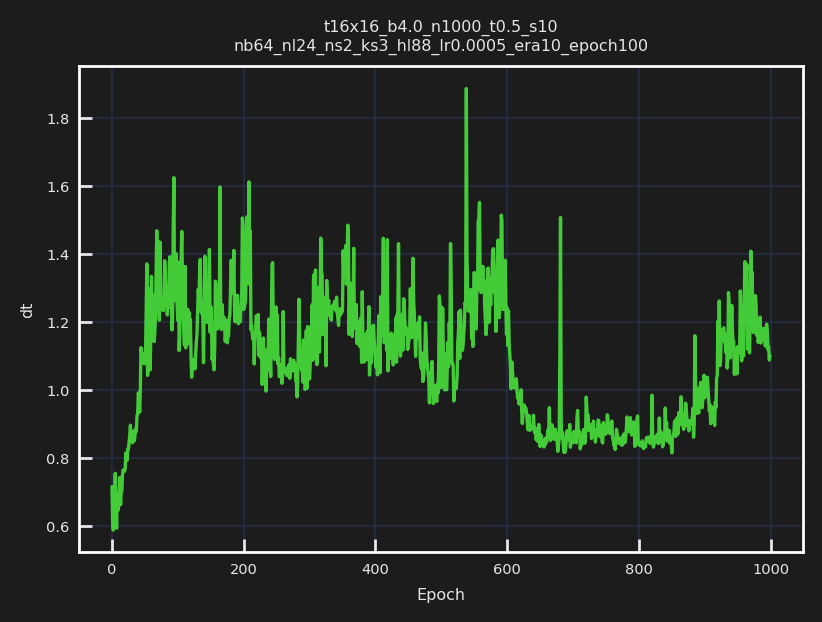

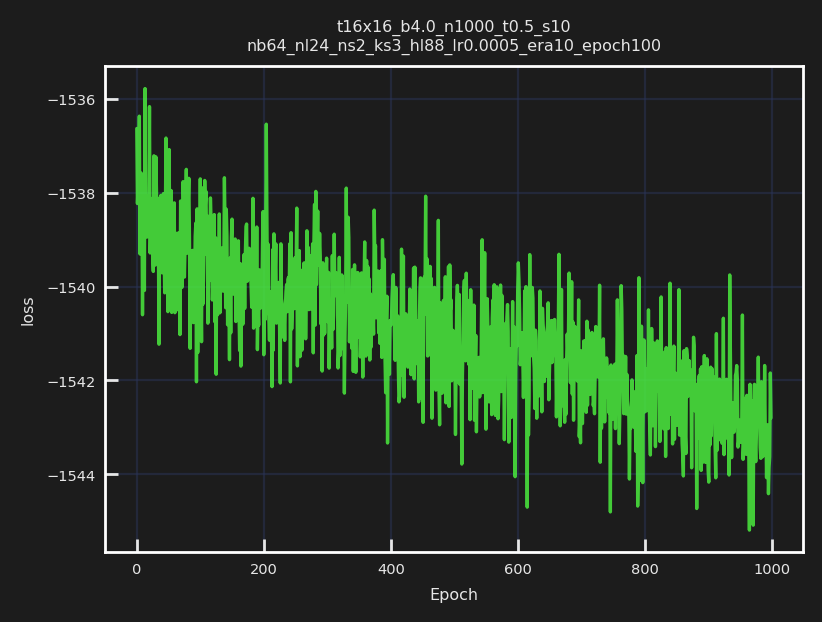

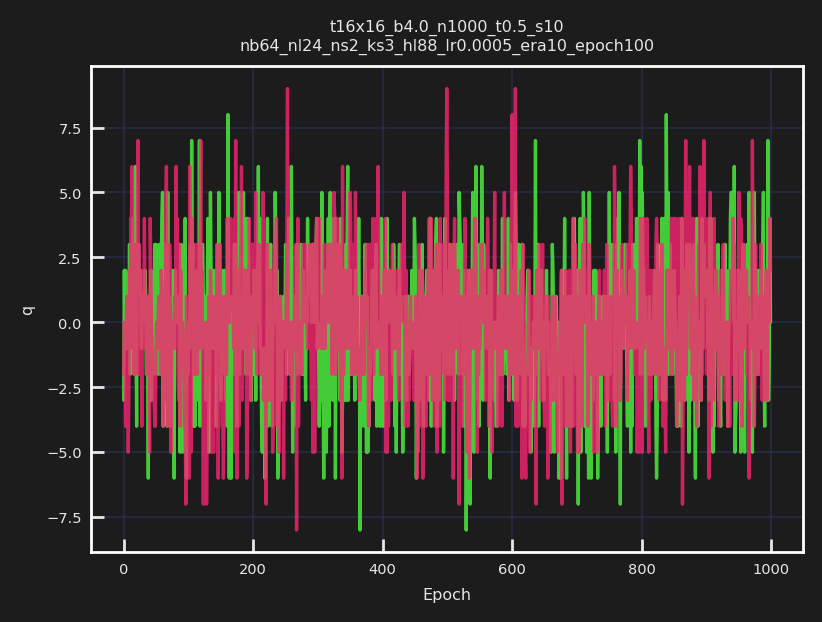

...

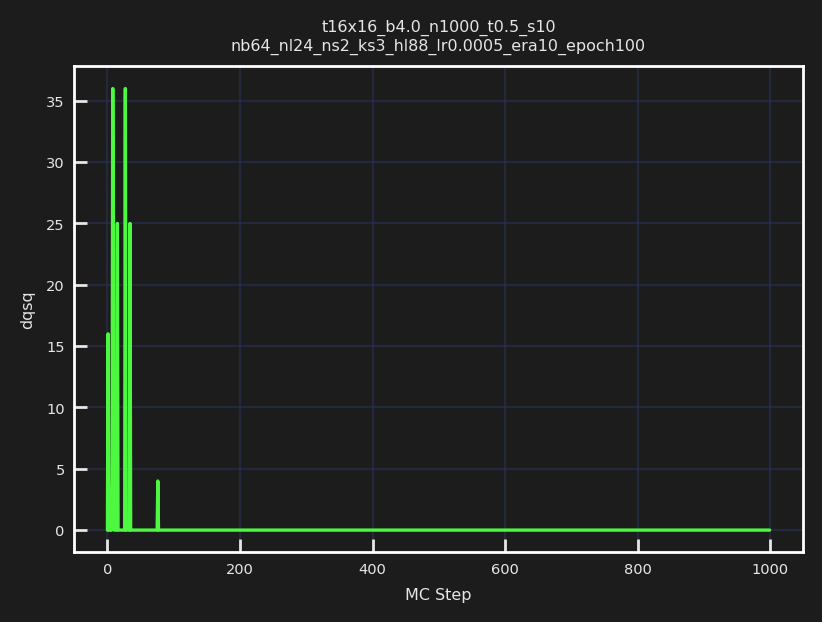

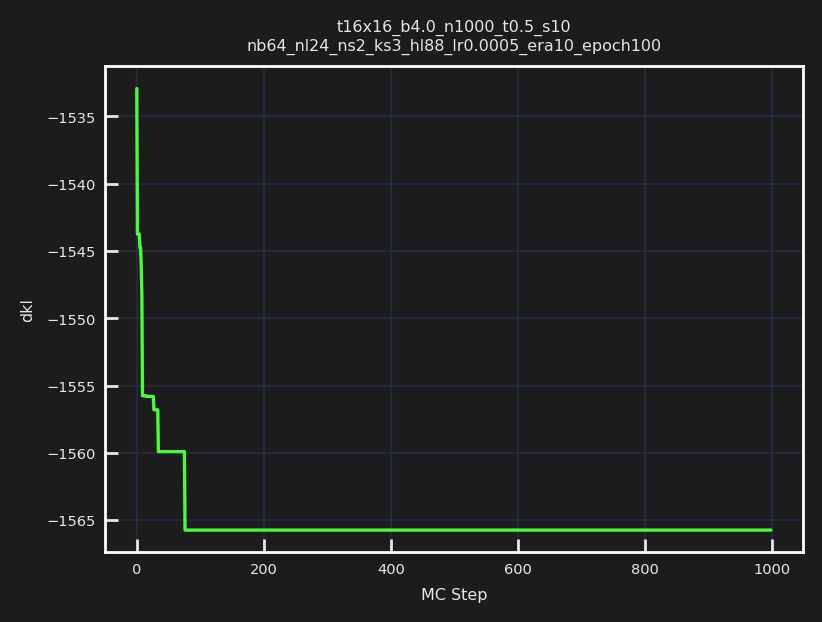

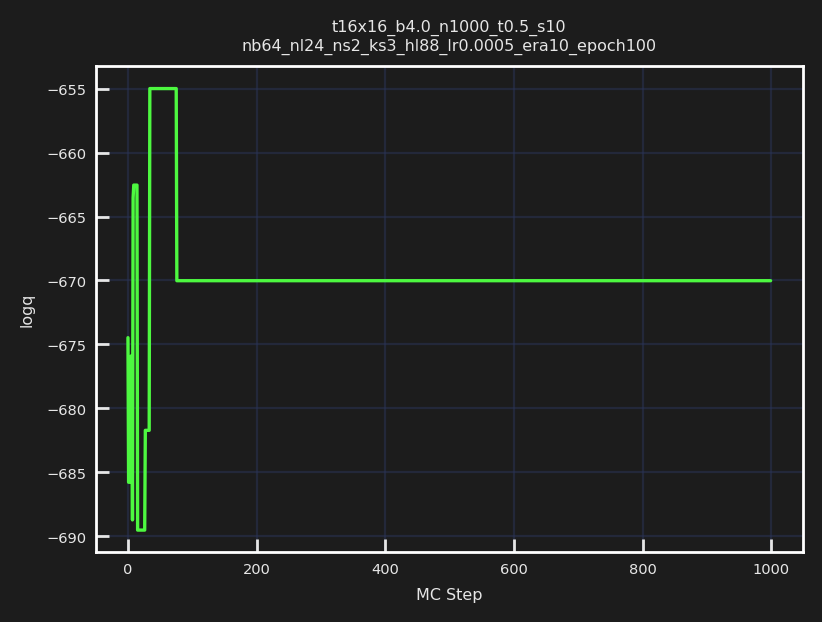

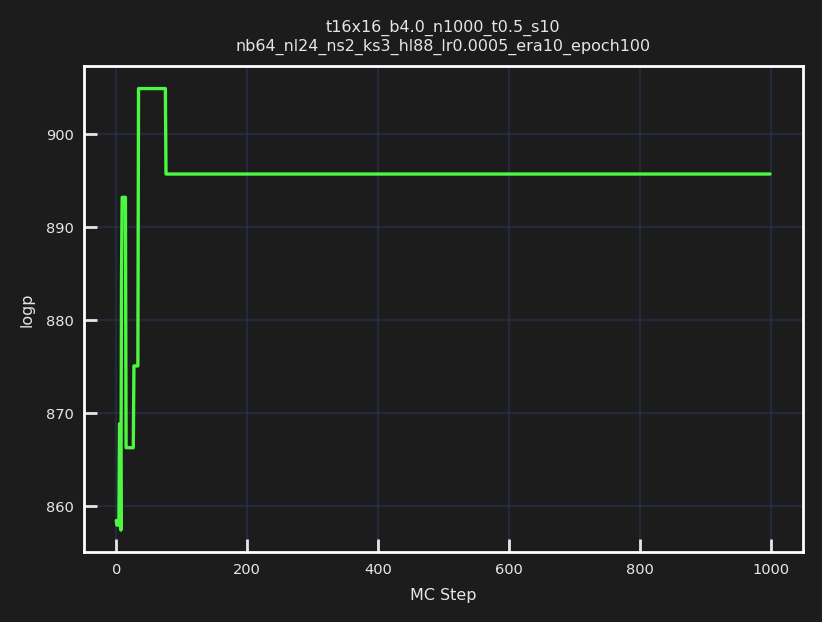

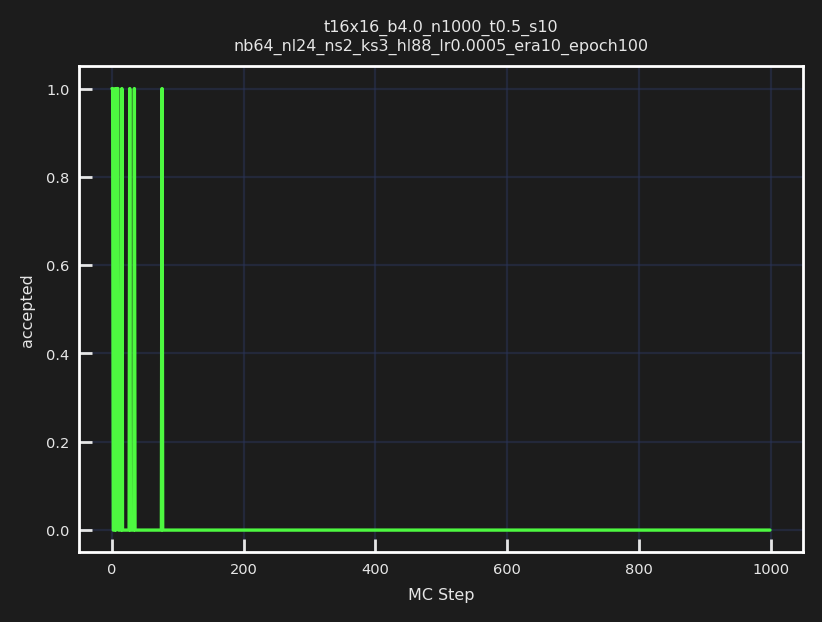

In [11]:
from dataclasses import asdict
from fthmc.train import train, transfer_to_new_lattice
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history
from fthmc.utils.samplers import make_mcmc_ensemble

layers = train_outputs['model']['layers']


xfr = transfer_to_new_lattice(L=16,
                              layers=layers,
                              param_init=param)
param16 = xfr['param']
model16 = xfr['model']

cfg_dict = asdict(train_config)
cfg_dict['base_lr'] = 0.0005
train_config16 = TrainConfig(**cfg_dict)

train_outputs16 = train(param16,
                       train_config16,
                       model=model16,
                       pre_model=None,
                       figsize=(5, 2))


action_fn16 = qed.BatchAction(param16.beta)
dirs16 = train_outputs16['dirs']
logdir16 = dirs16['logdir']

inf_dir16 = os.path.join(logdir16, 'inference')
inf_pdir16 = os.path.join(inf_dir16, 'plots')

history16 = make_mcmc_ensemble(model=train_outputs16['model'],
                              action_fn=action_fn16,
                              batch_size=train_config16.batch_size,
                              num_samples=1000)

plot_history(history=history16,
             param=param16,
             config=train_config16,
             skip=['epoch', 'x'],
             num_chains=4,
             therm_frac=0.0,
             xlabel='MC Step',
             outdir=inf_pdir16)

[00:47:46]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s10/plots

[00:47:46]  Param:                                                                           
            ----------------                                                                 
            beta=4.0                                                                         
            L=16                                                                             
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=1000                                                                       
            nrun=2                                                                           
            nprint=100                                                                       
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[16, 16]                                                                     
            nd=2                                                                             
            shape=[2, 16, 16]                                                                
            volume=256                                                                       
            dt=0.05

            action=1.000 plaq=0.000 charge=0.000

            dt=0.004 traj=2 accept=True dH=-0.472 expdH=1.603 dqsq=0.000 q=0 logp=936.716    
            plaq=0.915

            dt=0.004 traj=12 accept=True dH=-0.092 expdH=1.096 dqsq=0.000 q=0 logp=892.652   
            plaq=0.872

            dt=0.004 traj=22 accept=True dH=-0.079 expdH=1.082 dqsq=0.000 q=0 logp=890.978   
            plaq=0.870

            dt=0.003 traj=32 accept=True dH=0.124 expdH=0.883 dqsq=0.000 q=0 logp=883.950    
            plaq=0.863

            dt=0.004 traj=42 accept=True dH=0.126 expdH=0.881 dqsq=0.000 q=0 logp=881.921    
            plaq=0.861

            dt=0.004 traj=52 accept=True dH=-0.017 expdH=1.017 dqsq=0.000 q=0 logp=885.240   
            plaq=0.864

            dt=0.003 traj=62 accept=True dH=-0.128 expdH=1.136 dqsq=0.000 q=1 logp=891.454   
            plaq=0.871

            dt=0.003 traj=72 accept=True dH=0.140 expdH=0.869 dqsq=0.000 q=1 logp=886.983    
            plaq=0.866

            dt=0.003 traj=82 accept=True dH=0.031 expdH=0.970 dqsq=0.000 q=2 logp=887.360    
            plaq=0.867

[00:47:47]  dt=0.004 traj=92 accept=True dH=-0.179 expdH=1.196 dqsq=0.000 q=2 logp=881.294   
            plaq=0.861

            dt=0.004 traj=102 accept=True dH=0.083 expdH=0.920 dqsq=0.000 q=2 logp=881.968   
            plaq=0.861

            dt=0.003 traj=112 accept=True dH=-0.032 expdH=1.033 dqsq=0.000 q=2 logp=887.263  
            plaq=0.866

            dt=0.004 traj=122 accept=False dH=0.116 expdH=0.891 dqsq=0.000 q=1 logp=884.477  
            plaq=0.864

            dt=0.004 traj=132 accept=True dH=0.077 expdH=0.926 dqsq=0.000 q=2 logp=861.075   
            plaq=0.841

            dt=0.003 traj=142 accept=False dH=0.183 expdH=0.832 dqsq=0.000 q=2 logp=854.742  
            plaq=0.835

            dt=0.004 traj=152 accept=True dH=-0.048 expdH=1.049 dqsq=0.000 q=0 logp=888.254  
            plaq=0.867

            dt=0.003 traj=162 accept=True dH=0.018 expdH=0.982 dqsq=0.000 q=2 logp=873.581   
            plaq=0.853

            dt=0.003 traj=172 accept=True dH=-0.058 expdH=1.060 dqsq=0.000 q=1 logp=906.558  
            plaq=0.885

            dt=0.003 traj=182 accept=True dH=0.173 expdH=0.841 dqsq=0.000 q=2 logp=875.609   
            plaq=0.855

            dt=0.003 traj=192 accept=True dH=-0.060 expdH=1.062 dqsq=0.000 q=3 logp=884.875  
            plaq=0.864

            dt=0.004 traj=202 accept=True dH=0.002 expdH=0.998 dqsq=0.000 q=2 logp=884.279   
            plaq=0.864

            dt=0.004 traj=212 accept=True dH=-0.111 expdH=1.117 dqsq=0.000 q=2 logp=887.637  
            plaq=0.867

            dt=0.003 traj=222 accept=True dH=-0.076 expdH=1.079 dqsq=0.000 q=2 logp=885.509  
            plaq=0.865

            dt=0.004 traj=232 accept=True dH=0.090 expdH=0.914 dqsq=0.000 q=2 logp=893.316   
            plaq=0.872

            dt=0.003 traj=242 accept=True dH=0.034 expdH=0.966 dqsq=0.000 q=2 logp=860.545   
            plaq=0.840

            dt=0.003 traj=252 accept=True dH=-0.063 expdH=1.065 dqsq=0.000 q=0 logp=885.158  
            plaq=0.864

            dt=0.003 traj=262 accept=True dH=-0.030 expdH=1.031 dqsq=0.000 q=0 logp=863.892  
            plaq=0.844

            dt=0.003 traj=272 accept=True dH=0.013 expdH=0.987 dqsq=0.000 q=0 logp=881.793   
            plaq=0.861

            dt=0.003 traj=282 accept=True dH=0.066 expdH=0.936 dqsq=0.000 q=0 logp=881.968   
            plaq=0.861

            dt=0.004 traj=292 accept=True dH=0.191 expdH=0.826 dqsq=0.000 q=0 logp=895.687   
            plaq=0.875

[00:47:48]  dt=0.004 traj=302 accept=True dH=-0.068 expdH=1.070 dqsq=0.000 q=0 logp=884.119  
            plaq=0.863

            dt=0.003 traj=312 accept=True dH=0.052 expdH=0.949 dqsq=0.000 q=-1 logp=890.370  
            plaq=0.870

            dt=0.003 traj=322 accept=True dH=0.035 expdH=0.966 dqsq=0.000 q=0 logp=865.109   
            plaq=0.845

            dt=0.003 traj=332 accept=True dH=0.030 expdH=0.971 dqsq=0.000 q=0 logp=888.218   
            plaq=0.867

            dt=0.004 traj=342 accept=True dH=-0.208 expdH=1.231 dqsq=0.000 q=0 logp=894.852  
            plaq=0.874

            dt=0.004 traj=352 accept=True dH=0.018 expdH=0.982 dqsq=0.000 q=0 logp=867.829   
            plaq=0.847

            dt=0.004 traj=362 accept=True dH=-0.129 expdH=1.138 dqsq=0.000 q=0 logp=908.125  
            plaq=0.887

            dt=0.004 traj=372 accept=True dH=0.079 expdH=0.924 dqsq=0.000 q=0 logp=875.082   
            plaq=0.855

            dt=0.003 traj=382 accept=True dH=0.052 expdH=0.949 dqsq=0.000 q=0 logp=886.867   
            plaq=0.866

            dt=0.003 traj=392 accept=True dH=-0.087 expdH=1.091 dqsq=0.000 q=0 logp=881.557  
            plaq=0.861

            dt=0.004 traj=402 accept=True dH=0.044 expdH=0.956 dqsq=0.000 q=0 logp=884.940   
            plaq=0.864

            dt=0.003 traj=412 accept=False dH=0.077 expdH=0.926 dqsq=0.000 q=0 logp=897.328  
            plaq=0.876

            dt=0.004 traj=422 accept=True dH=0.006 expdH=0.994 dqsq=0.000 q=0 logp=887.433   
            plaq=0.867

            dt=0.003 traj=432 accept=True dH=-0.026 expdH=1.026 dqsq=0.000 q=-1 logp=898.041 
            plaq=0.877

            dt=0.003 traj=442 accept=True dH=0.165 expdH=0.848 dqsq=0.000 q=0 logp=861.056   
            plaq=0.841

            dt=0.003 traj=452 accept=True dH=-0.093 expdH=1.097 dqsq=0.000 q=1 logp=890.407  
            plaq=0.870

            dt=0.003 traj=462 accept=True dH=0.107 expdH=0.899 dqsq=0.000 q=0 logp=889.371   
            plaq=0.869

            dt=0.003 traj=472 accept=True dH=0.185 expdH=0.831 dqsq=0.000 q=1 logp=880.615   
            plaq=0.860

            dt=0.003 traj=482 accept=True dH=-0.050 expdH=1.052 dqsq=0.000 q=1 logp=897.392  
            plaq=0.876

            dt=0.003 traj=492 accept=True dH=-0.264 expdH=1.302 dqsq=0.000 q=2 logp=896.923  
            plaq=0.876

            dt=0.003 traj=502 accept=True dH=-0.033 expdH=1.033 dqsq=0.000 q=1 logp=899.812  
            plaq=0.879

[00:47:49]  dt=0.003 traj=512 accept=True dH=0.013 expdH=0.987 dqsq=0.000 q=1 logp=875.815   
            plaq=0.855

            dt=0.003 traj=522 accept=True dH=0.099 expdH=0.906 dqsq=0.000 q=2 logp=881.126   
            plaq=0.860

            dt=0.003 traj=532 accept=True dH=0.050 expdH=0.951 dqsq=0.000 q=2 logp=893.417   
            plaq=0.872

            dt=0.003 traj=542 accept=True dH=0.132 expdH=0.876 dqsq=0.000 q=1 logp=863.697   
            plaq=0.843

            dt=0.003 traj=552 accept=True dH=-0.157 expdH=1.170 dqsq=0.000 q=1 logp=899.730  
            plaq=0.879

            dt=0.004 traj=562 accept=True dH=0.018 expdH=0.982 dqsq=0.000 q=0 logp=882.013   
            plaq=0.861

            dt=0.003 traj=572 accept=True dH=0.049 expdH=0.952 dqsq=0.000 q=1 logp=881.064   
            plaq=0.860

            dt=0.003 traj=582 accept=False dH=0.088 expdH=0.915 dqsq=0.000 q=0 logp=876.565  
            plaq=0.856

            dt=0.004 traj=592 accept=True dH=-0.090 expdH=1.094 dqsq=0.000 q=0 logp=874.060  
            plaq=0.854

            dt=0.003 traj=602 accept=True dH=0.034 expdH=0.967 dqsq=0.000 q=0 logp=885.957   
            plaq=0.865

            dt=0.003 traj=612 accept=True dH=0.012 expdH=0.988 dqsq=0.000 q=0 logp=864.757   
            plaq=0.844

            dt=0.004 traj=622 accept=True dH=0.040 expdH=0.961 dqsq=0.000 q=0 logp=887.520   
            plaq=0.867

            dt=0.004 traj=632 accept=True dH=-0.066 expdH=1.068 dqsq=0.000 q=-1 logp=883.118 
            plaq=0.862

            dt=0.003 traj=642 accept=True dH=0.109 expdH=0.897 dqsq=0.000 q=-1 logp=875.999  
            plaq=0.855

            dt=0.004 traj=652 accept=True dH=0.097 expdH=0.907 dqsq=0.000 q=-1 logp=875.660  
            plaq=0.855

            dt=0.004 traj=662 accept=True dH=0.037 expdH=0.964 dqsq=0.000 q=0 logp=888.817   
            plaq=0.868

            dt=0.003 traj=672 accept=True dH=0.066 expdH=0.937 dqsq=0.000 q=-1 logp=869.555  
            plaq=0.849

            dt=0.003 traj=682 accept=True dH=-0.039 expdH=1.040 dqsq=0.000 q=0 logp=895.557  
            plaq=0.875

            dt=0.004 traj=692 accept=True dH=-0.104 expdH=1.110 dqsq=0.000 q=1 logp=872.525  
            plaq=0.852

            dt=0.003 traj=702 accept=True dH=0.041 expdH=0.960 dqsq=0.000 q=0 logp=869.799   
            plaq=0.849

            dt=0.003 traj=712 accept=True dH=-0.008 expdH=1.009 dqsq=0.000 q=0 logp=896.513  
            plaq=0.876

            dt=0.003 traj=722 accept=True dH=-0.075 expdH=1.078 dqsq=0.000 q=0 logp=905.527  
            plaq=0.884

[00:47:50]  dt=0.003 traj=732 accept=True dH=-0.055 expdH=1.056 dqsq=0.000 q=-1 logp=878.471 
            plaq=0.858

            dt=0.003 traj=742 accept=True dH=-0.051 expdH=1.052 dqsq=0.000 q=0 logp=879.621  
            plaq=0.859

            dt=0.003 traj=752 accept=True dH=0.056 expdH=0.945 dqsq=0.000 q=0 logp=874.142   
            plaq=0.854

            dt=0.003 traj=762 accept=True dH=0.208 expdH=0.812 dqsq=0.000 q=0 logp=870.569   
            plaq=0.850

            dt=0.003 traj=772 accept=True dH=0.105 expdH=0.900 dqsq=0.000 q=0 logp=888.550   
            plaq=0.868

            dt=0.003 traj=782 accept=True dH=-0.000 expdH=1.000 dqsq=0.000 q=-1 logp=879.164 
            plaq=0.859

            dt=0.003 traj=792 accept=True dH=-0.020 expdH=1.020 dqsq=0.000 q=-1 logp=877.360 
            plaq=0.857

            dt=0.003 traj=802 accept=True dH=0.086 expdH=0.918 dqsq=0.000 q=-2 logp=880.531  
            plaq=0.860

            dt=0.003 traj=812 accept=True dH=0.025 expdH=0.976 dqsq=0.000 q=-1 logp=869.949  
            plaq=0.850

            dt=0.003 traj=822 accept=True dH=-0.068 expdH=1.070 dqsq=0.000 q=0 logp=886.146  
            plaq=0.865

            dt=0.003 traj=832 accept=True dH=0.081 expdH=0.922 dqsq=0.000 q=0 logp=887.789   
            plaq=0.867

            dt=0.003 traj=842 accept=True dH=0.055 expdH=0.946 dqsq=0.000 q=0 logp=878.480   
            plaq=0.858

            dt=0.003 traj=852 accept=True dH=-0.049 expdH=1.051 dqsq=0.000 q=0 logp=897.705  
            plaq=0.877

            dt=0.004 traj=862 accept=True dH=-0.213 expdH=1.237 dqsq=0.000 q=0 logp=906.692  
            plaq=0.885

            dt=0.003 traj=872 accept=True dH=0.040 expdH=0.961 dqsq=0.000 q=0 logp=893.143   
            plaq=0.872

            dt=0.003 traj=882 accept=True dH=-0.075 expdH=1.078 dqsq=0.000 q=1 logp=881.445  
            plaq=0.861

            dt=0.003 traj=892 accept=True dH=-0.107 expdH=1.113 dqsq=0.000 q=0 logp=878.408  
            plaq=0.858

            dt=0.004 traj=902 accept=True dH=0.028 expdH=0.973 dqsq=0.000 q=0 logp=890.782   
            plaq=0.870

            dt=0.003 traj=912 accept=True dH=0.023 expdH=0.977 dqsq=0.000 q=0 logp=884.471   
            plaq=0.864

            dt=0.003 traj=922 accept=True dH=-0.043 expdH=1.044 dqsq=0.000 q=0 logp=878.007  
            plaq=0.857

            dt=0.003 traj=932 accept=True dH=-0.020 expdH=1.020 dqsq=0.000 q=0 logp=890.145  
            plaq=0.869

            dt=0.003 traj=942 accept=False dH=0.051 expdH=0.950 dqsq=0.000 q=0 logp=877.509  
            plaq=0.857

[00:47:51]  dt=0.003 traj=952 accept=True dH=-0.008 expdH=1.008 dqsq=0.000 q=1 logp=885.269  
            plaq=0.865

            dt=0.003 traj=962 accept=True dH=-0.005 expdH=1.005 dqsq=0.000 q=0 logp=911.087  
            plaq=0.890

            dt=0.003 traj=972 accept=False dH=0.322 expdH=0.725 dqsq=0.000 q=1 logp=864.543  
            plaq=0.844

            dt=0.004 traj=982 accept=True dH=0.018 expdH=0.982 dqsq=0.000 q=1 logp=886.082   
            plaq=0.865

            dt=0.003 traj=992 accept=True dH=-0.000 expdH=1.000 dqsq=0.000 q=1 logp=870.289  
            plaq=0.850

[00:47:51]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s10/plots/run0

[00:47:51]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run0/dt.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run0/traj.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run0/accept.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run0/dH.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run0/expdH.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:108: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  metric = np.array(metric)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:108: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run0/dqsq.pdf

[00:47:52]  Saving figure to:                                                                
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s10/plots/run0/q.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run0/logp.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run0/plaq.pdf

[00:47:52]  dt=0.003 traj=1002 accept=True dH=0.041 expdH=0.960 dqsq=0.000 q=1 logp=877.411  
            plaq=0.857

            dt=0.003 traj=1012 accept=True dH=0.063 expdH=0.939 dqsq=0.000 q=1 logp=870.981  
            plaq=0.851

            dt=0.004 traj=1022 accept=True dH=-0.102 expdH=1.107 dqsq=0.000 q=1 logp=886.164 
            plaq=0.865

            dt=0.003 traj=1032 accept=True dH=-0.128 expdH=1.136 dqsq=0.000 q=0 logp=877.565 
            plaq=0.857

            dt=0.003 traj=1042 accept=True dH=0.091 expdH=0.913 dqsq=0.000 q=0 logp=883.314  
            plaq=0.863

            dt=0.003 traj=1052 accept=True dH=0.127 expdH=0.881 dqsq=0.000 q=0 logp=882.593  
            plaq=0.862

            dt=0.003 traj=1062 accept=True dH=-0.173 expdH=1.189 dqsq=0.000 q=0 logp=896.681 
            plaq=0.876

            dt=0.004 traj=1072 accept=True dH=-0.000 expdH=1.000 dqsq=0.000 q=0 logp=891.602 
            plaq=0.871

            dt=0.004 traj=1082 accept=True dH=-0.203 expdH=1.224 dqsq=0.000 q=0 logp=884.286 
            plaq=0.864

            dt=0.003 traj=1092 accept=False dH=0.174 expdH=0.840 dqsq=0.000 q=0 logp=870.199 
            plaq=0.850

            dt=0.003 traj=1102 accept=True dH=0.076 expdH=0.927 dqsq=0.000 q=0 logp=897.474  
            plaq=0.876

            dt=0.003 traj=1112 accept=True dH=-0.065 expdH=1.067 dqsq=0.000 q=0 logp=895.499 
            plaq=0.875

[00:47:53]  dt=0.003 traj=1122 accept=True dH=-0.136 expdH=1.145 dqsq=0.000 q=0 logp=886.175 
            plaq=0.865

            dt=0.004 traj=1132 accept=True dH=0.023 expdH=0.977 dqsq=0.000 q=0 logp=880.725  
            plaq=0.860

            dt=0.003 traj=1142 accept=True dH=-0.119 expdH=1.127 dqsq=0.000 q=0 logp=883.778 
            plaq=0.863

            dt=0.003 traj=1152 accept=True dH=-0.081 expdH=1.084 dqsq=0.000 q=0 logp=890.762 
            plaq=0.870

            dt=0.004 traj=1162 accept=True dH=-0.024 expdH=1.024 dqsq=0.000 q=0 logp=896.835 
            plaq=0.876

            dt=0.004 traj=1172 accept=True dH=-0.119 expdH=1.126 dqsq=0.000 q=0 logp=888.090 
            plaq=0.867

            dt=0.003 traj=1182 accept=True dH=-0.103 expdH=1.108 dqsq=0.000 q=0 logp=889.449 
            plaq=0.869

            dt=0.003 traj=1192 accept=True dH=0.354 expdH=0.702 dqsq=0.000 q=0 logp=856.082  
            plaq=0.836

            dt=0.003 traj=1202 accept=True dH=0.193 expdH=0.824 dqsq=0.000 q=0 logp=874.982  
            plaq=0.854

            dt=0.003 traj=1212 accept=True dH=-0.005 expdH=1.005 dqsq=0.000 q=0 logp=875.777 
            plaq=0.855

            dt=0.003 traj=1222 accept=False dH=0.208 expdH=0.812 dqsq=0.000 q=0 logp=904.974 
            plaq=0.884

            dt=0.003 traj=1232 accept=True dH=0.001 expdH=0.999 dqsq=0.000 q=0 logp=886.273  
            plaq=0.866

            dt=0.003 traj=1242 accept=True dH=0.112 expdH=0.894 dqsq=0.000 q=1 logp=888.206  
            plaq=0.867

            dt=0.004 traj=1252 accept=True dH=0.021 expdH=0.979 dqsq=0.000 q=0 logp=875.022  
            plaq=0.855

            dt=0.003 traj=1262 accept=True dH=0.054 expdH=0.947 dqsq=0.000 q=0 logp=884.353  
            plaq=0.864

            dt=0.003 traj=1272 accept=True dH=-0.075 expdH=1.078 dqsq=0.000 q=0 logp=868.717 
            plaq=0.848

            dt=0.003 traj=1282 accept=True dH=-0.060 expdH=1.062 dqsq=0.000 q=1 logp=903.892 
            plaq=0.883

            dt=0.003 traj=1292 accept=True dH=-0.009 expdH=1.009 dqsq=0.000 q=1 logp=884.700 
            plaq=0.864

            dt=0.003 traj=1302 accept=True dH=0.009 expdH=0.991 dqsq=0.000 q=0 logp=874.560  
            plaq=0.854

            dt=0.003 traj=1312 accept=True dH=-0.017 expdH=1.017 dqsq=0.000 q=1 logp=869.951 
            plaq=0.850

            dt=0.004 traj=1322 accept=True dH=0.092 expdH=0.912 dqsq=0.000 q=2 logp=892.698  
            plaq=0.872

            dt=0.004 traj=1332 accept=True dH=-0.132 expdH=1.141 dqsq=0.000 q=2 logp=896.208 
            plaq=0.875

[00:47:54]  dt=0.003 traj=1342 accept=True dH=0.150 expdH=0.861 dqsq=0.000 q=1 logp=870.159  
            plaq=0.850

            dt=0.004 traj=1352 accept=True dH=-0.029 expdH=1.030 dqsq=0.000 q=2 logp=862.168 
            plaq=0.842

            dt=0.003 traj=1362 accept=True dH=-0.015 expdH=1.015 dqsq=0.000 q=1 logp=872.338 
            plaq=0.852

            dt=0.003 traj=1372 accept=True dH=0.008 expdH=0.992 dqsq=0.000 q=0 logp=906.281  
            plaq=0.885

            dt=0.003 traj=1382 accept=True dH=-0.053 expdH=1.055 dqsq=0.000 q=0 logp=891.913 
            plaq=0.871

            dt=0.003 traj=1392 accept=True dH=-0.024 expdH=1.024 dqsq=0.000 q=1 logp=903.560 
            plaq=0.882

            dt=0.004 traj=1402 accept=True dH=0.181 expdH=0.834 dqsq=0.000 q=0 logp=875.383  
            plaq=0.855

            dt=0.003 traj=1412 accept=True dH=-0.037 expdH=1.037 dqsq=0.000 q=0 logp=886.504 
            plaq=0.866

            dt=0.003 traj=1422 accept=True dH=0.038 expdH=0.963 dqsq=0.000 q=0 logp=877.539  
            plaq=0.857

            dt=0.003 traj=1432 accept=True dH=-0.050 expdH=1.051 dqsq=0.000 q=1 logp=905.356 
            plaq=0.884

            dt=0.003 traj=1442 accept=True dH=-0.097 expdH=1.102 dqsq=0.000 q=1 logp=895.101 
            plaq=0.874

            dt=0.003 traj=1452 accept=True dH=0.098 expdH=0.906 dqsq=0.000 q=1 logp=893.415  
            plaq=0.872

            dt=0.003 traj=1462 accept=True dH=0.089 expdH=0.914 dqsq=0.000 q=1 logp=882.164  
            plaq=0.861

            dt=0.003 traj=1472 accept=True dH=-0.023 expdH=1.023 dqsq=0.000 q=0 logp=873.655 
            plaq=0.853

            dt=0.003 traj=1482 accept=True dH=-0.070 expdH=1.073 dqsq=0.000 q=0 logp=884.804 
            plaq=0.864

            dt=0.003 traj=1492 accept=True dH=-0.219 expdH=1.244 dqsq=0.000 q=0 logp=894.232 
            plaq=0.873

            dt=0.003 traj=1502 accept=True dH=-0.051 expdH=1.053 dqsq=0.000 q=0 logp=872.976 
            plaq=0.853

            dt=0.003 traj=1512 accept=True dH=-0.131 expdH=1.140 dqsq=0.000 q=0 logp=909.345 
            plaq=0.888

            dt=0.003 traj=1522 accept=True dH=-0.042 expdH=1.043 dqsq=0.000 q=-1 logp=899.842
            plaq=0.879

            dt=0.003 traj=1532 accept=True dH=0.089 expdH=0.915 dqsq=0.000 q=0 logp=878.278  
            plaq=0.858

            dt=0.003 traj=1542 accept=True dH=0.065 expdH=0.938 dqsq=0.000 q=0 logp=896.520  
            plaq=0.876

            dt=0.003 traj=1552 accept=True dH=-0.064 expdH=1.067 dqsq=0.000 q=0 logp=897.758 
            plaq=0.877

            dt=0.003 traj=1562 accept=True dH=0.060 expdH=0.942 dqsq=0.000 q=0 logp=884.618  
            plaq=0.864

[00:47:55]  dt=0.003 traj=1572 accept=True dH=0.014 expdH=0.986 dqsq=0.000 q=1 logp=872.061  
            plaq=0.852

            dt=0.003 traj=1582 accept=True dH=0.032 expdH=0.968 dqsq=0.000 q=2 logp=875.580  
            plaq=0.855

            dt=0.004 traj=1592 accept=True dH=-0.271 expdH=1.312 dqsq=0.000 q=2 logp=876.842 
            plaq=0.856

            dt=0.003 traj=1602 accept=True dH=-0.074 expdH=1.077 dqsq=0.000 q=1 logp=882.359 
            plaq=0.862

            dt=0.003 traj=1612 accept=True dH=-0.152 expdH=1.164 dqsq=0.000 q=2 logp=900.522 
            plaq=0.879

            dt=0.003 traj=1622 accept=True dH=-0.134 expdH=1.143 dqsq=0.000 q=1 logp=882.050 
            plaq=0.861

            dt=0.003 traj=1632 accept=True dH=-0.077 expdH=1.080 dqsq=0.000 q=2 logp=896.739 
            plaq=0.876

            dt=0.003 traj=1642 accept=True dH=-0.197 expdH=1.218 dqsq=0.000 q=2 logp=900.144 
            plaq=0.879

            dt=0.003 traj=1652 accept=True dH=-0.013 expdH=1.013 dqsq=0.000 q=1 logp=898.261 
            plaq=0.877

            dt=0.003 traj=1662 accept=True dH=0.046 expdH=0.955 dqsq=0.000 q=0 logp=890.513  
            plaq=0.870

            dt=0.003 traj=1672 accept=True dH=0.102 expdH=0.903 dqsq=0.000 q=0 logp=855.662  
            plaq=0.836

            dt=0.003 traj=1682 accept=True dH=0.012 expdH=0.989 dqsq=0.000 q=0 logp=879.131  
            plaq=0.859

            dt=0.003 traj=1692 accept=True dH=0.006 expdH=0.994 dqsq=0.000 q=0 logp=895.454  
            plaq=0.874

            dt=0.003 traj=1702 accept=False dH=0.159 expdH=0.853 dqsq=0.000 q=0 logp=886.971 
            plaq=0.866

            dt=0.003 traj=1712 accept=True dH=-0.066 expdH=1.068 dqsq=0.000 q=1 logp=889.346 
            plaq=0.869

            dt=0.003 traj=1722 accept=True dH=-0.066 expdH=1.068 dqsq=0.000 q=0 logp=886.248 
            plaq=0.865

            dt=0.003 traj=1732 accept=True dH=0.164 expdH=0.849 dqsq=0.000 q=1 logp=862.971  
            plaq=0.843

            dt=0.004 traj=1742 accept=True dH=-0.144 expdH=1.155 dqsq=0.000 q=0 logp=897.195 
            plaq=0.876

            dt=0.003 traj=1752 accept=True dH=-0.019 expdH=1.019 dqsq=0.000 q=0 logp=887.901 
            plaq=0.867

            dt=0.003 traj=1762 accept=True dH=-0.039 expdH=1.040 dqsq=0.000 q=0 logp=876.761 
            plaq=0.856

            dt=0.003 traj=1772 accept=True dH=0.065 expdH=0.937 dqsq=0.000 q=1 logp=886.183  
            plaq=0.865

            dt=0.003 traj=1782 accept=True dH=-0.039 expdH=1.040 dqsq=0.000 q=0 logp=898.622 
            plaq=0.878

            dt=0.003 traj=1792 accept=True dH=-0.147 expdH=1.159 dqsq=0.000 q=0 logp=898.001 
            plaq=0.877

[00:47:56]  dt=0.003 traj=1802 accept=True dH=-0.043 expdH=1.044 dqsq=0.000 q=0 logp=894.169 
            plaq=0.873

            dt=0.003 traj=1812 accept=True dH=0.039 expdH=0.962 dqsq=0.000 q=0 logp=869.892  
            plaq=0.850

            dt=0.003 traj=1822 accept=True dH=-0.130 expdH=1.139 dqsq=0.000 q=0 logp=862.361 
            plaq=0.842

            dt=0.004 traj=1832 accept=False dH=0.069 expdH=0.933 dqsq=0.000 q=2 logp=866.761 
            plaq=0.846

            dt=0.003 traj=1842 accept=True dH=-0.135 expdH=1.144 dqsq=0.000 q=2 logp=865.384 
            plaq=0.845

            dt=0.003 traj=1852 accept=True dH=0.066 expdH=0.936 dqsq=0.000 q=0 logp=890.082  
            plaq=0.869

            dt=0.003 traj=1862 accept=True dH=0.213 expdH=0.808 dqsq=0.000 q=0 logp=844.485  
            plaq=0.825

            dt=0.003 traj=1872 accept=True dH=-0.013 expdH=1.013 dqsq=0.000 q=0 logp=883.558 
            plaq=0.863

            dt=0.004 traj=1882 accept=True dH=-0.237 expdH=1.267 dqsq=0.000 q=0 logp=894.961 
            plaq=0.874

            dt=0.003 traj=1892 accept=True dH=-0.219 expdH=1.245 dqsq=0.000 q=0 logp=890.606 
            plaq=0.870

            dt=0.003 traj=1902 accept=True dH=-0.124 expdH=1.132 dqsq=0.000 q=0 logp=890.792 
            plaq=0.870

            dt=0.003 traj=1912 accept=True dH=-0.059 expdH=1.061 dqsq=0.000 q=0 logp=891.858 
            plaq=0.871

            dt=0.003 traj=1922 accept=True dH=0.055 expdH=0.946 dqsq=0.000 q=0 logp=883.870  
            plaq=0.863

            dt=0.003 traj=1932 accept=True dH=0.141 expdH=0.868 dqsq=0.000 q=0 logp=878.285  
            plaq=0.858

            dt=0.003 traj=1942 accept=True dH=-0.138 expdH=1.148 dqsq=0.000 q=0 logp=889.543 
            plaq=0.869

            dt=0.003 traj=1952 accept=True dH=0.237 expdH=0.789 dqsq=0.000 q=1 logp=869.042  
            plaq=0.849

            dt=0.004 traj=1962 accept=True dH=-0.196 expdH=1.217 dqsq=0.000 q=1 logp=898.991 
            plaq=0.878

            dt=0.003 traj=1972 accept=True dH=0.084 expdH=0.920 dqsq=0.000 q=1 logp=885.777  
            plaq=0.865

            dt=0.003 traj=1982 accept=True dH=-0.091 expdH=1.096 dqsq=0.000 q=1 logp=889.598 
            plaq=0.869

[00:47:57]  dt=0.003 traj=1992 accept=True dH=0.262 expdH=0.770 dqsq=0.000 q=-1 logp=855.103 
            plaq=0.835

[00:47:57]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s10/plots/run1

[00:47:57]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run1/dt.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run1/traj.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run1/accept.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run1/dH.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run1/expdH.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:108: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  metric = np.array(metric)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:108: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  metric = np.array(metric)


            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run1/dqsq.pdf

            Saving figure to:                                                                
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s10/plots/run1/q.pdf

[00:47:58]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run1/logp.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s1
            0/plots/run1/plaq.pdf

[00:47:58]  Run times: [array([0.004279, 0.00353 , 0.004319, 0.003765, 0.003599, 0.003553,   
                   0.004122, 0.003525, 0.003441, 0.003721, 0.003629, 0.003537,               
                   0.004252, 0.003309, 0.003505, 0.003687, 0.003557, 0.003731,               
                   0.003606, 0.003527, 0.003529, 0.003971, 0.003922, 0.003074,               
                   0.00305 , 0.003066, 0.003222, 0.003373, 0.003373, 0.003071,               
                   0.003088, 0.003083, 0.003865, 0.003531, 0.003541, 0.003455,               
                   0.003396, 0.00369 , 0.003416, 0.003654, 0.003433, 0.003699,               
                   0.00409 , 0.003649, 0.003813, 0.003786, 0.003521, 0.003556,               
                   0.003574, 0.003871, 0.003556, 0.003538, 0.004181, 0.003542,               
                   0.00364 , 0.003507, 0.003476, 0.003498, 0.003467, 0.00349 ,               
                   0.003483, 0.003459, 0.004367, 0.003523, 0.003866, 0.003675,               
                   0.00362 , 0.003495, 0.003664, 0.003482, 0.003309, 0.003187,               
                   0.003677, 0.003317, 0.00335 , 0.003523, 0.003617, 0.003418,               
                   0.003494, 0.003367, 0.003427, 0.003414, 0.00414 , 0.003462,               
                   0.00349 , 0.003479, 0.003528, 0.003506, 0.003696, 0.003577,               
                   0.003568, 0.00353 , 0.004636, 0.004136, 0.003647, 0.003494,               
                   0.003729, 0.003867, 0.003643, 0.003528, 0.003339, 0.00355 ,               
                   0.003826, 0.004351, 0.003719, 0.003261, 0.004014, 0.004953,               
                   0.003624, 0.003094, 0.003275, 0.003469, 0.003901, 0.003348,               
                   0.00304 , 0.003141, 0.003305, 0.003284, 0.00351 , 0.003562,               
                   0.003642, 0.003507, 0.004162, 0.00367 , 0.003522, 0.003482,               
                   0.003354, 0.003357, 0.003343, 0.003374, 0.003387, 0.003571,               
                   0.004269, 0.003898, 0.003691, 0.003941, 0.004905, 0.004143,               
                   0.004418, 0.003591, 0.003434, 0.003331, 0.004512, 0.004104,               
                   0.004143, 0.003681, 0.003807, 0.003696, 0.003433, 0.003209,               
                   0.003658, 0.003743, 0.004032, 0.003787, 0.004047, 0.003682,               
                   0.003423, 0.003465, 0.00323 , 0.003296, 0.00332 , 0.00341 ,               
                   0.004024, 0.003071, 0.003063, 0.003891, 0.003286, 0.003475,               
                   0.003194, 0.00367 , 0.003664, 0.003122, 0.00508 , 0.003377,               
                   0.003505, 0.005016, 0.005121, 0.004847, 0.004293, 0.004952,               
                   0.003788, 0.003435, 0.003592, 0.003083, 0.002916, 0.002934,               
                   0.003122, 0.003254, 0.002938, 0.002933, 0.002968, 0.003232,               
                   0.00515 , 0.003637, 0.003686, 0.003899, 0.004297, 0.003728,               
                   0.003702, 0.003605, 0.003114, 0.003518, 0.004878, 0.003756,               
                   0.003234, 0.00344 , 0.00324 , 0.004506, 0.004349, 0.00365 ,               
                   0.003511, 0.004168, 0.00389 , 0.00325 , 0.002982, 0.002985,               
                   0.002998, 0.003014, 0.003097, 0.003154, 0.003126, 0.003195,               
                   0.004255, 0.003955, 0.003503, 0.003459, 0.003694, 0.003631,               
                   0.003471, 0.003751, 0.003459, 0.003772, 0.004175, 0.003549,               
                   0.003687, 0.003489, 0.0035  , 0.003513, 0.003692, 0.003428,               
                   0.003365, 0.003424, 0.004693, 0.003552, 0.00355 , 0.003865,               
                   0.003537, 0.003473, 0.003578, 0.003511, 0.003438, 0.003402,               
                   0.004254, 0.003847, 0.003587, 0.0

            Per trajectory: [array([4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,  
            4.e-06,                                                                          
                   3.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 3.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 3.e-06,           
                   3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 3.e-06, 3.e-06, 4.e-06, 3.e-06, 4.e-06,           
                   3.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 3.e-06, 4.e-06, 3.e-06, 3.e-06, 3.e-06,           
                   4.e-06, 3.e-06, 3.e-06, 4.e-06, 4.e-06, 3.e-06, 3.e-06, 3.e-06,           
                   3.e-06, 3.e-06, 4.e-06, 3.e-06, 3.e-06, 3.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 3.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 3.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 3.e-06, 4.e-06, 5.e-06, 4.e-06, 3.e-06, 3.e-06, 3.e-06,           
                   4.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 3.e-06, 3.e-06, 3.e-06,           
                   3.e-06, 3.e-06, 3.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   5.e-06, 4.e-06, 4.e-06, 4.e-06, 3.e-06, 3.e-06, 5.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 3.e-06, 3.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06,           
                   3.e-06, 3.e-06, 4.e-06, 3.e-06, 3.e-06, 4.e-06, 3.e-06, 3.e-06,           
                   3.e-06, 4.e-06, 4.e-06, 3.e-06, 5.e-06, 3.e-06, 4.e-06, 5.e-06,           
                   5.e-06, 5.e-06, 4.e-06, 5.e-06, 4.e-06, 3.e-06, 4.e-06, 3.e-06,           
                   3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06,           
                   5.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   3.e-06, 4.e-06, 5.e-06, 4.e-06, 3.e-06, 3.e-06, 3.e-06, 5.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 3.e-06, 3.e-06, 3.e-06,           
                   3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 3.e-06, 4.e-06, 4.e-06, 3.e-06, 4.e-06, 3.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 3.e-06, 3.e-06, 4.e-06, 4.e-06, 3.e-06,           
                   3.e-06, 3.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 3.e-06,           
                   4.e-06, 4.e-06, 3.e-06, 3.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 3.e-06, 4.e-06, 4.e-06, 3.e-06, 3.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 3.e-06, 4.e-06, 4.e-06, 4.e-06, 3.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 4.e-06, 4.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   4.e-06, 6.e-06, 4.e-06, 3.e-06, 3.e-06, 4.e-06, 6.e-06, 4.e-06,           
                   6.e-06, 4.e-06, 4.e-06, 4.e-06, 3.e-06, 3.e-06, 3.e-06, 3.e-06,           
                   4.e-06, 3.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   3.e-06, 3.e-06, 5.e-06, 4.e-06, 5.e-06, 4.e-06, 4.e-06, 4.e-06,           
                   3.e-06, 4.e-06, 3.e-06, 3.e-06, 4

[00:47:58]  Saving hmc_history to                                                            
            /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_t0.5_s10/hmc_history.z.

[00:47:59]  Saving hmc_fields_arr to /Users/saforem2/nftqcd/fthmc/logs/hmc/t16x16_b4.0_n1000_
            t0.5_s10/hmc_fields_arr.z.

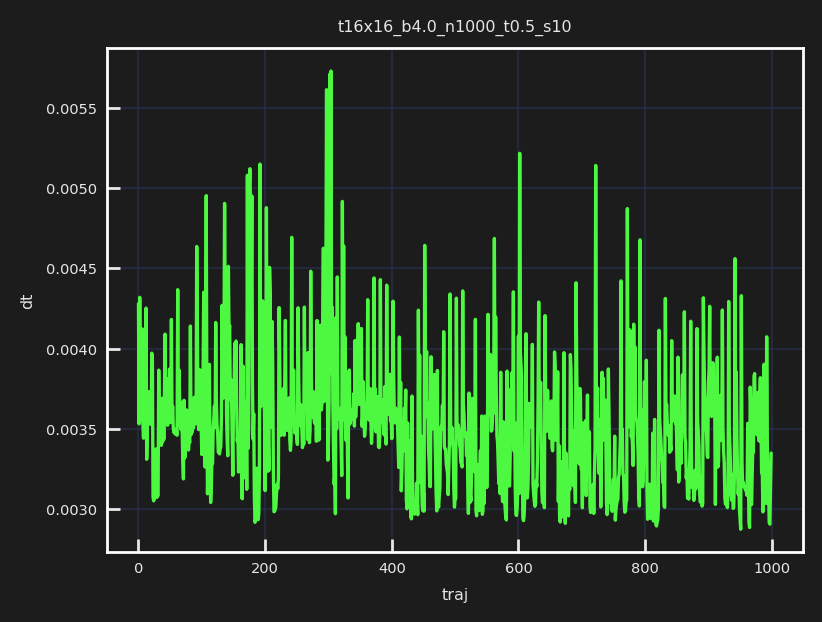

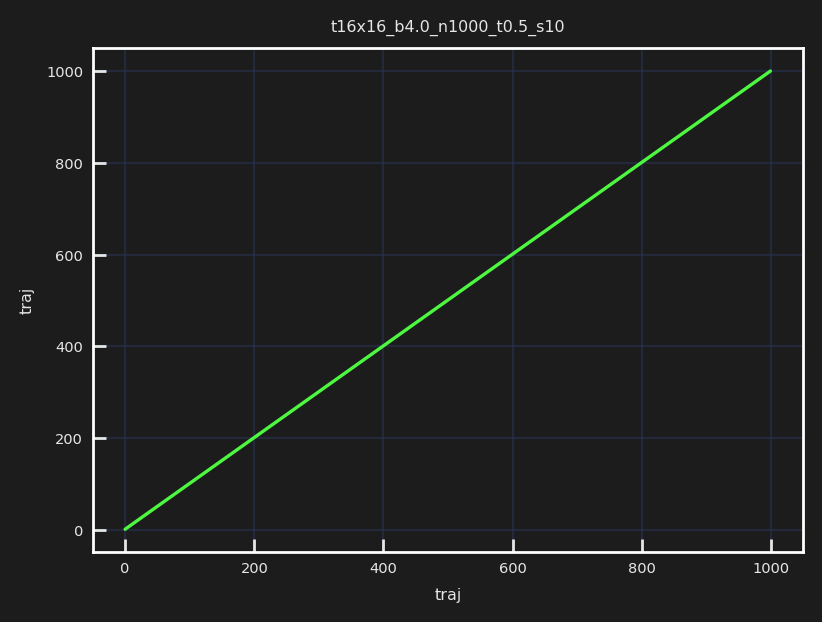

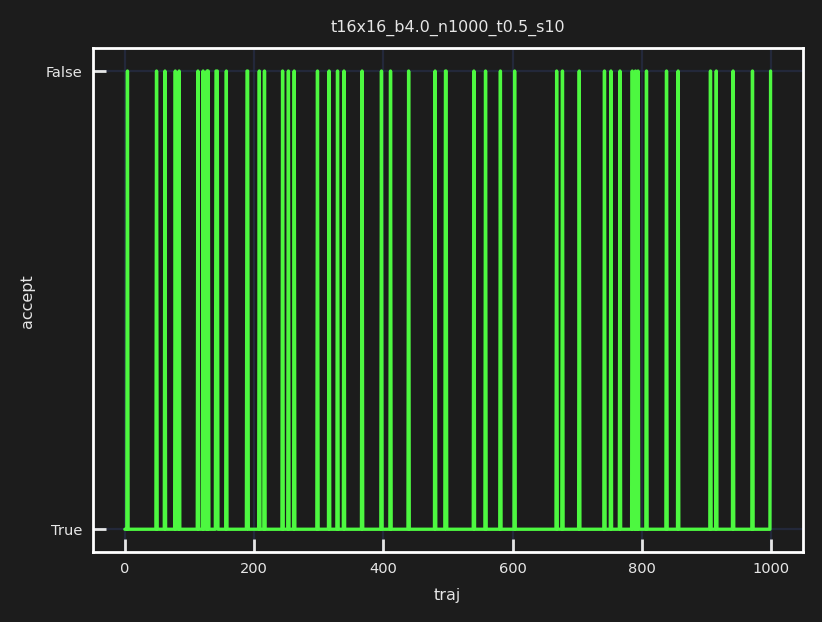

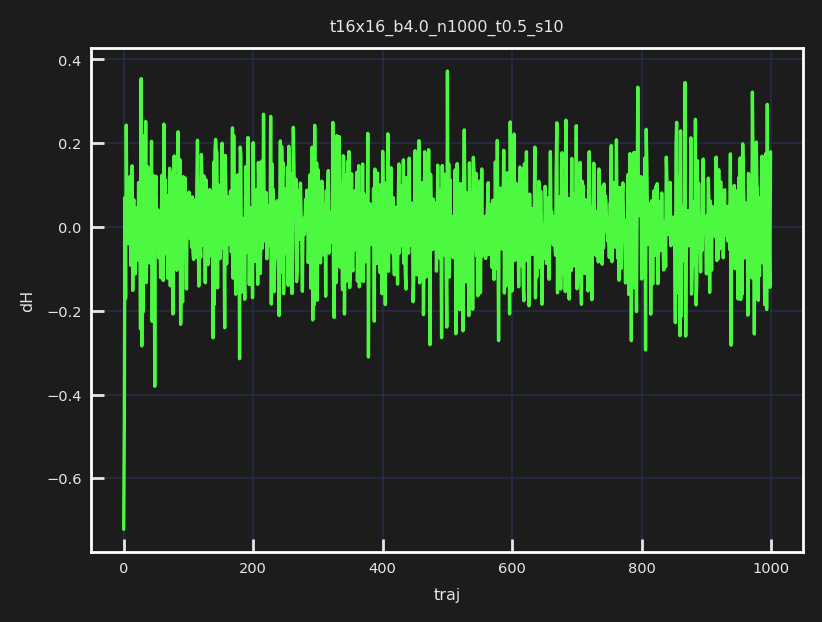

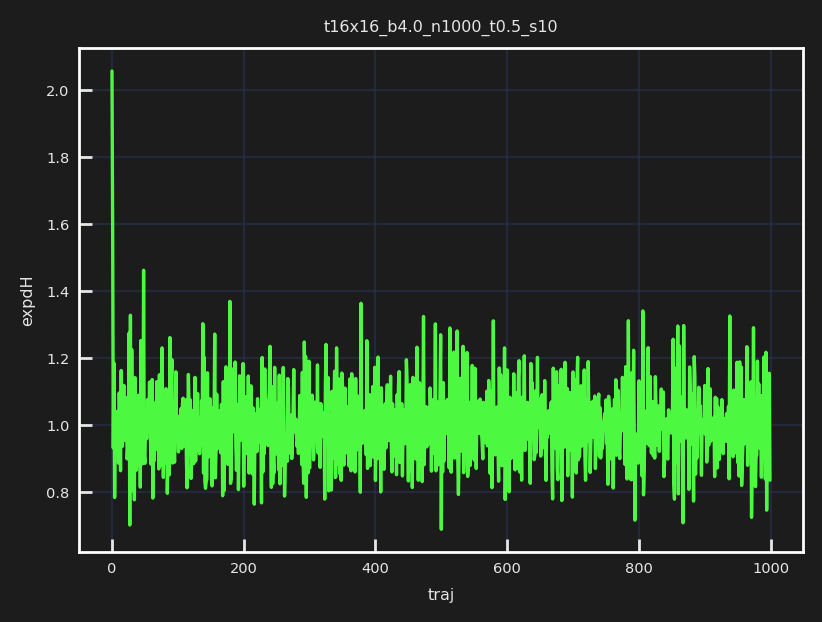

...

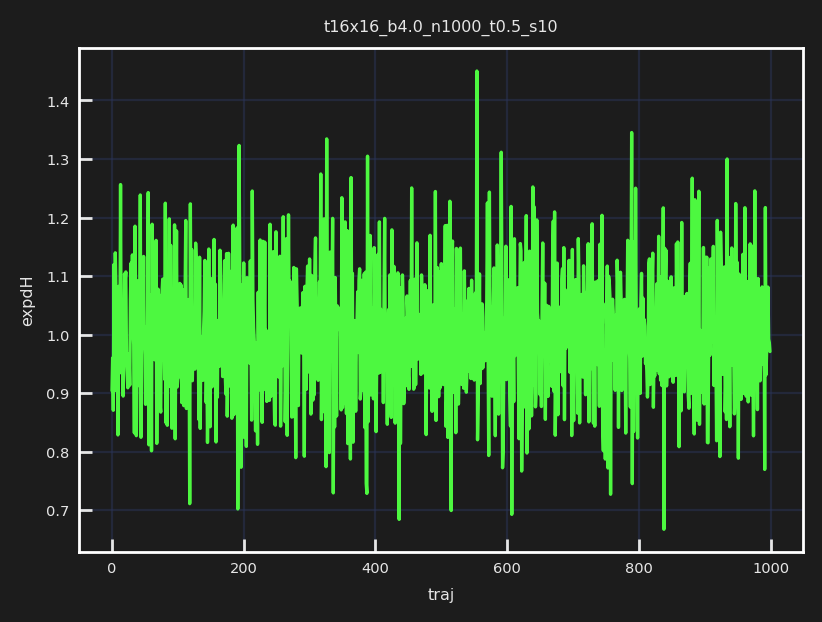

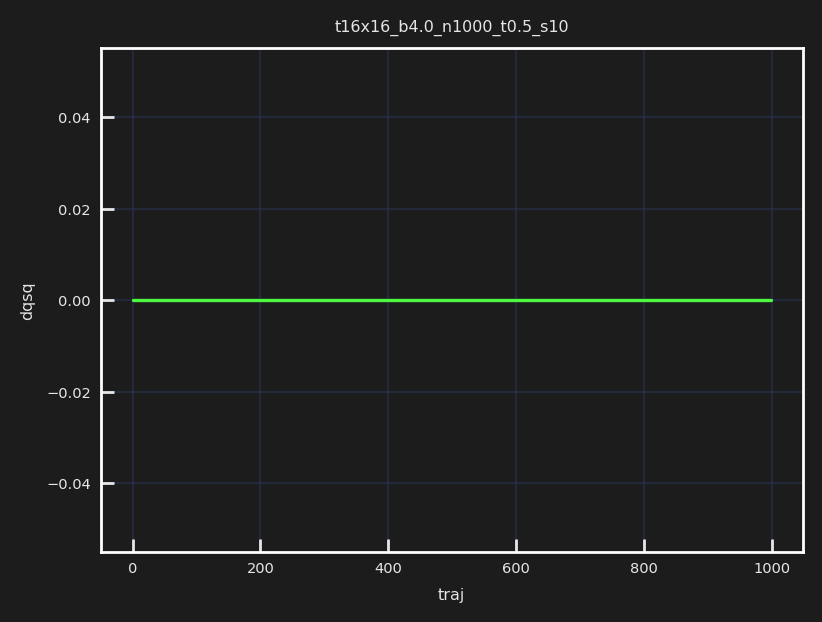

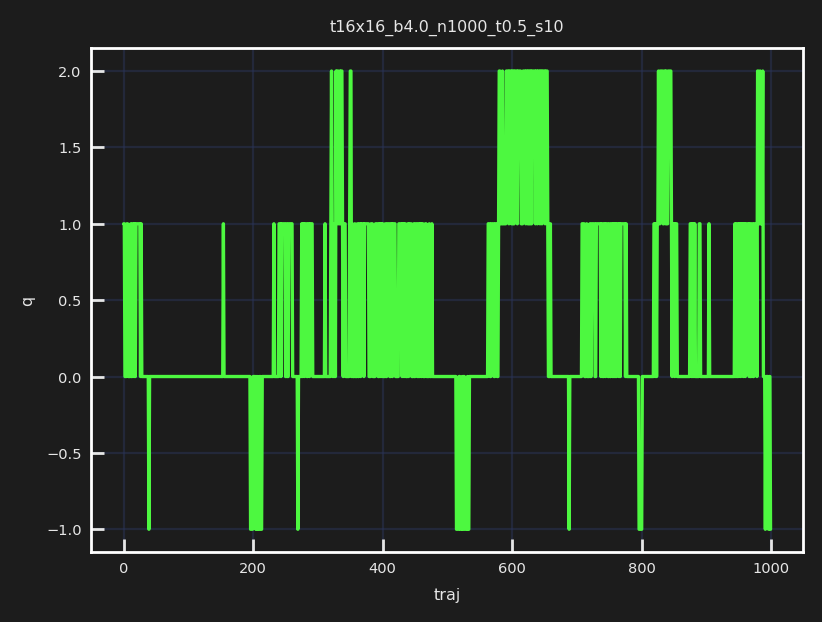

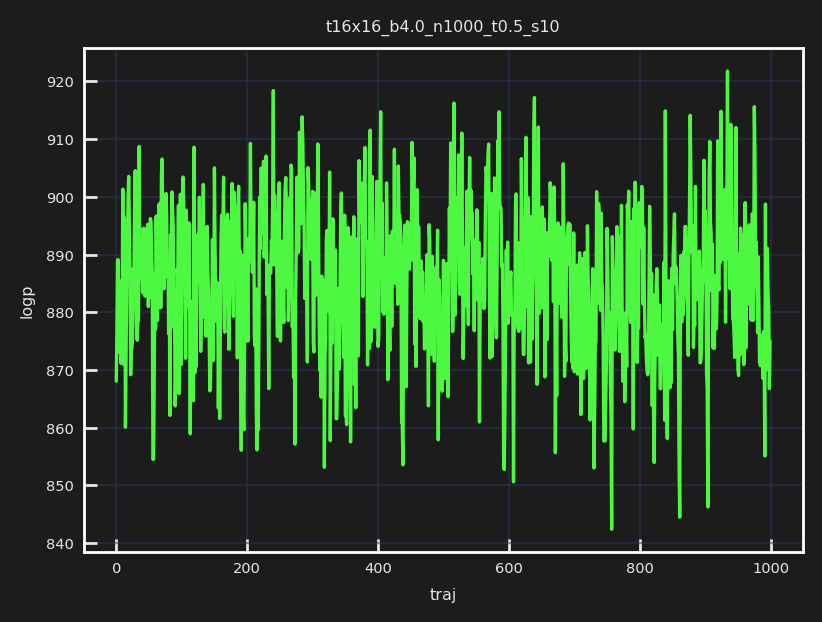

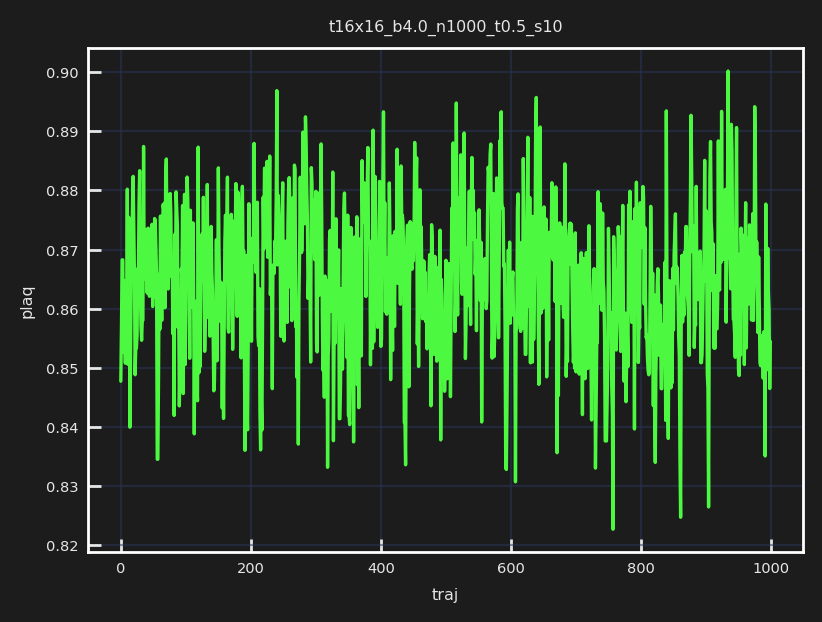

In [12]:
from fthmc.hmc import run_hmc

#hmc_mdir = io.tstamp_dir(os.path.join(logdir, 'hmc'))
#hmc_mdir = io.tstamp_dir(os.path.join(dirs, 'hmc'))

hmc_fields16, hmc_history16 = run_hmc(param16,
                                      keep_fields=True,
                                      save_history=True)

[17:51:59]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.0_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-1730

[17:51:59]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.0_n256_t1.0_s10/plots/ inference/pre_flow_model/2021-06-08-1730

[17:51:59]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-1730/ess.p
            df

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-1730/q.pdf

[17:52:00]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-1730/dqsq.
            pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-1730/dkl.p
            df

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-1730/logq.
            pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-1730/logp.
            pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-1730/accep
            ted.pdf

[17:52:00]  Saving inference_metrics to /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/
            fthmc/logs/out_t4x4_b4.0_n256_t1.0_s10/plots/                                    
            inference/pre_flow_model/2021-06-08-1730/inference_metrics.z.

[17:52:01]  Accept rate: 0.177

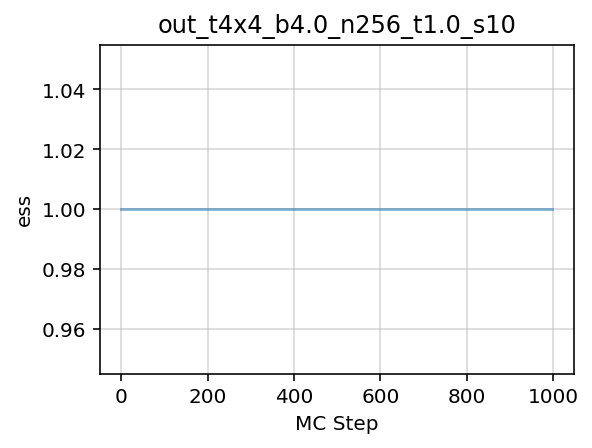

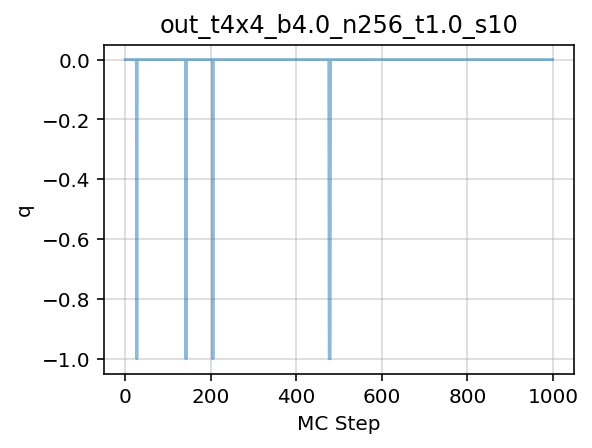

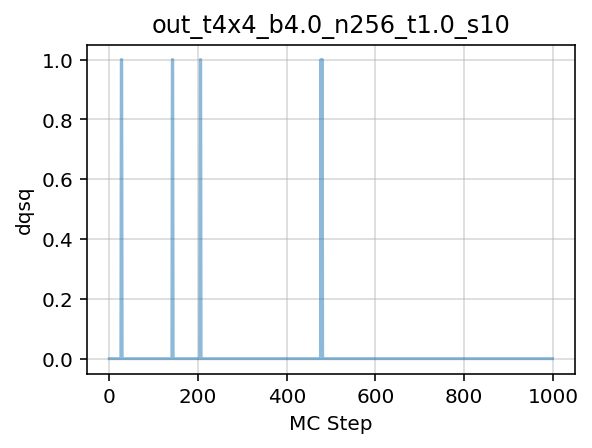

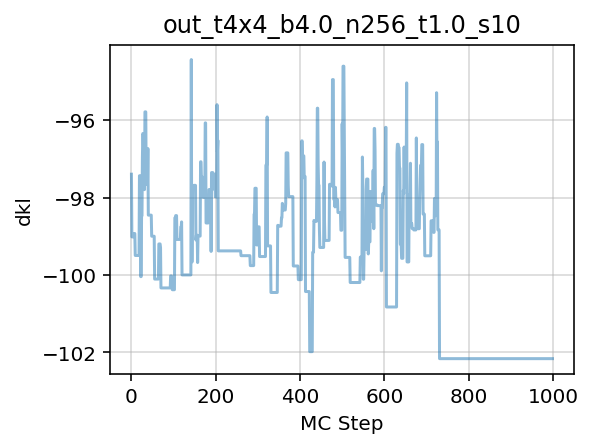

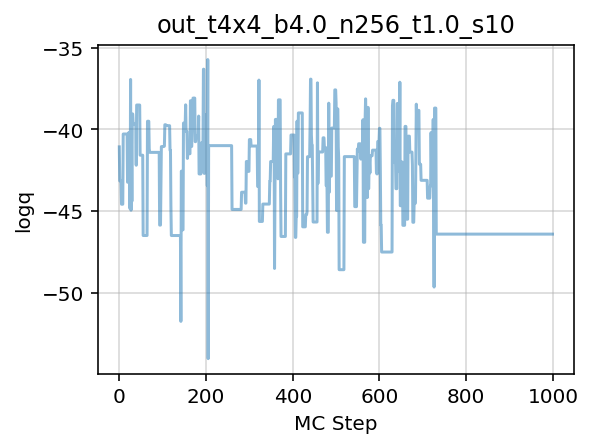

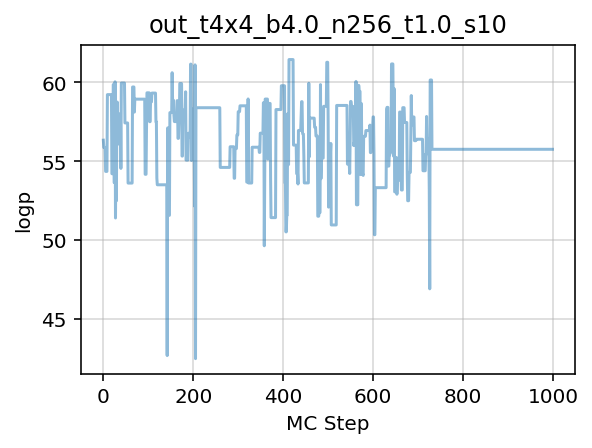

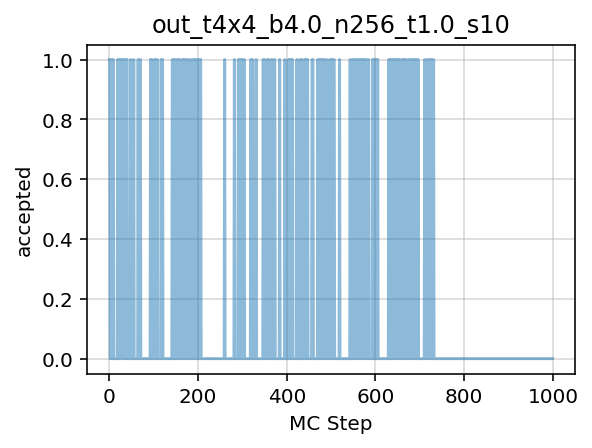

In [8]:
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed

tstamp = io.get_timestamp('%Y-%m-%d-%H%M%S')

history = make_mcmc_ensemble(model=train_outputs['model'],
                             action_fn=train_outputs['action'],
                             batch_size=train_config.batch_size,
                             num_samples=1000)

pdir = os.path.join(PLOTS_DIR, 'inference', 'pre_flow_model', TSTAMP)
if os.path.isdir(pdir):
    pdir = os.path.join(PLOTS_DIR, 'inference', 'pre_flow_model', tstamp)
    
mdir = os.path.join(PLOTS_DIR,' inference', 'pre_flow_model', TSTAMP)
if os.path.isdir(mdir):
    mdir = os.path.join(METRICS_DIR, 'inference', 'pre_flow_model', TSTAMP)
    
io.check_else_make_dir(pdir)
io.check_else_make_dir(mdir)

plot_history(history=history,
             param=param, skip=['epoch', 'x'],
             num_chains=2, therm_frac=0.0,#, thin=10,
             xlabel='MC Step', outdir=pdir, alpha=0.5)

mfile = os.path.join(mdir, 'inference_metrics.z')

io.save_history(history, mfile, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

In [9]:
from fthmc.config import grab

#for key, val in history.items():
#    #x = grab(val)
#    if key == 'x':
#        continue
#        
#    logger.log(f'({key}) shape: {val.shape}, mean: {np.mean(val)}')
np.mean(history['accepted'])
#np.mean(history['accepted'])

0.177

In [10]:
from fthmc.utils.samplers import generate_ensemble

outputs = generate_ensemble(pre_flow_model, flow_act, logger=logger)

history = outputs['history']
#u1_ens = outputs['ensemble']

pre_flow = pre_flow_model['layers']

[17:52:11]  accept_rate=0.2353515625

            top_susceptibility=0.02372 +/- 0.00675

[17:52:13]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175213

[17:52:13]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.0_n256_t1.0_s10/metrics/training/pre_flow_model/2021-06-08-175213

[17:52:13]  Existing file found!                                                             
            Renaming outfile to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/l
            ogs/out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/ste
            p_175213.pdf

[17:52:13]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/step_1
            75213.pdf

[17:52:13]  Existing file found!                                                             
            Renaming outfile to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/l
            ogs/out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/dt_
            175213.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/dt_175
            213.pdf

[17:52:14]  Existing file found!                                                             
            Renaming outfile to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/l
            ogs/out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/los
            s_175214.pdf

[17:52:14]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/loss_1
            75214.pdf

[17:52:14]  Existing file found!                                                             
            Renaming outfile to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/l
            ogs/out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/q_1
            75214.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/q_1752
            14.pdf

[17:52:14]  Existing file found!                                                             
            Renaming outfile to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/l
            ogs/out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/dq_
            175214.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/dq_175
            214.pdf

[17:52:14]  Existing file found!                                                             
            Renaming outfile to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/l
            ogs/out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/ess
            _175214.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/ess_17
            5214.pdf

[17:52:14]  Existing file found!                                                             
            Renaming outfile to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/l
            ogs/out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/pla
            q_175214.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/plaq_1
            75214.pdf

[17:52:15]  Existing file found!                                                             
            Renaming outfile to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/l
            ogs/out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/los
            s_dkl_175215.pdf

[17:52:15]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/loss_d
            kl_175215.pdf

[17:52:15]  Existing file found!                                                             
            Renaming outfile to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/l
            ogs/out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/log
            p_175215.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/logp_1
            75215.pdf

[17:52:15]  Existing file found!                                                             
            Renaming outfile to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/l
            ogs/out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/log
            q_175215.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.0_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1730/logq_1
            75215.pdf

[17:52:15]  Saving train_metrics to /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthm
            c/logs/out_t4x4_b4.0_n256_t1.0_s10/metrics/training/pre_flow_model/2021-06-08-175
            213/train_metrics.z.

KeyboardInterrupt: 

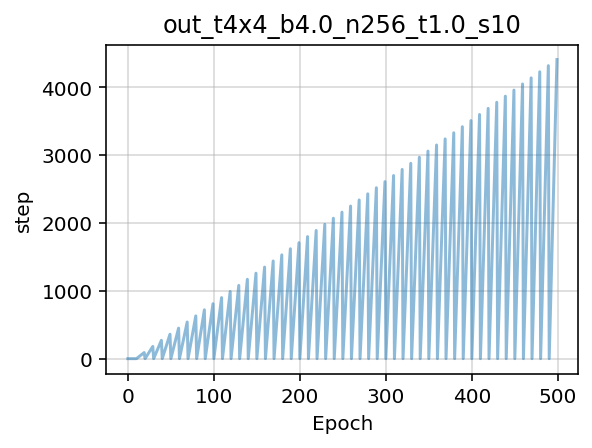

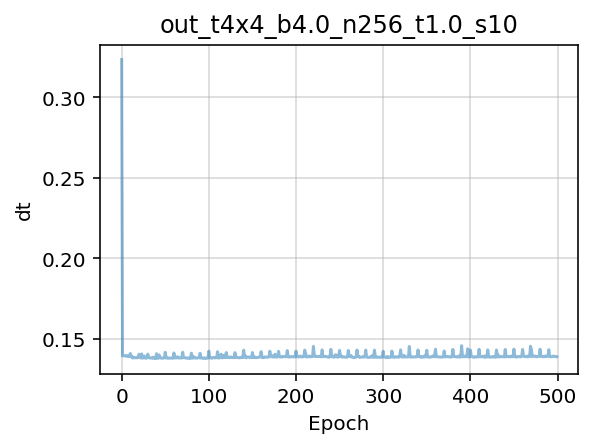

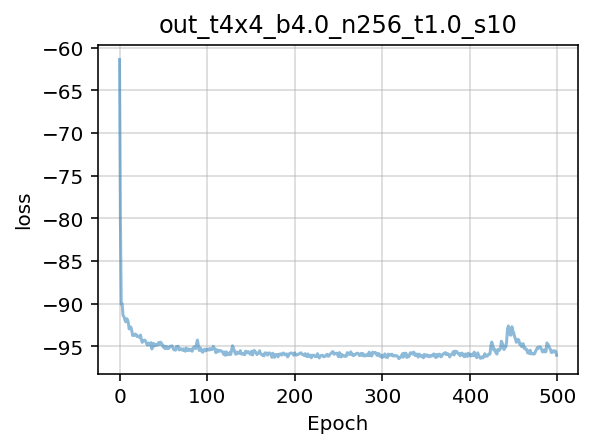

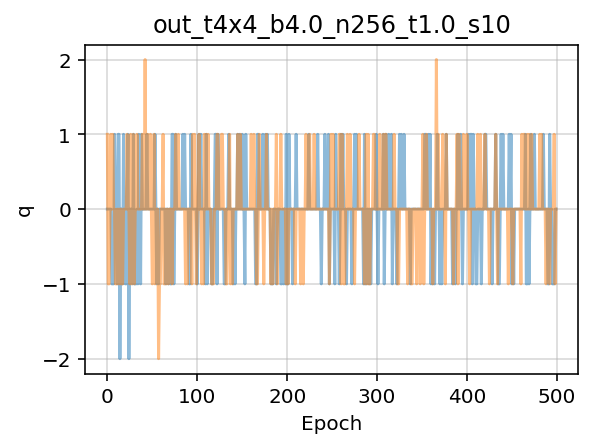

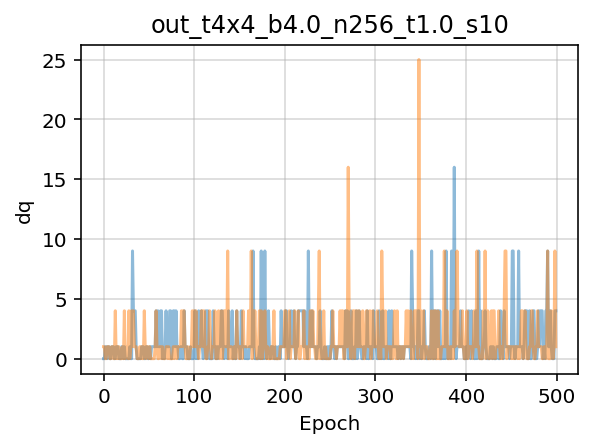

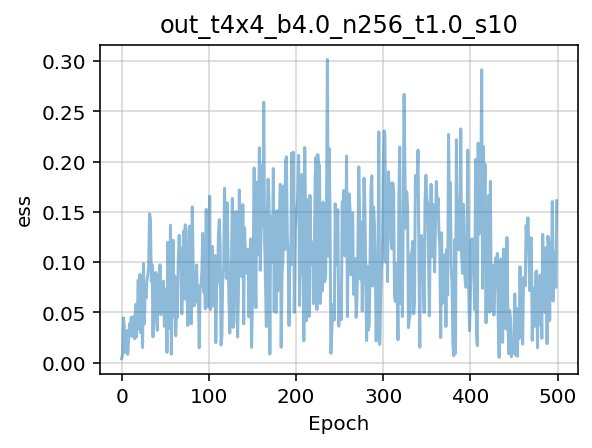

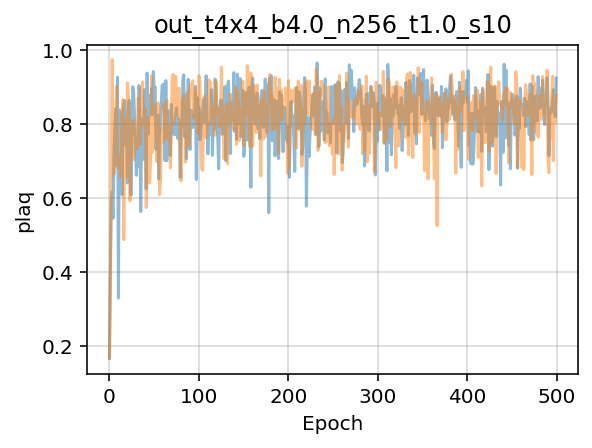

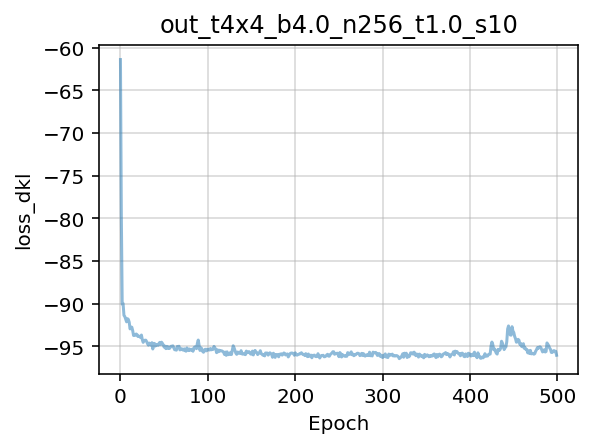

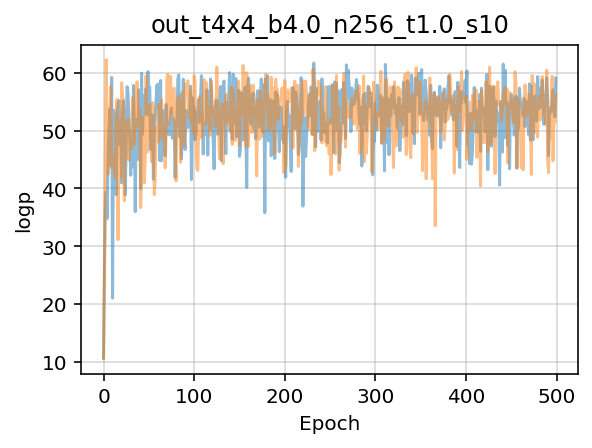

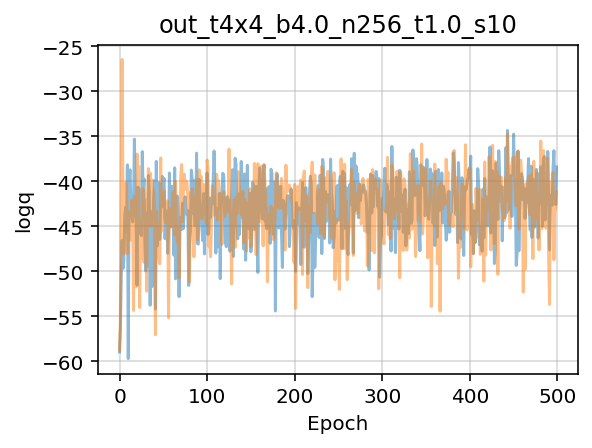

In [11]:
import matplotlib.pyplot as plt

from fthmc.utils.plot_helpers import plot_history

tstamp = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir = os.path.join(PLOTS_DIR, 'training', 'pre_flow_model', TSTAMP)
if os.path.isdir(pdir):
    pdir = os.path.join(PLOTS_DIR, 'training', 'pre_flow_model', tstamp)
    
mdir = os.path.join(METRICS_DIR, 'training', 'pre_flow_model', TSTAMP)
if os.path.isdir(mdir):
    mdir = os.path.join(METRICS_DIR, 'training', 'pre_flow_model', tstamp)
    
io.check_else_make_dir(pdir)
io.check_else_make_dir(mdir)

plot_history(history=train_outputs['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=outdir, alpha=0.5)

mfile = os.path.join(mdir, 'train_metrics.z')
io.save_history(train_outputs['history'], mfile, name='train_metrics')

In [12]:
train_force = False
flow_model = None

if train_force:
    flow_model, flow_act = flow_train(param, with_force=True, pre_model=pre_flow_model)
else:
    flow_model = pre_flow_model
    
u1_ens = generate_ensemble(flow_model, flow_act, logger=logger)
flow = flow_model['layers']
flow.eval()

[17:52:20]  accept_rate=0.1376953125

            top_susceptibility=0.02362 +/- 0.01007

ModuleList(
  (0): GaugeEquivCouplingLayer(
    (plaq_coupling): NCPPlaqCouplingLayer(
      (net): Sequential(
        (0): Conv2d(2, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), padding_mode=circular)
        (1): SiLU()
        (2): Conv2d(8, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), padding_mode=circular)
        (3): SiLU()
        (4): Conv2d(8, 3, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), padding_mode=circular)
      )
    )
  )
  (1): GaugeEquivCouplingLayer(
    (plaq_coupling): NCPPlaqCouplingLayer(
      (net): Sequential(
        (0): Conv2d(2, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), padding_mode=circular)
        (1): SiLU()
        (2): Conv2d(8, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), padding_mode=circular)
        (3): SiLU()
        (4): Conv2d(8, 3, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), padding_mode=circular)
      )
    )
  )
  (2): GaugeEquivCouplingLayer(
    (plaq_coupling): NCPPlaqCouplingLaye

# Try increasing $\beta$ on `4x4` lattice

In [14]:
from dataclasses import asdict

pdict = asdict(param)
logger.log(pdict)

[22:27:46]  {                                                                                
                'beta': 4.0,                                                                 
                'L': 4,                                                                      
                'tau': 0.5,                                                                  
                'nstep': 5,                                                                  
                'ntraj': 1000,                                                               
                'nrun': 2,                                                                   
                'nprint': 100,                                                               
                'seed': 1331,                                                                
                'randinit': False,                                                           
                'nth': 2,                                                                    
                'nth_interop': 2                                                             
            }

In [15]:
type(pre_flow_model['layers'])

torch.nn.modules.container.ModuleList

[17:52:39]  Param:                                                                           
            ----------------                                                                 
            beta=4.5                                                                         
            L=4                                                                              
            tau=1.0                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=100                                                                       
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[4, 4]                                                                       
            nd=2                                                                             
            shape=[2, 4, 4]                                                                  
            volume=16                                                                        
            dt=0.1

[17:52:39]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.5_n256_t1.0_s10

[17:52:39]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.5_n256_t1.0_s10/models

[17:52:39]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.5_n256_t1.0_s10/metrics

[17:52:39]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.5_n256_t1.0_s10/plots

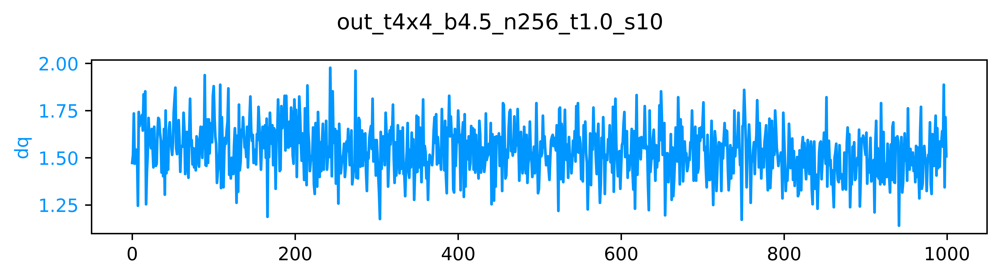

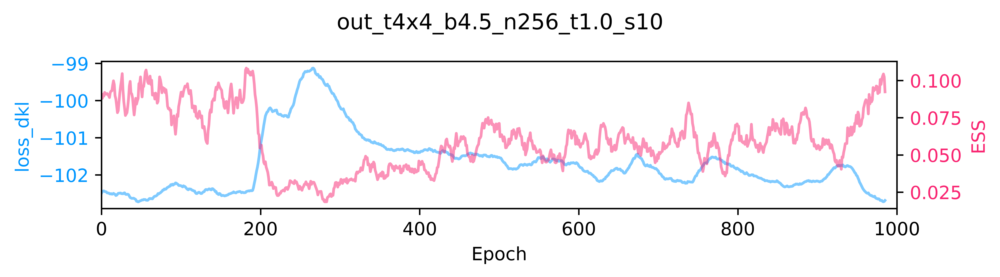

[17:52:41]  ---------------------------------------                                          
            ERA=0, last took: 0 min 0 s                                                      
            ---------------------------------------

[17:52:55]  epoch=97.000 step=0.000 dt=0.138 loss=-102.197 dq=1.65469 ess=0.0593313          
            plaq=0.846854 loss_dkl=-102.197 logp=60.9735 logq=-41.2232

[17:52:56]  ---------------------------------------                                          
            ERA=1, last took: 0 min 15.79 s                                                  
            ---------------------------------------

[17:53:10]  epoch=97.000 step=97.000 dt=0.138 loss=-102.331 dq=1.65469 ess=0.114545          
            plaq=0.840753 loss_dkl=-102.331 logp=60.5342 logq=-41.7966

[17:53:12]  ---------------------------------------                                          
            ERA=2, last took: 0 min 15.86 s                                                  
            ---------------------------------------

[17:53:26]  epoch=97.000 step=194.000 dt=0.138 loss=-99.6948 dq=1.57734 ess=0.031886         
            plaq=0.849467 loss_dkl=-99.6948 logp=61.1616 logq=-38.5332

[17:53:28]  ---------------------------------------                                          
            ERA=3, last took: 0 min 15.88 s                                                  
            ---------------------------------------

[17:53:42]  epoch=97.000 step=291.000 dt=0.137 loss=-101.36 dq=1.51797 ess=0.029906          
            plaq=0.846599 loss_dkl=-101.36 logp=60.9551 logq=-40.405

[17:53:44]  ---------------------------------------                                          
            ERA=4, last took: 0 min 15.82 s                                                  
            ---------------------------------------

[17:53:58]  epoch=97.000 step=388.000 dt=0.136 loss=-101.517 dq=1.49219 ess=0.0611839        
            plaq=0.851672 loss_dkl=-101.517 logp=61.3204 logq=-40.1965

[17:54:00]  ---------------------------------------                                          
            ERA=5, last took: 0 min 15.72 s                                                  
            ---------------------------------------

[17:54:13]  epoch=97.000 step=485.000 dt=0.136 loss=-101.699 dq=1.45703 ess=0.0909918        
            plaq=0.850273 loss_dkl=-101.699 logp=61.2196 logq=-40.4793

[17:54:15]  ---------------------------------------                                          
            ERA=6, last took: 0 min 15.74 s                                                  
            ---------------------------------------

[17:54:29]  epoch=97.000 step=582.000 dt=0.137 loss=-101.831 dq=1.59219 ess=0.0552301        
            plaq=0.847837 loss_dkl=-101.831 logp=61.0443 logq=-40.7872

[17:54:31]  ---------------------------------------                                          
            ERA=7, last took: 0 min 15.78 s                                                  
            ---------------------------------------

[17:54:45]  epoch=97.000 step=679.000 dt=0.136 loss=-101.723 dq=1.50391 ess=0.0477211        
            plaq=0.851465 loss_dkl=-101.723 logp=61.3055 logq=-40.4175

[17:54:47]  ---------------------------------------                                          
            ERA=8, last took: 0 min 15.8 s                                                   
            ---------------------------------------

[17:55:01]  epoch=97.000 step=776.000 dt=0.137 loss=-102.114 dq=1.58984 ess=0.0718534        
            plaq=0.850345 loss_dkl=-102.114 logp=61.2249 logq=-40.8893

[17:55:03]  ---------------------------------------                                          
            ERA=9, last took: 0 min 15.8 s                                                   
            ---------------------------------------

[17:55:17]  epoch=97.000 step=873.000 dt=0.137 loss=-102.646 dq=1.60234 ess=0.0595918        
            plaq=0.850079 loss_dkl=-102.646 logp=61.2057 logq=-41.4398

[17:55:19]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.5_n256_t1.0_s10/models/pre_flow_model/2021-06-08-1752

[17:55:19]  Saving checkpoint to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/
            logs/out_t4x4_b4.5_n256_t1.0_s10/models/pre_flow_model/2021-06-08-1752/pre_flow_m
            odel.tar

[17:55:19]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1752

[17:55:19]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1752/dq_tra
            ining.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1752/loss_d
            kl_ess_training.pdf

[17:55:19]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175519

[17:55:19]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.5_n256_t1.0_s10/metrics/training/pre_flow_model/2021-06-08-1752

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175519/step
            .pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175519/dt.p
            df

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175519/loss
            .pdf

[17:55:20]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175519/q.pd
            f

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175519/dq.p
            df

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175519/ess.
            pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175519/plaq
            .pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175519/loss
            _dkl.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175519/logp
            .pdf

[17:55:21]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-175519/logq
            .pdf

[17:55:21]  Saving train_metrics to /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthm
            c/logs/out_t4x4_b4.5_n256_t1.0_s10/metrics/training/pre_flow_model/2021-06-08-175
            2/train_metrics.z.

[17:55:26]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-175519

[17:55:26]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t4x4_b4.5_n256_t1.0_s10/metrics/inference/pre_flow_model/2021-06-08-1752

[17:55:26]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-175519/ess
            .pdf

[17:55:27]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-175519/q.p
            df

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-175519/dqs
            q.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-175519/dkl
            .pdf

[17:55:28]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-175519/log
            q.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-175519/log
            p.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t4x4_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-175519/acc
            epted.pdf

[17:55:28]  Saving inference_metrics to /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/
            fthmc/logs/out_t4x4_b4.5_n256_t1.0_s10/metrics/inference/pre_flow_model/2021-06-0
            8-1752/inference_metrics.z.

[17:55:34]  Accept rate: 0.2353515625

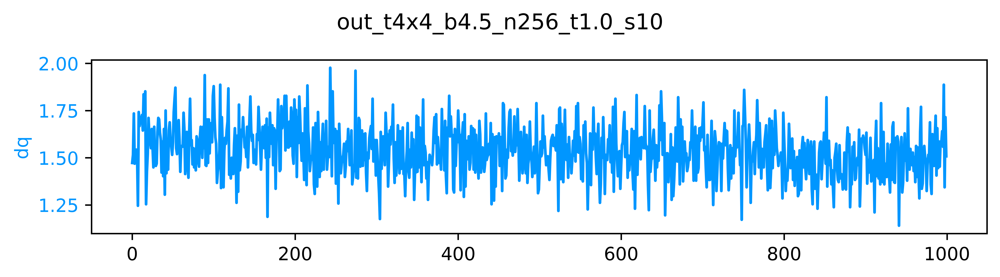

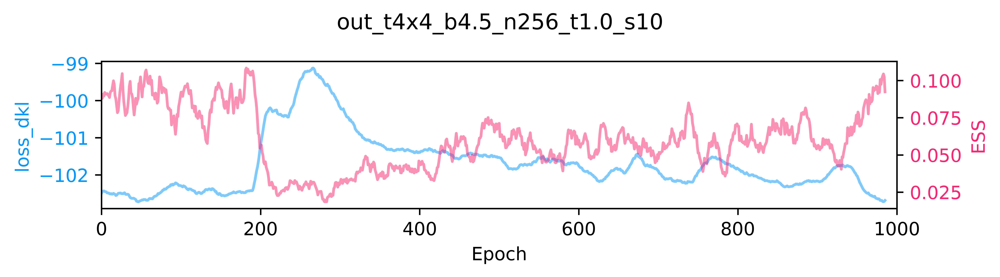

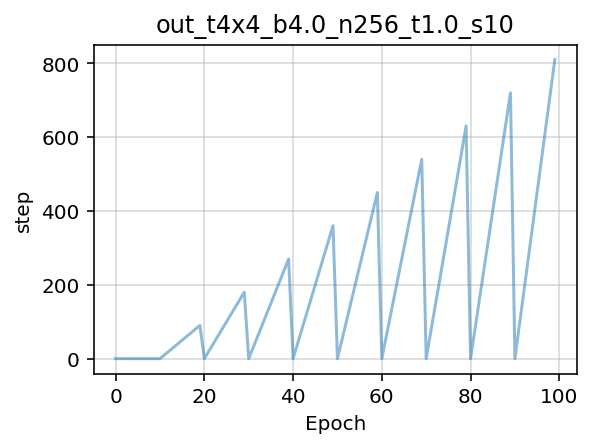

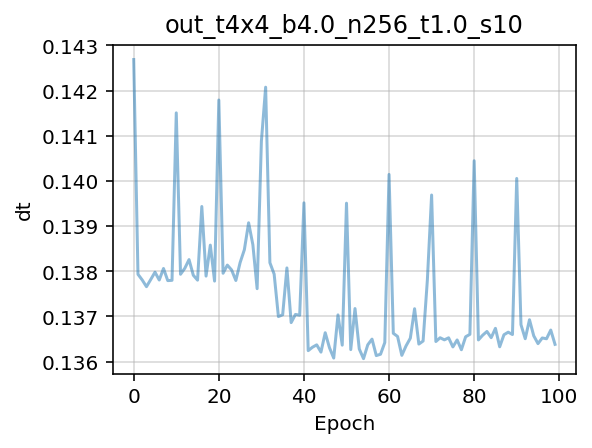

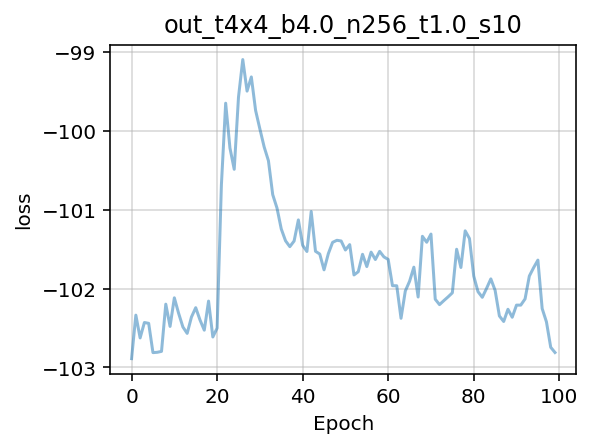

...

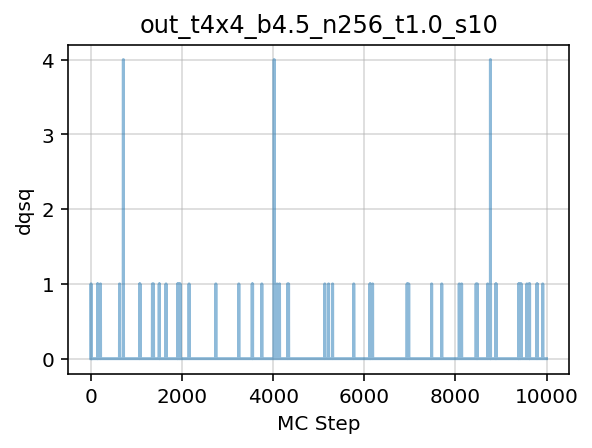

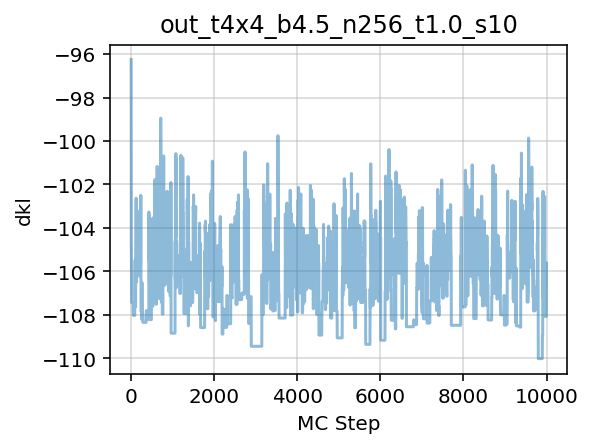

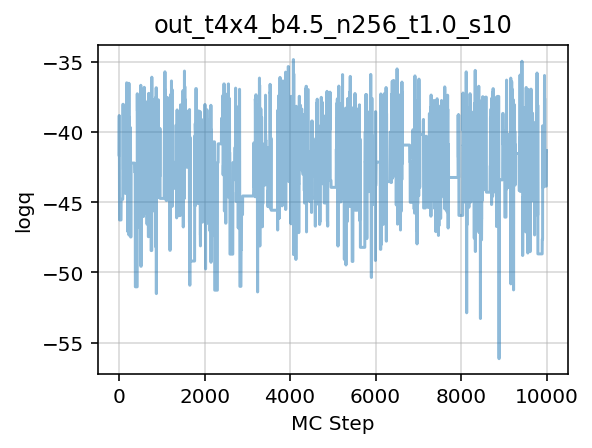

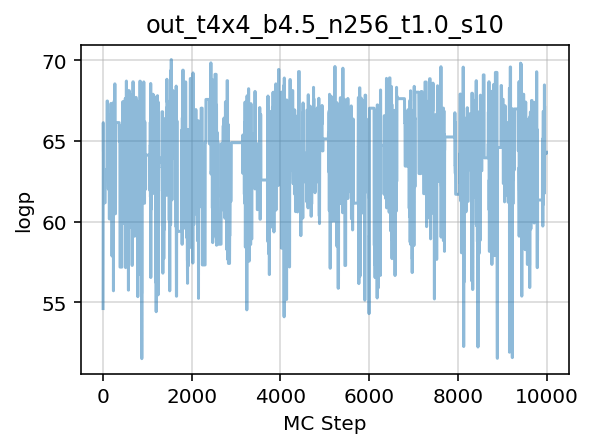

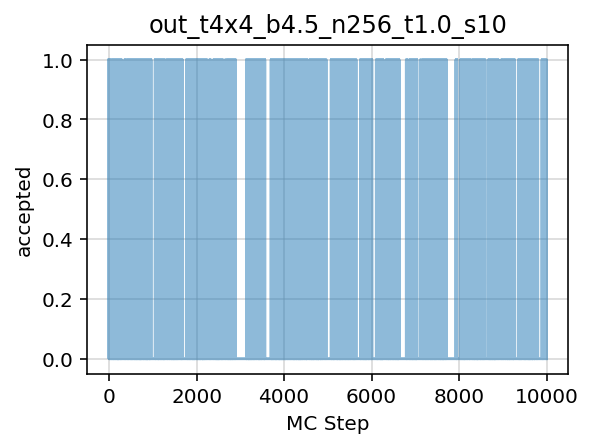

In [13]:
from math import pi as PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_net_from_layers, get_nets
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history

param4 = Param(**{
    'L': 4,
    'tau': 1.,
    'nrun': 5,
    'beta': 4.5,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 100,
    'seed': 1331,
})

logger.log(repr(param4))

flow4 = make_net_from_layers(lattice_shape=tuple(param.lat),
                              nets=get_nets(pre_flow_model['layers']))


train_config4 = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 100,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 256,
    'print_freq': 100,
    'plot_freq': 100,
})

prior4 = MultivariateUniform(torch.zeros((2, *param4.lat)),
                              2. * PI * torch.ones(tuple(param4.lat)))

model4 = {'layers': flow4, 'prior': prior4}

DAYSTR4 = io.get_timestamp('%Y-%m-%d')
NOW4 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP4 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR4 = os.path.join(LOGS_DIR,
                           param4.uniquestr())
METRICS_DIR4 = os.path.join(PARAM_DIR4, 'metrics')
MODEL_DIR4 = os.path.join(PARAM_DIR4, 'models')
PLOTS_DIR4 = os.path.join(PARAM_DIR4, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR4)
io.check_else_make_dir(MODEL_DIR4)
io.check_else_make_dir(METRICS_DIR4)
io.check_else_make_dir(PLOTS_DIR4)

train_outputs4 = train(param4,
                        train_config4,
                        model=model4,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots4 = train_outputs4['plots']
pre_flow_history4 = train_outputs4['history']
flow_act4 = train_outputs4['action']

pre_flow_model4 = train_outputs4['model']
pre_flow_optimizer4 = train_outputs4['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step4 = train_config4.n_era * train_config4.n_epoch

outfile4 = os.path.join(MODEL_DIR4, 'pre_flow_model', TSTAMP4, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step4,
    outfile=outfile4,
    model=pre_flow_model4['layers'],
    optimizer=pre_flow_optimizer4,
    history=train_outputs4['history'],
    overwrite=True,
)

plots4 = train_outputs4['plots']
outdir4 = os.path.join(PLOTS_DIR4, 'training', 'pre_flow_model', TSTAMP4)

save_live_plots(plots4, outdir4)


tstamp4 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir4 = os.path.join(PLOTS_DIR4, 'training', 'pre_flow_model', TSTAMP4)
if os.path.isdir(pdir4):
    pdir4 = os.path.join(PLOTS_DIR4, 'training', 'pre_flow_model', tstamp4)
    
mdir4 = os.path.join(METRICS_DIR4, 'training', 'pre_flow_model', TSTAMP4)
if os.path.isdir(mdir4):
    mdir4 = os.path.join(METRICS_DIR4, 'training', 'pre_flow_model', tstamp4)
    
io.check_else_make_dir(pdir4)
io.check_else_make_dir(mdir4)

plot_history(history=train_outputs4['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir4, alpha=0.5)

mfile4 = os.path.join(mdir4, 'train_metrics.z')
io.save_history(train_outputs4['history'], mfile4, name='train_metrics')


history4 = make_mcmc_ensemble(model=train_outputs4['model'],
                               action_fn=train_outputs4['action'],
                               batch_size=train_config4.batch_size,
                               num_samples=10000)

pdir4 = os.path.join(PLOTS_DIR4, 'inference', 'pre_flow_model', TSTAMP4)
if os.path.isdir(pdir):
    pdir4 = os.path.join(PLOTS_DIR4, 'inference', 'pre_flow_model', tstamp4)
    
mdir4 = os.path.join(PLOTS_DIR4,'inference', 'pre_flow_model', TSTAMP4)
if os.path.isdir(mdir):
    mdir4 = os.path.join(METRICS_DIR4, 'inference', 'pre_flow_model', TSTAMP4)
    
io.check_else_make_dir(pdir4)
io.check_else_make_dir(mdir4)

plot_history(history=history4,
             param=param4,
             outdir=pdir4,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile4 = os.path.join(mdir4, 'inference_metrics.z')

io.save_history(history4, mfile4, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

## Extract layers from `pre_flow_model` and transfer learning to larger lattice

## Transfer up to $8\times8$ lattice

In [14]:
logger.log(repr(param))
logger.log(train_config)

[17:56:10]  Param:                                                                           
            ----------------                                                                 
            beta=4.0                                                                         
            L=4                                                                              
            tau=1.0                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=100                                                                       
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[4, 4]                                                                       
            nd=2                                                                             
            shape=[2, 4, 4]                                                                  
            volume=16                                                                        
            dt=0.1

            TrainConfig(                                                                     
                n_era=50,                                                                    
                n_epoch=100,                                                                 
                n_layers=24,                                                                 
                n_s_nets=2,                                                                  
                hidden_sizes=[8, 8],                                                         
                kernel_size=3,                                                               
                base_lr=0.001,                                                               
                batch_size=256,                                                              
                print_freq=100,                                                              
                plot_freq=100,                                                               
                with_force=False                                                             
            )

[17:57:32]  Param:                                                                           
            ----------------                                                                 
            beta=4.5                                                                         
            L=8                                                                              
            tau=1.0                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=100                                                                       
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[8, 8]                                                                       
            nd=2                                                                             
            shape=[2, 8, 8]                                                                  
            volume=64                                                                        
            dt=0.1

            Param:                                                                           
            ----------------                                                                 
            beta=4.5                                                                         
            L=8                                                                              
            tau=1.0                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=100                                                                       
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[8, 8]                                                                       
            nd=2                                                                             
            shape=[2, 8, 8]                                                                  
            volume=64                                                                        
            dt=0.1

[17:57:32]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t8x8_b4.5_n256_t1.0_s10

[17:57:32]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t8x8_b4.5_n256_t1.0_s10/models

[17:57:32]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t8x8_b4.5_n256_t1.0_s10/metrics

[17:57:32]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t8x8_b4.5_n256_t1.0_s10/plots

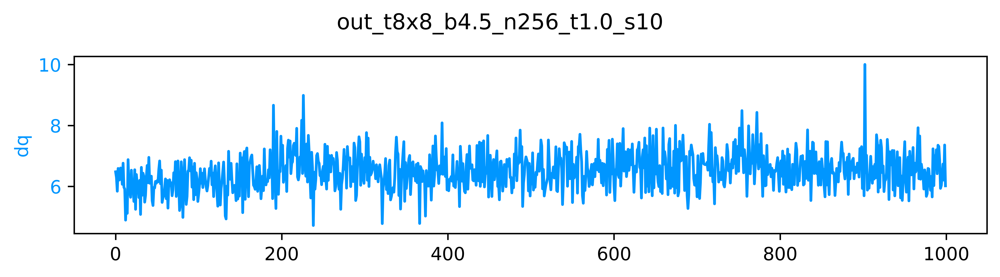

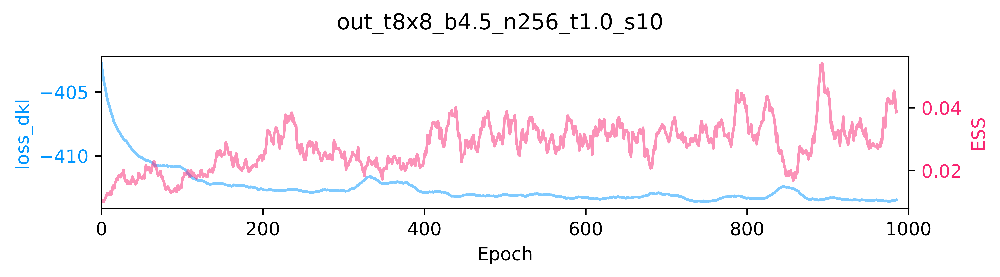

[17:57:34]  ---------------------------------------                                          
            ERA=0, last took: 0 min 0 s                                                      
            ---------------------------------------

[17:57:48]  epoch=97.000 step=0.000 dt=0.138 loss=-410.738 dq=6.14062 ess=0.0160448          
            plaq=0.854433 loss_dkl=-410.738 logp=246.077 logq=-164.661

[17:57:50]  ---------------------------------------                                          
            ERA=1, last took: 0 min 15.79 s                                                  
            ---------------------------------------

[17:58:03]  epoch=97.000 step=97.000 dt=0.138 loss=-412.487 dq=6.43906 ess=0.0198629         
            plaq=0.856063 loss_dkl=-412.487 logp=246.546 logq=-165.94

[17:58:05]  ---------------------------------------                                          
            ERA=2, last took: 0 min 15.88 s                                                  
            ---------------------------------------

[17:58:19]  epoch=97.000 step=194.000 dt=0.138 loss=-412.831 dq=6.41641 ess=0.0235801        
            plaq=0.857793 loss_dkl=-412.831 logp=247.044 logq=-165.786

[17:58:21]  ---------------------------------------                                          
            ERA=3, last took: 0 min 15.8 s                                                   
            ---------------------------------------

[17:58:35]  epoch=97.000 step=291.000 dt=0.138 loss=-412.494 dq=6.6125 ess=0.019567          
            plaq=0.857948 loss_dkl=-412.494 logp=247.089 logq=-165.405

[17:58:37]  ---------------------------------------                                          
            ERA=4, last took: 0 min 15.87 s                                                  
            ---------------------------------------

[17:58:51]  epoch=97.000 step=388.000 dt=0.138 loss=-413.279 dq=6.38672 ess=0.0266166        
            plaq=0.859804 loss_dkl=-413.279 logp=247.624 logq=-165.655

[17:58:53]  ---------------------------------------                                          
            ERA=5, last took: 0 min 15.89 s                                                  
            ---------------------------------------

[17:59:07]  epoch=97.000 step=485.000 dt=0.138 loss=-413.305 dq=6.66563 ess=0.0212893        
            plaq=0.857857 loss_dkl=-413.305 logp=247.063 logq=-166.242

[17:59:09]  ---------------------------------------                                          
            ERA=6, last took: 0 min 15.91 s                                                  
            ---------------------------------------

[17:59:23]  epoch=97.000 step=582.000 dt=0.138 loss=-413.194 dq=6.34922 ess=0.042596         
            plaq=0.861468 loss_dkl=-413.194 logp=248.103 logq=-165.092

[17:59:25]  ---------------------------------------                                          
            ERA=7, last took: 0 min 15.89 s                                                  
            ---------------------------------------

[17:59:39]  epoch=97.000 step=679.000 dt=0.138 loss=-413.158 dq=6.48203 ess=0.0505137        
            plaq=0.858899 loss_dkl=-413.158 logp=247.363 logq=-165.795

[17:59:41]  ---------------------------------------                                          
            ERA=8, last took: 0 min 15.95 s                                                  
            ---------------------------------------

[17:59:55]  epoch=97.000 step=776.000 dt=0.138 loss=-413.491 dq=6.725 ess=0.0397762          
            plaq=0.859165 loss_dkl=-413.491 logp=247.44 logq=-166.052

[17:59:57]  ---------------------------------------                                          
            ERA=9, last took: 0 min 15.91 s                                                  
            ---------------------------------------

[18:00:11]  epoch=97.000 step=873.000 dt=0.138 loss=-413.377 dq=6.53438 ess=0.0431807        
            plaq=0.86034 loss_dkl=-413.377 logp=247.778 logq=-165.6

[18:00:13]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t8x8_b4.5_n256_t1.0_s10/models/pre_flow_model/2021-06-08-1757

[18:00:13]  Saving checkpoint to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/
            logs/out_t8x8_b4.5_n256_t1.0_s10/models/pre_flow_model/2021-06-08-1757/pre_flow_m
            odel.tar

[18:00:13]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1757

[18:00:13]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1757/dq_tra
            ining.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-1757/loss_d
            kl_ess_training.pdf

[18:00:13]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-180013

[18:00:13]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t8x8_b4.5_n256_t1.0_s10/metrics/training/pre_flow_model/2021-06-08-1757

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-180013/step
            .pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-180013/dt.p
            df

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-180013/loss
            .pdf

[18:00:14]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-180013/q.pd
            f

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-180013/dq.p
            df

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-180013/ess.
            pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-180013/plaq
            .pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-180013/loss
            _dkl.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-180013/logp
            .pdf

[18:00:15]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/training/pre_flow_model/2021-06-08-180013/logq
            .pdf

[18:00:15]  Saving train_metrics to /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthm
            c/logs/out_t8x8_b4.5_n256_t1.0_s10/metrics/training/pre_flow_model/2021-06-08-175
            7/train_metrics.z.

[18:00:20]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t8x8_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-180013

[18:00:20]  Creating directory: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/lo
            gs/out_t8x8_b4.5_n256_t1.0_s10/metrics/inference/pre_flow_model/2021-06-08-1757

[18:00:21]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-180013/ess
            .pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-180013/q.p
            df

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-180013/dqs
            q.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-180013/dkl
            .pdf

[18:00:22]  Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-180013/log
            q.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-180013/log
            p.pdf

            Saving figure to: /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/fthmc/logs
            /out_t8x8_b4.5_n256_t1.0_s10/plots/inference/pre_flow_model/2021-06-08-180013/acc
            epted.pdf

[18:00:22]  Saving inference_metrics to /gpfs/jlse-fs0/projects/datascience/foremans1/nftqcd/
            fthmc/logs/out_t8x8_b4.5_n256_t1.0_s10/metrics/inference/pre_flow_model/2021-06-0
            8-1757/inference_metrics.z.

[18:00:27]  Accept rate: 0.2353515625

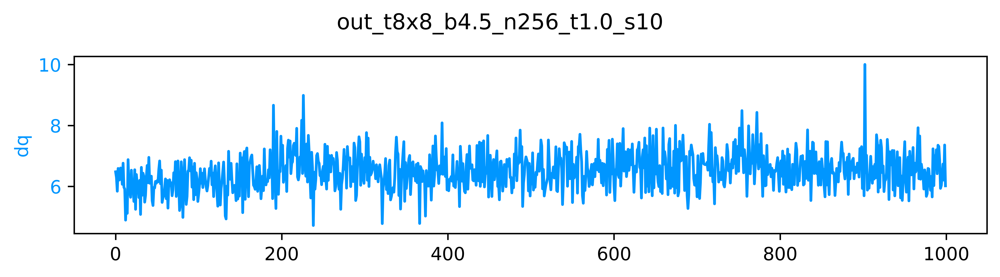

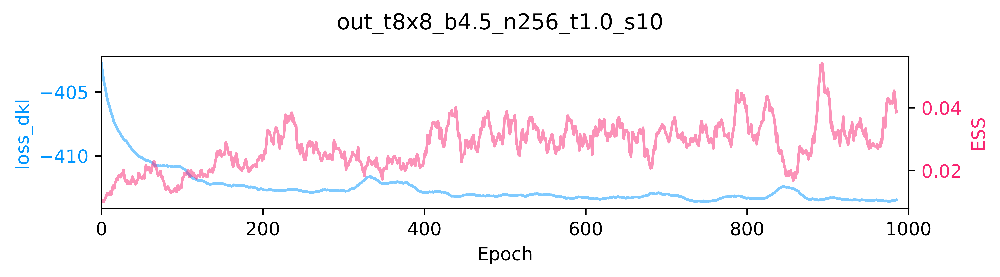

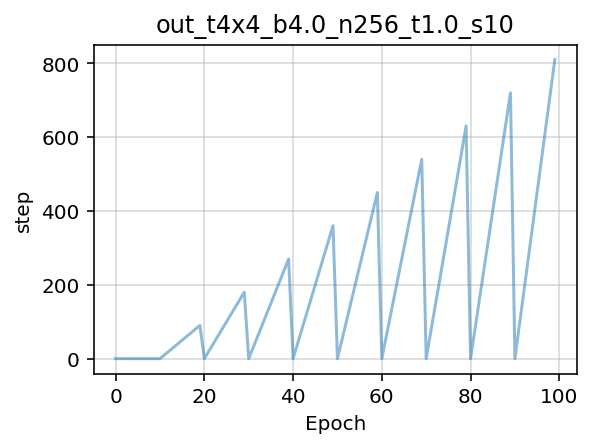

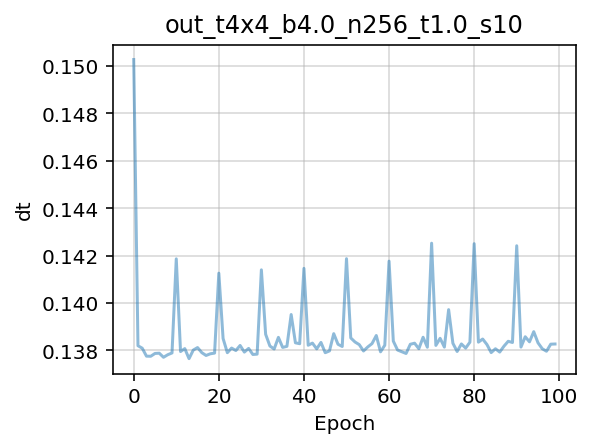

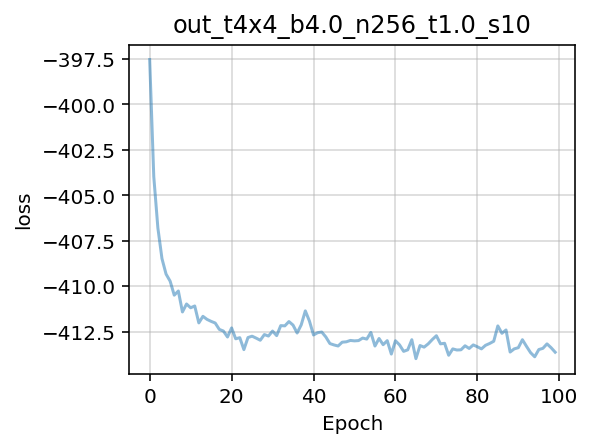

...

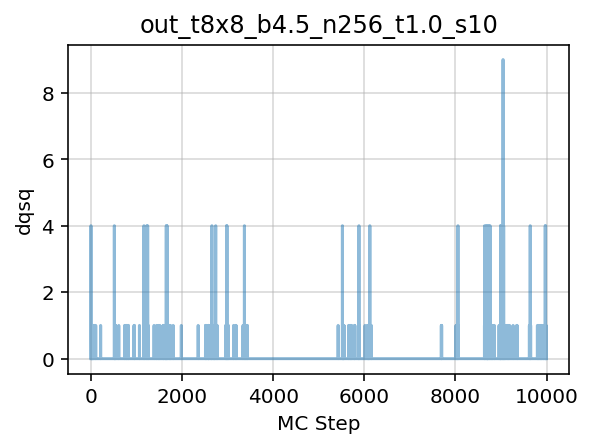

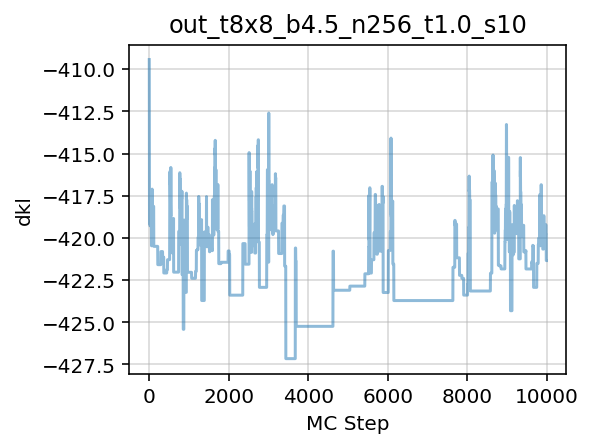

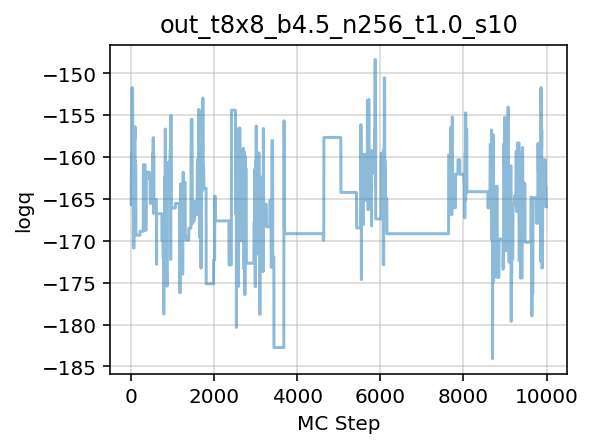

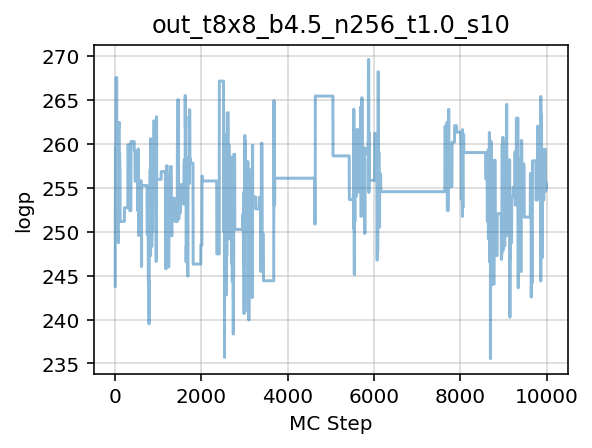

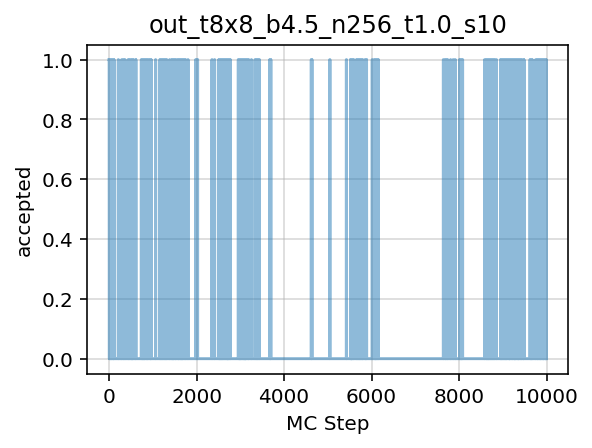

In [15]:
from math import pi as PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_net_from_layers, get_nets
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history

param8 = Param(**{
    'L': 8,
    'tau': 1.,
    'nrun': 5,
    'beta': 4.5,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 100,
    'seed': 1331,
})

logger.log(repr(param8))

flow8 = make_net_from_layers(lattice_shape=tuple(param8.lat),
                             nets=get_nets(pre_flow_model['layers']))


train_config8 = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 100,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 256,
    'print_freq': 100,
    'plot_freq': 100,
})
logger.log(repr(param8))

prior8 = MultivariateUniform(torch.zeros((2, *param8.lat)),
                              2. * PI * torch.ones(tuple(param8.lat)))

model8 = {'layers': flow8, 'prior': prior8}

DAYSTR8 = io.get_timestamp('%Y-%m-%d')
NOW8 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP8 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR8 = os.path.join(LOGS_DIR,
                           param8.uniquestr())
METRICS_DIR8 = os.path.join(PARAM_DIR8, 'metrics')
MODEL_DIR8 = os.path.join(PARAM_DIR8, 'models')
PLOTS_DIR8 = os.path.join(PARAM_DIR8, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR8)
io.check_else_make_dir(MODEL_DIR8)
io.check_else_make_dir(METRICS_DIR8)
io.check_else_make_dir(PLOTS_DIR8)

train_outputs8 = train(param8,
                        train_config8,
                        model=model8,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots8 = train_outputs8['plots']
pre_flow_history8 = train_outputs8['history']
flow_act8 = train_outputs8['action']

pre_flow_model8 = train_outputs8['model']
pre_flow_optimizer8 = train_outputs8['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step8 = train_config8.n_era * train_config8.n_epoch

outfile8 = os.path.join(MODEL_DIR8, 'pre_flow_model', TSTAMP8, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step8,
    outfile=outfile8,
    model=pre_flow_model8['layers'],
    optimizer=pre_flow_optimizer8,
    history=train_outputs8['history'],
    overwrite=True,
)

plots8 = train_outputs8['plots']
outdir8 = os.path.join(PLOTS_DIR8, 'training', 'pre_flow_model', TSTAMP8)

save_live_plots(plots8, outdir8)


tstamp8 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir8 = os.path.join(PLOTS_DIR8, 'training', 'pre_flow_model', TSTAMP8)
if os.path.isdir(pdir8):
    pdir8 = os.path.join(PLOTS_DIR8, 'training', 'pre_flow_model', tstamp8)
    
mdir8 = os.path.join(METRICS_DIR8, 'training', 'pre_flow_model', TSTAMP8)
if os.path.isdir(mdir8):
    mdir8 = os.path.join(METRICS_DIR8, 'training', 'pre_flow_model', tstamp8)
    
io.check_else_make_dir(pdir8)
io.check_else_make_dir(mdir8)

plot_history(history=train_outputs8['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir8, alpha=0.5)

mfile8 = os.path.join(mdir8, 'train_metrics.z')
io.save_history(train_outputs8['history'], mfile8, name='train_metrics')


history8 = make_mcmc_ensemble(model=train_outputs8['model'],
                               action_fn=train_outputs8['action'],
                               batch_size=train_config8.batch_size,
                               num_samples=10000)

pdir8 = os.path.join(PLOTS_DIR8, 'inference', 'pre_flow_model', TSTAMP8)
if os.path.isdir(pdir):
    pdir8 = os.path.join(PLOTS_DIR8, 'inference', 'pre_flow_model', tstamp8)
    
mdir8 = os.path.join(PLOTS_DIR8,'inference', 'pre_flow_model', TSTAMP8)
if os.path.isdir(mdir):
    mdir8 = os.path.join(METRICS_DIR8, 'inference', 'pre_flow_model', TSTAMP8)
    
io.check_else_make_dir(pdir8)
io.check_else_make_dir(mdir8)

plot_history(history=history8,
             param=param8,
             outdir=pdir8,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile8 = os.path.join(mdir8, 'inference_metrics.z')

io.save_history(history8, mfile8, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

# Try increasing $\beta$, using previously trained `8x8` network

In [ ]:
param8_1 = Param(
    beta=3.,
    L=8,
    tau=0.5,
    nstep=10,
    ntraj=256,
    nrun=5,
    nprint=100,
    seed=1331,
    randinit=False,
    nth=2,
    nth_interop=2,
)

logger.log(repr(param8_1))

flow8_1 = make_net_from_layers(lattice_shape=tuple(param8_1.lat),
                              nets=get_nets(pre_flow_model['layers']))


train_config8_1 = TrainConfig(
    n_era=10,
    n_epoch=100,
    n_layers=24,
    n_s_nets=2,
    hidden_sizes=[8, 8],
    kernel_size=3,
    base_lr=0.001,
    batch_size=64,
    print_freq=10,
    plot_freq=10,
    with_force=False,
)

prior8_1 = MultivariateUniform(torch.zeros((2, *param8_1.lat)),
                              2. * PI * torch.ones(tuple(param8_1.lat)))

model8_1 = {'layers': flow8_1, 'prior': prior8_1}

DAYSTR8_1 = io.get_timestamp('%Y-%m-%d')
NOW8_1 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP8_1 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR8_1 = os.path.join(LOGS_DIR,
                           param8_1.uniquestr())
METRICS_DIR8_1 = os.path.join(PARAM_DIR8_1, 'metrics')
MODEL_DIR8_1 = os.path.join(PARAM_DIR8_1, 'models')
PLOTS_DIR8_1 = os.path.join(PARAM_DIR8_1, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR8_1)
io.check_else_make_dir(MODEL_DIR8_1)
io.check_else_make_dir(METRICS_DIR8_1)
io.check_else_make_dir(PLOTS_DIR8_1)

train_outputs8_1 = train(param8_1,
                        train_config8_1,
                        model=model8_1,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots8_1 = train_outputs8_1['plots']
pre_flow_history8_1 = train_outputs8_1['history']
flow_act8_1 = train_outputs8_1['action']

pre_flow_model8_1 = train_outputs8_1['model']
pre_flow_optimizer8_1 = train_outputs8_1['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step8_1 = train_config8_1.n_era * train_config8_1.n_epoch

outfile8_1 = os.path.join(MODEL_DIR8_1, 'pre_flow_model', TSTAMP8_1, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step8_1,
    outfile=outfile8_1,
    model=pre_flow_model8_1['layers'],
    optimizer=pre_flow_optimizer8_1,
    history=train_outputs8_1['history'],
    overwrite=True,
)

plots8_1 = train_outputs8_1['plots']
outdir8_1 = os.path.join(PLOTS_DIR8_1, 'training', 'pre_flow_model', TSTAMP8_1)

save_live_plots(plots8_1, outdir8_1)


tstamp8_1 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir8_1 = os.path.join(PLOTS_DIR8_1, 'training', 'pre_flow_model', TSTAMP8_1)
if os.path.isdir(pdir8_1):
    pdir8_1 = os.path.join(PLOTS_DIR8_1, 'training', 'pre_flow_model', tstamp8_1)
    
mdir8_1 = os.path.join(METRICS_DIR8_1, 'training', 'pre_flow_model', TSTAMP8_1)
if os.path.isdir(mdir8_1):
    mdir8_1 = os.path.join(METRICS_DIR8_1, 'training', 'pre_flow_model', tstamp8_1)
    
io.check_else_make_dir(pdir8_1)
io.check_else_make_dir(mdir8_1)

plot_history(history=train_outputs8_1['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir8_1, alpha=0.5)

mfile8_1 = os.path.join(mdir8_1, 'train_metrics.z')
io.save_history(train_outputs8_1['history'], mfile8_1, name='train_metrics')


history8_1 = make_mcmc_ensemble(model=train_outputs8_1['model'],
                               action_fn=train_outputs8_1['action'],
                               batch_size=train_config8_1.batch_size,
                               num_samples=10000)

pdir8_1 = os.path.join(PLOTS_DIR8_1, 'inference', 'pre_flow_model', TSTAMP8_1)
if os.path.isdir(pdir):
    pdir8_1 = os.path.join(PLOTS_DIR8_1, 'inference', 'pre_flow_model', tstamp8_1)
    
mdir8_1 = os.path.join(PLOTS_DIR8_1,'inference', 'pre_flow_model', TSTAMP8_1)
if os.path.isdir(mdir):
    mdir8_1 = os.path.join(METRICS_DIR8_1, 'inference', 'pre_flow_model', TSTAMP8_1)
    
io.check_else_make_dir(pdir8_1)
io.check_else_make_dir(mdir8_1)

plot_history(history=history8_1,
             param=param8_1,
             outdir=pdir8_1,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile8_1 = os.path.join(mdir8_1, 'inference_metrics.z')

io.save_history(history8_1, mfile8_1, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

# Try increasing $\beta$ again...

In [ ]:
param8_1 = Param(
    beta=3.,
    L=8,
    tau=0.5,
    nstep=10,
    ntraj=256,
    nrun=5,
    nprint=100,
    seed=1331,
    randinit=False,
    nth=2,
    nth_interop=2,
)

logger.log(repr(param8_1))

flow8_1 = make_net_from_layers(lattice_shape=tuple(param8_1.lat),
                              nets=get_nets(pre_flow_model['layers']))


train_config8_1 = TrainConfig(
    n_era=10,
    n_epoch=100,
    n_layers=24,
    n_s_nets=2,
    hidden_sizes=[8, 8],
    kernel_size=3,
    base_lr=0.001,
    batch_size=64,
    print_freq=10,
    plot_freq=10,
    with_force=False,
)

prior8_1 = MultivariateUniform(torch.zeros((2, *param8_1.lat)),
                              2. * PI * torch.ones(tuple(param8_1.lat)))

model8_1 = {'layers': flow8_1, 'prior': prior8_1}

DAYSTR8_1 = io.get_timestamp('%Y-%m-%d')
NOW8_1 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP8_1 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR8_1 = os.path.join(LOGS_DIR,
                           param8_1.uniquestr())
METRICS_DIR8_1 = os.path.join(PARAM_DIR8_1, 'metrics')
MODEL_DIR8_1 = os.path.join(PARAM_DIR8_1, 'models')
PLOTS_DIR8_1 = os.path.join(PARAM_DIR8_1, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR8_1)
io.check_else_make_dir(MODEL_DIR8_1)
io.check_else_make_dir(METRICS_DIR8_1)
io.check_else_make_dir(PLOTS_DIR8_1)

train_outputs8_1 = train(param8_1,
                        train_config8_1,
                        model=model8_1,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots8_1 = train_outputs8_1['plots']
pre_flow_history8_1 = train_outputs8_1['history']
flow_act8_1 = train_outputs8_1['action']

pre_flow_model8_1 = train_outputs8_1['model']
pre_flow_optimizer8_1 = train_outputs8_1['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step8_1 = train_config8_1.n_era * train_config8_1.n_epoch

outfile8_1 = os.path.join(MODEL_DIR8_1, 'pre_flow_model', TSTAMP8_1, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step8_1,
    outfile=outfile8_1,
    model=pre_flow_model8_1['layers'],
    optimizer=pre_flow_optimizer8_1,
    history=train_outputs8_1['history'],
    overwrite=True,
)

plots8_1 = train_outputs8_1['plots']
outdir8_1 = os.path.join(PLOTS_DIR8_1, 'training', 'pre_flow_model', TSTAMP8_1)

save_live_plots(plots8_1, outdir8_1)


tstamp8_1 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir8_1 = os.path.join(PLOTS_DIR8_1, 'training', 'pre_flow_model', TSTAMP8_1)
if os.path.isdir(pdir8_1):
    pdir8_1 = os.path.join(PLOTS_DIR8_1, 'training', 'pre_flow_model', tstamp8_1)
    
mdir8_1 = os.path.join(METRICS_DIR8_1, 'training', 'pre_flow_model', TSTAMP8_1)
if os.path.isdir(mdir8_1):
    mdir8_1 = os.path.join(METRICS_DIR8_1, 'training', 'pre_flow_model', tstamp8_1)
    
io.check_else_make_dir(pdir8_1)
io.check_else_make_dir(mdir8_1)

plot_history(history=train_outputs8_1['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir8_1, alpha=0.5)

mfile8_1 = os.path.join(mdir8_1, 'train_metrics.z')
io.save_history(train_outputs8_1['history'], mfile8_1, name='train_metrics')


history8_1 = make_mcmc_ensemble(model=train_outputs8_1['model'],
                               action_fn=train_outputs8_1['action'],
                               batch_size=train_config8_1.batch_size,
                               num_samples=10000)

pdir8_1 = os.path.join(PLOTS_DIR8_1, 'inference', 'pre_flow_model', TSTAMP8_1)
if os.path.isdir(pdir):
    pdir8_1 = os.path.join(PLOTS_DIR8_1, 'inference', 'pre_flow_model', tstamp8_1)
    
mdir8_1 = os.path.join(PLOTS_DIR8_1,'inference', 'pre_flow_model', TSTAMP8_1)
if os.path.isdir(mdir):
    mdir8_1 = os.path.join(METRICS_DIR8_1, 'inference', 'pre_flow_model', TSTAMP8_1)
    
io.check_else_make_dir(pdir8_1)
io.check_else_make_dir(mdir8_1)

plot_history(history=history8_1,
             param=param8_1,
             outdir=pdir8_1,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile8_1 = os.path.join(mdir8_1, 'inference_metrics.z')

io.save_history(history8_1, mfile8_1, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

# Transfer to `12x12` lattice

In [ ]:
from math import pi as PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_net_from_layers, get_nets
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history


param12 = {
    'L': 12,
    'tau': 0.5,
    'nrun': 5,
    'beta': 2.,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
    'randinit': True,
}

param12 = Param(**param12)
logger.log(repr(param12))

flow12 = make_net_from_layers(lattice_shape=tuple(param12.lat),
                              nets=get_nets(pre_flow_model['layers']))

train_config12 = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 100,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 64,
    'print_freq': 10,
    'plot_freq': 10,
})

prior12 = MultivariateUniform(torch.zeros((2, *param12.lat)),
                              2. * PI * torch.ones(tuple(param12.lat)))

model12 = {'layers': flow12, 'prior': prior12}

DAYSTR12 = io.get_timestamp('%Y-%m-%d')
NOW12 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP12 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR12 = os.path.join(LOGS_DIR,
                           param12.uniquestr())
METRICS_DIR12 = os.path.join(PARAM_DIR12, 'metrics')
MODEL_DIR12 = os.path.join(PARAM_DIR12, 'models')
PLOTS_DIR12 = os.path.join(PARAM_DIR12, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR12)
io.check_else_make_dir(MODEL_DIR12)
io.check_else_make_dir(METRICS_DIR12)
io.check_else_make_dir(PLOTS_DIR12)

train_outputs12 = train(param12,
                        train_config12,
                        model=model12,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots12 = train_outputs12['plots']
pre_flow_history12 = train_outputs12['history']
flow_act12 = train_outputs12['action']

pre_flow_model12 = train_outputs12['model']
pre_flow_optimizer12 = train_outputs12['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step12 = train_config12.n_era * train_config12.n_epoch

outfile12 = os.path.join(MODEL_DIR12, 'pre_flow_model', TSTAMP12, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step12,
    outfile=outfile12,
    model=pre_flow_model12['layers'],
    optimizer=pre_flow_optimizer12,
    history=train_outputs12['history'],
    overwrite=True,
)

plots12 = train_outputs12['plots']
outdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', TSTAMP12)

save_live_plots(plots12, outdir12)


tstamp12 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', TSTAMP12)
if os.path.isdir(pdir12):
    pdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', tstamp12)
    
mdir12 = os.path.join(METRICS_DIR12, 'training', 'pre_flow_model', TSTAMP12)
if os.path.isdir(mdir12):
    mdir12 = os.path.join(METRICS_DIR12, 'training', 'pre_flow_model', tstamp12)
    
io.check_else_make_dir(pdir12)
io.check_else_make_dir(mdir12)

plot_history(history=train_outputs12['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir12, alpha=0.5)

mfile12 = os.path.join(mdir12, 'train_metrics.z')
io.save_history(train_outputs12['history'], mfile12, name='train_metrics')


history12 = make_mcmc_ensemble(model=train_outputs12['model'],
                               action_fn=train_outputs12['action'],
                               batch_size=train_config12.batch_size,
                               num_samples=10000)

pdir12 = os.path.join(PLOTS_DIR12, 'inference', 'pre_flow_model', TSTAMP12)
if os.path.isdir(pdir):
    pdir12 = os.path.join(PLOTS_DIR12, 'inference', 'pre_flow_model', tstamp12)
    
mdir12 = os.path.join(PLOTS_DIR12,'inference', 'pre_flow_model', TSTAMP12)
if os.path.isdir(mdir):
    mdir12 = os.path.join(METRICS_DIR12, 'inference', 'pre_flow_model', TSTAMP12)
    
io.check_else_make_dir(pdir12)
io.check_else_make_dir(mdir12)

plot_history(history=history12,
             param=param12,
             outdir=pdir12,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile12 = os.path.join(mdir12, 'inference_metrics.z')

io.save_history(history12, mfile12, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

In [ ]:
from math import pi as PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_net_from_layers, get_nets
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history


param16 = {
    'L': 16,
    'tau': 0.5,
    'nrun': 5,
    'beta': 2.,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
    'randinit': True,
}

param16 = Param(**param16)
logger.log(repr(param16))

flow16 = make_net_from_layers(lattice_shape=tuple(param16.lat),
                              nets=get_nets(pre_flow_model['layers']))

train_config16 = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 100,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 64,
    'print_freq': 10,
    'plot_freq': 10,
})

prior16 = MultivariateUniform(torch.zeros((2, *param16.lat)),
                              2. * PI * torch.ones(tuple(param16.lat)))

model16 = {'layers': flow16, 'prior': prior16}

DAYSTR16 = io.get_timestamp('%Y-%m-%d')
NOW16 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP16 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR16 = os.path.join(LOGS_DIR,
                           param16.uniquestr())
METRICS_DIR16 = os.path.join(PARAM_DIR16, 'metrics')
MODEL_DIR16 = os.path.join(PARAM_DIR16, 'models')
PLOTS_DIR16 = os.path.join(PARAM_DIR16, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR16)
io.check_else_make_dir(MODEL_DIR16)
io.check_else_make_dir(METRICS_DIR16)
io.check_else_make_dir(PLOTS_DIR16)

train_outputs16 = train(param16,
                        train_config16,
                        model=model16,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots16 = train_outputs16['plots']
pre_flow_history16 = train_outputs16['history']
flow_act16 = train_outputs16['action']

pre_flow_model16 = train_outputs16['model']
pre_flow_optimizer16 = train_outputs16['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step16 = train_config16.n_era * train_config16.n_epoch

outfile16 = os.path.join(MODEL_DIR16, 'pre_flow_model', TSTAMP16, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step16,
    outfile=outfile16,
    model=pre_flow_model16['layers'],
    optimizer=pre_flow_optimizer16,
    history=train_outputs16['history'],
    overwrite=True,
)

plots16 = train_outputs16['plots']
outdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', TSTAMP16)

save_live_plots(plots16, outdir16)


tstamp16 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', TSTAMP16)
if os.path.isdir(pdir16):
    pdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', tstamp16)
    
mdir16 = os.path.join(METRICS_DIR16, 'training', 'pre_flow_model', TSTAMP16)
if os.path.isdir(mdir16):
    mdir16 = os.path.join(METRICS_DIR16, 'training', 'pre_flow_model', tstamp16)
    
io.check_else_make_dir(pdir16)
io.check_else_make_dir(mdir16)

plot_history(history=train_outputs16['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir16, alpha=0.5)

mfile16 = os.path.join(mdir16, 'train_metrics.z')
io.save_history(train_outputs16['history'], mfile16, name='train_metrics')


history16 = make_mcmc_ensemble(model=train_outputs16['model'],
                               action_fn=train_outputs16['action'],
                               batch_size=train_config16.batch_size,
                               num_samples=10000)

pdir16 = os.path.join(PLOTS_DIR16, 'inference', 'pre_flow_model', TSTAMP16)
if os.path.isdir(pdir):
    pdir16 = os.path.join(PLOTS_DIR16, 'inference', 'pre_flow_model', tstamp16)
    
mdir16 = os.path.join(PLOTS_DIR16,'inference', 'pre_flow_model', TSTAMP16)
if os.path.isdir(mdir):
    mdir16 = os.path.join(METRICS_DIR16, 'inference', 'pre_flow_model', TSTAMP16)
    
io.check_else_make_dir(pdir16)
io.check_else_make_dir(mdir16)

plot_history(history=history16,
             param=param16,
             outdir=pdir16,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile16 = os.path.join(mdir16, 'inference_metrics.z')

io.save_history(history16, mfile16, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

In [ ]:
logger.log(repr(param))

In [ ]:
logger.log(train_config)

In [ ]:
from math import pi as PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_net_from_layers, get_nets

param12 = {
    'L': 12,
    'tau': 0.5,
    'nrun': 5,
    'beta': 2.,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
    'randinit': True,
}

param12 = Param(**param12)
logger.log(repr(param12))

flow12 = make_net_from_layers(lattice_shape=tuple(param12.lat),
                              nets=get_nets(pre_flow_model['layers']))

train_config12 = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 1000,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [12, 12],
    'kernel_size': 5,
    'batch_size': 256,
    'print_freq': 100,
    'plot_freq': 100,
})

prior12 = MultivariateUniform(torch.zeros((2, *param12.lat)),
                              2. * PI * torch.ones(tuple(param12.lat)))

model12 = {'layers': flow12, 'prior': prior12}

In [ ]:
DAYSTR12 = io.get_timestamp('%Y-%m-%d')
NOW12 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP12 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR12 = os.path.join(LOGS_DIR,
                           param12.uniquestr())
METRICS_DIR12 = os.path.join(PARAM_DIR12, 'metrics')
MODEL_DIR12 = os.path.join(PARAM_DIR12, 'models')
PLOTS_DIR12 = os.path.join(PARAM_DIR12, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR12)
io.check_else_make_dir(MODEL_DIR12)
io.check_else_make_dir(METRICS_DIR12)
io.check_else_make_dir(PLOTS_DIR12)

In [ ]:
train_outputs12 = train(param12,
                        train_config12,
                        model=model12,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots12 = train_outputs12['plots']
pre_flow_history12 = train_outputs12['history']
flow_act12 = train_outputs12['action']

pre_flow_model12 = train_outputs12['model']
pre_flow_optimizer12 = train_outputs12['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step12 = train_config12.n_era * train_config12.n_epoch

outfile12 = os.path.join(MODEL_DIR12, 'pre_flow_model', TSTAMP12, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step12,
    outfile=outfile12,
    model=pre_flow_model12['layers'],
    optimizer=pre_flow_optimizer12,
    history=train_outputs12['history'],
    overwrite=True,
)

plots12 = train_outputs12['plots']
outdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', TSTAMP12)

save_live_plots(plots12, outdir12)

In [ ]:
from fthmc.utils.plot_helpers import plot_history

tstamp12 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', TSTAMP12)
if os.path.isdir(pdir12):
    pdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', tstamp12)
    
mdir12 = os.path.join(METRICS_DIR12, 'training', 'pre_flow_model', TSTAMP12)
if os.path.isdir(mdir12):
    mdir12 = os.path.join(METRICS_DIR12, 'training', 'pre_flow_model', tstamp12)
    
io.check_else_make_dir(pdir12)
io.check_else_make_dir(mdir12)

plot_history(history=train_outputs12['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir12, alpha=0.5)

mfile12 = os.path.join(mdir12, 'train_metrics.z')
io.save_history(train_outputs12['history'], mfile12, name='train_metrics')

In [ ]:
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed


history12 = make_mcmc_ensemble(model=train_outputs12['model'],
                               action_fn=train_outputs12['action'],
                               batch_size=train_config12.batch_size,
                               num_samples=10000)

pdir12 = os.path.join(PLOTS_DIR12, 'inference', 'pre_flow_model', TSTAMP12)
if os.path.isdir(pdir):
    pdir12 = os.path.join(PLOTS_DIR12, 'inference', 'pre_flow_model', tstamp12)
    
mdir12 = os.path.join(PLOTS_DIR12,'inference', 'pre_flow_model', TSTAMP12)
if os.path.isdir(mdir):
    mdir12 = os.path.join(METRICS_DIR12, 'inference', 'pre_flow_model', TSTAMP12)
    
io.check_else_make_dir(pdir12)
io.check_else_make_dir(mdir12)

plot_history(history=history12,
             param=param12,
             outdir=pdir12,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile12 = os.path.join(mdir12, 'inference_metrics.z')

io.save_history(history12, mfile12, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

In [ ]:
from math import pi as PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_net_from_layers, get_nets
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed

from fthmc.utils.plot_helpers import plot_history

param16 = {
    'L': 16,
    'tau': 0.5,
    'nrun': 5,
    'beta': 2.,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
    'randinit': True,
}

param16 = Param(**param16)
logger.log(repr(param16))

flow16 = make_net_from_layers(lattice_shape=tuple(param16.lat),
                              nets=get_nets(pre_flow_model12['layers']))

train_config16 = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 1000,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [16, 16],
    'kernel_size': 5,
    'batch_size': 256,
    'print_freq': 100,
    'plot_freq': 100,
})

prior16 = MultivariateUniform(torch.zeros((2, *param16.lat)),
                              2. * PI * torch.ones(tuple(param16.lat)))

model16 = {'layers': flow16, 'prior': prior16}

DAYSTR16 = io.get_timestamp('%Y-%m-%d')
NOW16 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP16 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR16 = os.path.join(LOGS_DIR,
                           param16.uniquestr())
METRICS_DIR16 = os.path.join(PARAM_DIR16, 'metrics')
MODEL_DIR16 = os.path.join(PARAM_DIR16, 'models')
PLOTS_DIR16 = os.path.join(PARAM_DIR16, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR16)
io.check_else_make_dir(MODEL_DIR16)
io.check_else_make_dir(METRICS_DIR16)
io.check_else_make_dir(PLOTS_DIR16)


train_outputs16 = train(param16,
                        train_config16,
                        model=model16,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots16 = train_outputs16['plots']
pre_flow_history16 = train_outputs16['history']
flow_act16 = train_outputs16['action']

pre_flow_model16 = train_outputs16['model']
pre_flow_optimizer16 = train_outputs16['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step16 = train_config16.n_era * train_config16.n_epoch

outfile16 = os.path.join(MODEL_DIR16, 'pre_flow_model', TSTAMP16, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step16,
    outfile=outfile16,
    model=pre_flow_model16['layers'],
    optimizer=pre_flow_optimizer16,
    history=train_outputs16['history'],
    overwrite=True,
)

plots16 = train_outputs16['plots']
outdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', TSTAMP16)

save_live_plots(plots16, outdir16)


tstamp16 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', TSTAMP16)
if os.path.isdir(pdir16):
    pdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', tstamp16)
    
mdir16 = os.path.join(METRICS_DIR16, 'training', 'pre_flow_model', TSTAMP16)
if os.path.isdir(mdir16):
    mdir16 = os.path.join(METRICS_DIR16, 'training', 'pre_flow_model', tstamp16)
    
io.check_else_make_dir(pdir16)
io.check_else_make_dir(mdir16)

plot_history(history=train_outputs16['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir16, alpha=0.5)

mfile16 = os.path.join(mdir16, 'train_metrics.z')
io.save_history(train_outputs16['history'], mfile16, name='train_metrics')



history16 = make_mcmc_ensemble(model=train_outputs16['model'],
                               action_fn=train_outputs16['action'],
                               batch_size=train_config16.batch_size,
                               num_samples=10000)

pdir16 = os.path.join(PLOTS_DIR16, 'inference', 'pre_flow_model', TSTAMP16)
if os.path.isdir(pdir):
    pdir16 = os.path.join(PLOTS_DIR16, 'inference', 'pre_flow_model', tstamp16)
    
mdir16 = os.path.join(PLOTS_DIR16,'inference', 'pre_flow_model', TSTAMP16)
if os.path.isdir(mdir):
    mdir16 = os.path.join(METRICS_DIR16, 'inference', 'pre_flow_model', TSTAMP16)
    
io.check_else_make_dir(pdir16)
io.check_else_make_dir(mdir16)

plot_history(history=history16,
             param=param16,
             outdir=pdir16,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile16 = os.path.join(mdir16, 'inference_metrics.z')

io.save_history(history16, mfile16, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

In [ ]:
pre_flow_model.keys()

In [ ]:
layers8 = pre_flow_model['layers']
logger.log([val.shape for _, val in layers8.state_dict().items()])

In [ ]:
layers12 = model12['layers']
logger.log([val.shape for _, val in layers12.state_dict().items()])

In [ ]:
layers12 = model12['layers']
logger.log(layers12.state_dict())

In [ ]:
import seaborn as sns

from dataclasses import asdict
from copy import deepcopy
from utils.distributions import MultivariateUniform
from utils.layers import make_u1_equiv_layers, set_weights
from math import pi as PI
import utils.qed_helpers as qed

TWO_PI = 2 * PI
# from train import train

sns.set_context('notebook')
sns.set_palette('bright')

train_cfg_force = asdict(train_config)
train_cfg_force['with_force'] = True

tconfig_force = TrainConfig(**train_cfg_force)

link_shape = (2, *param.lat)
lattice_shape = tuple(param.lat)
u1_action = qed.BatchAction(param.beta)

prior = MultivariateUniform(torch.zeros(link_shape),
                            TWO_PI * torch.ones(link_shape))

tconfig_force
layers = make_u1_equiv_layers(lattice_shape=lattice_shape,
                              n_layers=tconfig_force.n_layers,
                              n_mixture_comps=tconfig_force.n_s_nets,
                              hidden_sizes=tconfig_force.hidden_sizes,
                              kernel_size=tconfig_force.kernel_size)

set_weights(layers)

model_force = {
    'prior': prior,
    'layers': layers,
}
                              

outputs = train(param, tconfig_force,
                model=model_force,
                pre_model=pre_flow_model,
                figsize=(8, 2.),
                use_alt=False,
                force_factor=0.001,
                dkl_factor=1.)#, logger=logger)

flow_model_force = outputs['model']
flow_model_force_history = outputs['history']
flow_action_force = outputs['action']

In [ ]:
def test_force(
    param: Param,
    model: dict,
    x: torch.Tensor = None,
    pre_model: dict = None
):
    """Test the force.
    
    If `x` is None:
      - Draw samples `xi (~ pre_prior)` from prior and pass through `pre_model` 
        to get `x (~ pre_posterior)`.
     
    Pass `x` backwards through the `model` to get `xi (~ prior)`.
    
    Calculate `force(xi)` and `norm(force(xi))`.
    """
    if x is None:
        if pre_model is None:
            raise ValueError(f'Either `x` or `pre_model` must be specified.')
            
        # Draw samples `xi` from prior
        pre_xi = pre_model['prior'].sample_n(1)
        
        # Pass `xi` through layers in `pre_model`
        x = qed.ft_flow(pre_model['layers'], pre_xi)
        
    # Pass `x` backwards through layers in `model`
    xi = qed.ft_flow_inv(model['layers'], x)
    # Calculate force
    force = qed.ft_force(param, model['layers'], xi)
    force_norm = torch.linalg.norm(force)
    return force_norm

In [ ]:
from train import run as hmc_run
fields, metrics = hmc_run(param, logger=logger, keep_fields=True)

#metrics_dir = os.path.join(OUTDIR, 'metrics', 'hmc')
#metrics_file = os.path.join(metrics_dir, 'metrics.z')
#io.savez(metrics, metrics_file)

In [ ]:
#field_arr = torch.stack(tuple(fields.values()), dim=0)
len(fields)
#
field_arr = np.array([qed.grab(torch.stack(i)) for i in fields])
field_arr.shape
#logger.log(field_arr.shape)

In [ ]:
for field in field_arr:
    force_tf = test_force(param, flow_model_force, pre_model=pre_flow_model)
    logger.log(f'ft_flow(players, pxi), (pxi ~ pre_prior): {force_tf:.5g}') 
    
    x = torch.from_numpy(field[-1]).squeeze()[None, :]
    if torch.cuda.is_available():
        x = x.cuda()
    
    #x_ = field_arr.squeeze()[None, :]
    force_ = test_force(param, flow_model_force, x=x, pre_model=pre_flow_model)
    logger.log(f'ft_flow(layers, field_arr), (pxi ~ pre_prior): {force_:.5g}')

In [ ]:
# field_arr generated from generic HMC run
for idx, fields in enumerate(field_arr):
    # x generated from HMC
    x = torch.from_numpy(fields)
    if torch.cuda.is_available():
        x = x.cuda()
        
    # flow HMC samples backwards through `flow_model_force` and calculate force
    force1 = test_force(param, flow_model_force, x=x)
    
    # sample x ~ pre_flow_model_prior, flow through `pre_flow_model` to get xi 
    # flow xi backwards through `flow_model_force` and calculate force
    force2 = test_force(param, flow_model_force, pre_model=pre_flow_model)
    
    logger.log(f'run={idx}\n'
               f'  (xi ~ HMC): force_xi={force1:.5g}\n'
               f"  (xi ~ pre_flow_model_prior): force_xi_pre={force2:.5g}")

In [ ]:
#field_run = torch.stack(tuple(fields.values()), dim=0)
##flows = flow

#x0 = field_arr[0][None, :]
#x = field_arr[0][None, :]

# select last trajectory from last run
x = torch.from_numpy(field_arr[-1][-1][None, :]).cuda()
x0 = torch.from_numpy(field_arr[-1][-1][None, :]).cuda()

if torch.cuda.is_available():
    x = x.cuda()

plaq0 = qed.action(param, x) / (-param.beta * param.volume)
logger.log(f'plaq(field_arr[0])={plaq0:.8g}')

#logger\.log(f'plaq(field_run[0]) {qed.action(param, x) / (-param.beta*param.volume)}')
# field.requires_grad_(True)
#x = field_run[0][None, :]
logJ = 0.0
for layer in reversed(flow_model_force['layers']):
    x, lJ = layer.reverse(x)
    logJ += lJ

# x is the prior distribution now
    
x.requires_grad_(True)
    
y = x
logJy = 0.0
for layer in flow_model_force['layers']:
    y, lJ = layer.forward(y)
    logJy += lJ
    
s = qed.action(param, y[0][None, :]) - logJy

logger.log(f'sum(logJ): {qed.grab(logJ.sum())}')
logger.log(f'sum(logJy): {qed.grab(logJy.sum())}')
#print(logJ,logJy)


# print("eff_action", s + 136.3786)

logger.log(f'original_action: {qed.action(param, y[0][None, :]) + 91}')
#print("original_action", qed.action(param, y[0][None, :]) + 91)

logger.log(f'eff_action: {s + 56}')
#print("eff_action", {s + 56)

s.backward()

f = x.grad

x.requires_grad_(False)

logger.log(f'plaq(x) {qed.action(param, x[0][None, :]) / (-param.beta*param.volume)}  logJ {qed.grab(logJ)}  force.norm {torch.linalg.norm(f)}')
logger.log(f'plaq(y) {qed.action(param, y[0][None, :]) / (-param.beta*param.volume)}')
logger.log(f'plaq(x) {qed.action(param, x0) / (-param.beta*param.volume)}  force.norm {torch.linalg.norm(qed.force(param, x0))}')

In [ ]:
logger.log(x.shape)

field_tensor = torch.from_numpy(field_arr).cuda()

x = qed.ft_flow_inv(flow, field_tensor[-1])
# x = field_run
#for layer in reversed(flows):
#    x, lJ = layer.reverse(x)
ff = qed.ft_force(param, flow, x)
logger.log(torch.linalg.norm(ff))
fff = qed.ft_force(param, flow, x)
logger.log(torch.linalg.norm(fff))

In [ ]:
x = qed.ft_flow_inv(flow, field_tensor[-1])
logger.log(qed.grab(qed.ft_action(param, flow, x)))